## 1. Import the dependencies

In [1]:
# !pip install torch_fidelity

In [2]:
!nvidia-smi

Mon Apr  7 05:22:58 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 565.57.01              Driver Version: 565.57.01      CUDA Version: 12.7     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3090        On  |   00000000:81:00.0 Off |                  N/A |
| 37%   30C    P8             18W /  350W |       2MiB /  24576MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [3]:
# !kill -9      3109855                                                                                                 

In [4]:
import os
import torch
import torch.nn as nn
import numpy as np
import cv2
import matplotlib.pyplot as plt
import itertools
import random
import torchvision
from torch.nn.modules.utils import _pair, _quadruple
from torch.autograd import Variable
from torchvision.utils import make_grid
from torchvision import models
from torchvision.models import VGG16_Weights
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision.transforms as transforms
import torch.nn.functional as F
import pandas as pd
import torch_fidelity
from contextlib import contextmanager
from skimage.metrics import structural_similarity as ssim

In [5]:
SEED = 42
print("Random Seed:", SEED)
random.seed(SEED)
np.random.seed(SEED)
torch_seed = torch.initial_seed()
torch.manual_seed(torch_seed)
print("Torch seed:" , torch_seed)

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

cuda = torch.cuda.is_available()
Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor

Random Seed: 42
Torch seed: 7193048279908058341


In [6]:
def show(tensor, ch=3, size=(96,96), numImages=5):
    tensor = (tensor +1) / 2.0

    data = tensor.detach().cpu().view(-1, ch, *size)

    grid = make_grid(data[:numImages], nrow=5).permute(1,2,0)
    plt.imshow(grid)
    plt.show()

## 2. Define your model

In [7]:
class ChannelAttention(nn.Module):
    def __init__(self, in_channels, reduction_ratio=16):
        super(ChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        
        self.fc = nn.Sequential(
            nn.Conv2d(in_channels, in_channels // reduction_ratio, 1, bias=False),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels // reduction_ratio, in_channels, 1, bias=False)
        )
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        avg_out = self.fc(self.avg_pool(x))
        max_out = self.fc(self.max_pool(x))
        out = avg_out + max_out
        return self.sigmoid(out)

class SpatialAttention(nn.Module):
    def __init__(self, kernel_size=7):
        super(SpatialAttention, self).__init__()
        self.conv = nn.Conv2d(2, 1, kernel_size, padding=kernel_size//2, bias=False)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out, _ = torch.max(x, dim=1, keepdim=True)
        x_cat = torch.cat([avg_out, max_out], dim=1)
        out = self.conv(x_cat)
        return self.sigmoid(out)

class CBAM(nn.Module):
    def __init__(self, channels, reduction_ratio=16, kernel_size=7):
        super(CBAM, self).__init__()
        self.channel_att = ChannelAttention(channels, reduction_ratio)
        self.spatial_att = SpatialAttention(kernel_size)
        
    def forward(self, x):
        x = x * self.channel_att(x)
        x = x * self.spatial_att(x)
        return x

class ImprovedResidualBlock(nn.Module):
    def __init__(self, in_features, use_cbam=True):
        super(ImprovedResidualBlock, self).__init__()
        
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, kernel_size=3, padding=0),
            nn.InstanceNorm2d(in_features),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, kernel_size=3, padding=0),
            nn.InstanceNorm2d(in_features)
        )
        
        # Add both SE and CBAM attention
        self.se = SqueezeExcitation(in_features)
        self.use_cbam = use_cbam
        if use_cbam:
            self.cbam = CBAM(in_features)
    
    def forward(self, x):
        out = self.block(x)
        out = self.se(out)  # Apply squeeze-excitation
        if self.use_cbam:
            out = self.cbam(out)  # Apply CBAM
        return x + out  # Skip connection

class SqueezeExcitation(nn.Module):
    def __init__(self, channel, reduction=16):
        super(SqueezeExcitation, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Linear(channel, channel // reduction, bias=False),
            nn.ReLU(inplace=True),
            nn.Linear(channel // reduction, channel, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _, _ = x.size()
        y = self.avg_pool(x).view(b, c)
        y = self.fc(y).view(b, c, 1, 1)
        return x * y.expand_as(x)

class SelfAttention(nn.Module):
    def __init__(self, in_dim):
        super(SelfAttention, self).__init__()
        self.query_conv = nn.Conv2d(in_dim, in_dim//8, kernel_size=1)
        self.key_conv = nn.Conv2d(in_dim, in_dim//8, kernel_size=1)
        self.value_conv = nn.Conv2d(in_dim, in_dim, kernel_size=1)
        self.gamma = nn.Parameter(torch.zeros(1))
        
        self.softmax = nn.Softmax(dim=-1)
        
    def forward(self, x):
        batch_size, C, width, height = x.size()
        
        # Project to get query, key, value
        query = self.query_conv(x).view(batch_size, -1, width*height).permute(0, 2, 1)
        key = self.key_conv(x).view(batch_size, -1, width*height)
        value = self.value_conv(x).view(batch_size, -1, width*height)
        
        # Calculate attention map
        attention = torch.bmm(query, key)
        attention = self.softmax(attention)
        
        # Apply attention to value
        out = torch.bmm(value, attention.permute(0, 2, 1))
        out = out.view(batch_size, C, width, height)
        
        # Apply gamma parameter and add to input
        out = self.gamma * out + x
        return out

In [8]:
# class Discriminator(nn.Module):
#     def __init__(self, in_channels=3, features_d=64):
#         super(Discriminator, self).__init__()
        
#         # Changed from 16 to 8 - appropriate for 96x96 images
#         self.scale_factor = 8
        
#         # Feature extraction with 3 downsampling layers instead of 4
#         self.feature_extraction = nn.Sequential(
#             nn.utils.spectral_norm(nn.Conv2d(in_channels, features_d, kernel_size=4, stride=2, padding=1)),
#             nn.LeakyReLU(0.2, inplace=True),
            
#             nn.utils.spectral_norm(nn.Conv2d(features_d, features_d*2, kernel_size=4, stride=2, padding=1)),
#             nn.InstanceNorm2d(features_d*2),
#             nn.LeakyReLU(0.2, inplace=True),
            
#             nn.utils.spectral_norm(nn.Conv2d(features_d*2, features_d*4, kernel_size=4, stride=2, padding=1)),
#             nn.InstanceNorm2d(features_d*4),
#             nn.LeakyReLU(0.2, inplace=True)
#         )
        
#         # PatchGAN output
#         self.patch_output = nn.Sequential(
#             nn.utils.spectral_norm(nn.Conv2d(features_d*4, 1, kernel_size=4, stride=1, padding=1))
#         )
        
#         # Global discriminator output
#         self.global_output = nn.Sequential(
#             nn.AdaptiveAvgPool2d(1),
#             nn.Flatten(),
#             nn.Linear(features_d*4, 1)
#         )
    
#     def forward(self, x, get_features=False):
#         features = self.feature_extraction(x)
#         patch_out = self.patch_output(features)
#         global_out = self.global_output(features)
        
#         if get_features:
#             # Return intermediate features for feature matching loss
#             return patch_out, global_out, [features]
#         return patch_out, global_out

In [9]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features_d=64):
        super(Discriminator, self).__init__()
        
        # Changed from 16 to 8 - appropriate for 96x96 images
        self.scale_factor = 8
        
        # Feature extraction with 3 downsampling layers instead of 4
        self.feature_extraction = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(in_channels, features_d, kernel_size=4, stride=2, padding=1)),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(features_d, features_d*2, kernel_size=4, stride=2, padding=1)),
            nn.InstanceNorm2d(features_d*2),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.utils.spectral_norm(nn.Conv2d(features_d*2, features_d*4, kernel_size=4, stride=2, padding=1)),
            nn.InstanceNorm2d(features_d*4),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        # PatchGAN output
        self.patch_output = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(features_d*4, 1, kernel_size=4, stride=1, padding=1))
        )
        
        # Global discriminator output
        self.global_output = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Flatten(),
            nn.Linear(features_d*4, 1)
        )
    
    def forward(self, x, get_features=False, noise_level=0.05):
        # Add slight noise to make discriminator more robust during training
        if self.training and noise_level > 0:
            x = x + torch.randn_like(x) * noise_level
            
        features = self.feature_extraction(x)
        patch_out = self.patch_output(features)
        global_out = self.global_output(features)
        
        if get_features:
            # Return intermediate features for feature matching loss
            return patch_out, global_out, [features]
        return patch_out, global_out

In [10]:
# class Generator(nn.Module):
#     def __init__(self, in_channels=3, num_residual_blocks=6, use_attention=True):
#         super(Generator, self).__init__()
        
#         # Initial convolution block
#         model = [
#             nn.ReflectionPad2d(3),
#             nn.Conv2d(in_channels, 64, kernel_size=7, padding=0),
#             nn.InstanceNorm2d(64),
#             nn.ReLU(inplace=True)
#         ]
        
#         # Downsampling with fewer filters for smaller images
#         in_features = 64
#         out_features = in_features * 2
#         for _ in range(2):
#             model += [
#                 nn.Conv2d(in_features, out_features, kernel_size=3, stride=2, padding=1),
#                 nn.InstanceNorm2d(out_features),
#                 nn.ReLU(inplace=True)
#             ]
#             in_features = out_features
#             out_features = min(in_features * 2, 256)  # Cap max channels at 256
        
#         # Reduced number of residual blocks for smaller feature maps
#         for i in range(num_residual_blocks):
#             use_cbam = (i >= 2 and i <= 4)  # Adjust CBAM block range
#             model += [ImprovedResidualBlock(in_features, use_cbam=use_cbam)]
        
#         # Self-attention for better global coherence
#         if use_attention:
#             model += [SelfAttention(in_features)]
        
#         # Upsampling pathway
#         out_features = in_features // 2
#         for _ in range(2):
#             model += [
#                 nn.ConvTranspose2d(in_features, out_features, kernel_size=3, stride=2, padding=1, output_padding=1),
#                 nn.InstanceNorm2d(out_features),
#                 nn.ReLU(inplace=True)
#             ]
#             in_features = out_features
#             out_features = in_features // 2
        
#         # Output layer
#         model += [
#             nn.ReflectionPad2d(3),
#             nn.Conv2d(64, in_channels, kernel_size=7, padding=0),
#             nn.Tanh()
#         ]
        
#         self.model = nn.Sequential(*model)
    
#     def forward(self, x):
#         return self.model(x)

In [11]:
class Generator(nn.Module):
    def __init__(self, in_channels=3, num_residual_blocks=6, use_attention=True):
        super(Generator, self).__init__()
        
        # Initial convolution block
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(in_channels, 64, kernel_size=7, padding=0),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True)
        ]
        
        # Downsampling with fewer filters for smaller images
        in_features = 64
        out_features = in_features * 2
        for _ in range(2):
            model += [
                nn.Conv2d(in_features, out_features, kernel_size=3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = min(in_features * 2, 256)  # Cap max channels at 256
        
        # Reduced number of residual blocks for smaller feature maps
        for i in range(num_residual_blocks):
            use_cbam = (i >= 2 and i <= 4)  # Adjust CBAM block range
            model += [ImprovedResidualBlock(in_features, use_cbam=use_cbam)]
        
        # Self-attention for better global coherence
        if use_attention:
            model += [SelfAttention(in_features)]
        
        # Upsampling pathway
        out_features = in_features // 2
        for _ in range(2):
            model += [
                nn.ConvTranspose2d(in_features, out_features, kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features // 2
        
        # Output layer
        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(64, in_channels, kernel_size=7, padding=0),
            nn.Tanh()
        ]
        
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        return self.model(x)

In [12]:
def relativistic_loss(real_pred, fake_pred, criterion):
    # Standard GAN uses D(real) and D(fake) independently
    # Relativistic GAN compares real to fake samples
    
    # For patch-level predictions
    real_patch, real_global = real_pred
    fake_patch, fake_global = fake_pred
    
    # Relativistic average for patch outputs
    real_fake_diff_patch = real_patch - fake_patch.mean(0, keepdim=True)
    fake_real_diff_patch = fake_patch - real_patch.mean(0, keepdim=True)
    
    # Relativistic average for global outputs
    real_fake_diff_global = real_global - fake_global.mean(0, keepdim=True)
    fake_real_diff_global = fake_global - real_global.mean(0, keepdim=True)
    
    # Combine losses
    batch_size = real_global.size(0)
    ones = torch.ones(batch_size, 1).cuda() if torch.cuda.is_available() else torch.ones(batch_size, 1)
    zeros = torch.zeros(batch_size, 1).cuda() if torch.cuda.is_available() else torch.zeros(batch_size, 1)
    
    # Patch level loss
    loss_real_patch = criterion(real_fake_diff_patch, torch.ones_like(real_fake_diff_patch))
    loss_fake_patch = criterion(fake_real_diff_patch, torch.zeros_like(fake_real_diff_patch))
    
    # Global level loss
    loss_real_global = nn.BCEWithLogitsLoss()(real_fake_diff_global, ones)
    loss_fake_global = nn.BCEWithLogitsLoss()(fake_real_diff_global, zeros)
    
    # Combine patch and global losses
    loss_real = 0.7 * loss_real_patch + 0.3 * loss_real_global
    loss_fake = 0.7 * loss_fake_patch + 0.3 * loss_fake_global
    
    return (loss_real + loss_fake) / 2

def compute_gradient_penalty(discriminator, real_samples, fake_samples):
    # Random interpolation of real and fake samples
    alpha = torch.rand((real_samples.size(0), 1, 1, 1)).type(Tensor)
    interpolates = (alpha * real_samples + (1 - alpha) * fake_samples).requires_grad_(True)
    
    # Get discriminator output for interpolated images
    patch_interpolates, global_interpolates = discriminator(interpolates)
    
    # Set fake gradients for patch outputs
    fake_patch_grad = torch.ones_like(patch_interpolates).type(Tensor)
    patch_gradients = torch.autograd.grad(
        outputs=patch_interpolates,
        inputs=interpolates,
        grad_outputs=fake_patch_grad,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    
    # Flatten gradients and compute penalty
    patch_gradients = patch_gradients.reshape(real_samples.size(0), -1)
    patch_gradient_penalty = ((patch_gradients.norm(2, dim=1) - 1) ** 2).mean()
    
    # Set fake gradients for global outputs
    fake_global_grad = torch.ones_like(global_interpolates).type(Tensor)
    global_gradients = torch.autograd.grad(
        outputs=global_interpolates,
        inputs=interpolates,
        grad_outputs=fake_global_grad,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    
    # Flatten gradients and compute penalty
    global_gradients = global_gradients.reshape(real_samples.size(0), -1)
    global_gradient_penalty = ((global_gradients.norm(2, dim=1) - 1) ** 2).mean()
    
    # Combined penalty
    return 0.7 * patch_gradient_penalty + 0.3 * global_gradient_penalty

def feature_matching_loss(real_features, fake_features):
    """
    Calculate feature matching loss by comparing features extracted from real and fake images.
    
    Args:
        real_features: List of feature tensors from real images
        fake_features: List of feature tensors from fake images
        
    Returns:
        The mean absolute difference between real and fake features
    """
    # Initialize loss
    loss = 0.0
    
    # Both should be lists of the same length, containing feature maps
    assert len(real_features) == len(fake_features), "Feature lists must have same length"
    
    # Calculate L1 loss between corresponding feature maps
    for real_feat, fake_feat in zip(real_features, fake_features):
        # Make sure feature maps have same shape
        assert real_feat.shape == fake_feat.shape, f"Feature shapes don't match: {real_feat.shape} vs {fake_feat.shape}"
        # Calculate mean absolute error between feature maps
        loss += torch.mean(torch.abs(real_feat - fake_feat))
    
    # Average over number of feature maps
    return loss / len(real_features)

In [13]:
class VGGPerceptualLoss(nn.Module):
    def __init__(self):
        super(VGGPerceptualLoss, self).__init__()
        vgg = torchvision.models.vgg16(weights=VGG16_Weights.DEFAULT).cuda().eval()
        self.vgg_blocks = nn.ModuleList([
            nn.Sequential(*list(vgg.features)[:4]),  # relu1_2
            nn.Sequential(*list(vgg.features)[4:9]),  # relu2_2
            nn.Sequential(*list(vgg.features)[9:16]),  # relu3_3
        ])
        for param in self.parameters():
            param.requires_grad = False
            
    def forward(self, x, y):
        x_features = []
        y_features = []
        
        # Normalize to VGG input range
        x = (x + 1) / 2
        y = (y + 1) / 2
        
        # VGG normalization
        x = F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=False)
        y = F.interpolate(y, size=(224, 224), mode='bilinear', align_corners=False)
        
        # Extract features
        for block in self.vgg_blocks:
            x = block(x)
            y = block(y)
            x_features.append(x)
            y_features.append(y)
        
        # Calculate L1 loss between features
        loss = 0.0
        for x_feat, y_feat in zip(x_features, y_features):
            loss += F.l1_loss(x_feat, y_feat)
            
        return loss

In [14]:
class ExponentialMovingAverage:
    def __init__(self, decay=0.999):
        self.decay = decay
        self.shadow = {}
        self.original = {}

    def register(self, model):
        for name, param in model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = param.data.clone()

    def update(self, model):
        for name, param in model.named_parameters():
            if param.requires_grad:
                assert name in self.shadow
                new_average = self.decay * self.shadow[name] + (1.0 - self.decay) * param.data
                self.shadow[name] = new_average.clone()

    @contextmanager
    def average_parameters(self, model):
        for name, param in model.named_parameters():
            if param.requires_grad:
                self.original[name] = param.data.clone()
                param.data = self.shadow[name]
        yield
        for name, param in model.named_parameters():
            if param.requires_grad:
                param.data = self.original[name]

In [15]:
def augment(x, prob=0.5):
    """
    Apply data augmentation to batch of images
    """
    # Create augmented batch (start with original)
    x_aug = x.clone()
    
    # Random horizontal flip
    if random.random() < prob:
        x_aug = torch.flip(x_aug, [3])
    
    # Color jitter (for Pokemon's vibrant colors)
    if random.random() < 0.3:
        # Apply brightness changes
        brightness = 1.0 + 0.2 * random.uniform(-1, 1)
        x_aug = x_aug * brightness
        
        # Apply contrast
        contrast = 1.0 + 0.2 * random.uniform(-1, 1)
        mean = torch.mean(x_aug, dim=[1, 2, 3], keepdim=True)
        x_aug = (x_aug - mean) * contrast + mean
    
    # Ensure values stay in valid range [-1, 1]
    x_aug = torch.clamp(x_aug, -1, 1)
    
    return x_aug

In [16]:
def calculate_additional_metrics(real_images, generated_images, batch_size=8):
    """
    Calculate additional evaluation metrics beyond FID/IS
    """
    # Initialize metrics
    metrics = {}
    
    # Initialize LPIPS-like distance using simple L2 in feature space
    if not hasattr(calculate_additional_metrics, 'vgg'):
        # Use a simpler version since we don't have the lpips package
        vgg = torchvision.models.vgg16(weights=VGG16_Weights.DEFAULT).cuda().eval()
        calculate_additional_metrics.vgg = nn.Sequential(*list(vgg.features)[:16]).eval()
        for param in calculate_additional_metrics.vgg.parameters():
            param.requires_grad = False
    
    # Calculate metrics in batches to avoid OOM
    perceptual_distances = []
    ssim_values = []
    diversity_values = []
    
    # Convert tensors to numpy for some metrics
    real_np = real_images.cpu().numpy()
    gen_np = generated_images.cpu().numpy()
    
    # Process in batches
    for i in range(0, len(real_images), batch_size):
        end = min(i + batch_size, len(real_images))
        real_batch = real_images[i:end].cuda()
        gen_batch = generated_images[i:end].cuda()
        
        # Perceptual distance (VGG features)
        with torch.no_grad():
            # Normalize images to VGG range
            real_norm = (real_batch + 1) / 2  # From [-1,1] to [0,1]
            gen_norm = (gen_batch + 1) / 2
            
            # Resize to VGG expected input
            real_resized = F.interpolate(real_norm, size=(224, 224), mode='bilinear', align_corners=False)
            gen_resized = F.interpolate(gen_norm, size=(224, 224), mode='bilinear', align_corners=False)
            
            # Extract features
            real_features = calculate_additional_metrics.vgg(real_resized)
            gen_features = calculate_additional_metrics.vgg(gen_resized)
            
            # Calculate distance
            distance = F.mse_loss(real_features, gen_features).item()
            perceptual_distances.append(distance)
        
        # SSIM (on CPU, denormalize from [-1,1] to [0,1])
        for j in range(i, end):
            real_img = (real_np[j] + 1) / 2
            gen_img = (gen_np[j] + 1) / 2
            # Move channels last for SSIM
            real_img = np.transpose(real_img, (1, 2, 0))
            gen_img = np.transpose(gen_img, (1, 2, 0))
            ssim_val = ssim(real_img, gen_img, data_range=1.0, multichannel=True)
            ssim_values.append(ssim_val)
    
    # Calculate diversity (use a subset of images if there are many)
    max_diversity_samples = min(100, len(generated_images))
    subset = generated_images[:max_diversity_samples]
    
    total_pairs = 0
    diversity_sum = 0
    
    # Compare each image with 10 random other images
    for i in range(max_diversity_samples):
        # Choose 10 random indices (or fewer if not enough images)
        compare_indices = random.sample(
            [j for j in range(max_diversity_samples) if j != i],
            min(10, max_diversity_samples-1)
        )
        
        for j in compare_indices:
            with torch.no_grad():
                dist = F.l1_loss(subset[i], subset[j]).item()
            diversity_sum += dist
            total_pairs += 1
    
    # Compute final metrics
    metrics['perceptual'] = sum(perceptual_distances) / len(perceptual_distances)
    metrics['ssim'] = sum(ssim_values) / len(ssim_values)
    metrics['diversity'] = diversity_sum / total_pairs if total_pairs > 0 else 0
    
    return metrics

In [17]:
class ImagePool:
    def __init__(self, pool_size=50):
        """Initialize the ImagePool with a specified pool size."""
        self.pool_size = pool_size
        self.num_imgs = 0
        self.images = []

    def query(self, images):
        """
        Returns images from the pool.
        If the pool is not full, add the incoming images.
        Otherwise, randomly choose to return an old image or the current one.
        """
        if self.pool_size == 0:
            return images
        return_images = []
        for image in images:
            image = torch.unsqueeze(image.data, 0)  # add a batch dimension if needed
            if self.num_imgs < self.pool_size:
                self.images.append(image)
                self.num_imgs += 1
                return_images.append(image)
            else:
                # With probability 0.5, use a previously stored image
                if random.uniform(0, 1) > 0.5:
                    idx = random.randint(0, self.pool_size - 1)
                    tmp = self.images[idx].clone()
                    self.images[idx] = image
                    return_images.append(tmp)
                else:
                    return_images.append(image)
        return torch.cat(return_images, 0)

In [18]:
def print_epoch_losses(epoch, gen_losses, gen_AB_losses, gen_BA_losses, id_losses, 
                       gan_losses, cycle_losses, fm_losses, perceptual_losses, 
                       discA_losses, discB_losses):
    # Calculate average losses for the epoch
    avg_gen_loss = sum(gen_losses) / len(gen_losses)
    avg_gen_AB_loss = sum(gen_AB_losses) / len(gen_AB_losses)
    avg_gen_BA_loss = sum(gen_BA_losses) / len(gen_BA_losses)
    avg_id_loss = sum(id_losses) / len(id_losses)
    avg_gan_loss = sum(gan_losses) / len(gan_losses)
    avg_cycle_loss = sum(cycle_losses) / len(cycle_losses)
    avg_fm_loss = sum(fm_losses) / len(fm_losses)
    avg_perceptual_loss = sum(perceptual_losses) / len(perceptual_losses)
    avg_discA_loss = sum(discA_losses) / len(discA_losses)
    avg_discB_loss = sum(discB_losses) / len(discB_losses)
    
    print(f"Epoch {epoch}:")
    print(f"  Generator Total Loss: {avg_gen_loss:.4f}")
    print(f"    G_AB (A->B) Loss:  {avg_gen_AB_loss:.4f}")
    print(f"    G_BA (B->A) Loss:  {avg_gen_BA_loss:.4f}")
    print(f"    Identity Loss:     {avg_id_loss:.4f}")
    print(f"    GAN Loss:          {avg_gan_loss:.4f}")
    print(f"    Cycle Loss:        {avg_cycle_loss:.4f}")
    print(f"    Feature Match:     {avg_fm_loss:.4f}")
    print(f"    Perceptual Loss:   {avg_perceptual_loss:.4f}")
    print(f"  Discriminator A Loss: {avg_discA_loss:.4f}")
    print(f"  Discriminator B Loss: {avg_discB_loss:.4f}")

def plot_losses(gen_loss_history, gen_AB_loss_history, gen_BA_loss_history, 
                id_loss_history, gan_loss_history, cycle_loss_history, 
                fm_loss_history, perceptual_loss_history,
                discA_loss_history, discB_loss_history):
    epochs = range(1, len(gen_loss_history) + 1)
    
    plt.figure(figsize=(15, 10))
    
    # Plot Generator Losses
    plt.subplot(2, 2, 1)
    plt.plot(epochs, gen_loss_history, label="Total Generator Loss", color="blue")
    plt.plot(epochs, gen_AB_loss_history, label="G_AB Loss", color="cyan", linestyle="dashed")
    plt.plot(epochs, gen_BA_loss_history, label="G_BA Loss", color="magenta", linestyle="dashed")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Generator Total Losses")
    plt.legend()
    plt.grid()
    
    # Plot Component Losses
    plt.subplot(2, 2, 2)
    plt.plot(epochs, id_loss_history, label="Identity Loss", color="green")
    plt.plot(epochs, gan_loss_history, label="GAN Loss", color="red")
    plt.plot(epochs, cycle_loss_history, label="Cycle Loss", color="orange")
    plt.plot(epochs, fm_loss_history, label="Feature Match Loss", color="purple")
    plt.plot(epochs, perceptual_loss_history, label="Perceptual Loss", color="brown")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Loss Components")
    plt.legend()
    plt.grid()
    
    # Plot Discriminator Losses
    plt.subplot(2, 2, 3)
    plt.plot(epochs, discA_loss_history, label="Discriminator A Loss", color="teal")
    plt.plot(epochs, discB_loss_history, label="Discriminator B Loss", color="brown")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Discriminator Losses")
    plt.legend()
    plt.grid()
    
    # Plot combined important losses for overall view
    plt.subplot(2, 2, 4)
    plt.plot(epochs, gen_loss_history, label="Generator Loss", color="blue")
    plt.plot(epochs, cycle_loss_history, label="Cycle Loss", color="orange")
    plt.plot(epochs, gan_loss_history, label="GAN Loss", color="red")
    plt.plot(epochs, perceptual_loss_history, label="Perceptual Loss", color="brown")
    plt.plot(epochs, [(a+b)/2 for a, b in zip(discA_loss_history, discB_loss_history)], 
             label="Avg Discriminator Loss", color="purple")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Key Losses")
    plt.legend()
    plt.grid()
    
    plt.tight_layout()
    plt.show()

def show_images(real_A, fake_B, recov_A, real_B, fake_A, recov_B, size=(256, 256), num_samples=15):
    """Display three rows of images: real A, fake B, reconstructed A, real B, fake A, reconstructed B"""
    # Denormalize images from [-1, 1] to [0, 1]
    def denorm(tensor):
        return (tensor * 0.5 + 0.5).clamp(0, 1)
    
    images_A = torch.cat((real_A[:5], fake_B[:5], recov_A[:5]), dim=0)
    print("Cycle A: Real A -> Fake B -> Reconstructed A")
    show(images_A, size=size, numImages=15)
    
    images_B = torch.cat((real_B[:5], fake_A[:5], recov_B[:5]), dim=0)
    print("Cycle B: Real B -> Fake A -> Reconstructed B")
    show(images_B, size=size, numImages=15)
    

In [19]:
image_size = (96, 96)
batch_size = 32
n_epochs = 501
lr = 3e-4
betas = (0.5, 0.999)
lambda_cyc = 6.0        # Increased to preserve animal structure
lambda_identity = 3.0    # Reduced slightly
lambda_gan = 1.0         # Keep the same
lambda_fm = 8.0          # Increased to better capture Pokemon style
lambda_gp = 10.0         # Keep the same
lambda_perceptual = 2.0  # Added for style transfer
pool_size_A = 50
pool_size_B = 50
num_residual_blocks = 6
use_attention = True
features_d = 64
file_name = "PokeMalCycleGAN-96x96"

In [20]:
"""
Step 3. Define Loss
"""
criterion_GAN = nn.MSELoss()  # For adversarial loss
criterion_cycle = nn.L1Loss()  # For cycle consistency loss
criterion_identity = nn.L1Loss()  # For identity loss

# Add VGG perceptual loss
vgg_loss = VGGPerceptualLoss().cuda() if cuda else VGGPerceptualLoss()

"""
Step 4. Initialize G and D
"""
G_AB = Generator(in_channels=3, num_residual_blocks=num_residual_blocks, use_attention=True)
G_BA = Generator(in_channels=3, num_residual_blocks=num_residual_blocks, use_attention=True)
D_A = Discriminator(in_channels=3, features_d=features_d)
D_B = Discriminator(in_channels=3, features_d=features_d)

## Total parameters in CycleGAN should be less than 60MB
total_params = sum(p.numel() for p in G_AB.parameters()) + \
               sum(p.numel() for p in G_BA.parameters()) + \
               sum(p.numel() for p in D_A.parameters()) + \
               sum(p.numel() for p in D_B.parameters())


"""
# modification of parameters computation is forbidden
"""
total_params_million = total_params / (1024 * 1024)
print(f'Total parameters in CycleGAN model: {total_params_million:.2f} million')

cuda = torch.cuda.is_available()
print(f'cuda: {cuda}')
if cuda:
    G_AB = G_AB.cuda()
    D_B = D_B.cuda()
    G_BA = G_BA.cuda()
    D_A = D_A.cuda()

criterion_GAN = criterion_GAN.cuda()
criterion_cycle = criterion_cycle.cuda()
criterion_identity = criterion_identity.cuda()

Total parameters in CycleGAN model: 16.51 million
cuda: True


In [21]:
"""
Step 5. Configure Optimizers
"""

# Optimizers
optimizer_G = torch.optim.Adam(itertools.chain(G_AB.parameters(), G_BA.parameters()), 
                               lr=lr, betas=betas)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=lr, betas=betas)
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=lr, betas=betas)

# Learning rate schedulers
lr_scheduler_G = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer_G, T_0=10, T_mult=2, eta_min=1e-5
)
lr_scheduler_D_A = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer_D_A, T_0=10, T_mult=2, eta_min=1e-5
)
lr_scheduler_D_B = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer_D_B, T_0=10, T_mult=2, eta_min=1e-5
)

# Image pools
fake_A_pool = ImagePool(pool_size=pool_size_A)
fake_B_pool = ImagePool(pool_size=pool_size_B)

# Exponential Moving Average for generator weights
ema_G_AB = ExponentialMovingAverage(decay=0.999)
ema_G_BA = ExponentialMovingAverage(decay=0.999)
ema_G_AB.register(G_AB)
ema_G_BA.register(G_BA)

In [22]:
# -------------------------
# Save Model
# -------------------------
def save_checkpoint(model, model_name, torch_seed, checkpoint_dir='models'):
    # Ensure the directory exists
    os.makedirs(checkpoint_dir, exist_ok=True)

    checkpoint = {
        'model': model.state_dict(),
        'torch_seed': torch_seed
    }

    filename = os.path.join(checkpoint_dir, f"{file_name}-{model_name}-best.pth")

    # Save the checkpoint
    torch.save(checkpoint, filename)
    print(f"Model saved to {filename}")

## 3. Load the data

In [23]:
"""
Step 6. DataLoader
"""
class ImageDataset(Dataset):
    def __init__(self, data_dir, mode='train', transforms=None, split_ratio=0.99625):
        A_dir = os.path.join(data_dir, 'animal/train')
        B_dir = os.path.join(data_dir, 'pokemon/train')

        files_A = sorted(os.listdir(A_dir))
        files_B = sorted(os.listdir(B_dir))

        split_idx_A = int(len(files_A) * split_ratio)
        split_idx_B = int(len(files_B) * split_ratio)

        if mode == 'train':
            self.files_A = [os.path.join(A_dir, name) for name in files_A[:split_idx_A]]
            self.files_B = [os.path.join(B_dir, name) for name in files_B[:split_idx_B]]
        elif mode == 'valid':
            self.files_A = [os.path.join(A_dir, name) for name in files_A[split_idx_A:]]
            self.files_B = [os.path.join(B_dir, name) for name in files_B[split_idx_B:]]

        self.transforms = transforms

    def __len__(self):
        return len(self.files_A)

    def __getitem__(self, index):
        file_A = self.files_A[index]
        file_B = self.files_B[index]

        img_A = Image.open(file_A)
        img_B = Image.open(file_B)

        if self.transforms is not None:
            img_A = self.transforms(img_A)
            img_B = self.transforms(img_B)

        return img_A, img_B

data_dir = './clean_animal_pokemon_sprite_dataset'
# data_dir = '/kaggle/input/group-project/image_image_translation'


data_transforms = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

trainloader = DataLoader(
    ImageDataset(data_dir, mode='train', transforms=data_transforms),
    batch_size = batch_size,
    shuffle = True,
    num_workers = 3
)

validloader = DataLoader(
    ImageDataset(data_dir, mode='valid', transforms=data_transforms),
    batch_size = 5,
    shuffle = True,
    num_workers = 3
)


In [24]:
# inputs, test = next(iter(validloader))
# show(test)

In [25]:
len(trainloader), len(validloader)

(152, 4)

In [26]:
len(trainloader.dataset), len(validloader.dataset)

(4841, 19)

In [27]:
# Initialize loss tracking lists
gen_loss_history = []
gen_AB_loss_history = []
gen_BA_loss_history = []
id_loss_history = []
gan_loss_history = []
cycle_loss_history = []
fm_loss_history = []
perceptual_loss_history = []
discA_loss_history = []
discB_loss_history = []

## 4. Train your **model**

Epoch 1:
  Generator Total Loss: 13.1604
    G_AB (A->B) Loss:  6.7924
    G_BA (B->A) Loss:  6.3681
    Identity Loss:     0.1511
    GAN Loss:          0.9556
    Cycle Loss:        0.1536
    Feature Match:     0.3895
    Perceptual Loss:   0.5669
  Discriminator A Loss: 29.3229
  Discriminator B Loss: 36.6496


Epoch 2:
  Generator Total Loss: 11.3896
    G_AB (A->B) Loss:  6.1589
    G_BA (B->A) Loss:  5.2306
    Identity Loss:     0.1150
    GAN Loss:          0.9401
    Cycle Loss:        0.1109
    Feature Match:     0.3404
    Perceptual Loss:   0.5106
  Discriminator A Loss: 3.5459
  Discriminator B Loss: 3.4013


Epoch 3:
  Generator Total Loss: 10.9259
    G_AB (A->B) Loss:  5.9651
    G_BA (B->A) Loss:  4.9607
    Identity Loss:     0.0973
    GAN Loss:          0.9445
    Cycle Loss:        0.0972
    Feature Match:     0.3303
    Perceptual Loss:   0.5002
  Discriminator A Loss: 3.3131
  Discriminator B Loss: 3.1921


Epoch 4:
  Generator Total Loss: 10.6659
    G_AB (A->B) Loss:  5.8578
    G_BA (B->A) Loss:  4.8081
    Identity Loss:     0.0823
    GAN Loss:          0.9466
    Cycle Loss:        0.0858
    Feature Match:     0.3288
    Perceptual Loss:   0.4969
  Discriminator A Loss: 3.1932
  Discriminator B Loss: 3.0279


Epoch 5:
  Generator Total Loss: 10.5675
    G_AB (A->B) Loss:  5.8056
    G_BA (B->A) Loss:  4.7619
    Identity Loss:     0.0746
    GAN Loss:          0.9496
    Cycle Loss:        0.0794
    Feature Match:     0.3309
    Perceptual Loss:   0.4931
  Discriminator A Loss: 3.0855
  Discriminator B Loss: 2.8229


Epoch 6:
  Generator Total Loss: 10.5024
    G_AB (A->B) Loss:  5.7556
    G_BA (B->A) Loss:  4.7467
    Identity Loss:     0.0682
    GAN Loss:          0.9409
    Cycle Loss:        0.0744
    Feature Match:     0.3349
    Perceptual Loss:   0.4899
  Discriminator A Loss: 2.8358
  Discriminator B Loss: 2.5214


Epoch 7:
  Generator Total Loss: 10.5373
    G_AB (A->B) Loss:  5.8028
    G_BA (B->A) Loss:  4.7346
    Identity Loss:     0.0662
    GAN Loss:          0.9235
    Cycle Loss:        0.0718
    Feature Match:     0.3422
    Perceptual Loss:   0.4890
  Discriminator A Loss: 2.3455
  Discriminator B Loss: 2.1873


Epoch 8:
  Generator Total Loss: 10.4713
    G_AB (A->B) Loss:  5.7284
    G_BA (B->A) Loss:  4.7428
    Identity Loss:     0.0606
    GAN Loss:          0.9109
    Cycle Loss:        0.0656
    Feature Match:     0.3459
    Perceptual Loss:   0.4912
  Discriminator A Loss: 1.8408
  Discriminator B Loss: 1.8561


Epoch 9:
  Generator Total Loss: 10.5033
    G_AB (A->B) Loss:  5.7281
    G_BA (B->A) Loss:  4.7752
    Identity Loss:     0.0612
    GAN Loss:          0.9051
    Cycle Loss:        0.0661
    Feature Match:     0.3465
    Perceptual Loss:   0.4974
  Discriminator A Loss: 1.4538
  Discriminator B Loss: 1.5746


Epoch 10:
  Generator Total Loss: 10.4801
    G_AB (A->B) Loss:  5.6714
    G_BA (B->A) Loss:  4.8086
    Identity Loss:     0.0604
    GAN Loss:          0.9093
    Cycle Loss:        0.0650
    Feature Match:     0.3464
    Perceptual Loss:   0.4944
  Discriminator A Loss: 1.2592
  Discriminator B Loss: 1.4145


Cycle A: Real A -> Fake B -> Reconstructed A


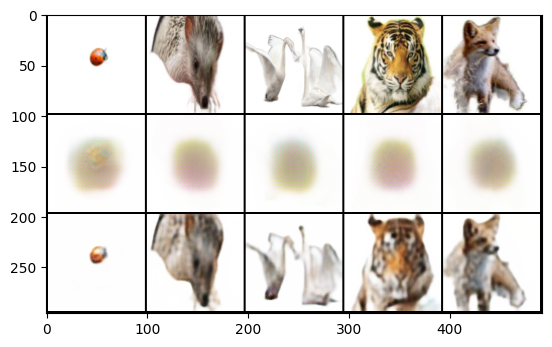

Cycle B: Real B -> Fake A -> Reconstructed B


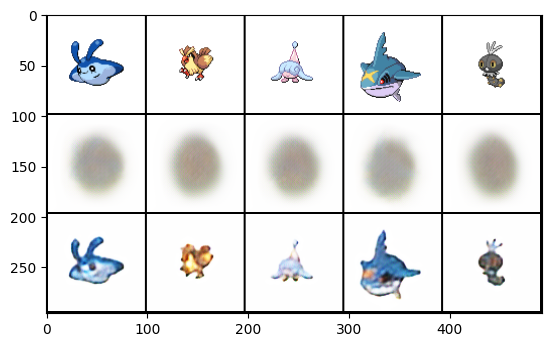

Epoch 11:
  Generator Total Loss: 10.8938
    G_AB (A->B) Loss:  6.0076
    G_BA (B->A) Loss:  4.8862
    Identity Loss:     0.0950
    GAN Loss:          0.8975
    Cycle Loss:        0.0930
    Feature Match:     0.3342
    Perceptual Loss:   0.5165
  Discriminator A Loss: 3.0874
  Discriminator B Loss: 4.7300


Epoch 12:
  Generator Total Loss: 10.3778
    G_AB (A->B) Loss:  5.7445
    G_BA (B->A) Loss:  4.6333
    Identity Loss:     0.0684
    GAN Loss:          0.8834
    Cycle Loss:        0.0731
    Feature Match:     0.3321
    Perceptual Loss:   0.5023
  Discriminator A Loss: 3.1911
  Discriminator B Loss: 1.9618


Epoch 13:
  Generator Total Loss: 10.2137
    G_AB (A->B) Loss:  5.7014
    G_BA (B->A) Loss:  4.5124
    Identity Loss:     0.0613
    GAN Loss:          0.8622
    Cycle Loss:        0.0692
    Feature Match:     0.3308
    Perceptual Loss:   0.4996
  Discriminator A Loss: 2.5569
  Discriminator B Loss: 1.8867


Epoch 14:
  Generator Total Loss: 10.7220
    G_AB (A->B) Loss:  5.8525
    G_BA (B->A) Loss:  4.8695
    Identity Loss:     0.0680
    GAN Loss:          0.9033
    Cycle Loss:        0.0725
    Feature Match:     0.3498
    Perceptual Loss:   0.5100
  Discriminator A Loss: 1.4804
  Discriminator B Loss: 1.0725


Epoch 15:
  Generator Total Loss: 10.6462
    G_AB (A->B) Loss:  5.8708
    G_BA (B->A) Loss:  4.7754
    Identity Loss:     0.0572
    GAN Loss:          0.9402
    Cycle Loss:        0.0669
    Feature Match:     0.3466
    Perceptual Loss:   0.5186
  Discriminator A Loss: 1.1341
  Discriminator B Loss: 2.0346


Epoch 16:
  Generator Total Loss: 10.4217
    G_AB (A->B) Loss:  5.8066
    G_BA (B->A) Loss:  4.6151
    Identity Loss:     0.0568
    GAN Loss:          0.9444
    Cycle Loss:        0.0653
    Feature Match:     0.3351
    Perceptual Loss:   0.5117
  Discriminator A Loss: 0.8482
  Discriminator B Loss: 2.1006


Epoch 17:
  Generator Total Loss: 10.5322
    G_AB (A->B) Loss:  5.7670
    G_BA (B->A) Loss:  4.7652
    Identity Loss:     0.0513
    GAN Loss:          0.9615
    Cycle Loss:        0.0613
    Feature Match:     0.3444
    Perceptual Loss:   0.5137
  Discriminator A Loss: 0.8030
  Discriminator B Loss: 1.0576


Epoch 18:
  Generator Total Loss: 10.6626
    G_AB (A->B) Loss:  5.7870
    G_BA (B->A) Loss:  4.8756
    Identity Loss:     0.0498
    GAN Loss:          1.0151
    Cycle Loss:        0.0596
    Feature Match:     0.3484
    Perceptual Loss:   0.5111
  Discriminator A Loss: 0.7673
  Discriminator B Loss: 0.9247


Epoch 19:
  Generator Total Loss: 10.7446
    G_AB (A->B) Loss:  5.8271
    G_BA (B->A) Loss:  4.9175
    Identity Loss:     0.0468
    GAN Loss:          1.0434
    Cycle Loss:        0.0579
    Feature Match:     0.3491
    Perceptual Loss:   0.5240
  Discriminator A Loss: 0.7100
  Discriminator B Loss: 1.1586


Epoch 20:
  Generator Total Loss: 10.7929
    G_AB (A->B) Loss:  5.8446
    G_BA (B->A) Loss:  4.9483
    Identity Loss:     0.0479
    GAN Loss:          1.0429
    Cycle Loss:        0.0598
    Feature Match:     0.3501
    Perceptual Loss:   0.5251
  Discriminator A Loss: 1.0247
  Discriminator B Loss: 0.9086


Cycle A: Real A -> Fake B -> Reconstructed A


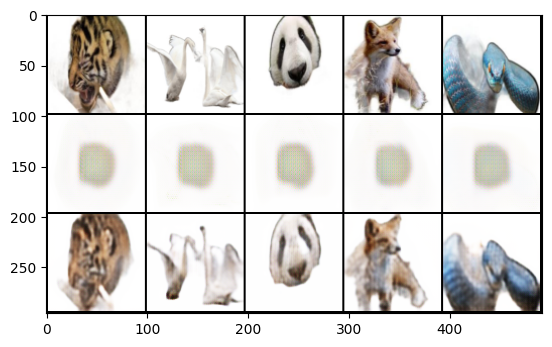

Cycle B: Real B -> Fake A -> Reconstructed B


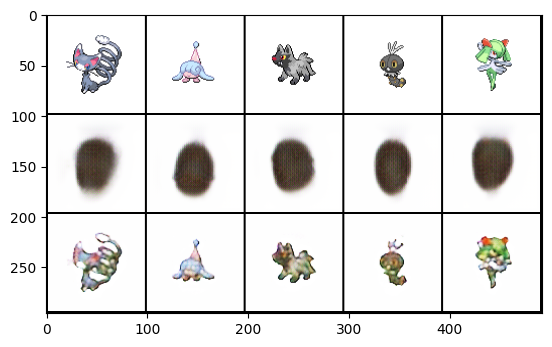

Epoch 21:
  Generator Total Loss: 10.8368
    G_AB (A->B) Loss:  5.8568
    G_BA (B->A) Loss:  4.9801
    Identity Loss:     0.0462
    GAN Loss:          1.0499
    Cycle Loss:        0.0586
    Feature Match:     0.3508
    Perceptual Loss:   0.5360
  Discriminator A Loss: 0.9357
  Discriminator B Loss: 0.8522


Epoch 22:
  Generator Total Loss: 10.8880
    G_AB (A->B) Loss:  5.8890
    G_BA (B->A) Loss:  4.9990
    Identity Loss:     0.0458
    GAN Loss:          1.0609
    Cycle Loss:        0.0580
    Feature Match:     0.3527
    Perceptual Loss:   0.5381
  Discriminator A Loss: 0.7206
  Discriminator B Loss: 0.8574


Epoch 23:
  Generator Total Loss: 10.7738
    G_AB (A->B) Loss:  5.8428
    G_BA (B->A) Loss:  4.9310
    Identity Loss:     0.0424
    GAN Loss:          1.0164
    Cycle Loss:        0.0552
    Feature Match:     0.3507
    Perceptual Loss:   0.5532
  Discriminator A Loss: 0.6784
  Discriminator B Loss: 0.8411


Epoch 24:
  Generator Total Loss: 10.7737
    G_AB (A->B) Loss:  5.7873
    G_BA (B->A) Loss:  4.9864
    Identity Loss:     0.0421
    GAN Loss:          1.0439
    Cycle Loss:        0.0553
    Feature Match:     0.3472
    Perceptual Loss:   0.5534
  Discriminator A Loss: 0.6383
  Discriminator B Loss: 0.8293


Epoch 25:
  Generator Total Loss: 10.7441
    G_AB (A->B) Loss:  5.8340
    G_BA (B->A) Loss:  4.9101
    Identity Loss:     0.0396
    GAN Loss:          1.0507
    Cycle Loss:        0.0534
    Feature Match:     0.3423
    Perceptual Loss:   0.5720
  Discriminator A Loss: 0.6263
  Discriminator B Loss: 0.7803
Model saved to models/PokeMalCycleGAN-96x96-G_AB-25-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-25-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-25-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-25-best.pth


Epoch 26:
  Generator Total Loss: 10.6903
    G_AB (A->B) Loss:  5.7347
    G_BA (B->A) Loss:  4.9556
    Identity Loss:     0.0417
    GAN Loss:          1.0593
    Cycle Loss:        0.0548
    Feature Match:     0.3380
    Perceptual Loss:   0.5641
  Discriminator A Loss: 0.6078
  Discriminator B Loss: 0.7842


Epoch 27:
  Generator Total Loss: 10.5912
    G_AB (A->B) Loss:  5.6925
    G_BA (B->A) Loss:  4.8988
    Identity Loss:     0.0381
    GAN Loss:          1.0537
    Cycle Loss:        0.0515
    Feature Match:     0.3358
    Perceptual Loss:   0.5662
  Discriminator A Loss: 0.5933
  Discriminator B Loss: 0.7685


Epoch 28:
  Generator Total Loss: 10.5753
    G_AB (A->B) Loss:  5.6799
    G_BA (B->A) Loss:  4.8954
    Identity Loss:     0.0381
    GAN Loss:          1.0548
    Cycle Loss:        0.0514
    Feature Match:     0.3355
    Perceptual Loss:   0.5629
  Discriminator A Loss: 0.5975
  Discriminator B Loss: 0.7504


Epoch 29:
  Generator Total Loss: 10.5447
    G_AB (A->B) Loss:  5.6594
    G_BA (B->A) Loss:  4.8853
    Identity Loss:     0.0379
    GAN Loss:          1.0639
    Cycle Loss:        0.0513
    Feature Match:     0.3322
    Perceptual Loss:   0.5648
  Discriminator A Loss: 0.5831
  Discriminator B Loss: 0.7379


Epoch 30:
  Generator Total Loss: 10.5247
    G_AB (A->B) Loss:  5.6583
    G_BA (B->A) Loss:  4.8665
    Identity Loss:     0.0384
    GAN Loss:          1.0669
    Cycle Loss:        0.0519
    Feature Match:     0.3299
    Perceptual Loss:   0.5650
  Discriminator A Loss: 0.5837
  Discriminator B Loss: 0.7317


Cycle A: Real A -> Fake B -> Reconstructed A


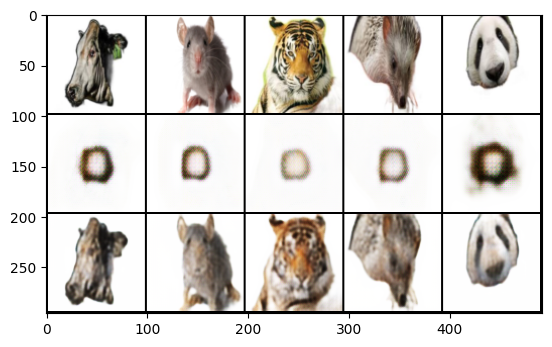

Cycle B: Real B -> Fake A -> Reconstructed B


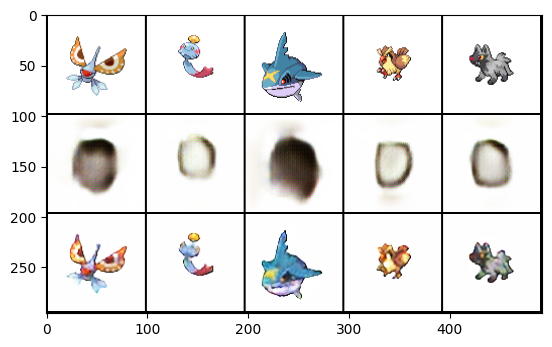

Epoch 31:
  Generator Total Loss: 10.9604
    G_AB (A->B) Loss:  5.9476
    G_BA (B->A) Loss:  5.0128
    Identity Loss:     0.0744
    GAN Loss:          0.9542
    Cycle Loss:        0.0874
    Feature Match:     0.3403
    Perceptual Loss:   0.5278
  Discriminator A Loss: 1.9739
  Discriminator B Loss: 2.8336


Epoch 32:
  Generator Total Loss: 10.0676
    G_AB (A->B) Loss:  5.5507
    G_BA (B->A) Loss:  4.5169
    Identity Loss:     0.0459
    GAN Loss:          0.9210
    Cycle Loss:        0.0605
    Feature Match:     0.3227
    Perceptual Loss:   0.5154
  Discriminator A Loss: 2.0022
  Discriminator B Loss: 1.5118


Epoch 33:
  Generator Total Loss: 10.1267
    G_AB (A->B) Loss:  5.5781
    G_BA (B->A) Loss:  4.5487
    Identity Loss:     0.0481
    GAN Loss:          0.9653
    Cycle Loss:        0.0609
    Feature Match:     0.3192
    Perceptual Loss:   0.5175
  Discriminator A Loss: 2.7935
  Discriminator B Loss: 2.2697


Epoch 34:
  Generator Total Loss: 9.7688
    G_AB (A->B) Loss:  5.2765
    G_BA (B->A) Loss:  4.4922
    Identity Loss:     0.0437
    GAN Loss:          0.9383
    Cycle Loss:        0.0567
    Feature Match:     0.3060
    Perceptual Loss:   0.5131
  Discriminator A Loss: 1.9740
  Discriminator B Loss: 1.8852


Epoch 35:
  Generator Total Loss: 10.2535
    G_AB (A->B) Loss:  5.5024
    G_BA (B->A) Loss:  4.7511
    Identity Loss:     0.0438
    GAN Loss:          1.0055
    Cycle Loss:        0.0583
    Feature Match:     0.3223
    Perceptual Loss:   0.5310
  Discriminator A Loss: 0.9963
  Discriminator B Loss: 0.9349


Epoch 36:
  Generator Total Loss: 10.5475
    G_AB (A->B) Loss:  5.6716
    G_BA (B->A) Loss:  4.8759
    Identity Loss:     0.0474
    GAN Loss:          1.0141
    Cycle Loss:        0.0604
    Feature Match:     0.3288
    Perceptual Loss:   0.5623
  Discriminator A Loss: 0.7995
  Discriminator B Loss: 0.8990


Epoch 37:
  Generator Total Loss: 10.0717
    G_AB (A->B) Loss:  5.4477
    G_BA (B->A) Loss:  4.6240
    Identity Loss:     0.0394
    GAN Loss:          0.9541
    Cycle Loss:        0.0542
    Feature Match:     0.3169
    Perceptual Loss:   0.5516
  Discriminator A Loss: 0.6948
  Discriminator B Loss: 2.9207


Epoch 38:
  Generator Total Loss: 10.2029
    G_AB (A->B) Loss:  5.5040
    G_BA (B->A) Loss:  4.6989
    Identity Loss:     0.0398
    GAN Loss:          1.0007
    Cycle Loss:        0.0551
    Feature Match:     0.3167
    Perceptual Loss:   0.5584
  Discriminator A Loss: 0.8106
  Discriminator B Loss: 1.1714


Epoch 39:
  Generator Total Loss: 10.3862
    G_AB (A->B) Loss:  5.6462
    G_BA (B->A) Loss:  4.7401
    Identity Loss:     0.0492
    GAN Loss:          1.0104
    Cycle Loss:        0.0575
    Feature Match:     0.3190
    Perceptual Loss:   0.5689
  Discriminator A Loss: 0.7436
  Discriminator B Loss: 1.1054


Epoch 40:
  Generator Total Loss: 10.5682
    G_AB (A->B) Loss:  5.7388
    G_BA (B->A) Loss:  4.8293
    Identity Loss:     0.0445
    GAN Loss:          1.0400
    Cycle Loss:        0.0593
    Feature Match:     0.3217
    Perceptual Loss:   0.5907
  Discriminator A Loss: 0.6063
  Discriminator B Loss: 1.0843


Cycle A: Real A -> Fake B -> Reconstructed A


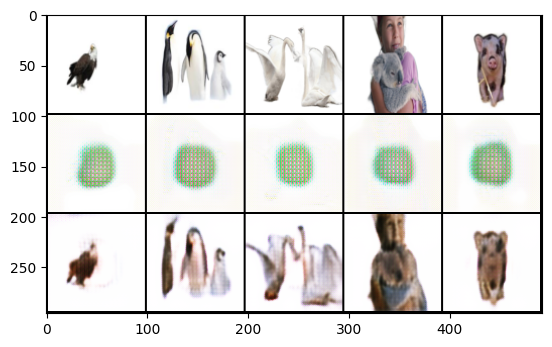

Cycle B: Real B -> Fake A -> Reconstructed B


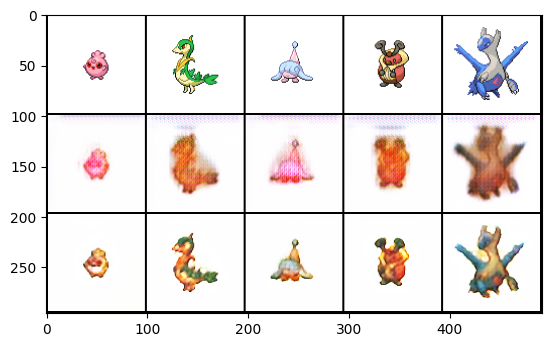

Epoch 41:
  Generator Total Loss: 10.8591
    G_AB (A->B) Loss:  5.8971
    G_BA (B->A) Loss:  4.9619
    Identity Loss:     0.0469
    GAN Loss:          1.0358
    Cycle Loss:        0.0621
    Feature Match:     0.3315
    Perceptual Loss:   0.6141
  Discriminator A Loss: 0.6819
  Discriminator B Loss: 1.0644


Epoch 42:
  Generator Total Loss: 10.4170
    G_AB (A->B) Loss:  5.6334
    G_BA (B->A) Loss:  4.7836
    Identity Loss:     0.0413
    GAN Loss:          1.0145
    Cycle Loss:        0.0559
    Feature Match:     0.3209
    Perceptual Loss:   0.5836
  Discriminator A Loss: 0.6913
  Discriminator B Loss: 1.4779


Epoch 43:
  Generator Total Loss: 10.3737
    G_AB (A->B) Loss:  5.5899
    G_BA (B->A) Loss:  4.7838
    Identity Loss:     0.0397
    GAN Loss:          1.0131
    Cycle Loss:        0.0548
    Feature Match:     0.3185
    Perceptual Loss:   0.5889
  Discriminator A Loss: 0.5876
  Discriminator B Loss: 1.6752


Epoch 44:
  Generator Total Loss: 10.5109
    G_AB (A->B) Loss:  5.6152
    G_BA (B->A) Loss:  4.8957
    Identity Loss:     0.0378
    GAN Loss:          1.0352
    Cycle Loss:        0.0533
    Feature Match:     0.3221
    Perceptual Loss:   0.6048
  Discriminator A Loss: 0.5579
  Discriminator B Loss: 0.9915


Epoch 45:
  Generator Total Loss: 10.6025
    G_AB (A->B) Loss:  5.7228
    G_BA (B->A) Loss:  4.8797
    Identity Loss:     0.0375
    GAN Loss:          1.0411
    Cycle Loss:        0.0541
    Feature Match:     0.3215
    Perceptual Loss:   0.6253
  Discriminator A Loss: 0.5609
  Discriminator B Loss: 0.8493


Epoch 46:
  Generator Total Loss: 10.5934
    G_AB (A->B) Loss:  5.7434
    G_BA (B->A) Loss:  4.8500
    Identity Loss:     0.0422
    GAN Loss:          1.0418
    Cycle Loss:        0.0576
    Feature Match:     0.3117
    Perceptual Loss:   0.6443
  Discriminator A Loss: 0.6354
  Discriminator B Loss: 0.7993


Epoch 47:
  Generator Total Loss: 10.6712
    G_AB (A->B) Loss:  5.8607
    G_BA (B->A) Loss:  4.8106
    Identity Loss:     0.0417
    GAN Loss:          1.0529
    Cycle Loss:        0.0589
    Feature Match:     0.3130
    Perceptual Loss:   0.6502
  Discriminator A Loss: 0.5618
  Discriminator B Loss: 0.6793


Epoch 48:
  Generator Total Loss: 10.6626
    G_AB (A->B) Loss:  5.8014
    G_BA (B->A) Loss:  4.8612
    Identity Loss:     0.0408
    GAN Loss:          1.0736
    Cycle Loss:        0.0578
    Feature Match:     0.3112
    Perceptual Loss:   0.6494
  Discriminator A Loss: 0.5490
  Discriminator B Loss: 0.6329


Epoch 49:
  Generator Total Loss: 10.7607
    G_AB (A->B) Loss:  5.9101
    G_BA (B->A) Loss:  4.8506
    Identity Loss:     0.0410
    GAN Loss:          1.1038
    Cycle Loss:        0.0584
    Feature Match:     0.3108
    Perceptual Loss:   0.6583
  Discriminator A Loss: 0.5537
  Discriminator B Loss: 0.5983


Epoch 50:
  Generator Total Loss: 10.6538
    G_AB (A->B) Loss:  5.8416
    G_BA (B->A) Loss:  4.8121
    Identity Loss:     0.0390
    GAN Loss:          1.0883
    Cycle Loss:        0.0563
    Feature Match:     0.3083
    Perceptual Loss:   0.6586
  Discriminator A Loss: 0.5527
  Discriminator B Loss: 0.6228


Cycle A: Real A -> Fake B -> Reconstructed A


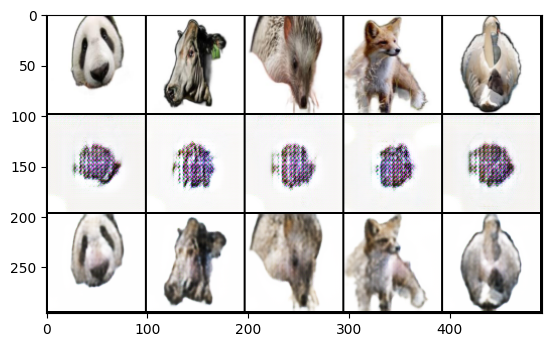

Cycle B: Real B -> Fake A -> Reconstructed B


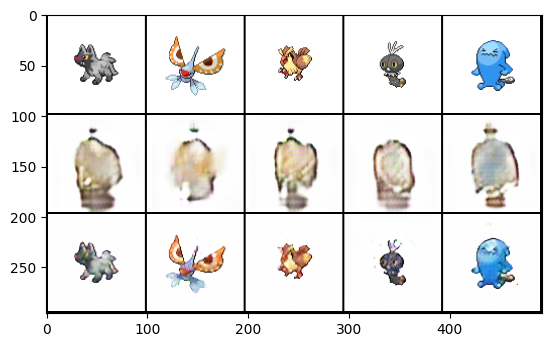

Model saved to models/PokeMalCycleGAN-96x96-G_AB-50-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-50-best.pth


Model saved to models/PokeMalCycleGAN-96x96-D_A-50-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-50-best.pth


Epoch 51:
  Generator Total Loss: 10.5788
    G_AB (A->B) Loss:  5.7981
    G_BA (B->A) Loss:  4.7807
    Identity Loss:     0.0357
    GAN Loss:          1.1031
    Cycle Loss:        0.0531
    Feature Match:     0.3049
    Perceptual Loss:   0.6606
  Discriminator A Loss: 0.5225
  Discriminator B Loss: 0.6115


Epoch 52:
  Generator Total Loss: 10.5152
    G_AB (A->B) Loss:  5.7869
    G_BA (B->A) Loss:  4.7283
    Identity Loss:     0.0339
    GAN Loss:          1.1152
    Cycle Loss:        0.0513
    Feature Match:     0.3012
    Perceptual Loss:   0.6618
  Discriminator A Loss: 0.5105
  Discriminator B Loss: 0.5895


Epoch 53:
  Generator Total Loss: 10.5172
    G_AB (A->B) Loss:  5.8281
    G_BA (B->A) Loss:  4.6891
    Identity Loss:     0.0358
    GAN Loss:          1.1255
    Cycle Loss:        0.0531
    Feature Match:     0.2988
    Perceptual Loss:   0.6583
  Discriminator A Loss: 0.5173
  Discriminator B Loss: 0.5895


Epoch 54:
  Generator Total Loss: 10.4945
    G_AB (A->B) Loss:  5.7958
    G_BA (B->A) Loss:  4.6987
    Identity Loss:     0.0355
    GAN Loss:          1.1232
    Cycle Loss:        0.0526
    Feature Match:     0.2972
    Perceptual Loss:   0.6620
  Discriminator A Loss: 0.5273
  Discriminator B Loss: 0.5961


Epoch 55:
  Generator Total Loss: 10.5008
    G_AB (A->B) Loss:  5.8250
    G_BA (B->A) Loss:  4.6759
    Identity Loss:     0.0369
    GAN Loss:          1.1201
    Cycle Loss:        0.0542
    Feature Match:     0.2962
    Perceptual Loss:   0.6624
  Discriminator A Loss: 0.5158
  Discriminator B Loss: 0.5993


Epoch 56:
  Generator Total Loss: 10.4548
    G_AB (A->B) Loss:  5.7941
    G_BA (B->A) Loss:  4.6607
    Identity Loss:     0.0357
    GAN Loss:          1.1241
    Cycle Loss:        0.0526
    Feature Match:     0.2942
    Perceptual Loss:   0.6635
  Discriminator A Loss: 0.4984
  Discriminator B Loss: 0.5842


Epoch 57:
  Generator Total Loss: 10.4081
    G_AB (A->B) Loss:  5.7876
    G_BA (B->A) Loss:  4.6204
    Identity Loss:     0.0352
    GAN Loss:          1.1308
    Cycle Loss:        0.0524
    Feature Match:     0.2916
    Perceptual Loss:   0.6600
  Discriminator A Loss: 0.4890
  Discriminator B Loss: 0.5640


Epoch 58:
  Generator Total Loss: 10.3710
    G_AB (A->B) Loss:  5.7713
    G_BA (B->A) Loss:  4.5997
    Identity Loss:     0.0344
    GAN Loss:          1.1253
    Cycle Loss:        0.0511
    Feature Match:     0.2901
    Perceptual Loss:   0.6646
  Discriminator A Loss: 0.4990
  Discriminator B Loss: 0.5707


Epoch 59:
  Generator Total Loss: 10.4076
    G_AB (A->B) Loss:  5.8360
    G_BA (B->A) Loss:  4.5716
    Identity Loss:     0.0386
    GAN Loss:          1.1231
    Cycle Loss:        0.0555
    Feature Match:     0.2875
    Perceptual Loss:   0.6660
  Discriminator A Loss: 0.5016
  Discriminator B Loss: 0.5634


Epoch 60:
  Generator Total Loss: 10.2831
    G_AB (A->B) Loss:  5.7692
    G_BA (B->A) Loss:  4.5139
    Identity Loss:     0.0322
    GAN Loss:          1.1199
    Cycle Loss:        0.0493
    Feature Match:     0.2863
    Perceptual Loss:   0.6691
  Discriminator A Loss: 0.4977
  Discriminator B Loss: 0.5591


Cycle A: Real A -> Fake B -> Reconstructed A


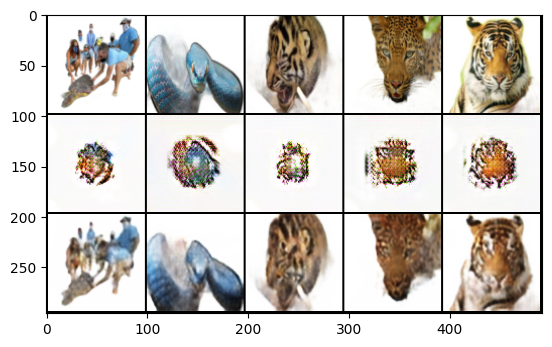

Cycle B: Real B -> Fake A -> Reconstructed B


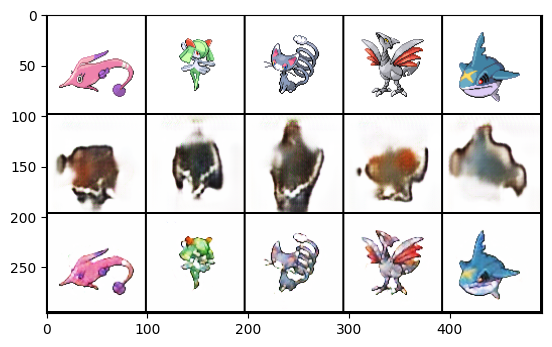

Epoch 61:
  Generator Total Loss: 10.3173
    G_AB (A->B) Loss:  5.7315
    G_BA (B->A) Loss:  4.5858
    Identity Loss:     0.0345
    GAN Loss:          1.1249
    Cycle Loss:        0.0516
    Feature Match:     0.2847
    Perceptual Loss:   0.6717
  Discriminator A Loss: 0.4892
  Discriminator B Loss: 0.5557


Epoch 62:
  Generator Total Loss: 10.2802
    G_AB (A->B) Loss:  5.7498
    G_BA (B->A) Loss:  4.5303
    Identity Loss:     0.0330
    GAN Loss:          1.1247
    Cycle Loss:        0.0503
    Feature Match:     0.2833
    Perceptual Loss:   0.6741
  Discriminator A Loss: 0.4863
  Discriminator B Loss: 0.5540


Epoch 63:
  Generator Total Loss: 10.2011
    G_AB (A->B) Loss:  5.7134
    G_BA (B->A) Loss:  4.4877
    Identity Loss:     0.0304
    GAN Loss:          1.1293
    Cycle Loss:        0.0475
    Feature Match:     0.2815
    Perceptual Loss:   0.6713
  Discriminator A Loss: 0.4863
  Discriminator B Loss: 0.5397


Epoch 64:
  Generator Total Loss: 10.2769
    G_AB (A->B) Loss:  5.7576
    G_BA (B->A) Loss:  4.5193
    Identity Loss:     0.0347
    GAN Loss:          1.1342
    Cycle Loss:        0.0518
    Feature Match:     0.2810
    Perceptual Loss:   0.6705
  Discriminator A Loss: 0.4882
  Discriminator B Loss: 0.5433


Epoch 65:
  Generator Total Loss: 10.2186
    G_AB (A->B) Loss:  5.7011
    G_BA (B->A) Loss:  4.5175
    Identity Loss:     0.0340
    GAN Loss:          1.1298
    Cycle Loss:        0.0510
    Feature Match:     0.2788
    Perceptual Loss:   0.6708
  Discriminator A Loss: 0.4865
  Discriminator B Loss: 0.5442


Epoch 66:
  Generator Total Loss: 10.2229
    G_AB (A->B) Loss:  5.7122
    G_BA (B->A) Loss:  4.5107
    Identity Loss:     0.0346
    GAN Loss:          1.1378
    Cycle Loss:        0.0514
    Feature Match:     0.2778
    Perceptual Loss:   0.6695
  Discriminator A Loss: 0.4812
  Discriminator B Loss: 0.5400


Epoch 67:
  Generator Total Loss: 10.1801
    G_AB (A->B) Loss:  5.6883
    G_BA (B->A) Loss:  4.4918
    Identity Loss:     0.0338
    GAN Loss:          1.1383
    Cycle Loss:        0.0507
    Feature Match:     0.2754
    Perceptual Loss:   0.6715
  Discriminator A Loss: 0.4784
  Discriminator B Loss: 0.5345


Epoch 68:
  Generator Total Loss: 10.1171
    G_AB (A->B) Loss:  5.6525
    G_BA (B->A) Loss:  4.4646
    Identity Loss:     0.0318
    GAN Loss:          1.1396
    Cycle Loss:        0.0487
    Feature Match:     0.2739
    Perceptual Loss:   0.6704
  Discriminator A Loss: 0.4774
  Discriminator B Loss: 0.5298


Epoch 69:
  Generator Total Loss: 10.1663
    G_AB (A->B) Loss:  5.6899
    G_BA (B->A) Loss:  4.4764
    Identity Loss:     0.0341
    GAN Loss:          1.1409
    Cycle Loss:        0.0508
    Feature Match:     0.2744
    Perceptual Loss:   0.6701
  Discriminator A Loss: 0.4787
  Discriminator B Loss: 0.5300


Epoch 70:
  Generator Total Loss: 10.2301
    G_AB (A->B) Loss:  5.7338
    G_BA (B->A) Loss:  4.4962
    Identity Loss:     0.0371
    GAN Loss:          1.1435
    Cycle Loss:        0.0539
    Feature Match:     0.2747
    Perceptual Loss:   0.6698
  Discriminator A Loss: 0.4819
  Discriminator B Loss: 0.5295


Cycle A: Real A -> Fake B -> Reconstructed A


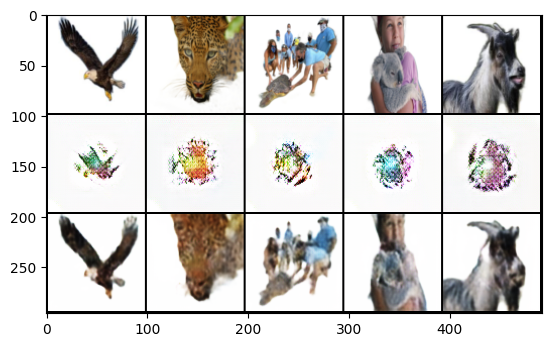

Cycle B: Real B -> Fake A -> Reconstructed B


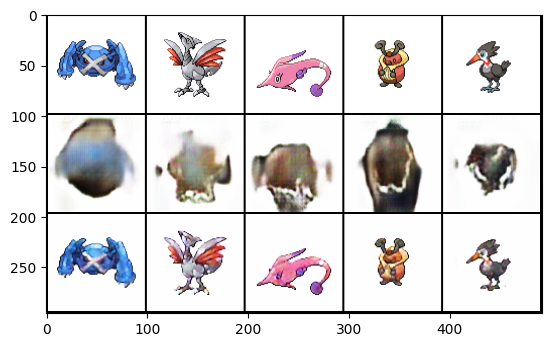

Epoch 71:
  Generator Total Loss: 9.8056
    G_AB (A->B) Loss:  5.4064
    G_BA (B->A) Loss:  4.3992
    Identity Loss:     0.0466
    GAN Loss:          0.9347
    Cycle Loss:        0.0661
    Feature Match:     0.2983
    Perceptual Loss:   0.5226
  Discriminator A Loss: 2.5301
  Discriminator B Loss: 3.1860


Epoch 72:
  Generator Total Loss: 9.5654
    G_AB (A->B) Loss:  5.2551
    G_BA (B->A) Loss:  4.3103
    Identity Loss:     0.0413
    GAN Loss:          0.9282
    Cycle Loss:        0.0568
    Feature Match:     0.2833
    Perceptual Loss:   0.5617
  Discriminator A Loss: 1.7139
  Discriminator B Loss: 1.0193


Epoch 73:
  Generator Total Loss: 10.1859
    G_AB (A->B) Loss:  5.4965
    G_BA (B->A) Loss:  4.6894
    Identity Loss:     0.0591
    GAN Loss:          0.9549
    Cycle Loss:        0.0664
    Feature Match:     0.2904
    Perceptual Loss:   0.6194
  Discriminator A Loss: 0.7564
  Discriminator B Loss: 0.9736


Epoch 74:
  Generator Total Loss: 10.2112
    G_AB (A->B) Loss:  5.6387
    G_BA (B->A) Loss:  4.5725
    Identity Loss:     0.0455
    GAN Loss:          0.9758
    Cycle Loss:        0.0597
    Feature Match:     0.2939
    Perceptual Loss:   0.6421
  Discriminator A Loss: 0.6953
  Discriminator B Loss: 0.8237


Epoch 75:
  Generator Total Loss: 10.1948
    G_AB (A->B) Loss:  5.6192
    G_BA (B->A) Loss:  4.5756
    Identity Loss:     0.0408
    GAN Loss:          1.0054
    Cycle Loss:        0.0571
    Feature Match:     0.2899
    Perceptual Loss:   0.6541
  Discriminator A Loss: 0.7501
  Discriminator B Loss: 0.8612
Model saved to models/PokeMalCycleGAN-96x96-G_AB-75-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-75-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-75-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-75-best.pth


Epoch 76:
  Generator Total Loss: 10.2996
    G_AB (A->B) Loss:  5.6466
    G_BA (B->A) Loss:  4.6530
    Identity Loss:     0.0391
    GAN Loss:          1.0306
    Cycle Loss:        0.0565
    Feature Match:     0.2909
    Perceptual Loss:   0.6678
  Discriminator A Loss: 0.6195
  Discriminator B Loss: 0.6439


Epoch 77:
  Generator Total Loss: 10.1850
    G_AB (A->B) Loss:  5.6364
    G_BA (B->A) Loss:  4.5486
    Identity Loss:     0.0412
    GAN Loss:          1.0219
    Cycle Loss:        0.0579
    Feature Match:     0.2842
    Perceptual Loss:   0.6628
  Discriminator A Loss: 0.9563
  Discriminator B Loss: 0.7458


Epoch 78:
  Generator Total Loss: 10.2616
    G_AB (A->B) Loss:  5.6688
    G_BA (B->A) Loss:  4.5928
    Identity Loss:     0.0356
    GAN Loss:          1.0422
    Cycle Loss:        0.0534
    Feature Match:     0.2901
    Perceptual Loss:   0.6700
  Discriminator A Loss: 0.6299
  Discriminator B Loss: 0.5986


Epoch 79:
  Generator Total Loss: 10.3445
    G_AB (A->B) Loss:  5.6802
    G_BA (B->A) Loss:  4.6643
    Identity Loss:     0.0402
    GAN Loss:          1.0603
    Cycle Loss:        0.0576
    Feature Match:     0.2870
    Perceptual Loss:   0.6745
  Discriminator A Loss: 0.5799
  Discriminator B Loss: 0.6144


Epoch 80:
  Generator Total Loss: 10.3608
    G_AB (A->B) Loss:  5.6872
    G_BA (B->A) Loss:  4.6736
    Identity Loss:     0.0374
    GAN Loss:          1.0802
    Cycle Loss:        0.0558
    Feature Match:     0.2859
    Perceptual Loss:   0.6828
  Discriminator A Loss: 0.5599
  Discriminator B Loss: 0.5627


Cycle A: Real A -> Fake B -> Reconstructed A


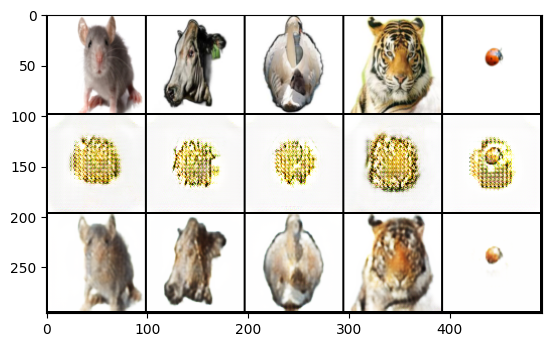

Cycle B: Real B -> Fake A -> Reconstructed B


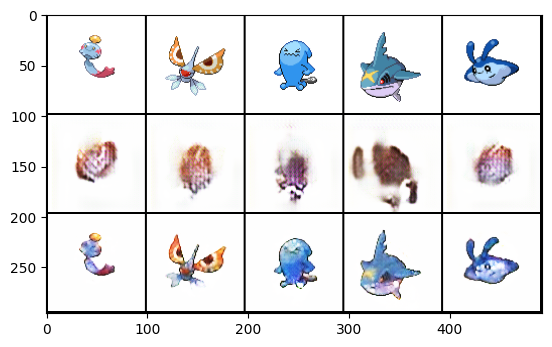

Epoch 81:
  Generator Total Loss: 10.3148
    G_AB (A->B) Loss:  5.6950
    G_BA (B->A) Loss:  4.6197
    Identity Loss:     0.0364
    GAN Loss:          1.0931
    Cycle Loss:        0.0544
    Feature Match:     0.2829
    Perceptual Loss:   0.6826
  Discriminator A Loss: 0.5352
  Discriminator B Loss: 0.5415


Epoch 82:
  Generator Total Loss: 10.3361
    G_AB (A->B) Loss:  5.7175
    G_BA (B->A) Loss:  4.6186
    Identity Loss:     0.0374
    GAN Loss:          1.0901
    Cycle Loss:        0.0551
    Feature Match:     0.2835
    Perceptual Loss:   0.6834
  Discriminator A Loss: 0.6001
  Discriminator B Loss: 0.6779


Epoch 83:
  Generator Total Loss: 10.3695
    G_AB (A->B) Loss:  5.7015
    G_BA (B->A) Loss:  4.6680
    Identity Loss:     0.0404
    GAN Loss:          1.1015
    Cycle Loss:        0.0581
    Feature Match:     0.2810
    Perceptual Loss:   0.6825
  Discriminator A Loss: 0.5131
  Discriminator B Loss: 0.5720


Epoch 84:
  Generator Total Loss: 10.4003
    G_AB (A->B) Loss:  5.7328
    G_BA (B->A) Loss:  4.6674
    Identity Loss:     0.0409
    GAN Loss:          1.1057
    Cycle Loss:        0.0587
    Feature Match:     0.2826
    Perceptual Loss:   0.6796
  Discriminator A Loss: 0.5157
  Discriminator B Loss: 0.5485


Epoch 85:
  Generator Total Loss: 10.4417
    G_AB (A->B) Loss:  5.7210
    G_BA (B->A) Loss:  4.7207
    Identity Loss:     0.0378
    GAN Loss:          1.1422
    Cycle Loss:        0.0558
    Feature Match:     0.2833
    Perceptual Loss:   0.6818
  Discriminator A Loss: 0.5044
  Discriminator B Loss: 0.5150


Epoch 86:
  Generator Total Loss: 10.3818
    G_AB (A->B) Loss:  5.6776
    G_BA (B->A) Loss:  4.7042
    Identity Loss:     0.0376
    GAN Loss:          1.1306
    Cycle Loss:        0.0554
    Feature Match:     0.2817
    Perceptual Loss:   0.6808
  Discriminator A Loss: 0.5082
  Discriminator B Loss: 0.5282


Epoch 87:
  Generator Total Loss: 10.4081
    G_AB (A->B) Loss:  5.7073
    G_BA (B->A) Loss:  4.7008
    Identity Loss:     0.0384
    GAN Loss:          1.1425
    Cycle Loss:        0.0555
    Feature Match:     0.2812
    Perceptual Loss:   0.6819
  Discriminator A Loss: 0.5082
  Discriminator B Loss: 0.5050


Epoch 88:
  Generator Total Loss: 10.1871
    G_AB (A->B) Loss:  5.6028
    G_BA (B->A) Loss:  4.5843
    Identity Loss:     0.0389
    GAN Loss:          1.1184
    Cycle Loss:        0.0567
    Feature Match:     0.2708
    Perceptual Loss:   0.6759
  Discriminator A Loss: 0.4977
  Discriminator B Loss: 0.6886


Epoch 89:
  Generator Total Loss: 10.3211
    G_AB (A->B) Loss:  5.6976
    G_BA (B->A) Loss:  4.6235
    Identity Loss:     0.0367
    GAN Loss:          1.1409
    Cycle Loss:        0.0540
    Feature Match:     0.2773
    Perceptual Loss:   0.6834
  Discriminator A Loss: 0.4906
  Discriminator B Loss: 0.5276


Epoch 90:
  Generator Total Loss: 10.3409
    G_AB (A->B) Loss:  5.7057
    G_BA (B->A) Loss:  4.6352
    Identity Loss:     0.0372
    GAN Loss:          1.1523
    Cycle Loss:        0.0549
    Feature Match:     0.2772
    Perceptual Loss:   0.6797
  Discriminator A Loss: 0.4967
  Discriminator B Loss: 0.5016


Cycle A: Real A -> Fake B -> Reconstructed A


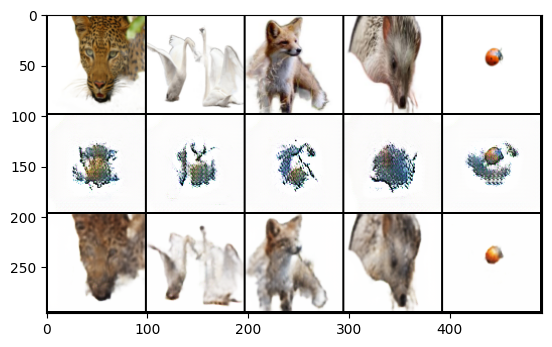

Cycle B: Real B -> Fake A -> Reconstructed B


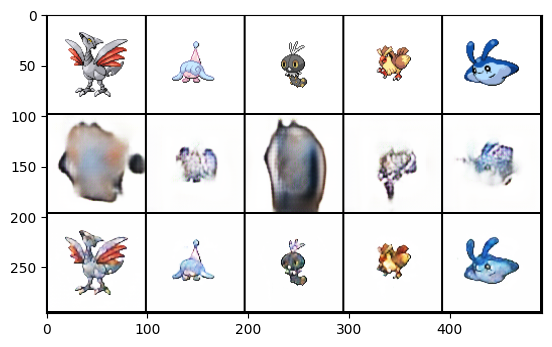

Epoch 91:
  Generator Total Loss: 10.3453
    G_AB (A->B) Loss:  5.6799
    G_BA (B->A) Loss:  4.6654
    Identity Loss:     0.0377
    GAN Loss:          1.1569
    Cycle Loss:        0.0556
    Feature Match:     0.2767
    Perceptual Loss:   0.6778
  Discriminator A Loss: 0.4931
  Discriminator B Loss: 0.4972


Epoch 92:
  Generator Total Loss: 10.4410
    G_AB (A->B) Loss:  5.7412
    G_BA (B->A) Loss:  4.6998
    Identity Loss:     0.0386
    GAN Loss:          1.1735
    Cycle Loss:        0.0570
    Feature Match:     0.2787
    Perceptual Loss:   0.6796
  Discriminator A Loss: 0.4921
  Discriminator B Loss: 0.4747


Epoch 93:
  Generator Total Loss: 10.3533
    G_AB (A->B) Loss:  5.6915
    G_BA (B->A) Loss:  4.6618
    Identity Loss:     0.0369
    GAN Loss:          1.1679
    Cycle Loss:        0.0553
    Feature Match:     0.2766
    Perceptual Loss:   0.6768
  Discriminator A Loss: 0.4856
  Discriminator B Loss: 0.4751


Epoch 94:
  Generator Total Loss: 10.3547
    G_AB (A->B) Loss:  5.6968
    G_BA (B->A) Loss:  4.6580
    Identity Loss:     0.0366
    GAN Loss:          1.1832
    Cycle Loss:        0.0551
    Feature Match:     0.2755
    Perceptual Loss:   0.6747
  Discriminator A Loss: 0.4918
  Discriminator B Loss: 0.4684


Epoch 95:
  Generator Total Loss: 10.4168
    G_AB (A->B) Loss:  5.7337
    G_BA (B->A) Loss:  4.6832
    Identity Loss:     0.0370
    GAN Loss:          1.1963
    Cycle Loss:        0.0560
    Feature Match:     0.2765
    Perceptual Loss:   0.6764
  Discriminator A Loss: 0.4859
  Discriminator B Loss: 0.4512


Epoch 96:
  Generator Total Loss: 10.2689
    G_AB (A->B) Loss:  5.6432
    G_BA (B->A) Loss:  4.6257
    Identity Loss:     0.0376
    GAN Loss:          1.1654
    Cycle Loss:        0.0562
    Feature Match:     0.2715
    Perceptual Loss:   0.6733
  Discriminator A Loss: 0.6676
  Discriminator B Loss: 0.4636


Epoch 97:
  Generator Total Loss: 10.2162
    G_AB (A->B) Loss:  5.5769
    G_BA (B->A) Loss:  4.6393
    Identity Loss:     0.0343
    GAN Loss:          1.1784
    Cycle Loss:        0.0531
    Feature Match:     0.2690
    Perceptual Loss:   0.6781
  Discriminator A Loss: 0.5013
  Discriminator B Loss: 0.4527


Epoch 98:
  Generator Total Loss: 10.2817
    G_AB (A->B) Loss:  5.5884
    G_BA (B->A) Loss:  4.6933
    Identity Loss:     0.0351
    GAN Loss:          1.1879
    Cycle Loss:        0.0544
    Feature Match:     0.2701
    Perceptual Loss:   0.6799
  Discriminator A Loss: 0.4807
  Discriminator B Loss: 0.4569


Epoch 99:
  Generator Total Loss: 10.1821
    G_AB (A->B) Loss:  5.5966
    G_BA (B->A) Loss:  4.5855
    Identity Loss:     0.0394
    GAN Loss:          1.1808
    Cycle Loss:        0.0581
    Feature Match:     0.2613
    Perceptual Loss:   0.6765
  Discriminator A Loss: 0.4831
  Discriminator B Loss: 0.5145


Epoch 100:
  Generator Total Loss: 10.3219
    G_AB (A->B) Loss:  5.6938
    G_BA (B->A) Loss:  4.6281
    Identity Loss:     0.0385
    GAN Loss:          1.2110
    Cycle Loss:        0.0577
    Feature Match:     0.2672
    Perceptual Loss:   0.6751
  Discriminator A Loss: 0.4701
  Discriminator B Loss: 0.4554


Cycle A: Real A -> Fake B -> Reconstructed A


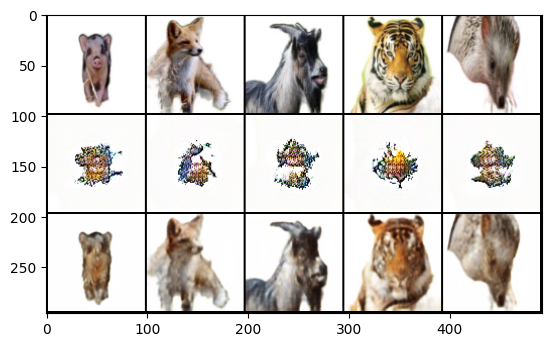

Cycle B: Real B -> Fake A -> Reconstructed B


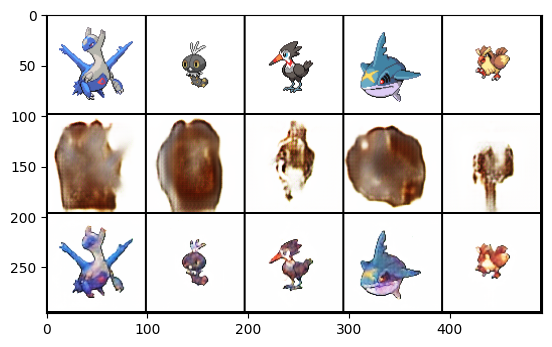

Model saved to models/PokeMalCycleGAN-96x96-G_AB-100-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-100-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-100-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-100-best.pth


Epoch 101:
  Generator Total Loss: 10.2581
    G_AB (A->B) Loss:  5.6113
    G_BA (B->A) Loss:  4.6468
    Identity Loss:     0.0366
    GAN Loss:          1.2086
    Cycle Loss:        0.0555
    Feature Match:     0.2661
    Perceptual Loss:   0.6744
  Discriminator A Loss: 0.4715
  Discriminator B Loss: 0.4542


Epoch 102:
  Generator Total Loss: 10.3348
    G_AB (A->B) Loss:  5.6369
    G_BA (B->A) Loss:  4.6979
    Identity Loss:     0.0400
    GAN Loss:          1.2076
    Cycle Loss:        0.0589
    Feature Match:     0.2669
    Perceptual Loss:   0.6756
  Discriminator A Loss: 0.4726
  Discriminator B Loss: 0.4546


Epoch 103:
  Generator Total Loss: 10.2825
    G_AB (A->B) Loss:  5.6384
    G_BA (B->A) Loss:  4.6441
    Identity Loss:     0.0372
    GAN Loss:          1.2139
    Cycle Loss:        0.0560
    Feature Match:     0.2664
    Perceptual Loss:   0.6744
  Discriminator A Loss: 0.4765
  Discriminator B Loss: 0.4396


Epoch 104:
  Generator Total Loss: 10.2387
    G_AB (A->B) Loss:  5.6062
    G_BA (B->A) Loss:  4.6326
    Identity Loss:     0.0333
    GAN Loss:          1.2131
    Cycle Loss:        0.0528
    Feature Match:     0.2678
    Perceptual Loss:   0.6735
  Discriminator A Loss: 0.4726
  Discriminator B Loss: 0.4392


Epoch 105:
  Generator Total Loss: 10.2457
    G_AB (A->B) Loss:  5.6102
    G_BA (B->A) Loss:  4.6355
    Identity Loss:     0.0346
    GAN Loss:          1.2148
    Cycle Loss:        0.0538
    Feature Match:     0.2655
    Perceptual Loss:   0.6786
  Discriminator A Loss: 0.4695
  Discriminator B Loss: 0.4384


Epoch 106:
  Generator Total Loss: 10.2382
    G_AB (A->B) Loss:  5.6154
    G_BA (B->A) Loss:  4.6228
    Identity Loss:     0.0349
    GAN Loss:          1.2193
    Cycle Loss:        0.0544
    Feature Match:     0.2657
    Perceptual Loss:   0.6714
  Discriminator A Loss: 0.4684
  Discriminator B Loss: 0.4362


Epoch 107:
  Generator Total Loss: 10.2636
    G_AB (A->B) Loss:  5.5892
    G_BA (B->A) Loss:  4.6744
    Identity Loss:     0.0333
    GAN Loss:          1.2321
    Cycle Loss:        0.0535
    Feature Match:     0.2653
    Perceptual Loss:   0.6783
  Discriminator A Loss: 0.4597
  Discriminator B Loss: 0.4379


Epoch 108:
  Generator Total Loss: 10.3298
    G_AB (A->B) Loss:  5.6484
    G_BA (B->A) Loss:  4.6813
    Identity Loss:     0.0353
    GAN Loss:          1.2371
    Cycle Loss:        0.0549
    Feature Match:     0.2678
    Perceptual Loss:   0.6750
  Discriminator A Loss: 0.4663
  Discriminator B Loss: 0.4363


Epoch 109:
  Generator Total Loss: 10.3508
    G_AB (A->B) Loss:  5.6939
    G_BA (B->A) Loss:  4.6570
    Identity Loss:     0.0396
    GAN Loss:          1.2425
    Cycle Loss:        0.0593
    Feature Match:     0.2645
    Perceptual Loss:   0.6711
  Discriminator A Loss: 0.4662
  Discriminator B Loss: 0.4360


Epoch 110:
  Generator Total Loss: 10.1719
    G_AB (A->B) Loss:  5.5706
    G_BA (B->A) Loss:  4.6013
    Identity Loss:     0.0326
    GAN Loss:          1.2256
    Cycle Loss:        0.0526
    Feature Match:     0.2615
    Perceptual Loss:   0.6773
  Discriminator A Loss: 0.4640
  Discriminator B Loss: 0.4334


Cycle A: Real A -> Fake B -> Reconstructed A


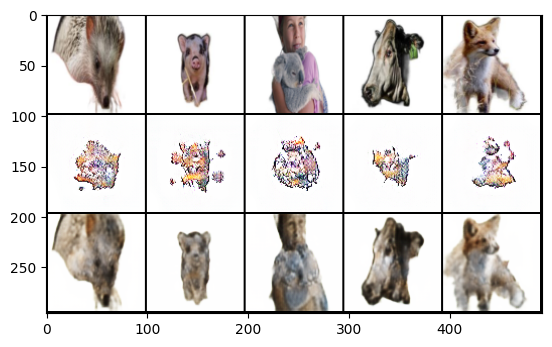

Cycle B: Real B -> Fake A -> Reconstructed B


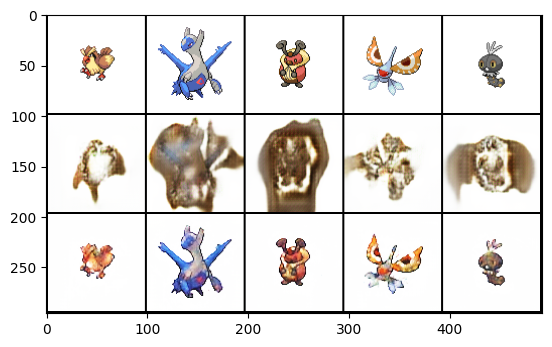

Epoch 111:
  Generator Total Loss: 10.2505
    G_AB (A->B) Loss:  5.5955
    G_BA (B->A) Loss:  4.6550
    Identity Loss:     0.0353
    GAN Loss:          1.2389
    Cycle Loss:        0.0553
    Feature Match:     0.2623
    Perceptual Loss:   0.6751
  Discriminator A Loss: 0.4603
  Discriminator B Loss: 0.4341


Epoch 112:
  Generator Total Loss: 10.2339
    G_AB (A->B) Loss:  5.6062
    G_BA (B->A) Loss:  4.6276
    Identity Loss:     0.0341
    GAN Loss:          1.2439
    Cycle Loss:        0.0542
    Feature Match:     0.2618
    Perceptual Loss:   0.6756
  Discriminator A Loss: 0.4625
  Discriminator B Loss: 0.4312


Epoch 113:
  Generator Total Loss: 10.2670
    G_AB (A->B) Loss:  5.6186
    G_BA (B->A) Loss:  4.6485
    Identity Loss:     0.0345
    GAN Loss:          1.2468
    Cycle Loss:        0.0544
    Feature Match:     0.2636
    Perceptual Loss:   0.6737
  Discriminator A Loss: 0.4579
  Discriminator B Loss: 0.4284


Epoch 114:
  Generator Total Loss: 10.3165
    G_AB (A->B) Loss:  5.6314
    G_BA (B->A) Loss:  4.6851
    Identity Loss:     0.0356
    GAN Loss:          1.2501
    Cycle Loss:        0.0561
    Feature Match:     0.2638
    Perceptual Loss:   0.6771
  Discriminator A Loss: 0.4593
  Discriminator B Loss: 0.4301


Epoch 115:
  Generator Total Loss: 10.0742
    G_AB (A->B) Loss:  5.5385
    G_BA (B->A) Loss:  4.5357
    Identity Loss:     0.0334
    GAN Loss:          1.2320
    Cycle Loss:        0.0532
    Feature Match:     0.2549
    Perceptual Loss:   0.6733
  Discriminator A Loss: 0.4568
  Discriminator B Loss: 0.4789


Epoch 116:
  Generator Total Loss: 10.1151
    G_AB (A->B) Loss:  5.5730
    G_BA (B->A) Loss:  4.5420
    Identity Loss:     0.0359
    GAN Loss:          1.2250
    Cycle Loss:        0.0556
    Feature Match:     0.2554
    Perceptual Loss:   0.6740
  Discriminator A Loss: 0.5247
  Discriminator B Loss: 0.4332


Epoch 117:
  Generator Total Loss: 9.9834
    G_AB (A->B) Loss:  5.4545
    G_BA (B->A) Loss:  4.5289
    Identity Loss:     0.0322
    GAN Loss:          1.2130
    Cycle Loss:        0.0516
    Feature Match:     0.2520
    Perceptual Loss:   0.6784
  Discriminator A Loss: 0.4875
  Discriminator B Loss: 0.4249


Epoch 118:
  Generator Total Loss: 10.0473
    G_AB (A->B) Loss:  5.5010
    G_BA (B->A) Loss:  4.5462
    Identity Loss:     0.0316
    GAN Loss:          1.2405
    Cycle Loss:        0.0511
    Feature Match:     0.2537
    Perceptual Loss:   0.6763
  Discriminator A Loss: 0.4650
  Discriminator B Loss: 0.4237


Epoch 119:
  Generator Total Loss: 10.1457
    G_AB (A->B) Loss:  5.5321
    G_BA (B->A) Loss:  4.6136
    Identity Loss:     0.0345
    GAN Loss:          1.2337
    Cycle Loss:        0.0535
    Feature Match:     0.2573
    Perceptual Loss:   0.6781
  Discriminator A Loss: 0.4698
  Discriminator B Loss: 0.4290


Epoch 120:
  Generator Total Loss: 10.1692
    G_AB (A->B) Loss:  5.5670
    G_BA (B->A) Loss:  4.6022
    Identity Loss:     0.0336
    GAN Loss:          1.2424
    Cycle Loss:        0.0529
    Feature Match:     0.2587
    Perceptual Loss:   0.6774
  Discriminator A Loss: 0.4679
  Discriminator B Loss: 0.4217


Cycle A: Real A -> Fake B -> Reconstructed A


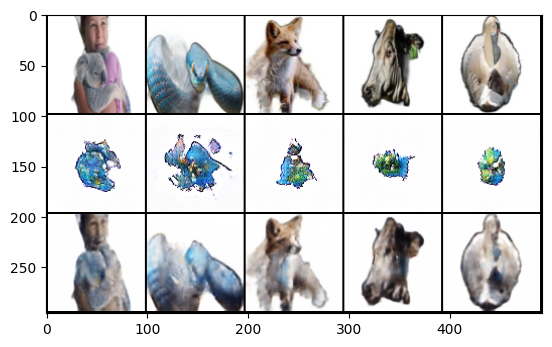

Cycle B: Real B -> Fake A -> Reconstructed B


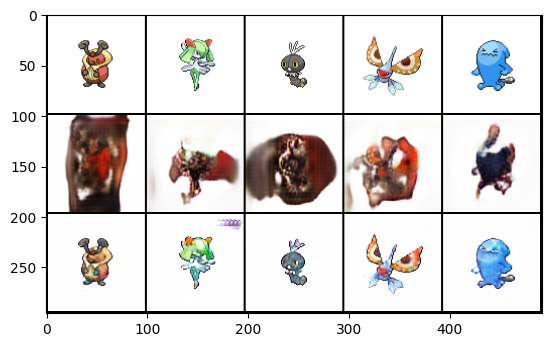

Epoch 121:
  Generator Total Loss: 10.1336
    G_AB (A->B) Loss:  5.5336
    G_BA (B->A) Loss:  4.6000
    Identity Loss:     0.0347
    GAN Loss:          1.2318
    Cycle Loss:        0.0544
    Feature Match:     0.2577
    Perceptual Loss:   0.6714
  Discriminator A Loss: 0.4672
  Discriminator B Loss: 0.4254


Epoch 122:
  Generator Total Loss: 10.1341
    G_AB (A->B) Loss:  5.5512
    G_BA (B->A) Loss:  4.5829
    Identity Loss:     0.0338
    GAN Loss:          1.2437
    Cycle Loss:        0.0534
    Feature Match:     0.2559
    Perceptual Loss:   0.6771
  Discriminator A Loss: 0.4684
  Discriminator B Loss: 0.4199


Epoch 123:
  Generator Total Loss: 10.1753
    G_AB (A->B) Loss:  5.5631
    G_BA (B->A) Loss:  4.6123
    Identity Loss:     0.0337
    GAN Loss:          1.2742
    Cycle Loss:        0.0532
    Feature Match:     0.2566
    Perceptual Loss:   0.6701
  Discriminator A Loss: 0.4583
  Discriminator B Loss: 0.4145


Epoch 124:
  Generator Total Loss: 10.1631
    G_AB (A->B) Loss:  5.5490
    G_BA (B->A) Loss:  4.6141
    Identity Loss:     0.0355
    GAN Loss:          1.2463
    Cycle Loss:        0.0549
    Feature Match:     0.2559
    Perceptual Loss:   0.6763
  Discriminator A Loss: 0.4651
  Discriminator B Loss: 0.4208


Epoch 125:
  Generator Total Loss: 10.0411
    G_AB (A->B) Loss:  5.4752
    G_BA (B->A) Loss:  4.5659
    Identity Loss:     0.0299
    GAN Loss:          1.2430
    Cycle Loss:        0.0497
    Feature Match:     0.2544
    Perceptual Loss:   0.6772
  Discriminator A Loss: 0.4660
  Discriminator B Loss: 0.4196
Model saved to models/PokeMalCycleGAN-96x96-G_AB-125-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-125-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-125-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-125-best.pth


Epoch 126:
  Generator Total Loss: 10.0934
    G_AB (A->B) Loss:  5.5178
    G_BA (B->A) Loss:  4.5755
    Identity Loss:     0.0317
    GAN Loss:          1.2531
    Cycle Loss:        0.0514
    Feature Match:     0.2550
    Perceptual Loss:   0.6748
  Discriminator A Loss: 0.4649
  Discriminator B Loss: 0.4173


Epoch 127:
  Generator Total Loss: 10.1169
    G_AB (A->B) Loss:  5.4952
    G_BA (B->A) Loss:  4.6217
    Identity Loss:     0.0323
    GAN Loss:          1.2655
    Cycle Loss:        0.0519
    Feature Match:     0.2542
    Perceptual Loss:   0.6756
  Discriminator A Loss: 0.4612
  Discriminator B Loss: 0.4137


Epoch 128:
  Generator Total Loss: 10.1411
    G_AB (A->B) Loss:  5.5404
    G_BA (B->A) Loss:  4.6006
    Identity Loss:     0.0333
    GAN Loss:          1.2677
    Cycle Loss:        0.0527
    Feature Match:     0.2550
    Perceptual Loss:   0.6733
  Discriminator A Loss: 0.4663
  Discriminator B Loss: 0.4115


Epoch 129:
  Generator Total Loss: 10.1064
    G_AB (A->B) Loss:  5.5324
    G_BA (B->A) Loss:  4.5739
    Identity Loss:     0.0331
    GAN Loss:          1.2632
    Cycle Loss:        0.0534
    Feature Match:     0.2528
    Perceptual Loss:   0.6741
  Discriminator A Loss: 0.4630
  Discriminator B Loss: 0.4124


Epoch 130:
  Generator Total Loss: 10.1052
    G_AB (A->B) Loss:  5.5270
    G_BA (B->A) Loss:  4.5783
    Identity Loss:     0.0339
    GAN Loss:          1.2709
    Cycle Loss:        0.0535
    Feature Match:     0.2517
    Perceptual Loss:   0.6728
  Discriminator A Loss: 0.4644
  Discriminator B Loss: 0.4122


Cycle A: Real A -> Fake B -> Reconstructed A


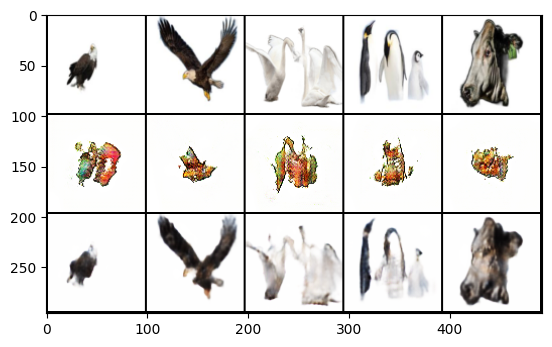

Cycle B: Real B -> Fake A -> Reconstructed B


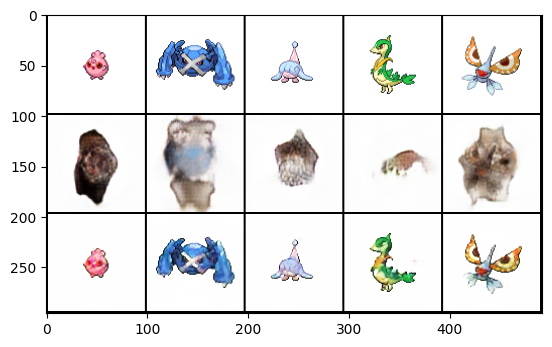

Epoch 131:
  Generator Total Loss: 10.0818
    G_AB (A->B) Loss:  5.5127
    G_BA (B->A) Loss:  4.5691
    Identity Loss:     0.0320
    GAN Loss:          1.2749
    Cycle Loss:        0.0520
    Feature Match:     0.2517
    Perceptual Loss:   0.6723
  Discriminator A Loss: 0.4588
  Discriminator B Loss: 0.4106


Epoch 132:
  Generator Total Loss: 10.0491
    G_AB (A->B) Loss:  5.4716
    G_BA (B->A) Loss:  4.5775
    Identity Loss:     0.0323
    GAN Loss:          1.2762
    Cycle Loss:        0.0519
    Feature Match:     0.2503
    Perceptual Loss:   0.6688
  Discriminator A Loss: 0.4561
  Discriminator B Loss: 0.4100


Epoch 133:
  Generator Total Loss: 10.0343
    G_AB (A->B) Loss:  5.4946
    G_BA (B->A) Loss:  4.5397
    Identity Loss:     0.0306
    GAN Loss:          1.2680
    Cycle Loss:        0.0504
    Feature Match:     0.2510
    Perceptual Loss:   0.6734
  Discriminator A Loss: 0.4602
  Discriminator B Loss: 0.4097


Epoch 134:
  Generator Total Loss: 10.0527
    G_AB (A->B) Loss:  5.5043
    G_BA (B->A) Loss:  4.5484
    Identity Loss:     0.0289
    GAN Loss:          1.2805
    Cycle Loss:        0.0489
    Feature Match:     0.2527
    Perceptual Loss:   0.6722
  Discriminator A Loss: 0.4580
  Discriminator B Loss: 0.4060


Epoch 135:
  Generator Total Loss: 10.0105
    G_AB (A->B) Loss:  5.4749
    G_BA (B->A) Loss:  4.5356
    Identity Loss:     0.0297
    GAN Loss:          1.2696
    Cycle Loss:        0.0496
    Feature Match:     0.2510
    Perceptual Loss:   0.6705
  Discriminator A Loss: 0.4620
  Discriminator B Loss: 0.4072


Epoch 136:
  Generator Total Loss: 10.0819
    G_AB (A->B) Loss:  5.5216
    G_BA (B->A) Loss:  4.5602
    Identity Loss:     0.0326
    GAN Loss:          1.2719
    Cycle Loss:        0.0523
    Feature Match:     0.2517
    Perceptual Loss:   0.6720
  Discriminator A Loss: 0.4645
  Discriminator B Loss: 0.4069


Epoch 137:
  Generator Total Loss: 10.0482
    G_AB (A->B) Loss:  5.4714
    G_BA (B->A) Loss:  4.5768
    Identity Loss:     0.0300
    GAN Loss:          1.2902
    Cycle Loss:        0.0501
    Feature Match:     0.2506
    Perceptual Loss:   0.6691
  Discriminator A Loss: 0.4510
  Discriminator B Loss: 0.4090


Epoch 138:
  Generator Total Loss: 10.0575
    G_AB (A->B) Loss:  5.4642
    G_BA (B->A) Loss:  4.5934
    Identity Loss:     0.0314
    GAN Loss:          1.2793
    Cycle Loss:        0.0514
    Feature Match:     0.2510
    Perceptual Loss:   0.6696
  Discriminator A Loss: 0.4589
  Discriminator B Loss: 0.4094


Epoch 139:
  Generator Total Loss: 10.0622
    G_AB (A->B) Loss:  5.5166
    G_BA (B->A) Loss:  4.5456
    Identity Loss:     0.0322
    GAN Loss:          1.2932
    Cycle Loss:        0.0520
    Feature Match:     0.2494
    Perceptual Loss:   0.6668
  Discriminator A Loss: 0.4549
  Discriminator B Loss: 0.4052


Epoch 140:
  Generator Total Loss: 10.0862
    G_AB (A->B) Loss:  5.5201
    G_BA (B->A) Loss:  4.5661
    Identity Loss:     0.0314
    GAN Loss:          1.2960
    Cycle Loss:        0.0513
    Feature Match:     0.2510
    Perceptual Loss:   0.6684
  Discriminator A Loss: 0.4589
  Discriminator B Loss: 0.4027


Cycle A: Real A -> Fake B -> Reconstructed A


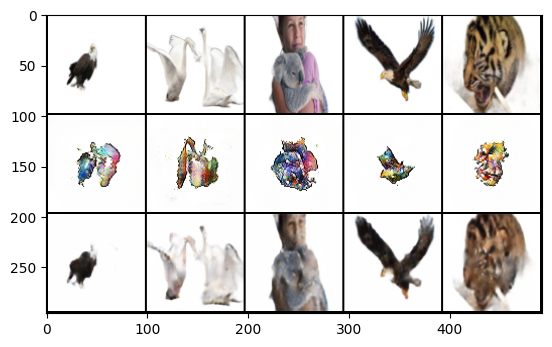

Cycle B: Real B -> Fake A -> Reconstructed B


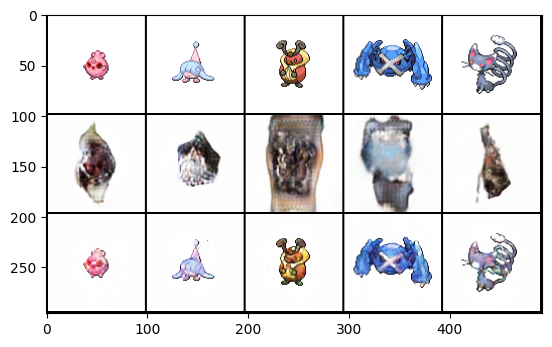

Epoch 141:
  Generator Total Loss: 10.0162
    G_AB (A->B) Loss:  5.4636
    G_BA (B->A) Loss:  4.5526
    Identity Loss:     0.0291
    GAN Loss:          1.2788
    Cycle Loss:        0.0491
    Feature Match:     0.2509
    Perceptual Loss:   0.6701
  Discriminator A Loss: 0.4596
  Discriminator B Loss: 0.4084


Epoch 142:
  Generator Total Loss: 10.0351
    G_AB (A->B) Loss:  5.4812
    G_BA (B->A) Loss:  4.5539
    Identity Loss:     0.0295
    GAN Loss:          1.2876
    Cycle Loss:        0.0495
    Feature Match:     0.2512
    Perceptual Loss:   0.6677
  Discriminator A Loss: 0.4582
  Discriminator B Loss: 0.4047


Epoch 143:
  Generator Total Loss: 10.1200
    G_AB (A->B) Loss:  5.5218
    G_BA (B->A) Loss:  4.5982
    Identity Loss:     0.0312
    GAN Loss:          1.2958
    Cycle Loss:        0.0511
    Feature Match:     0.2535
    Perceptual Loss:   0.6681
  Discriminator A Loss: 0.4589
  Discriminator B Loss: 0.4029


Epoch 144:
  Generator Total Loss: 10.1041
    G_AB (A->B) Loss:  5.4980
    G_BA (B->A) Loss:  4.6061
    Identity Loss:     0.0331
    GAN Loss:          1.2812
    Cycle Loss:        0.0530
    Feature Match:     0.2518
    Perceptual Loss:   0.6698
  Discriminator A Loss: 0.4591
  Discriminator B Loss: 0.4084


Epoch 145:
  Generator Total Loss: 10.1831
    G_AB (A->B) Loss:  5.5733
    G_BA (B->A) Loss:  4.6099
    Identity Loss:     0.0343
    GAN Loss:          1.2962
    Cycle Loss:        0.0541
    Feature Match:     0.2539
    Perceptual Loss:   0.6684
  Discriminator A Loss: 0.4565
  Discriminator B Loss: 0.4027


Epoch 146:
  Generator Total Loss: 10.0565
    G_AB (A->B) Loss:  5.4869
    G_BA (B->A) Loss:  4.5696
    Identity Loss:     0.0305
    GAN Loss:          1.2879
    Cycle Loss:        0.0504
    Feature Match:     0.2516
    Perceptual Loss:   0.6670
  Discriminator A Loss: 0.4556
  Discriminator B Loss: 0.4065


Epoch 147:
  Generator Total Loss: 10.0443
    G_AB (A->B) Loss:  5.4569
    G_BA (B->A) Loss:  4.5874
    Identity Loss:     0.0302
    GAN Loss:          1.2808
    Cycle Loss:        0.0502
    Feature Match:     0.2516
    Perceptual Loss:   0.6682
  Discriminator A Loss: 0.4613
  Discriminator B Loss: 0.4065


Epoch 148:
  Generator Total Loss: 10.1315
    G_AB (A->B) Loss:  5.5404
    G_BA (B->A) Loss:  4.5911
    Identity Loss:     0.0333
    GAN Loss:          1.2874
    Cycle Loss:        0.0531
    Feature Match:     0.2533
    Perceptual Loss:   0.6666
  Discriminator A Loss: 0.4587
  Discriminator B Loss: 0.4051


Epoch 149:
  Generator Total Loss: 10.0325
    G_AB (A->B) Loss:  5.4744
    G_BA (B->A) Loss:  4.5582
    Identity Loss:     0.0280
    GAN Loss:          1.2857
    Cycle Loss:        0.0479
    Feature Match:     0.2529
    Perceptual Loss:   0.6677
  Discriminator A Loss: 0.4576
  Discriminator B Loss: 0.4053


Epoch 150:
  Generator Total Loss: 10.0679
    G_AB (A->B) Loss:  5.4749
    G_BA (B->A) Loss:  4.5930
    Identity Loss:     0.0316
    GAN Loss:          1.2839
    Cycle Loss:        0.0513
    Feature Match:     0.2519
    Perceptual Loss:   0.6661
  Discriminator A Loss: 0.4572
  Discriminator B Loss: 0.4082


Cycle A: Real A -> Fake B -> Reconstructed A


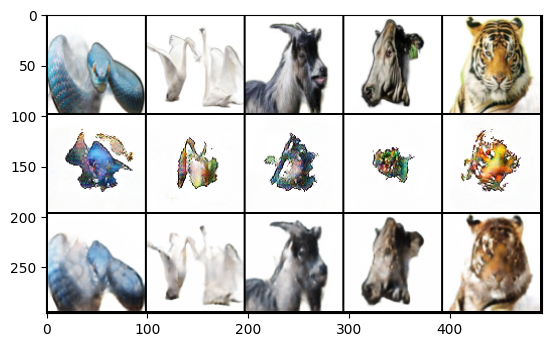

Cycle B: Real B -> Fake A -> Reconstructed B


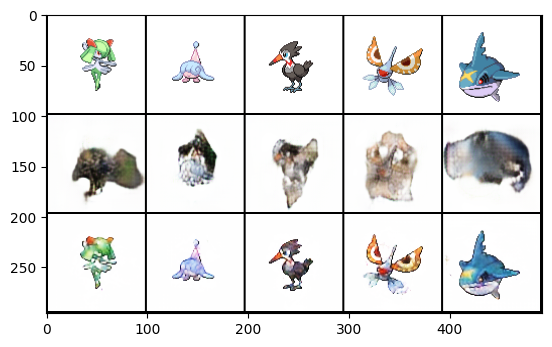

Model saved to models/PokeMalCycleGAN-96x96-G_AB-150-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-150-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-150-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-150-best.pth


Epoch 151:
  Generator Total Loss: 9.0093
    G_AB (A->B) Loss:  5.0304
    G_BA (B->A) Loss:  3.9789
    Identity Loss:     0.0378
    GAN Loss:          0.9580
    Cycle Loss:        0.0581
    Feature Match:     0.2302
    Perceptual Loss:   0.6214
  Discriminator A Loss: 1.3190
  Discriminator B Loss: 1.6499


Epoch 152:
  Generator Total Loss: 9.3152
    G_AB (A->B) Loss:  5.1774
    G_BA (B->A) Loss:  4.1378
    Identity Loss:     0.0341
    GAN Loss:          1.0021
    Cycle Loss:        0.0512
    Feature Match:     0.2397
    Perceptual Loss:   0.6643
  Discriminator A Loss: 0.6392
  Discriminator B Loss: 0.5950


Epoch 153:
  Generator Total Loss: 9.4513
    G_AB (A->B) Loss:  5.2376
    G_BA (B->A) Loss:  4.2137
    Identity Loss:     0.0355
    GAN Loss:          1.0375
    Cycle Loss:        0.0523
    Feature Match:     0.2391
    Perceptual Loss:   0.6772
  Discriminator A Loss: 0.5969
  Discriminator B Loss: 0.5584


Epoch 154:
  Generator Total Loss: 9.5268
    G_AB (A->B) Loss:  5.1846
    G_BA (B->A) Loss:  4.3422
    Identity Loss:     0.0365
    GAN Loss:          1.0631
    Cycle Loss:        0.0529
    Feature Match:     0.2400
    Perceptual Loss:   0.6765
  Discriminator A Loss: 0.5476
  Discriminator B Loss: 0.5580


Epoch 155:
  Generator Total Loss: 9.5522
    G_AB (A->B) Loss:  5.1729
    G_BA (B->A) Loss:  4.3793
    Identity Loss:     0.0386
    GAN Loss:          1.0794
    Cycle Loss:        0.0525
    Feature Match:     0.2384
    Perceptual Loss:   0.6794
  Discriminator A Loss: 0.5381
  Discriminator B Loss: 0.5306


Epoch 156:
  Generator Total Loss: 9.6292
    G_AB (A->B) Loss:  5.2009
    G_BA (B->A) Loss:  4.4283
    Identity Loss:     0.0358
    GAN Loss:          1.1071
    Cycle Loss:        0.0524
    Feature Match:     0.2412
    Perceptual Loss:   0.6778
  Discriminator A Loss: 0.5268
  Discriminator B Loss: 0.5232


Epoch 157:
  Generator Total Loss: 9.6706
    G_AB (A->B) Loss:  5.2500
    G_BA (B->A) Loss:  4.4207
    Identity Loss:     0.0349
    GAN Loss:          1.1147
    Cycle Loss:        0.0518
    Feature Match:     0.2424
    Perceptual Loss:   0.6831
  Discriminator A Loss: 0.5145
  Discriminator B Loss: 0.5110


Epoch 158:
  Generator Total Loss: 9.6859
    G_AB (A->B) Loss:  5.2603
    G_BA (B->A) Loss:  4.4256
    Identity Loss:     0.0353
    GAN Loss:          1.1346
    Cycle Loss:        0.0525
    Feature Match:     0.2412
    Perceptual Loss:   0.6787
  Discriminator A Loss: 0.5264
  Discriminator B Loss: 0.4982


Epoch 159:
  Generator Total Loss: 9.6372
    G_AB (A->B) Loss:  5.2024
    G_BA (B->A) Loss:  4.4348
    Identity Loss:     0.0324
    GAN Loss:          1.1301
    Cycle Loss:        0.0499
    Feature Match:     0.2410
    Perceptual Loss:   0.6818
  Discriminator A Loss: 0.5055
  Discriminator B Loss: 0.4958


Epoch 160:
  Generator Total Loss: 9.7590
    G_AB (A->B) Loss:  5.2480
    G_BA (B->A) Loss:  4.5110
    Identity Loss:     0.0357
    GAN Loss:          1.1554
    Cycle Loss:        0.0537
    Feature Match:     0.2416
    Perceptual Loss:   0.6812
  Discriminator A Loss: 0.4890
  Discriminator B Loss: 0.4813


Cycle A: Real A -> Fake B -> Reconstructed A


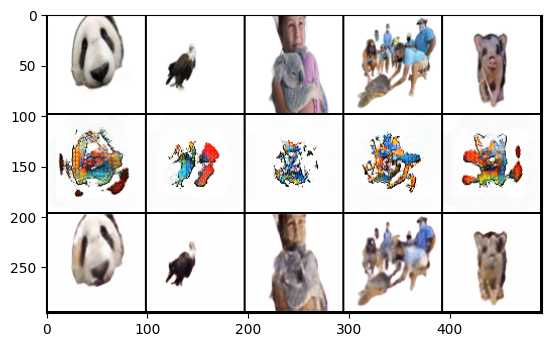

Cycle B: Real B -> Fake A -> Reconstructed B


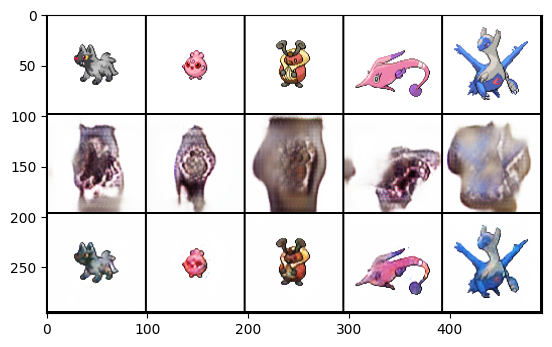

Epoch 161:
  Generator Total Loss: 9.7815
    G_AB (A->B) Loss:  5.2652
    G_BA (B->A) Loss:  4.5163
    Identity Loss:     0.0335
    GAN Loss:          1.1691
    Cycle Loss:        0.0519
    Feature Match:     0.2442
    Perceptual Loss:   0.6783
  Discriminator A Loss: 0.4901
  Discriminator B Loss: 0.4743


Epoch 162:
  Generator Total Loss: 9.8242
    G_AB (A->B) Loss:  5.2909
    G_BA (B->A) Loss:  4.5333
    Identity Loss:     0.0334
    GAN Loss:          1.1899
    Cycle Loss:        0.0523
    Feature Match:     0.2445
    Perceptual Loss:   0.6763
  Discriminator A Loss: 0.4842
  Discriminator B Loss: 0.4597


Epoch 163:
  Generator Total Loss: 10.0716
    G_AB (A->B) Loss:  5.4071
    G_BA (B->A) Loss:  4.6645
    Identity Loss:     0.0383
    GAN Loss:          1.2262
    Cycle Loss:        0.0564
    Feature Match:     0.2494
    Perceptual Loss:   0.6808
  Discriminator A Loss: 0.4698
  Discriminator B Loss: 0.4531


Epoch 164:
  Generator Total Loss: 9.9146
    G_AB (A->B) Loss:  5.3315
    G_BA (B->A) Loss:  4.5830
    Identity Loss:     0.0361
    GAN Loss:          1.2182
    Cycle Loss:        0.0552
    Feature Match:     0.2438
    Perceptual Loss:   0.6746
  Discriminator A Loss: 0.4782
  Discriminator B Loss: 0.4408


Epoch 165:
  Generator Total Loss: 9.9904
    G_AB (A->B) Loss:  5.3862
    G_BA (B->A) Loss:  4.6042
    Identity Loss:     0.0366
    GAN Loss:          1.2429
    Cycle Loss:        0.0558
    Feature Match:     0.2450
    Perceptual Loss:   0.6737
  Discriminator A Loss: 0.4827
  Discriminator B Loss: 0.4302


Epoch 166:
  Generator Total Loss: 10.2033
    G_AB (A->B) Loss:  5.4084
    G_BA (B->A) Loss:  4.7949
    Identity Loss:     0.0544
    GAN Loss:          1.2418
    Cycle Loss:        0.0577
    Feature Match:     0.2485
    Perceptual Loss:   0.6810
  Discriminator A Loss: 0.4802
  Discriminator B Loss: 0.4321


Epoch 167:
  Generator Total Loss: 10.0261
    G_AB (A->B) Loss:  5.3578
    G_BA (B->A) Loss:  4.6683
    Identity Loss:     0.0396
    GAN Loss:          1.2456
    Cycle Loss:        0.0565
    Feature Match:     0.2447
    Perceptual Loss:   0.6757
  Discriminator A Loss: 0.4752
  Discriminator B Loss: 0.4319


Epoch 168:
  Generator Total Loss: 10.1096
    G_AB (A->B) Loss:  5.4196
    G_BA (B->A) Loss:  4.6900
    Identity Loss:     0.0358
    GAN Loss:          1.2538
    Cycle Loss:        0.0544
    Feature Match:     0.2502
    Perceptual Loss:   0.6827
  Discriminator A Loss: 0.4744
  Discriminator B Loss: 0.4194


Epoch 169:
  Generator Total Loss: 9.7626
    G_AB (A->B) Loss:  5.2893
    G_BA (B->A) Loss:  4.4733
    Identity Loss:     0.0367
    GAN Loss:          1.1783
    Cycle Loss:        0.0552
    Feature Match:     0.2387
    Perceptual Loss:   0.6762
  Discriminator A Loss: 0.8894
  Discriminator B Loss: 0.4206


Epoch 170:
  Generator Total Loss: 9.8591
    G_AB (A->B) Loss:  5.2956
    G_BA (B->A) Loss:  4.5635
    Identity Loss:     0.0348
    GAN Loss:          1.2339
    Cycle Loss:        0.0533
    Feature Match:     0.2393
    Perceptual Loss:   0.6784
  Discriminator A Loss: 0.5371
  Discriminator B Loss: 0.4165


Cycle A: Real A -> Fake B -> Reconstructed A


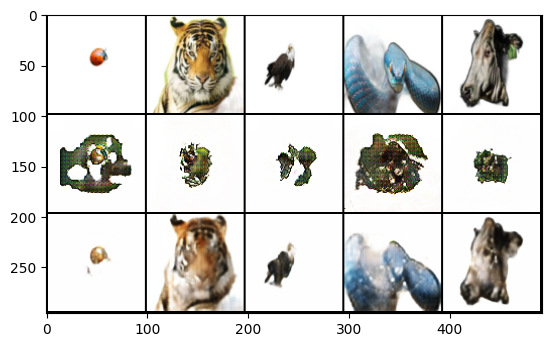

Cycle B: Real B -> Fake A -> Reconstructed B


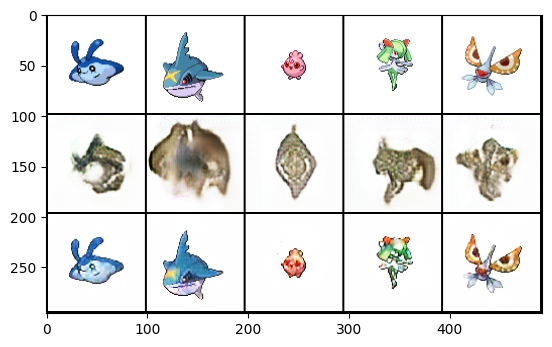

Epoch 171:
  Generator Total Loss: 9.8759
    G_AB (A->B) Loss:  5.3219
    G_BA (B->A) Loss:  4.5540
    Identity Loss:     0.0360
    GAN Loss:          1.2413
    Cycle Loss:        0.0548
    Feature Match:     0.2390
    Perceptual Loss:   0.6739
  Discriminator A Loss: 0.5087
  Discriminator B Loss: 0.4164


Epoch 172:
  Generator Total Loss: 9.9348
    G_AB (A->B) Loss:  5.3065
    G_BA (B->A) Loss:  4.6283
    Identity Loss:     0.0331
    GAN Loss:          1.2588
    Cycle Loss:        0.0527
    Feature Match:     0.2415
    Perceptual Loss:   0.6804
  Discriminator A Loss: 0.4917
  Discriminator B Loss: 0.4096


Epoch 173:
  Generator Total Loss: 10.0185
    G_AB (A->B) Loss:  5.3592
    G_BA (B->A) Loss:  4.6593
    Identity Loss:     0.0354
    GAN Loss:          1.2723
    Cycle Loss:        0.0553
    Feature Match:     0.2426
    Perceptual Loss:   0.6790
  Discriminator A Loss: 0.4834
  Discriminator B Loss: 0.4143


Epoch 174:
  Generator Total Loss: 9.9945
    G_AB (A->B) Loss:  5.3918
    G_BA (B->A) Loss:  4.6027
    Identity Loss:     0.0350
    GAN Loss:          1.2719
    Cycle Loss:        0.0548
    Feature Match:     0.2425
    Perceptual Loss:   0.6757
  Discriminator A Loss: 0.4853
  Discriminator B Loss: 0.4045


Epoch 175:
  Generator Total Loss: 10.0439
    G_AB (A->B) Loss:  5.3842
    G_BA (B->A) Loss:  4.6597
    Identity Loss:     0.0385
    GAN Loss:          1.2643
    Cycle Loss:        0.0579
    Feature Match:     0.2417
    Perceptual Loss:   0.6807
  Discriminator A Loss: 0.4921
  Discriminator B Loss: 0.4103
Model saved to models/PokeMalCycleGAN-96x96-G_AB-175-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-175-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-175-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-175-best.pth


Epoch 176:
  Generator Total Loss: 9.8355
    G_AB (A->B) Loss:  5.3255
    G_BA (B->A) Loss:  4.5100
    Identity Loss:     0.0365
    GAN Loss:          1.2322
    Cycle Loss:        0.0560
    Feature Match:     0.2367
    Perceptual Loss:   0.6733
  Discriminator A Loss: 0.4884
  Discriminator B Loss: 0.5935


Epoch 177:
  Generator Total Loss: 9.6483
    G_AB (A->B) Loss:  5.2531
    G_BA (B->A) Loss:  4.3952
    Identity Loss:     0.0351
    GAN Loss:          1.2133
    Cycle Loss:        0.0541
    Feature Match:     0.2290
    Perceptual Loss:   0.6742
  Discriminator A Loss: 0.4761
  Discriminator B Loss: 0.4580


Epoch 178:
  Generator Total Loss: 9.8484
    G_AB (A->B) Loss:  5.3401
    G_BA (B->A) Loss:  4.5083
    Identity Loss:     0.0345
    GAN Loss:          1.2412
    Cycle Loss:        0.0546
    Feature Match:     0.2369
    Perceptual Loss:   0.6782
  Discriminator A Loss: 0.4720
  Discriminator B Loss: 0.4339


Epoch 179:
  Generator Total Loss: 9.8553
    G_AB (A->B) Loss:  5.3379
    G_BA (B->A) Loss:  4.5174
    Identity Loss:     0.0366
    GAN Loss:          1.2585
    Cycle Loss:        0.0553
    Feature Match:     0.2345
    Perceptual Loss:   0.6756
  Discriminator A Loss: 0.4756
  Discriminator B Loss: 0.4219


Epoch 180:
  Generator Total Loss: 9.8917
    G_AB (A->B) Loss:  5.3978
    G_BA (B->A) Loss:  4.4938
    Identity Loss:     0.0359
    GAN Loss:          1.2606
    Cycle Loss:        0.0552
    Feature Match:     0.2371
    Perceptual Loss:   0.6748
  Discriminator A Loss: 0.4890
  Discriminator B Loss: 0.4113


Cycle A: Real A -> Fake B -> Reconstructed A


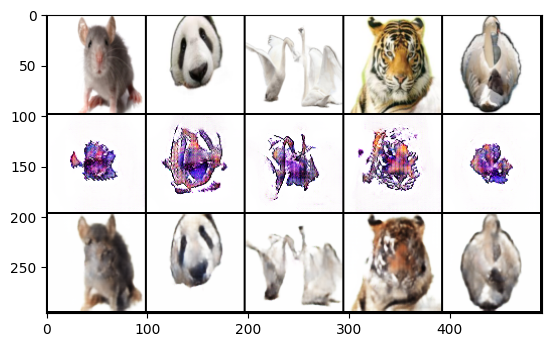

Cycle B: Real B -> Fake A -> Reconstructed B


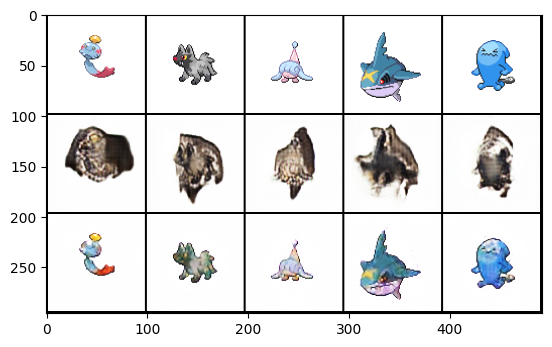

Epoch 181:
  Generator Total Loss: 9.9292
    G_AB (A->B) Loss:  5.3766
    G_BA (B->A) Loss:  4.5526
    Identity Loss:     0.0322
    GAN Loss:          1.2887
    Cycle Loss:        0.0521
    Feature Match:     0.2394
    Perceptual Loss:   0.6759
  Discriminator A Loss: 0.4724
  Discriminator B Loss: 0.4010


Epoch 182:
  Generator Total Loss: 10.0260
    G_AB (A->B) Loss:  5.4345
    G_BA (B->A) Loss:  4.5916
    Identity Loss:     0.0338
    GAN Loss:          1.3046
    Cycle Loss:        0.0547
    Feature Match:     0.2402
    Perceptual Loss:   0.6786
  Discriminator A Loss: 0.4570
  Discriminator B Loss: 0.3943


Epoch 183:
  Generator Total Loss: 10.0700
    G_AB (A->B) Loss:  5.4429
    G_BA (B->A) Loss:  4.6270
    Identity Loss:     0.0361
    GAN Loss:          1.3029
    Cycle Loss:        0.0565
    Feature Match:     0.2417
    Perceptual Loss:   0.6758
  Discriminator A Loss: 0.4690
  Discriminator B Loss: 0.4013


Epoch 184:
  Generator Total Loss: 10.1012
    G_AB (A->B) Loss:  5.4537
    G_BA (B->A) Loss:  4.6474
    Identity Loss:     0.0361
    GAN Loss:          1.3108
    Cycle Loss:        0.0565
    Feature Match:     0.2424
    Perceptual Loss:   0.6769
  Discriminator A Loss: 0.4680
  Discriminator B Loss: 0.4008


Epoch 185:
  Generator Total Loss: 10.0687
    G_AB (A->B) Loss:  5.4429
    G_BA (B->A) Loss:  4.6258
    Identity Loss:     0.0346
    GAN Loss:          1.3304
    Cycle Loss:        0.0550
    Feature Match:     0.2402
    Perceptual Loss:   0.6741
  Discriminator A Loss: 0.4621
  Discriminator B Loss: 0.3893


Epoch 186:
  Generator Total Loss: 9.8722
    G_AB (A->B) Loss:  5.3618
    G_BA (B->A) Loss:  4.5104
    Identity Loss:     0.0337
    GAN Loss:          1.2676
    Cycle Loss:        0.0535
    Feature Match:     0.2363
    Perceptual Loss:   0.6783
  Discriminator A Loss: 0.6654
  Discriminator B Loss: 0.3948


Epoch 187:
  Generator Total Loss: 9.8664
    G_AB (A->B) Loss:  5.3332
    G_BA (B->A) Loss:  4.5332
    Identity Loss:     0.0358
    GAN Loss:          1.2888
    Cycle Loss:        0.0554
    Feature Match:     0.2324
    Perceptual Loss:   0.6725
  Discriminator A Loss: 0.5137
  Discriminator B Loss: 0.3925


Epoch 188:
  Generator Total Loss: 9.9185
    G_AB (A->B) Loss:  5.3659
    G_BA (B->A) Loss:  4.5526
    Identity Loss:     0.0345
    GAN Loss:          1.2922
    Cycle Loss:        0.0535
    Feature Match:     0.2363
    Perceptual Loss:   0.6760
  Discriminator A Loss: 0.4979
  Discriminator B Loss: 0.3903


Epoch 189:
  Generator Total Loss: 9.9487
    G_AB (A->B) Loss:  5.3511
    G_BA (B->A) Loss:  4.5976
    Identity Loss:     0.0356
    GAN Loss:          1.3174
    Cycle Loss:        0.0525
    Feature Match:     0.2356
    Perceptual Loss:   0.6750
  Discriminator A Loss: 0.4765
  Discriminator B Loss: 0.3852


Epoch 190:
  Generator Total Loss: 10.1021
    G_AB (A->B) Loss:  5.4607
    G_BA (B->A) Loss:  4.6414
    Identity Loss:     0.0394
    GAN Loss:          1.3387
    Cycle Loss:        0.0544
    Feature Match:     0.2395
    Perceptual Loss:   0.6759
  Discriminator A Loss: 0.4861
  Discriminator B Loss: 0.3815


Cycle A: Real A -> Fake B -> Reconstructed A


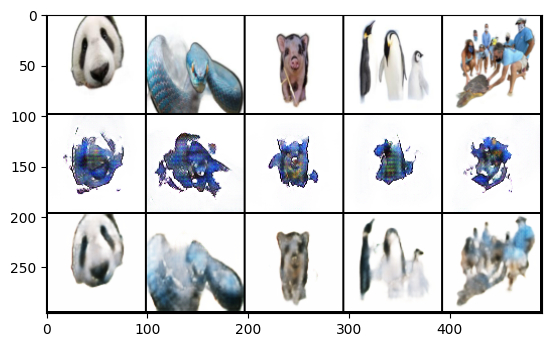

Cycle B: Real B -> Fake A -> Reconstructed B


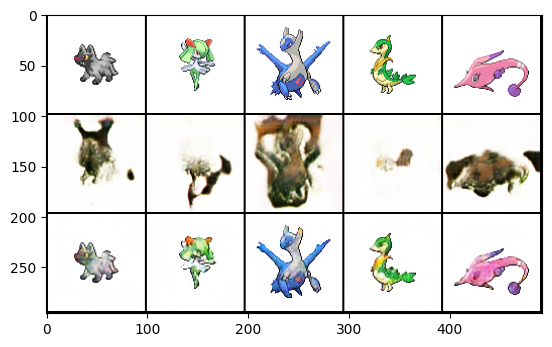

Epoch 191:
  Generator Total Loss: 9.9839
    G_AB (A->B) Loss:  5.3441
    G_BA (B->A) Loss:  4.6398
    Identity Loss:     0.0350
    GAN Loss:          1.3153
    Cycle Loss:        0.0553
    Feature Match:     0.2360
    Perceptual Loss:   0.6759
  Discriminator A Loss: 0.4787
  Discriminator B Loss: 0.3888


Epoch 192:
  Generator Total Loss: 10.0343
    G_AB (A->B) Loss:  5.4335
    G_BA (B->A) Loss:  4.6009
    Identity Loss:     0.0362
    GAN Loss:          1.3119
    Cycle Loss:        0.0555
    Feature Match:     0.2390
    Perceptual Loss:   0.6762
  Discriminator A Loss: 0.4756
  Discriminator B Loss: 0.3856


Epoch 193:
  Generator Total Loss: 9.9370
    G_AB (A->B) Loss:  5.3565
    G_BA (B->A) Loss:  4.5805
    Identity Loss:     0.0339
    GAN Loss:          1.3004
    Cycle Loss:        0.0531
    Feature Match:     0.2359
    Perceptual Loss:   0.6804
  Discriminator A Loss: 0.4800
  Discriminator B Loss: 0.3856


Epoch 194:
  Generator Total Loss: 9.9878
    G_AB (A->B) Loss:  5.3666
    G_BA (B->A) Loss:  4.6212
    Identity Loss:     0.0347
    GAN Loss:          1.3301
    Cycle Loss:        0.0544
    Feature Match:     0.2354
    Perceptual Loss:   0.6752
  Discriminator A Loss: 0.4755
  Discriminator B Loss: 0.3865


Epoch 195:
  Generator Total Loss: 10.0038
    G_AB (A->B) Loss:  5.4136
    G_BA (B->A) Loss:  4.5902
    Identity Loss:     0.0360
    GAN Loss:          1.3174
    Cycle Loss:        0.0554
    Feature Match:     0.2362
    Perceptual Loss:   0.6772
  Discriminator A Loss: 0.4760
  Discriminator B Loss: 0.3864


Epoch 196:
  Generator Total Loss: 10.2143
    G_AB (A->B) Loss:  5.5588
    G_BA (B->A) Loss:  4.6555
    Identity Loss:     0.0359
    GAN Loss:          1.3452
    Cycle Loss:        0.0556
    Feature Match:     0.2444
    Perceptual Loss:   0.6826
  Discriminator A Loss: 0.4691
  Discriminator B Loss: 0.3744


Epoch 197:
  Generator Total Loss: 10.1372
    G_AB (A->B) Loss:  5.4811
    G_BA (B->A) Loss:  4.6561
    Identity Loss:     0.0353
    GAN Loss:          1.3518
    Cycle Loss:        0.0551
    Feature Match:     0.2408
    Perceptual Loss:   0.6769
  Discriminator A Loss: 0.4627
  Discriminator B Loss: 0.3807


Epoch 198:
  Generator Total Loss: 9.6341
    G_AB (A->B) Loss:  5.1831
    G_BA (B->A) Loss:  4.4510
    Identity Loss:     0.0363
    GAN Loss:          1.2272
    Cycle Loss:        0.0549
    Feature Match:     0.2258
    Perceptual Loss:   0.6727
  Discriminator A Loss: 0.4698
  Discriminator B Loss: 0.6775


Epoch 199:
  Generator Total Loss: 9.4841
    G_AB (A->B) Loss:  5.1586
    G_BA (B->A) Loss:  4.3255
    Identity Loss:     0.0354
    GAN Loss:          1.2198
    Cycle Loss:        0.0534
    Feature Match:     0.2183
    Perceptual Loss:   0.6744
  Discriminator A Loss: 0.4652
  Discriminator B Loss: 0.4538


Epoch 200:
  Generator Total Loss: 9.7214
    G_AB (A->B) Loss:  5.2946
    G_BA (B->A) Loss:  4.4268
    Identity Loss:     0.0335
    GAN Loss:          1.2527
    Cycle Loss:        0.0527
    Feature Match:     0.2294
    Perceptual Loss:   0.6779
  Discriminator A Loss: 0.4518
  Discriminator B Loss: 0.4350


Cycle A: Real A -> Fake B -> Reconstructed A


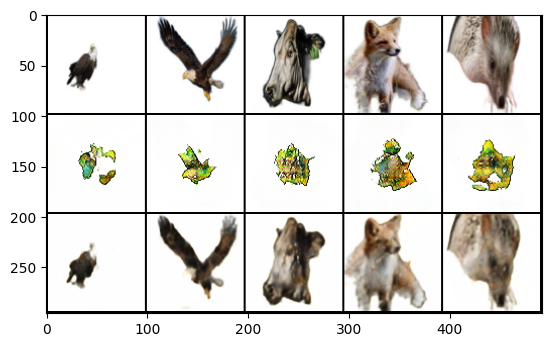

Cycle B: Real B -> Fake A -> Reconstructed B


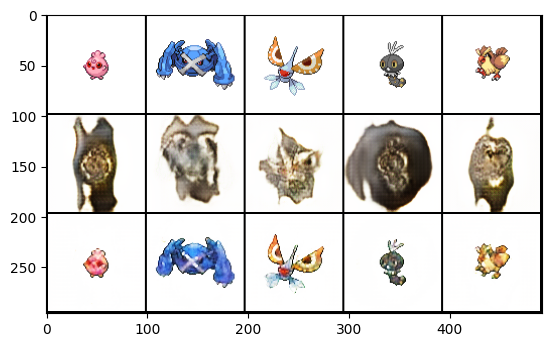

Model saved to models/PokeMalCycleGAN-96x96-G_AB-200-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-200-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-200-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-200-best.pth


Epoch 201:
  Generator Total Loss: 9.7080
    G_AB (A->B) Loss:  5.2652
    G_BA (B->A) Loss:  4.4427
    Identity Loss:     0.0333
    GAN Loss:          1.2506
    Cycle Loss:        0.0525
    Feature Match:     0.2293
    Perceptual Loss:   0.6772
  Discriminator A Loss: 0.4698
  Discriminator B Loss: 0.4185


Epoch 202:
  Generator Total Loss: 9.8462
    G_AB (A->B) Loss:  5.3000
    G_BA (B->A) Loss:  4.5463
    Identity Loss:     0.0329
    GAN Loss:          1.2951
    Cycle Loss:        0.0525
    Feature Match:     0.2317
    Perceptual Loss:   0.6804
  Discriminator A Loss: 0.4585
  Discriminator B Loss: 0.4041


Epoch 203:
  Generator Total Loss: 9.8901
    G_AB (A->B) Loss:  5.3652
    G_BA (B->A) Loss:  4.5249
    Identity Loss:     0.0351
    GAN Loss:          1.2984
    Cycle Loss:        0.0546
    Feature Match:     0.2328
    Perceptual Loss:   0.6754
  Discriminator A Loss: 0.4688
  Discriminator B Loss: 0.3942


Epoch 204:
  Generator Total Loss: 9.9287
    G_AB (A->B) Loss:  5.3548
    G_BA (B->A) Loss:  4.5739
    Identity Loss:     0.0339
    GAN Loss:          1.3173
    Cycle Loss:        0.0539
    Feature Match:     0.2344
    Perceptual Loss:   0.6736
  Discriminator A Loss: 0.4539
  Discriminator B Loss: 0.3939


Epoch 205:
  Generator Total Loss: 9.9253
    G_AB (A->B) Loss:  5.3706
    G_BA (B->A) Loss:  4.5547
    Identity Loss:     0.0346
    GAN Loss:          1.3118
    Cycle Loss:        0.0540
    Feature Match:     0.2342
    Perceptual Loss:   0.6747
  Discriminator A Loss: 0.4601
  Discriminator B Loss: 0.3937


Epoch 206:
  Generator Total Loss: 9.9933
    G_AB (A->B) Loss:  5.4096
    G_BA (B->A) Loss:  4.5837
    Identity Loss:     0.0348
    GAN Loss:          1.3286
    Cycle Loss:        0.0550
    Feature Match:     0.2358
    Perceptual Loss:   0.6736
  Discriminator A Loss: 0.4572
  Discriminator B Loss: 0.3888


Epoch 207:
  Generator Total Loss: 9.8582
    G_AB (A->B) Loss:  5.3385
    G_BA (B->A) Loss:  4.5197
    Identity Loss:     0.0360
    GAN Loss:          1.3196
    Cycle Loss:        0.0563
    Feature Match:     0.2277
    Perceptual Loss:   0.6711
  Discriminator A Loss: 0.5344
  Discriminator B Loss: 0.3830


Epoch 208:
  Generator Total Loss: 9.9221
    G_AB (A->B) Loss:  5.3902
    G_BA (B->A) Loss:  4.5319
    Identity Loss:     0.0354
    GAN Loss:          1.3234
    Cycle Loss:        0.0548
    Feature Match:     0.2309
    Perceptual Loss:   0.6775
  Discriminator A Loss: 0.4835
  Discriminator B Loss: 0.3833


Epoch 209:
  Generator Total Loss: 10.0641
    G_AB (A->B) Loss:  5.4766
    G_BA (B->A) Loss:  4.5874
    Identity Loss:     0.0379
    GAN Loss:          1.3273
    Cycle Loss:        0.0572
    Feature Match:     0.2374
    Perceptual Loss:   0.6746
  Discriminator A Loss: 0.4677
  Discriminator B Loss: 0.3798


Epoch 210:
  Generator Total Loss: 10.0656
    G_AB (A->B) Loss:  5.4454
    G_BA (B->A) Loss:  4.6202
    Identity Loss:     0.0334
    GAN Loss:          1.3389
    Cycle Loss:        0.0531
    Feature Match:     0.2399
    Perceptual Loss:   0.6778
  Discriminator A Loss: 0.4652
  Discriminator B Loss: 0.3837


Cycle A: Real A -> Fake B -> Reconstructed A


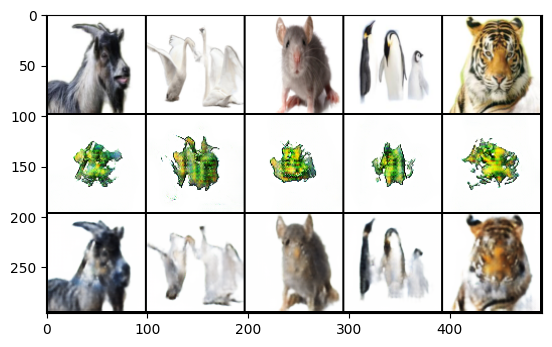

Cycle B: Real B -> Fake A -> Reconstructed B


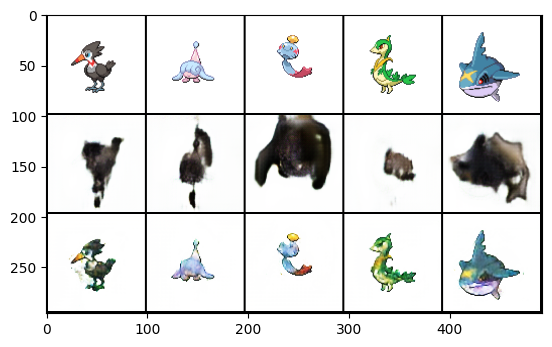

Epoch 211:
  Generator Total Loss: 10.0507
    G_AB (A->B) Loss:  5.4361
    G_BA (B->A) Loss:  4.6146
    Identity Loss:     0.0337
    GAN Loss:          1.3465
    Cycle Loss:        0.0540
    Feature Match:     0.2376
    Perceptual Loss:   0.6765
  Discriminator A Loss: 0.4625
  Discriminator B Loss: 0.3794


Epoch 212:
  Generator Total Loss: 10.0003
    G_AB (A->B) Loss:  5.4127
    G_BA (B->A) Loss:  4.5876
    Identity Loss:     0.0323
    GAN Loss:          1.3306
    Cycle Loss:        0.0521
    Feature Match:     0.2382
    Perceptual Loss:   0.6771
  Discriminator A Loss: 0.4598
  Discriminator B Loss: 0.3848


Epoch 213:
  Generator Total Loss: 9.9429
    G_AB (A->B) Loss:  5.3778
    G_BA (B->A) Loss:  4.5651
    Identity Loss:     0.0297
    GAN Loss:          1.3353
    Cycle Loss:        0.0499
    Feature Match:     0.2363
    Perceptual Loss:   0.6787
  Discriminator A Loss: 0.4536
  Discriminator B Loss: 0.3810


Epoch 214:
  Generator Total Loss: 10.0316
    G_AB (A->B) Loss:  5.4422
    G_BA (B->A) Loss:  4.5894
    Identity Loss:     0.0349
    GAN Loss:          1.3387
    Cycle Loss:        0.0545
    Feature Match:     0.2365
    Perceptual Loss:   0.6770
  Discriminator A Loss: 0.4554
  Discriminator B Loss: 0.3822


Epoch 215:
  Generator Total Loss: 10.0736
    G_AB (A->B) Loss:  5.4482
    G_BA (B->A) Loss:  4.6254
    Identity Loss:     0.0352
    GAN Loss:          1.3497
    Cycle Loss:        0.0554
    Feature Match:     0.2375
    Perceptual Loss:   0.6746
  Discriminator A Loss: 0.4554
  Discriminator B Loss: 0.3779


Epoch 216:
  Generator Total Loss: 10.0963
    G_AB (A->B) Loss:  5.4918
    G_BA (B->A) Loss:  4.6045
    Identity Loss:     0.0335
    GAN Loss:          1.3629
    Cycle Loss:        0.0531
    Feature Match:     0.2394
    Perceptual Loss:   0.6756
  Discriminator A Loss: 0.4541
  Discriminator B Loss: 0.3749


Epoch 217:
  Generator Total Loss: 10.0119
    G_AB (A->B) Loss:  5.4073
    G_BA (B->A) Loss:  4.6046
    Identity Loss:     0.0323
    GAN Loss:          1.3587
    Cycle Loss:        0.0520
    Feature Match:     0.2369
    Perceptual Loss:   0.6718
  Discriminator A Loss: 0.4529
  Discriminator B Loss: 0.3777


Epoch 218:
  Generator Total Loss: 10.0051
    G_AB (A->B) Loss:  5.4192
    G_BA (B->A) Loss:  4.5859
    Identity Loss:     0.0327
    GAN Loss:          1.3546
    Cycle Loss:        0.0529
    Feature Match:     0.2355
    Perceptual Loss:   0.6740
  Discriminator A Loss: 0.4527
  Discriminator B Loss: 0.3752


Epoch 219:
  Generator Total Loss: 10.0171
    G_AB (A->B) Loss:  5.4459
    G_BA (B->A) Loss:  4.5712
    Identity Loss:     0.0318
    GAN Loss:          1.3527
    Cycle Loss:        0.0516
    Feature Match:     0.2375
    Perceptual Loss:   0.6754
  Discriminator A Loss: 0.4578
  Discriminator B Loss: 0.3765


Epoch 220:
  Generator Total Loss: 10.1039
    G_AB (A->B) Loss:  5.5046
    G_BA (B->A) Loss:  4.5993
    Identity Loss:     0.0329
    GAN Loss:          1.3669
    Cycle Loss:        0.0526
    Feature Match:     0.2397
    Perceptual Loss:   0.6764
  Discriminator A Loss: 0.4551
  Discriminator B Loss: 0.3762


Cycle A: Real A -> Fake B -> Reconstructed A


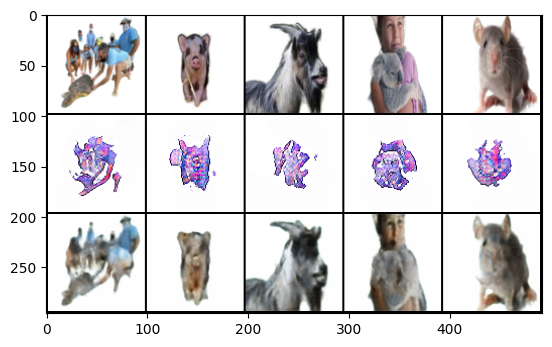

Cycle B: Real B -> Fake A -> Reconstructed B


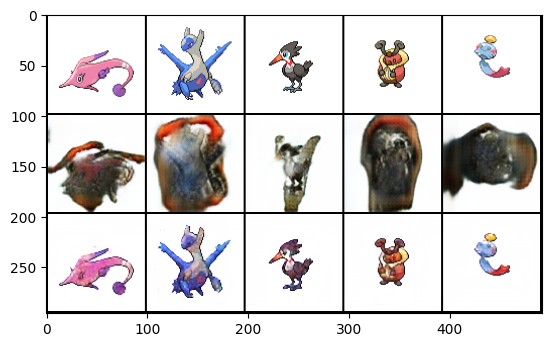

Epoch 221:
  Generator Total Loss: 10.1076
    G_AB (A->B) Loss:  5.5036
    G_BA (B->A) Loss:  4.6040
    Identity Loss:     0.0332
    GAN Loss:          1.3638
    Cycle Loss:        0.0527
    Feature Match:     0.2406
    Perceptual Loss:   0.6745
  Discriminator A Loss: 0.4562
  Discriminator B Loss: 0.3751


Epoch 222:
  Generator Total Loss: 10.0879
    G_AB (A->B) Loss:  5.4730
    G_BA (B->A) Loss:  4.6149
    Identity Loss:     0.0318
    GAN Loss:          1.3719
    Cycle Loss:        0.0519
    Feature Match:     0.2396
    Perceptual Loss:   0.6742
  Discriminator A Loss: 0.4483
  Discriminator B Loss: 0.3745


Epoch 223:
  Generator Total Loss: 10.0802
    G_AB (A->B) Loss:  5.4612
    G_BA (B->A) Loss:  4.6189
    Identity Loss:     0.0308
    GAN Loss:          1.3689
    Cycle Loss:        0.0510
    Feature Match:     0.2404
    Perceptual Loss:   0.6746
  Discriminator A Loss: 0.4508
  Discriminator B Loss: 0.3701


Epoch 224:
  Generator Total Loss: 10.1911
    G_AB (A->B) Loss:  5.5321
    G_BA (B->A) Loss:  4.6590
    Identity Loss:     0.0346
    GAN Loss:          1.3882
    Cycle Loss:        0.0549
    Feature Match:     0.2400
    Perceptual Loss:   0.6770
  Discriminator A Loss: 0.4525
  Discriminator B Loss: 0.3706


Epoch 225:
  Generator Total Loss: 10.0708
    G_AB (A->B) Loss:  5.4900
    G_BA (B->A) Loss:  4.5808
    Identity Loss:     0.0309
    GAN Loss:          1.3731
    Cycle Loss:        0.0507
    Feature Match:     0.2395
    Perceptual Loss:   0.6746
  Discriminator A Loss: 0.4557
  Discriminator B Loss: 0.3685
Model saved to models/PokeMalCycleGAN-96x96-G_AB-225-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-225-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-225-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-225-best.pth


Epoch 226:
  Generator Total Loss: 10.1671
    G_AB (A->B) Loss:  5.5448
    G_BA (B->A) Loss:  4.6223
    Identity Loss:     0.0314
    GAN Loss:          1.3783
    Cycle Loss:        0.0507
    Feature Match:     0.2441
    Perceptual Loss:   0.6769
  Discriminator A Loss: 0.4602
  Discriminator B Loss: 0.3691


Epoch 227:
  Generator Total Loss: 10.1513
    G_AB (A->B) Loss:  5.5110
    G_BA (B->A) Loss:  4.6403
    Identity Loss:     0.0327
    GAN Loss:          1.3810
    Cycle Loss:        0.0520
    Feature Match:     0.2418
    Perceptual Loss:   0.6753
  Discriminator A Loss: 0.4528
  Discriminator B Loss: 0.3681


Epoch 228:
  Generator Total Loss: 10.2393
    G_AB (A->B) Loss:  5.5818
    G_BA (B->A) Loss:  4.6575
    Identity Loss:     0.0326
    GAN Loss:          1.3846
    Cycle Loss:        0.0524
    Feature Match:     0.2472
    Perceptual Loss:   0.6724
  Discriminator A Loss: 0.4509
  Discriminator B Loss: 0.3651


Epoch 229:
  Generator Total Loss: 10.0702
    G_AB (A->B) Loss:  5.5119
    G_BA (B->A) Loss:  4.5583
    Identity Loss:     0.0295
    GAN Loss:          1.3765
    Cycle Loss:        0.0489
    Feature Match:     0.2415
    Perceptual Loss:   0.6725
  Discriminator A Loss: 0.4577
  Discriminator B Loss: 0.3660


Epoch 230:
  Generator Total Loss: 10.0551
    G_AB (A->B) Loss:  5.4723
    G_BA (B->A) Loss:  4.5828
    Identity Loss:     0.0326
    GAN Loss:          1.3735
    Cycle Loss:        0.0522
    Feature Match:     0.2377
    Perceptual Loss:   0.6707
  Discriminator A Loss: 0.5130
  Discriminator B Loss: 0.3685


Cycle A: Real A -> Fake B -> Reconstructed A


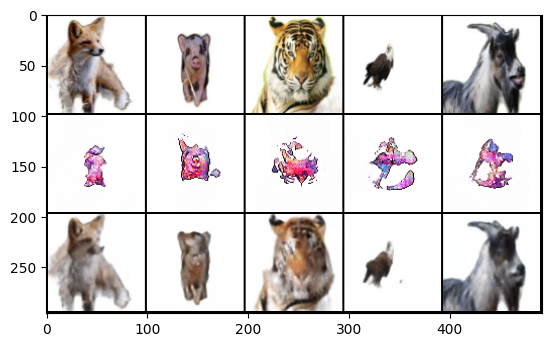

Cycle B: Real B -> Fake A -> Reconstructed B


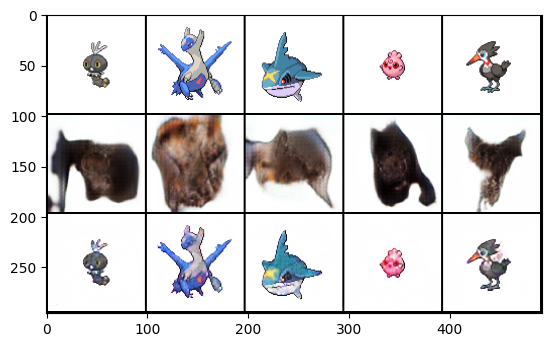

Epoch 231:
  Generator Total Loss: 10.0767
    G_AB (A->B) Loss:  5.4607
    G_BA (B->A) Loss:  4.6160
    Identity Loss:     0.0313
    GAN Loss:          1.3879
    Cycle Loss:        0.0508
    Feature Match:     0.2381
    Perceptual Loss:   0.6735
  Discriminator A Loss: 0.4553
  Discriminator B Loss: 0.3645


Epoch 232:
  Generator Total Loss: 10.1153
    G_AB (A->B) Loss:  5.5194
    G_BA (B->A) Loss:  4.5959
    Identity Loss:     0.0310
    GAN Loss:          1.3949
    Cycle Loss:        0.0505
    Feature Match:     0.2399
    Perceptual Loss:   0.6738
  Discriminator A Loss: 0.4554
  Discriminator B Loss: 0.3676


Epoch 233:
  Generator Total Loss: 10.2006
    G_AB (A->B) Loss:  5.5670
    G_BA (B->A) Loss:  4.6336
    Identity Loss:     0.0342
    GAN Loss:          1.4037
    Cycle Loss:        0.0534
    Feature Match:     0.2410
    Perceptual Loss:   0.6727
  Discriminator A Loss: 0.4467
  Discriminator B Loss: 0.3618


Epoch 234:
  Generator Total Loss: 10.0412
    G_AB (A->B) Loss:  5.4567
    G_BA (B->A) Loss:  4.5846
    Identity Loss:     0.0289
    GAN Loss:          1.3850
    Cycle Loss:        0.0487
    Feature Match:     0.2384
    Perceptual Loss:   0.6747
  Discriminator A Loss: 0.4478
  Discriminator B Loss: 0.3664


Epoch 235:
  Generator Total Loss: 10.1614
    G_AB (A->B) Loss:  5.5499
    G_BA (B->A) Loss:  4.6116
    Identity Loss:     0.0318
    GAN Loss:          1.4153
    Cycle Loss:        0.0511
    Feature Match:     0.2407
    Perceptual Loss:   0.6689
  Discriminator A Loss: 0.4544
  Discriminator B Loss: 0.3586


Epoch 236:
  Generator Total Loss: 10.1755
    G_AB (A->B) Loss:  5.5505
    G_BA (B->A) Loss:  4.6251
    Identity Loss:     0.0316
    GAN Loss:          1.4027
    Cycle Loss:        0.0508
    Feature Match:     0.2418
    Perceptual Loss:   0.6755
  Discriminator A Loss: 0.4483
  Discriminator B Loss: 0.3634


Epoch 237:
  Generator Total Loss: 10.1727
    G_AB (A->B) Loss:  5.5514
    G_BA (B->A) Loss:  4.6213
    Identity Loss:     0.0322
    GAN Loss:          1.3995
    Cycle Loss:        0.0516
    Feature Match:     0.2415
    Perceptual Loss:   0.6747
  Discriminator A Loss: 0.4490
  Discriminator B Loss: 0.3646


Epoch 238:
  Generator Total Loss: 10.1286
    G_AB (A->B) Loss:  5.5164
    G_BA (B->A) Loss:  4.6122
    Identity Loss:     0.0304
    GAN Loss:          1.4030
    Cycle Loss:        0.0497
    Feature Match:     0.2404
    Perceptual Loss:   0.6742
  Discriminator A Loss: 0.4483
  Discriminator B Loss: 0.3626


Epoch 239:
  Generator Total Loss: 10.1569
    G_AB (A->B) Loss:  5.5387
    G_BA (B->A) Loss:  4.6183
    Identity Loss:     0.0318
    GAN Loss:          1.4204
    Cycle Loss:        0.0513
    Feature Match:     0.2399
    Perceptual Loss:   0.6681
  Discriminator A Loss: 0.4480
  Discriminator B Loss: 0.3598


Epoch 240:
  Generator Total Loss: 10.2239
    G_AB (A->B) Loss:  5.5490
    G_BA (B->A) Loss:  4.6750
    Identity Loss:     0.0316
    GAN Loss:          1.4228
    Cycle Loss:        0.0515
    Feature Match:     0.2425
    Perceptual Loss:   0.6729
  Discriminator A Loss: 0.4377
  Discriminator B Loss: 0.3615


Cycle A: Real A -> Fake B -> Reconstructed A


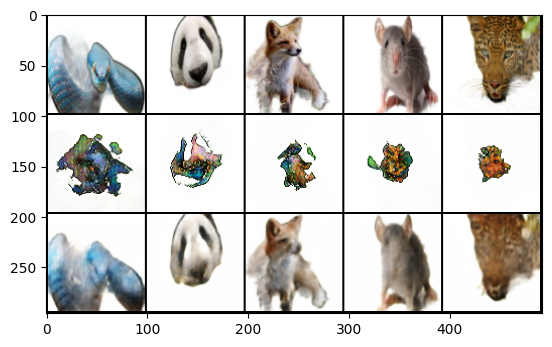

Cycle B: Real B -> Fake A -> Reconstructed B


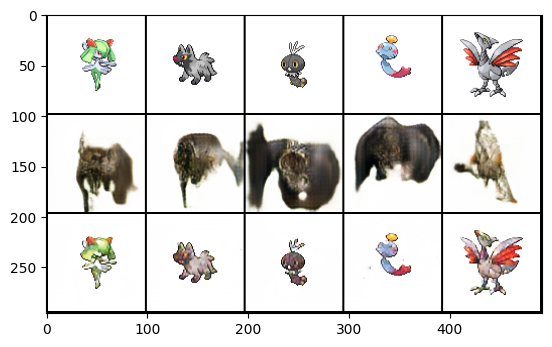

Epoch 241:
  Generator Total Loss: 10.2597
    G_AB (A->B) Loss:  5.6047
    G_BA (B->A) Loss:  4.6550
    Identity Loss:     0.0322
    GAN Loss:          1.4304
    Cycle Loss:        0.0512
    Feature Match:     0.2428
    Perceptual Loss:   0.6763
  Discriminator A Loss: 0.4513
  Discriminator B Loss: 0.3597


Epoch 242:
  Generator Total Loss: 10.2973
    G_AB (A->B) Loss:  5.6233
    G_BA (B->A) Loss:  4.6740
    Identity Loss:     0.0343
    GAN Loss:          1.4344
    Cycle Loss:        0.0536
    Feature Match:     0.2438
    Perceptual Loss:   0.6698
  Discriminator A Loss: 0.4509
  Discriminator B Loss: 0.3551


Epoch 243:
  Generator Total Loss: 10.1744
    G_AB (A->B) Loss:  5.5573
    G_BA (B->A) Loss:  4.6171
    Identity Loss:     0.0295
    GAN Loss:          1.4297
    Cycle Loss:        0.0489
    Feature Match:     0.2410
    Perceptual Loss:   0.6736
  Discriminator A Loss: 0.4459
  Discriminator B Loss: 0.3598


Epoch 244:
  Generator Total Loss: 10.1723
    G_AB (A->B) Loss:  5.5779
    G_BA (B->A) Loss:  4.5944
    Identity Loss:     0.0318
    GAN Loss:          1.4121
    Cycle Loss:        0.0507
    Feature Match:     0.2422
    Perceptual Loss:   0.6684
  Discriminator A Loss: 0.4519
  Discriminator B Loss: 0.3594


Epoch 245:
  Generator Total Loss: 10.2245
    G_AB (A->B) Loss:  5.6113
    G_BA (B->A) Loss:  4.6132
    Identity Loss:     0.0312
    GAN Loss:          1.4327
    Cycle Loss:        0.0504
    Feature Match:     0.2424
    Perceptual Loss:   0.6722
  Discriminator A Loss: 0.4475
  Discriminator B Loss: 0.3559


Epoch 246:
  Generator Total Loss: 10.2119
    G_AB (A->B) Loss:  5.5523
    G_BA (B->A) Loss:  4.6596
    Identity Loss:     0.0308
    GAN Loss:          1.4254
    Cycle Loss:        0.0501
    Feature Match:     0.2427
    Perceptual Loss:   0.6728
  Discriminator A Loss: 0.4450
  Discriminator B Loss: 0.3583


Epoch 247:
  Generator Total Loss: 10.1279
    G_AB (A->B) Loss:  5.5225
    G_BA (B->A) Loss:  4.6054
    Identity Loss:     0.0286
    GAN Loss:          1.4143
    Cycle Loss:        0.0484
    Feature Match:     0.2415
    Perceptual Loss:   0.6707
  Discriminator A Loss: 0.4444
  Discriminator B Loss: 0.3616


Epoch 248:
  Generator Total Loss: 10.2399
    G_AB (A->B) Loss:  5.5746
    G_BA (B->A) Loss:  4.6653
    Identity Loss:     0.0309
    GAN Loss:          1.4537
    Cycle Loss:        0.0505
    Feature Match:     0.2418
    Perceptual Loss:   0.6683
  Discriminator A Loss: 0.4437
  Discriminator B Loss: 0.3556


Epoch 249:
  Generator Total Loss: 10.2492
    G_AB (A->B) Loss:  5.5826
    G_BA (B->A) Loss:  4.6666
    Identity Loss:     0.0324
    GAN Loss:          1.4367
    Cycle Loss:        0.0516
    Feature Match:     0.2425
    Perceptual Loss:   0.6707
  Discriminator A Loss: 0.4485
  Discriminator B Loss: 0.3566


Epoch 250:
  Generator Total Loss: 10.2636
    G_AB (A->B) Loss:  5.6207
    G_BA (B->A) Loss:  4.6429
    Identity Loss:     0.0336
    GAN Loss:          1.4428
    Cycle Loss:        0.0524
    Feature Match:     0.2422
    Perceptual Loss:   0.6682
  Discriminator A Loss: 0.4506
  Discriminator B Loss: 0.3551


Cycle A: Real A -> Fake B -> Reconstructed A


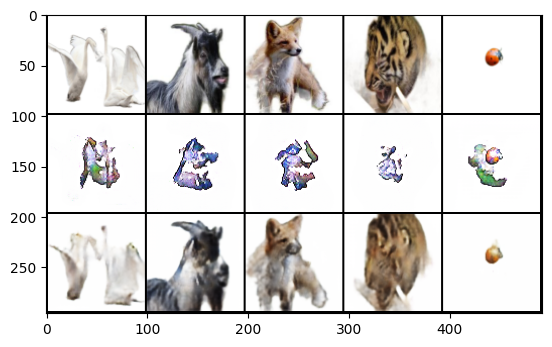

Cycle B: Real B -> Fake A -> Reconstructed B


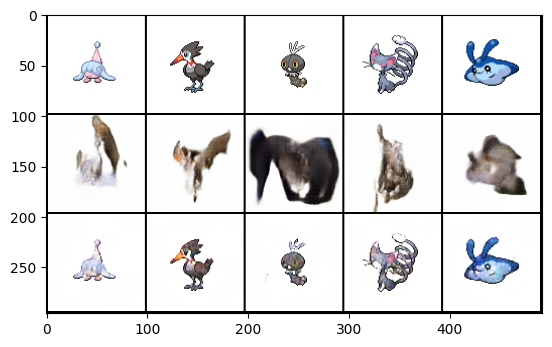

Model saved to models/PokeMalCycleGAN-96x96-G_AB-250-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-250-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-250-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-250-best.pth


Epoch 251:
  Generator Total Loss: 10.1826
    G_AB (A->B) Loss:  5.5691
    G_BA (B->A) Loss:  4.6134
    Identity Loss:     0.0302
    GAN Loss:          1.4355
    Cycle Loss:        0.0496
    Feature Match:     0.2413
    Perceptual Loss:   0.6686
  Discriminator A Loss: 0.4457
  Discriminator B Loss: 0.3566


Epoch 252:
  Generator Total Loss: 10.1637
    G_AB (A->B) Loss:  5.5544
    G_BA (B->A) Loss:  4.6093
    Identity Loss:     0.0288
    GAN Loss:          1.4360
    Cycle Loss:        0.0479
    Feature Match:     0.2420
    Perceptual Loss:   0.6680
  Discriminator A Loss: 0.4469
  Discriminator B Loss: 0.3560


Epoch 253:
  Generator Total Loss: 10.1704
    G_AB (A->B) Loss:  5.5217
    G_BA (B->A) Loss:  4.6486
    Identity Loss:     0.0308
    GAN Loss:          1.4345
    Cycle Loss:        0.0499
    Feature Match:     0.2400
    Perceptual Loss:   0.6693
  Discriminator A Loss: 0.4472
  Discriminator B Loss: 0.3591


Epoch 254:
  Generator Total Loss: 10.1909
    G_AB (A->B) Loss:  5.5654
    G_BA (B->A) Loss:  4.6254
    Identity Loss:     0.0296
    GAN Loss:          1.4396
    Cycle Loss:        0.0487
    Feature Match:     0.2421
    Perceptual Loss:   0.6690
  Discriminator A Loss: 0.4503
  Discriminator B Loss: 0.3538


Epoch 255:
  Generator Total Loss: 10.2585
    G_AB (A->B) Loss:  5.5780
    G_BA (B->A) Loss:  4.6805
    Identity Loss:     0.0329
    GAN Loss:          1.4458
    Cycle Loss:        0.0522
    Feature Match:     0.2415
    Perceptual Loss:   0.6697
  Discriminator A Loss: 0.4462
  Discriminator B Loss: 0.3550


Epoch 256:
  Generator Total Loss: 10.2859
    G_AB (A->B) Loss:  5.6330
    G_BA (B->A) Loss:  4.6529
    Identity Loss:     0.0300
    GAN Loss:          1.4752
    Cycle Loss:        0.0489
    Feature Match:     0.2438
    Perceptual Loss:   0.6672
  Discriminator A Loss: 0.4474
  Discriminator B Loss: 0.3516


Epoch 257:
  Generator Total Loss: 10.1392
    G_AB (A->B) Loss:  5.5402
    G_BA (B->A) Loss:  4.5990
    Identity Loss:     0.0289
    GAN Loss:          1.4253
    Cycle Loss:        0.0479
    Feature Match:     0.2409
    Perceptual Loss:   0.6715
  Discriminator A Loss: 0.4481
  Discriminator B Loss: 0.3576


Epoch 258:
  Generator Total Loss: 10.1006
    G_AB (A->B) Loss:  5.5128
    G_BA (B->A) Loss:  4.5878
    Identity Loss:     0.0282
    GAN Loss:          1.4400
    Cycle Loss:        0.0476
    Feature Match:     0.2383
    Perceptual Loss:   0.6667
  Discriminator A Loss: 0.4471
  Discriminator B Loss: 0.3566


Epoch 259:
  Generator Total Loss: 10.1730
    G_AB (A->B) Loss:  5.5623
    G_BA (B->A) Loss:  4.6107
    Identity Loss:     0.0299
    GAN Loss:          1.4414
    Cycle Loss:        0.0489
    Feature Match:     0.2407
    Perceptual Loss:   0.6679
  Discriminator A Loss: 0.4512
  Discriminator B Loss: 0.3558


Epoch 260:
  Generator Total Loss: 10.3140
    G_AB (A->B) Loss:  5.6148
    G_BA (B->A) Loss:  4.6993
    Identity Loss:     0.0330
    GAN Loss:          1.4757
    Cycle Loss:        0.0518
    Feature Match:     0.2426
    Perceptual Loss:   0.6655
  Discriminator A Loss: 0.4433
  Discriminator B Loss: 0.3512


Cycle A: Real A -> Fake B -> Reconstructed A


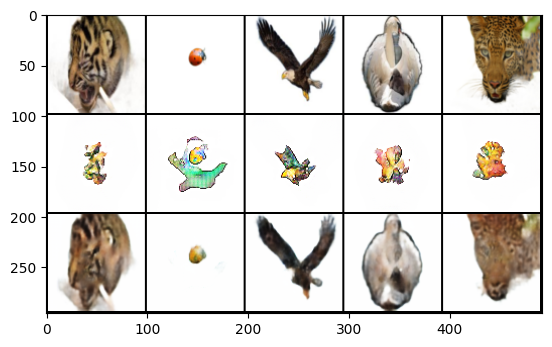

Cycle B: Real B -> Fake A -> Reconstructed B


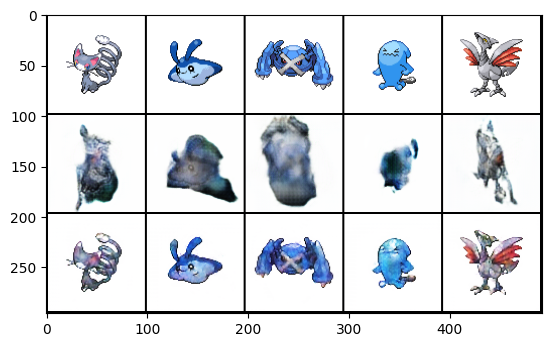

Epoch 261:
  Generator Total Loss: 10.1896
    G_AB (A->B) Loss:  5.5511
    G_BA (B->A) Loss:  4.6385
    Identity Loss:     0.0288
    GAN Loss:          1.4522
    Cycle Loss:        0.0480
    Feature Match:     0.2419
    Perceptual Loss:   0.6667
  Discriminator A Loss: 0.4477
  Discriminator B Loss: 0.3530


Epoch 262:
  Generator Total Loss: 10.2125
    G_AB (A->B) Loss:  5.5830
    G_BA (B->A) Loss:  4.6295
    Identity Loss:     0.0294
    GAN Loss:          1.4508
    Cycle Loss:        0.0487
    Feature Match:     0.2422
    Perceptual Loss:   0.6689
  Discriminator A Loss: 0.4509
  Discriminator B Loss: 0.3569


Epoch 263:
  Generator Total Loss: 10.1925
    G_AB (A->B) Loss:  5.5552
    G_BA (B->A) Loss:  4.6374
    Identity Loss:     0.0290
    GAN Loss:          1.4553
    Cycle Loss:        0.0480
    Feature Match:     0.2421
    Perceptual Loss:   0.6644
  Discriminator A Loss: 0.4453
  Discriminator B Loss: 0.3544


Epoch 264:
  Generator Total Loss: 10.3075
    G_AB (A->B) Loss:  5.6189
    G_BA (B->A) Loss:  4.6886
    Identity Loss:     0.0329
    GAN Loss:          1.4699
    Cycle Loss:        0.0518
    Feature Match:     0.2428
    Perceptual Loss:   0.6659
  Discriminator A Loss: 0.4492
  Discriminator B Loss: 0.3526


Epoch 265:
  Generator Total Loss: 10.2392
    G_AB (A->B) Loss:  5.5616
    G_BA (B->A) Loss:  4.6776
    Identity Loss:     0.0311
    GAN Loss:          1.4545
    Cycle Loss:        0.0503
    Feature Match:     0.2423
    Perceptual Loss:   0.6657
  Discriminator A Loss: 0.4535
  Discriminator B Loss: 0.3520


Epoch 266:
  Generator Total Loss: 10.2408
    G_AB (A->B) Loss:  5.5759
    G_BA (B->A) Loss:  4.6649
    Identity Loss:     0.0318
    GAN Loss:          1.4658
    Cycle Loss:        0.0507
    Feature Match:     0.2411
    Perceptual Loss:   0.6630
  Discriminator A Loss: 0.4507
  Discriminator B Loss: 0.3479


Epoch 267:
  Generator Total Loss: 10.1075
    G_AB (A->B) Loss:  5.4910
    G_BA (B->A) Loss:  4.6165
    Identity Loss:     0.0272
    GAN Loss:          1.4434
    Cycle Loss:        0.0466
    Feature Match:     0.2398
    Perceptual Loss:   0.6654
  Discriminator A Loss: 0.4523
  Discriminator B Loss: 0.3544


Epoch 268:
  Generator Total Loss: 10.2434
    G_AB (A->B) Loss:  5.5795
    G_BA (B->A) Loss:  4.6639
    Identity Loss:     0.0317
    GAN Loss:          1.4593
    Cycle Loss:        0.0507
    Feature Match:     0.2414
    Perceptual Loss:   0.6658
  Discriminator A Loss: 0.4446
  Discriminator B Loss: 0.3558


Epoch 269:
  Generator Total Loss: 10.2211
    G_AB (A->B) Loss:  5.5327
    G_BA (B->A) Loss:  4.6884
    Identity Loss:     0.0306
    GAN Loss:          1.4508
    Cycle Loss:        0.0500
    Feature Match:     0.2415
    Perceptual Loss:   0.6681
  Discriminator A Loss: 0.4514
  Discriminator B Loss: 0.3530


Epoch 270:
  Generator Total Loss: 10.2081
    G_AB (A->B) Loss:  5.5516
    G_BA (B->A) Loss:  4.6564
    Identity Loss:     0.0299
    GAN Loss:          1.4542
    Cycle Loss:        0.0491
    Feature Match:     0.2417
    Perceptual Loss:   0.6661
  Discriminator A Loss: 0.4490
  Discriminator B Loss: 0.3543


Cycle A: Real A -> Fake B -> Reconstructed A


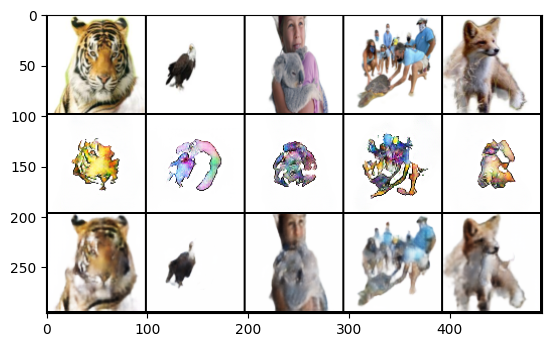

Cycle B: Real B -> Fake A -> Reconstructed B


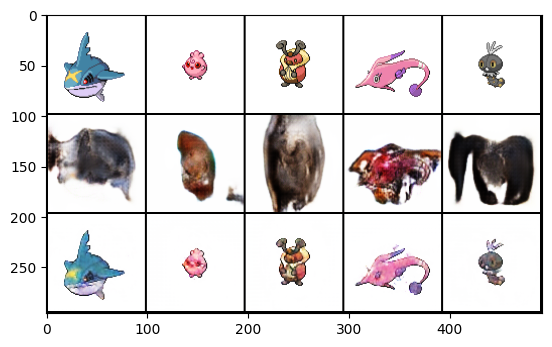

Epoch 271:
  Generator Total Loss: 10.1441
    G_AB (A->B) Loss:  5.5043
    G_BA (B->A) Loss:  4.6398
    Identity Loss:     0.0275
    GAN Loss:          1.4470
    Cycle Loss:        0.0470
    Feature Match:     0.2409
    Perceptual Loss:   0.6667
  Discriminator A Loss: 0.4535
  Discriminator B Loss: 0.3537


Epoch 272:
  Generator Total Loss: 10.2293
    G_AB (A->B) Loss:  5.5654
    G_BA (B->A) Loss:  4.6639
    Identity Loss:     0.0280
    GAN Loss:          1.4569
    Cycle Loss:        0.0474
    Feature Match:     0.2443
    Perceptual Loss:   0.6675
  Discriminator A Loss: 0.4459
  Discriminator B Loss: 0.3542


Epoch 273:
  Generator Total Loss: 10.0806
    G_AB (A->B) Loss:  5.4977
    G_BA (B->A) Loss:  4.5829
    Identity Loss:     0.0255
    GAN Loss:          1.4397
    Cycle Loss:        0.0449
    Feature Match:     0.2404
    Perceptual Loss:   0.6657
  Discriminator A Loss: 0.4546
  Discriminator B Loss: 0.3551


Epoch 274:
  Generator Total Loss: 10.1712
    G_AB (A->B) Loss:  5.5352
    G_BA (B->A) Loss:  4.6360
    Identity Loss:     0.0289
    GAN Loss:          1.4489
    Cycle Loss:        0.0480
    Feature Match:     0.2415
    Perceptual Loss:   0.6650
  Discriminator A Loss: 0.4522
  Discriminator B Loss: 0.3534


Epoch 275:
  Generator Total Loss: 10.0906
    G_AB (A->B) Loss:  5.4867
    G_BA (B->A) Loss:  4.6039
    Identity Loss:     0.0266
    GAN Loss:          1.4372
    Cycle Loss:        0.0460
    Feature Match:     0.2405
    Perceptual Loss:   0.6644
  Discriminator A Loss: 0.4516
  Discriminator B Loss: 0.3561
Model saved to models/PokeMalCycleGAN-96x96-G_AB-275-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-275-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-275-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-275-best.pth


Epoch 276:
  Generator Total Loss: 10.1865
    G_AB (A->B) Loss:  5.5505
    G_BA (B->A) Loss:  4.6360
    Identity Loss:     0.0294
    GAN Loss:          1.4505
    Cycle Loss:        0.0486
    Feature Match:     0.2415
    Perceptual Loss:   0.6657
  Discriminator A Loss: 0.4497
  Discriminator B Loss: 0.3553


Epoch 277:
  Generator Total Loss: 10.0903
    G_AB (A->B) Loss:  5.4876
    G_BA (B->A) Loss:  4.6027
    Identity Loss:     0.0258
    GAN Loss:          1.4460
    Cycle Loss:        0.0451
    Feature Match:     0.2407
    Perceptual Loss:   0.6628
  Discriminator A Loss: 0.4494
  Discriminator B Loss: 0.3551


Epoch 278:
  Generator Total Loss: 10.1045
    G_AB (A->B) Loss:  5.4868
    G_BA (B->A) Loss:  4.6177
    Identity Loss:     0.0281
    GAN Loss:          1.4470
    Cycle Loss:        0.0472
    Feature Match:     0.2396
    Perceptual Loss:   0.6605
  Discriminator A Loss: 0.4550
  Discriminator B Loss: 0.3530


Epoch 279:
  Generator Total Loss: 10.0769
    G_AB (A->B) Loss:  5.4751
    G_BA (B->A) Loss:  4.6017
    Identity Loss:     0.0258
    GAN Loss:          1.4447
    Cycle Loss:        0.0452
    Feature Match:     0.2398
    Perceptual Loss:   0.6635
  Discriminator A Loss: 0.4532
  Discriminator B Loss: 0.3540


Epoch 280:
  Generator Total Loss: 10.2064
    G_AB (A->B) Loss:  5.5466
    G_BA (B->A) Loss:  4.6598
    Identity Loss:     0.0313
    GAN Loss:          1.4574
    Cycle Loss:        0.0503
    Feature Match:     0.2412
    Perceptual Loss:   0.6604
  Discriminator A Loss: 0.4496
  Discriminator B Loss: 0.3518


Cycle A: Real A -> Fake B -> Reconstructed A


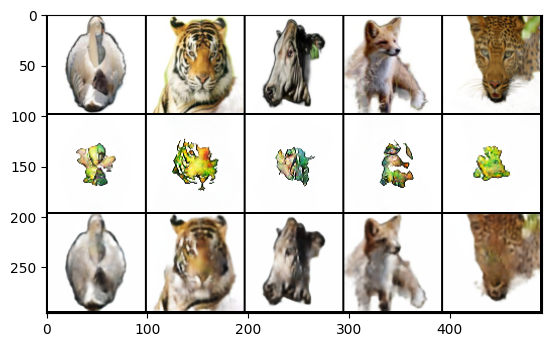

Cycle B: Real B -> Fake A -> Reconstructed B


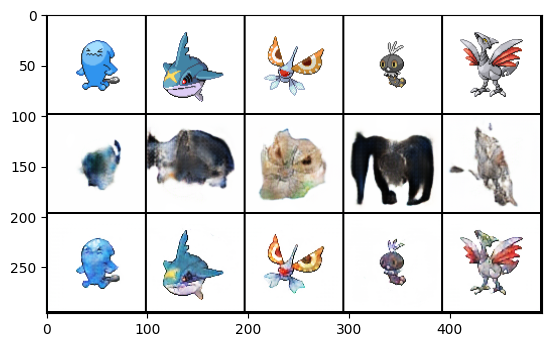

Epoch 281:
  Generator Total Loss: 10.2036
    G_AB (A->B) Loss:  5.5595
    G_BA (B->A) Loss:  4.6441
    Identity Loss:     0.0293
    GAN Loss:          1.4632
    Cycle Loss:        0.0483
    Feature Match:     0.2418
    Perceptual Loss:   0.6632
  Discriminator A Loss: 0.4494
  Discriminator B Loss: 0.3506


Epoch 282:
  Generator Total Loss: 10.0315
    G_AB (A->B) Loss:  5.4505
    G_BA (B->A) Loss:  4.5810
    Identity Loss:     0.0255
    GAN Loss:          1.4319
    Cycle Loss:        0.0447
    Feature Match:     0.2395
    Perceptual Loss:   0.6615
  Discriminator A Loss: 0.4555
  Discriminator B Loss: 0.3542


Epoch 283:
  Generator Total Loss: 10.0926
    G_AB (A->B) Loss:  5.4680
    G_BA (B->A) Loss:  4.6247
    Identity Loss:     0.0278
    GAN Loss:          1.4330
    Cycle Loss:        0.0470
    Feature Match:     0.2405
    Perceptual Loss:   0.6623
  Discriminator A Loss: 0.4548
  Discriminator B Loss: 0.3549


Epoch 284:
  Generator Total Loss: 10.0906
    G_AB (A->B) Loss:  5.4753
    G_BA (B->A) Loss:  4.6153
    Identity Loss:     0.0290
    GAN Loss:          1.4417
    Cycle Loss:        0.0479
    Feature Match:     0.2385
    Perceptual Loss:   0.6604
  Discriminator A Loss: 0.4535
  Discriminator B Loss: 0.3545


Epoch 285:
  Generator Total Loss: 10.1812
    G_AB (A->B) Loss:  5.5174
    G_BA (B->A) Loss:  4.6638
    Identity Loss:     0.0289
    GAN Loss:          1.4547
    Cycle Loss:        0.0480
    Feature Match:     0.2420
    Perceptual Loss:   0.6623
  Discriminator A Loss: 0.4498
  Discriminator B Loss: 0.3514


Epoch 286:
  Generator Total Loss: 10.1666
    G_AB (A->B) Loss:  5.5229
    G_BA (B->A) Loss:  4.6438
    Identity Loss:     0.0284
    GAN Loss:          1.4477
    Cycle Loss:        0.0476
    Feature Match:     0.2419
    Perceptual Loss:   0.6648
  Discriminator A Loss: 0.4499
  Discriminator B Loss: 0.3550


Epoch 287:
  Generator Total Loss: 10.0574
    G_AB (A->B) Loss:  5.4603
    G_BA (B->A) Loss:  4.5971
    Identity Loss:     0.0273
    GAN Loss:          1.4338
    Cycle Loss:        0.0464
    Feature Match:     0.2389
    Perceptual Loss:   0.6617
  Discriminator A Loss: 0.4526
  Discriminator B Loss: 0.3562


Epoch 288:
  Generator Total Loss: 10.0693
    G_AB (A->B) Loss:  5.4695
    G_BA (B->A) Loss:  4.5998
    Identity Loss:     0.0280
    GAN Loss:          1.4337
    Cycle Loss:        0.0469
    Feature Match:     0.2392
    Perceptual Loss:   0.6610
  Discriminator A Loss: 0.4593
  Discriminator B Loss: 0.3530


Epoch 289:
  Generator Total Loss: 9.9830
    G_AB (A->B) Loss:  5.4230
    G_BA (B->A) Loss:  4.5600
    Identity Loss:     0.0249
    GAN Loss:          1.4248
    Cycle Loss:        0.0440
    Feature Match:     0.2382
    Perceptual Loss:   0.6611
  Discriminator A Loss: 0.4579
  Discriminator B Loss: 0.3560


Epoch 290:
  Generator Total Loss: 10.1134
    G_AB (A->B) Loss:  5.4991
    G_BA (B->A) Loss:  4.6143
    Identity Loss:     0.0275
    GAN Loss:          1.4456
    Cycle Loss:        0.0467
    Feature Match:     0.2405
    Perceptual Loss:   0.6625
  Discriminator A Loss: 0.4531
  Discriminator B Loss: 0.3528


Cycle A: Real A -> Fake B -> Reconstructed A


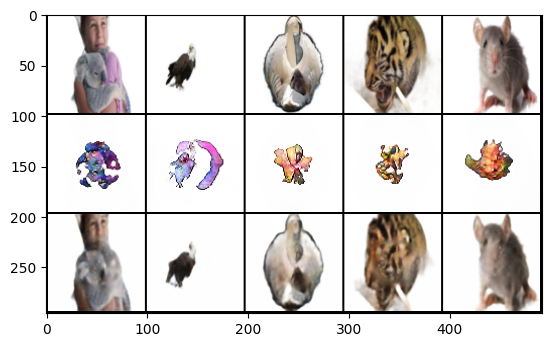

Cycle B: Real B -> Fake A -> Reconstructed B


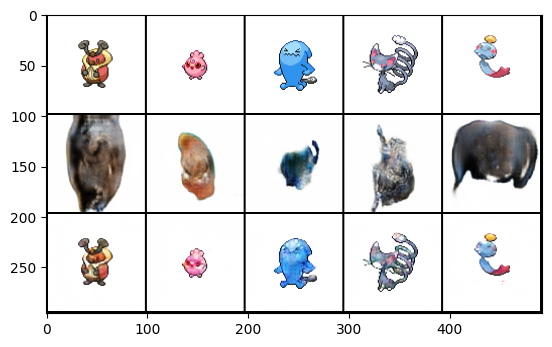

Epoch 291:
  Generator Total Loss: 10.0174
    G_AB (A->B) Loss:  5.4412
    G_BA (B->A) Loss:  4.5763
    Identity Loss:     0.0260
    GAN Loss:          1.4283
    Cycle Loss:        0.0452
    Feature Match:     0.2384
    Perceptual Loss:   0.6622
  Discriminator A Loss: 0.4572
  Discriminator B Loss: 0.3561


Epoch 292:
  Generator Total Loss: 9.9787
    G_AB (A->B) Loss:  5.4192
    G_BA (B->A) Loss:  4.5596
    Identity Loss:     0.0261
    GAN Loss:          1.4237
    Cycle Loss:        0.0450
    Feature Match:     0.2371
    Perceptual Loss:   0.6602
  Discriminator A Loss: 0.4541
  Discriminator B Loss: 0.3581


Epoch 293:
  Generator Total Loss: 10.0250
    G_AB (A->B) Loss:  5.4618
    G_BA (B->A) Loss:  4.5632
    Identity Loss:     0.0256
    GAN Loss:          1.4253
    Cycle Loss:        0.0445
    Feature Match:     0.2401
    Perceptual Loss:   0.6613
  Discriminator A Loss: 0.4567
  Discriminator B Loss: 0.3550


Epoch 294:
  Generator Total Loss: 10.0410
    G_AB (A->B) Loss:  5.4541
    G_BA (B->A) Loss:  4.5869
    Identity Loss:     0.0272
    GAN Loss:          1.4321
    Cycle Loss:        0.0460
    Feature Match:     0.2391
    Perceptual Loss:   0.6589
  Discriminator A Loss: 0.4545
  Discriminator B Loss: 0.3539


Epoch 295:
  Generator Total Loss: 9.9681
    G_AB (A->B) Loss:  5.4149
    G_BA (B->A) Loss:  4.5533
    Identity Loss:     0.0243
    GAN Loss:          1.4183
    Cycle Loss:        0.0434
    Feature Match:     0.2386
    Perceptual Loss:   0.6618
  Discriminator A Loss: 0.4577
  Discriminator B Loss: 0.3579


Epoch 296:
  Generator Total Loss: 10.0341
    G_AB (A->B) Loss:  5.4346
    G_BA (B->A) Loss:  4.5995
    Identity Loss:     0.0270
    GAN Loss:          1.4249
    Cycle Loss:        0.0460
    Feature Match:     0.2390
    Perceptual Loss:   0.6617
  Discriminator A Loss: 0.4595
  Discriminator B Loss: 0.3549


Epoch 297:
  Generator Total Loss: 9.8985
    G_AB (A->B) Loss:  5.3673
    G_BA (B->A) Loss:  4.5313
    Identity Loss:     0.0234
    GAN Loss:          1.4041
    Cycle Loss:        0.0425
    Feature Match:     0.2371
    Perceptual Loss:   0.6616
  Discriminator A Loss: 0.4591
  Discriminator B Loss: 0.3596


Epoch 298:
  Generator Total Loss: 10.0127
    G_AB (A->B) Loss:  5.4491
    G_BA (B->A) Loss:  4.5636
    Identity Loss:     0.0267
    GAN Loss:          1.4274
    Cycle Loss:        0.0456
    Feature Match:     0.2381
    Perceptual Loss:   0.6605
  Discriminator A Loss: 0.4546
  Discriminator B Loss: 0.3574


Epoch 299:
  Generator Total Loss: 10.0616
    G_AB (A->B) Loss:  5.4535
    G_BA (B->A) Loss:  4.6081
    Identity Loss:     0.0287
    GAN Loss:          1.4325
    Cycle Loss:        0.0473
    Feature Match:     0.2389
    Perceptual Loss:   0.6588
  Discriminator A Loss: 0.4528
  Discriminator B Loss: 0.3557


Epoch 300:
  Generator Total Loss: 9.9976
    G_AB (A->B) Loss:  5.4202
    G_BA (B->A) Loss:  4.5774
    Identity Loss:     0.0264
    GAN Loss:          1.4233
    Cycle Loss:        0.0452
    Feature Match:     0.2381
    Perceptual Loss:   0.6604
  Discriminator A Loss: 0.4559
  Discriminator B Loss: 0.3579


Cycle A: Real A -> Fake B -> Reconstructed A


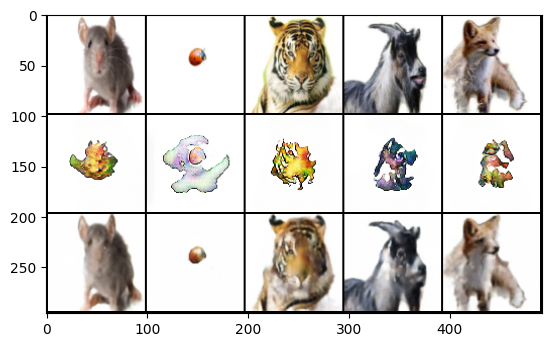

Cycle B: Real B -> Fake A -> Reconstructed B


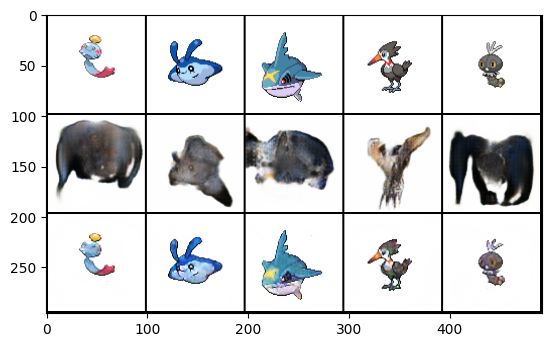

Model saved to models/PokeMalCycleGAN-96x96-G_AB-300-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-300-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-300-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-300-best.pth


Epoch 301:
  Generator Total Loss: 10.1209
    G_AB (A->B) Loss:  5.4781
    G_BA (B->A) Loss:  4.6428
    Identity Loss:     0.0308
    GAN Loss:          1.4403
    Cycle Loss:        0.0494
    Feature Match:     0.2392
    Perceptual Loss:   0.6591
  Discriminator A Loss: 0.4545
  Discriminator B Loss: 0.3537


Epoch 302:
  Generator Total Loss: 10.0069
    G_AB (A->B) Loss:  5.4216
    G_BA (B->A) Loss:  4.5854
    Identity Loss:     0.0276
    GAN Loss:          1.4205
    Cycle Loss:        0.0464
    Feature Match:     0.2377
    Perceptual Loss:   0.6601
  Discriminator A Loss: 0.4578
  Discriminator B Loss: 0.3575


Epoch 303:
  Generator Total Loss: 10.0184
    G_AB (A->B) Loss:  5.4325
    G_BA (B->A) Loss:  4.5859
    Identity Loss:     0.0262
    GAN Loss:          1.4222
    Cycle Loss:        0.0451
    Feature Match:     0.2395
    Perceptual Loss:   0.6610
  Discriminator A Loss: 0.4577
  Discriminator B Loss: 0.3561


Epoch 304:
  Generator Total Loss: 10.1007
    G_AB (A->B) Loss:  5.4576
    G_BA (B->A) Loss:  4.6431
    Identity Loss:     0.0311
    GAN Loss:          1.4343
    Cycle Loss:        0.0495
    Feature Match:     0.2386
    Perceptual Loss:   0.6585
  Discriminator A Loss: 0.4562
  Discriminator B Loss: 0.3545


Epoch 305:
  Generator Total Loss: 9.9427
    G_AB (A->B) Loss:  5.3812
    G_BA (B->A) Loss:  4.5615
    Identity Loss:     0.0261
    GAN Loss:          1.4094
    Cycle Loss:        0.0448
    Feature Match:     0.2374
    Perceptual Loss:   0.6580
  Discriminator A Loss: 0.4574
  Discriminator B Loss: 0.3597


Epoch 306:
  Generator Total Loss: 9.9787
    G_AB (A->B) Loss:  5.3852
    G_BA (B->A) Loss:  4.5936
    Identity Loss:     0.0265
    GAN Loss:          1.4137
    Cycle Loss:        0.0454
    Feature Match:     0.2379
    Perceptual Loss:   0.6602
  Discriminator A Loss: 0.4587
  Discriminator B Loss: 0.3566


Epoch 307:
  Generator Total Loss: 9.9609
    G_AB (A->B) Loss:  5.3824
    G_BA (B->A) Loss:  4.5785
    Identity Loss:     0.0260
    GAN Loss:          1.4103
    Cycle Loss:        0.0448
    Feature Match:     0.2379
    Perceptual Loss:   0.6603
  Discriminator A Loss: 0.4586
  Discriminator B Loss: 0.3581


Epoch 308:
  Generator Total Loss: 10.0378
    G_AB (A->B) Loss:  5.4245
    G_BA (B->A) Loss:  4.6133
    Identity Loss:     0.0276
    GAN Loss:          1.4210
    Cycle Loss:        0.0463
    Feature Match:     0.2395
    Perceptual Loss:   0.6605
  Discriminator A Loss: 0.4563
  Discriminator B Loss: 0.3575


Epoch 309:
  Generator Total Loss: 9.8825
    G_AB (A->B) Loss:  5.3352
    G_BA (B->A) Loss:  4.5473
    Identity Loss:     0.0254
    GAN Loss:          1.3971
    Cycle Loss:        0.0442
    Feature Match:     0.2357
    Perceptual Loss:   0.6586
  Discriminator A Loss: 0.4605
  Discriminator B Loss: 0.3619


Epoch 310:
  Generator Total Loss: 10.0594
    G_AB (A->B) Loss:  5.4334
    G_BA (B->A) Loss:  4.6260
    Identity Loss:     0.0283
    GAN Loss:          1.4267
    Cycle Loss:        0.0470
    Feature Match:     0.2393
    Perceptual Loss:   0.6608
  Discriminator A Loss: 0.4513
  Discriminator B Loss: 0.3585


Cycle A: Real A -> Fake B -> Reconstructed A


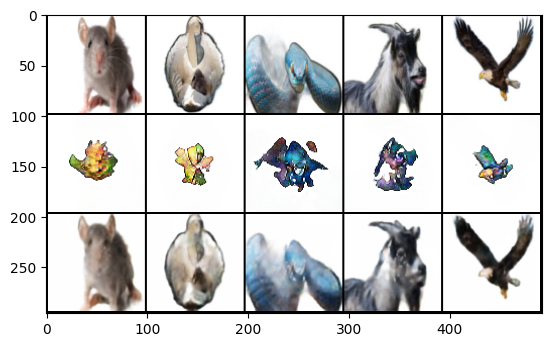

Cycle B: Real B -> Fake A -> Reconstructed B


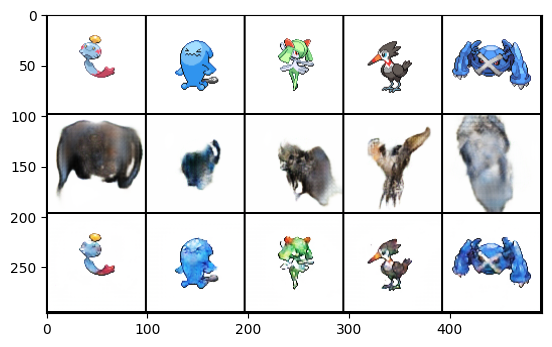

Epoch 311:
  Generator Total Loss: 8.7703
    G_AB (A->B) Loss:  4.7407
    G_BA (B->A) Loss:  4.0296
    Identity Loss:     0.0314
    GAN Loss:          1.0870
    Cycle Loss:        0.0501
    Feature Match:     0.1995
    Perceptual Loss:   0.6533
  Discriminator A Loss: 0.7449
  Discriminator B Loss: 0.7709


Epoch 312:
  Generator Total Loss: 9.0107
    G_AB (A->B) Loss:  4.8618
    G_BA (B->A) Loss:  4.1489
    Identity Loss:     0.0312
    GAN Loss:          1.1594
    Cycle Loss:        0.0488
    Feature Match:     0.2034
    Perceptual Loss:   0.6664
  Discriminator A Loss: 0.5053
  Discriminator B Loss: 0.4679


Epoch 313:
  Generator Total Loss: 9.1787
    G_AB (A->B) Loss:  4.8829
    G_BA (B->A) Loss:  4.2958
    Identity Loss:     0.0341
    GAN Loss:          1.1793
    Cycle Loss:        0.0520
    Feature Match:     0.2081
    Perceptual Loss:   0.6657
  Discriminator A Loss: 0.4869
  Discriminator B Loss: 0.4629


Epoch 314:
  Generator Total Loss: 9.2761
    G_AB (A->B) Loss:  4.9520
    G_BA (B->A) Loss:  4.3241
    Identity Loss:     0.0349
    GAN Loss:          1.1916
    Cycle Loss:        0.0522
    Feature Match:     0.2108
    Perceptual Loss:   0.6711
  Discriminator A Loss: 0.4873
  Discriminator B Loss: 0.4442


Epoch 315:
  Generator Total Loss: 9.3724
    G_AB (A->B) Loss:  5.0196
    G_BA (B->A) Loss:  4.3528
    Identity Loss:     0.0351
    GAN Loss:          1.2159
    Cycle Loss:        0.0529
    Feature Match:     0.2128
    Perceptual Loss:   0.6726
  Discriminator A Loss: 0.4770
  Discriminator B Loss: 0.4355


Epoch 316:
  Generator Total Loss: 9.5537
    G_AB (A->B) Loss:  5.1567
    G_BA (B->A) Loss:  4.3970
    Identity Loss:     0.0345
    GAN Loss:          1.2438
    Cycle Loss:        0.0528
    Feature Match:     0.2209
    Perceptual Loss:   0.6729
  Discriminator A Loss: 0.4727
  Discriminator B Loss: 0.4158


Epoch 317:
  Generator Total Loss: 9.4938
    G_AB (A->B) Loss:  5.0855
    G_BA (B->A) Loss:  4.4083
    Identity Loss:     0.0323
    GAN Loss:          1.2614
    Cycle Loss:        0.0504
    Feature Match:     0.2178
    Perceptual Loss:   0.6720
  Discriminator A Loss: 0.4690
  Discriminator B Loss: 0.4072


Epoch 318:
  Generator Total Loss: 9.5819
    G_AB (A->B) Loss:  5.1450
    G_BA (B->A) Loss:  4.4369
    Identity Loss:     0.0334
    GAN Loss:          1.2850
    Cycle Loss:        0.0522
    Feature Match:     0.2184
    Perceptual Loss:   0.6727
  Discriminator A Loss: 0.4668
  Discriminator B Loss: 0.3902


Epoch 319:
  Generator Total Loss: 9.9236
    G_AB (A->B) Loss:  5.3436
    G_BA (B->A) Loss:  4.5800
    Identity Loss:     0.0384
    GAN Loss:          1.3457
    Cycle Loss:        0.0580
    Feature Match:     0.2255
    Perceptual Loss:   0.6744
  Discriminator A Loss: 0.4581
  Discriminator B Loss: 0.3815


Epoch 320:
  Generator Total Loss: 9.7460
    G_AB (A->B) Loss:  5.2599
    G_BA (B->A) Loss:  4.4861
    Identity Loss:     0.0331
    GAN Loss:          1.3358
    Cycle Loss:        0.0523
    Feature Match:     0.2219
    Perceptual Loss:   0.6748
  Discriminator A Loss: 0.4629
  Discriminator B Loss: 0.3721


Cycle A: Real A -> Fake B -> Reconstructed A


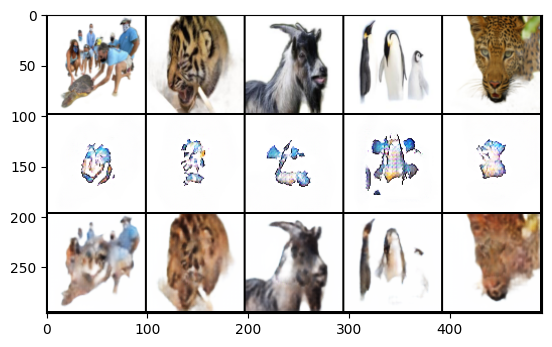

Cycle B: Real B -> Fake A -> Reconstructed B


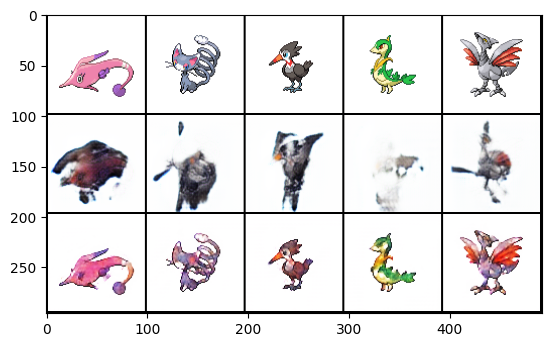

Epoch 321:
  Generator Total Loss: 9.9878
    G_AB (A->B) Loss:  5.4223
    G_BA (B->A) Loss:  4.5655
    Identity Loss:     0.0367
    GAN Loss:          1.3853
    Cycle Loss:        0.0556
    Feature Match:     0.2280
    Perceptual Loss:   0.6705
  Discriminator A Loss: 0.4630
  Discriminator B Loss: 0.3621


Epoch 322:
  Generator Total Loss: 9.8840
    G_AB (A->B) Loss:  5.3635
    G_BA (B->A) Loss:  4.5205
    Identity Loss:     0.0365
    GAN Loss:          1.3632
    Cycle Loss:        0.0546
    Feature Match:     0.2245
    Perceptual Loss:   0.6728
  Discriminator A Loss: 0.4526
  Discriminator B Loss: 0.3686


Epoch 323:
  Generator Total Loss: 10.0308
    G_AB (A->B) Loss:  5.4489
    G_BA (B->A) Loss:  4.5819
    Identity Loss:     0.0348
    GAN Loss:          1.3959
    Cycle Loss:        0.0547
    Feature Match:     0.2294
    Perceptual Loss:   0.6761
  Discriminator A Loss: 0.4544
  Discriminator B Loss: 0.3618


Epoch 324:
  Generator Total Loss: 10.1435
    G_AB (A->B) Loss:  5.5537
    G_BA (B->A) Loss:  4.5898
    Identity Loss:     0.0353
    GAN Loss:          1.4277
    Cycle Loss:        0.0549
    Feature Match:     0.2330
    Perceptual Loss:   0.6725
  Discriminator A Loss: 0.4524
  Discriminator B Loss: 0.3519


Epoch 325:
  Generator Total Loss: 10.1775
    G_AB (A->B) Loss:  5.5768
    G_BA (B->A) Loss:  4.6007
    Identity Loss:     0.0322
    GAN Loss:          1.4650
    Cycle Loss:        0.0522
    Feature Match:     0.2344
    Perceptual Loss:   0.6695
  Discriminator A Loss: 0.4454
  Discriminator B Loss: 0.3471
Model saved to models/PokeMalCycleGAN-96x96-G_AB-325-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-325-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-325-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-325-best.pth


Epoch 326:
  Generator Total Loss: 10.3084
    G_AB (A->B) Loss:  5.6534
    G_BA (B->A) Loss:  4.6550
    Identity Loss:     0.0372
    GAN Loss:          1.4728
    Cycle Loss:        0.0569
    Feature Match:     0.2356
    Perceptual Loss:   0.6717
  Discriminator A Loss: 0.4471
  Discriminator B Loss: 0.3455


Epoch 327:
  Generator Total Loss: 10.1868
    G_AB (A->B) Loss:  5.5962
    G_BA (B->A) Loss:  4.5906
    Identity Loss:     0.0383
    GAN Loss:          1.4514
    Cycle Loss:        0.0573
    Feature Match:     0.2293
    Perceptual Loss:   0.6746
  Discriminator A Loss: 0.6073
  Discriminator B Loss: 0.3443


Epoch 328:
  Generator Total Loss: 9.9220
    G_AB (A->B) Loss:  5.4031
    G_BA (B->A) Loss:  4.5189
    Identity Loss:     0.0337
    GAN Loss:          1.4190
    Cycle Loss:        0.0524
    Feature Match:     0.2221
    Perceptual Loss:   0.6747
  Discriminator A Loss: 0.5008
  Discriminator B Loss: 0.3481


Epoch 329:
  Generator Total Loss: 9.9482
    G_AB (A->B) Loss:  5.4283
    G_BA (B->A) Loss:  4.5199
    Identity Loss:     0.0346
    GAN Loss:          1.4490
    Cycle Loss:        0.0521
    Feature Match:     0.2203
    Perceptual Loss:   0.6730
  Discriminator A Loss: 0.4777
  Discriminator B Loss: 0.3437


Epoch 330:
  Generator Total Loss: 10.0636
    G_AB (A->B) Loss:  5.4922
    G_BA (B->A) Loss:  4.5714
    Identity Loss:     0.0351
    GAN Loss:          1.4560
    Cycle Loss:        0.0542
    Feature Match:     0.2252
    Perceptual Loss:   0.6721
  Discriminator A Loss: 0.4739
  Discriminator B Loss: 0.3450


Cycle A: Real A -> Fake B -> Reconstructed A


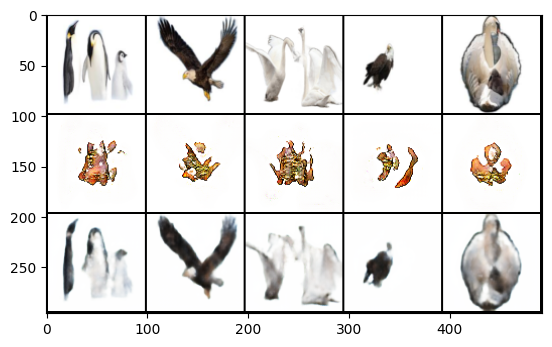

Cycle B: Real B -> Fake A -> Reconstructed B


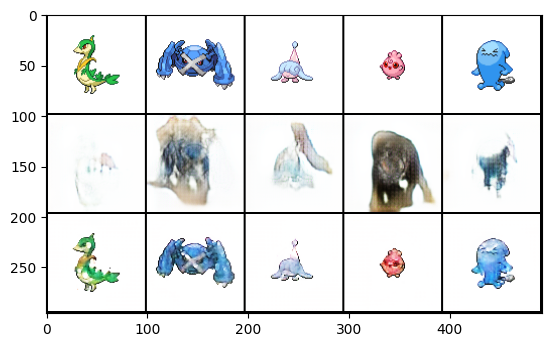

Epoch 331:
  Generator Total Loss: 10.1562
    G_AB (A->B) Loss:  5.5591
    G_BA (B->A) Loss:  4.5970
    Identity Loss:     0.0348
    GAN Loss:          1.4848
    Cycle Loss:        0.0537
    Feature Match:     0.2274
    Perceptual Loss:   0.6740
  Discriminator A Loss: 0.4622
  Discriminator B Loss: 0.3400


Epoch 332:
  Generator Total Loss: 10.1931
    G_AB (A->B) Loss:  5.5487
    G_BA (B->A) Loss:  4.6444
    Identity Loss:     0.0418
    GAN Loss:          1.4834
    Cycle Loss:        0.0527
    Feature Match:     0.2270
    Perceptual Loss:   0.6779
  Discriminator A Loss: 0.4563
  Discriminator B Loss: 0.3397


Epoch 333:
  Generator Total Loss: 10.2348
    G_AB (A->B) Loss:  5.6331
    G_BA (B->A) Loss:  4.6018
    Identity Loss:     0.0339
    GAN Loss:          1.5108
    Cycle Loss:        0.0531
    Feature Match:     0.2309
    Perceptual Loss:   0.6696
  Discriminator A Loss: 0.4517
  Discriminator B Loss: 0.3347


Epoch 334:
  Generator Total Loss: 10.2642
    G_AB (A->B) Loss:  5.6663
    G_BA (B->A) Loss:  4.5978
    Identity Loss:     0.0339
    GAN Loss:          1.4926
    Cycle Loss:        0.0533
    Feature Match:     0.2331
    Perceptual Loss:   0.6766
  Discriminator A Loss: 0.4572
  Discriminator B Loss: 0.3373


Epoch 335:
  Generator Total Loss: 10.3041
    G_AB (A->B) Loss:  5.6805
    G_BA (B->A) Loss:  4.6236
    Identity Loss:     0.0347
    GAN Loss:          1.5225
    Cycle Loss:        0.0546
    Feature Match:     0.2321
    Perceptual Loss:   0.6708
  Discriminator A Loss: 0.4575
  Discriminator B Loss: 0.3336


Epoch 336:
  Generator Total Loss: 10.3902
    G_AB (A->B) Loss:  5.7329
    G_BA (B->A) Loss:  4.6573
    Identity Loss:     0.0383
    GAN Loss:          1.5255
    Cycle Loss:        0.0576
    Feature Match:     0.2330
    Perceptual Loss:   0.6724
  Discriminator A Loss: 0.4484
  Discriminator B Loss: 0.3370


Epoch 337:
  Generator Total Loss: 10.3235
    G_AB (A->B) Loss:  5.7042
    G_BA (B->A) Loss:  4.6193
    Identity Loss:     0.0354
    GAN Loss:          1.5042
    Cycle Loss:        0.0537
    Feature Match:     0.2347
    Perceptual Loss:   0.6759
  Discriminator A Loss: 0.4425
  Discriminator B Loss: 0.3367


Epoch 338:
  Generator Total Loss: 10.9536
    G_AB (A->B) Loss:  6.0725
    G_BA (B->A) Loss:  4.8811
    Identity Loss:     0.0444
    GAN Loss:          1.5721
    Cycle Loss:        0.0652
    Feature Match:     0.2501
    Perceptual Loss:   0.6897
  Discriminator A Loss: 0.4315
  Discriminator B Loss: 0.3349


Epoch 339:
  Generator Total Loss: 10.3686
    G_AB (A->B) Loss:  5.7297
    G_BA (B->A) Loss:  4.6389
    Identity Loss:     0.0347
    GAN Loss:          1.5557
    Cycle Loss:        0.0552
    Feature Match:     0.2313
    Perceptual Loss:   0.6714
  Discriminator A Loss: 0.4475
  Discriminator B Loss: 0.3277


Epoch 340:
  Generator Total Loss: 10.3018
    G_AB (A->B) Loss:  5.6961
    G_BA (B->A) Loss:  4.6057
    Identity Loss:     0.0343
    GAN Loss:          1.5073
    Cycle Loss:        0.0543
    Feature Match:     0.2328
    Perceptual Loss:   0.6759
  Discriminator A Loss: 0.4576
  Discriminator B Loss: 0.3392


Cycle A: Real A -> Fake B -> Reconstructed A


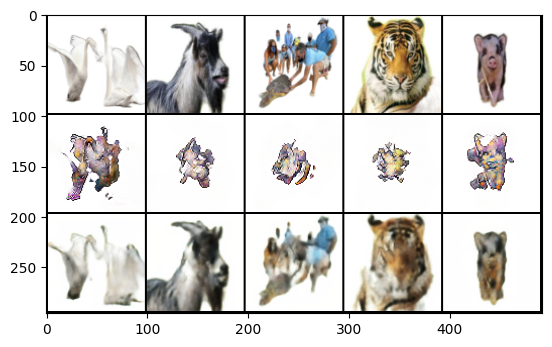

Cycle B: Real B -> Fake A -> Reconstructed B


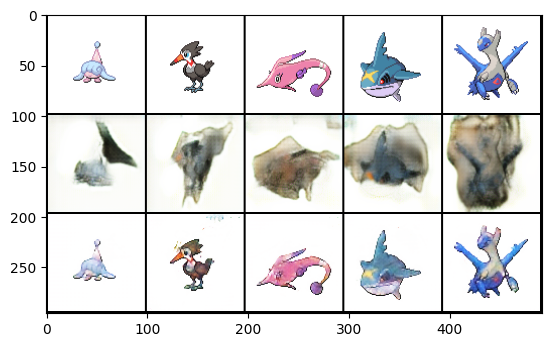

Epoch 341:
  Generator Total Loss: 10.3448
    G_AB (A->B) Loss:  5.7503
    G_BA (B->A) Loss:  4.5946
    Identity Loss:     0.0340
    GAN Loss:          1.5205
    Cycle Loss:        0.0533
    Feature Match:     0.2352
    Perceptual Loss:   0.6743
  Discriminator A Loss: 0.4531
  Discriminator B Loss: 0.3358


Epoch 342:
  Generator Total Loss: 10.4236
    G_AB (A->B) Loss:  5.8034
    G_BA (B->A) Loss:  4.6202
    Identity Loss:     0.0346
    GAN Loss:          1.5308
    Cycle Loss:        0.0534
    Feature Match:     0.2388
    Perceptual Loss:   0.6731
  Discriminator A Loss: 0.4523
  Discriminator B Loss: 0.3266


Epoch 343:
  Generator Total Loss: 10.4643
    G_AB (A->B) Loss:  5.7948
    G_BA (B->A) Loss:  4.6695
    Identity Loss:     0.0349
    GAN Loss:          1.5482
    Cycle Loss:        0.0547
    Feature Match:     0.2383
    Perceptual Loss:   0.6725
  Discriminator A Loss: 0.4435
  Discriminator B Loss: 0.3358


Epoch 344:
  Generator Total Loss: 10.4884
    G_AB (A->B) Loss:  5.8219
    G_BA (B->A) Loss:  4.6665
    Identity Loss:     0.0355
    GAN Loss:          1.5608
    Cycle Loss:        0.0550
    Feature Match:     0.2380
    Perceptual Loss:   0.6712
  Discriminator A Loss: 0.4456
  Discriminator B Loss: 0.3270


Epoch 345:
  Generator Total Loss: 10.5757
    G_AB (A->B) Loss:  5.9174
    G_BA (B->A) Loss:  4.6583
    Identity Loss:     0.0385
    GAN Loss:          1.5627
    Cycle Loss:        0.0546
    Feature Match:     0.2409
    Perceptual Loss:   0.6772
  Discriminator A Loss: 0.4542
  Discriminator B Loss: 0.3335


Epoch 346:
  Generator Total Loss: 10.4681
    G_AB (A->B) Loss:  5.8382
    G_BA (B->A) Loss:  4.6299
    Identity Loss:     0.0362
    GAN Loss:          1.5507
    Cycle Loss:        0.0543
    Feature Match:     0.2381
    Perceptual Loss:   0.6722
  Discriminator A Loss: 0.4486
  Discriminator B Loss: 0.3303


Epoch 347:
  Generator Total Loss: 10.4291
    G_AB (A->B) Loss:  5.8192
    G_BA (B->A) Loss:  4.6099
    Identity Loss:     0.0346
    GAN Loss:          1.5409
    Cycle Loss:        0.0532
    Feature Match:     0.2383
    Perceptual Loss:   0.6722
  Discriminator A Loss: 0.4485
  Discriminator B Loss: 0.3292


Epoch 348:
  Generator Total Loss: 10.4021
    G_AB (A->B) Loss:  5.8055
    G_BA (B->A) Loss:  4.5965
    Identity Loss:     0.0311
    GAN Loss:          1.5467
    Cycle Loss:        0.0513
    Feature Match:     0.2374
    Perceptual Loss:   0.6772
  Discriminator A Loss: 0.4494
  Discriminator B Loss: 0.5043


Epoch 349:
  Generator Total Loss: 9.3920
    G_AB (A->B) Loss:  5.2104
    G_BA (B->A) Loss:  4.1816
    Identity Loss:     0.0315
    GAN Loss:          1.2580
    Cycle Loss:        0.0489
    Feature Match:     0.2151
    Perceptual Loss:   0.6648
  Discriminator A Loss: 0.4580
  Discriminator B Loss: 0.5006


Epoch 350:
  Generator Total Loss: 9.4330
    G_AB (A->B) Loss:  5.2061
    G_BA (B->A) Loss:  4.2269
    Identity Loss:     0.0326
    GAN Loss:          1.2655
    Cycle Loss:        0.0497
    Feature Match:     0.2149
    Perceptual Loss:   0.6677
  Discriminator A Loss: 0.5292
  Discriminator B Loss: 0.4346


Cycle A: Real A -> Fake B -> Reconstructed A


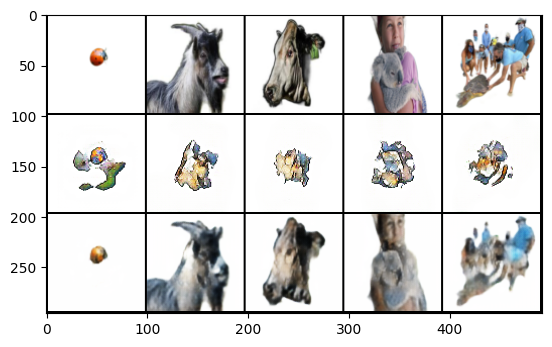

Cycle B: Real B -> Fake A -> Reconstructed B


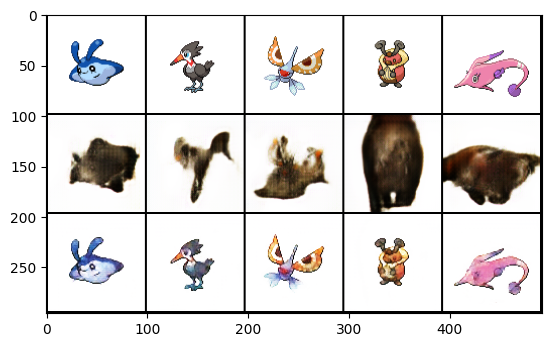

Model saved to models/PokeMalCycleGAN-96x96-G_AB-350-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-350-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-350-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-350-best.pth


Epoch 351:
  Generator Total Loss: 9.3263
    G_AB (A->B) Loss:  5.1331
    G_BA (B->A) Loss:  4.1932
    Identity Loss:     0.0327
    GAN Loss:          1.2514
    Cycle Loss:        0.0493
    Feature Match:     0.2100
    Perceptual Loss:   0.6689
  Discriminator A Loss: 0.4870
  Discriminator B Loss: 0.4229


Epoch 352:
  Generator Total Loss: 9.6247
    G_AB (A->B) Loss:  5.3090
    G_BA (B->A) Loss:  4.3156
    Identity Loss:     0.0346
    GAN Loss:          1.2956
    Cycle Loss:        0.0515
    Feature Match:     0.2191
    Perceptual Loss:   0.6758
  Discriminator A Loss: 0.4781
  Discriminator B Loss: 0.4044


Epoch 353:
  Generator Total Loss: 9.7780
    G_AB (A->B) Loss:  5.4110
    G_BA (B->A) Loss:  4.3671
    Identity Loss:     0.0343
    GAN Loss:          1.3311
    Cycle Loss:        0.0520
    Feature Match:     0.2238
    Perceptual Loss:   0.6762
  Discriminator A Loss: 0.4743
  Discriminator B Loss: 0.3880


Epoch 354:
  Generator Total Loss: 9.8519
    G_AB (A->B) Loss:  5.4030
    G_BA (B->A) Loss:  4.4488
    Identity Loss:     0.0359
    GAN Loss:          1.3503
    Cycle Loss:        0.0540
    Feature Match:     0.2249
    Perceptual Loss:   0.6724
  Discriminator A Loss: 0.4575
  Discriminator B Loss: 0.3865


Epoch 355:
  Generator Total Loss: 9.9545
    G_AB (A->B) Loss:  5.4746
    G_BA (B->A) Loss:  4.4799
    Identity Loss:     0.0331
    GAN Loss:          1.3996
    Cycle Loss:        0.0513
    Feature Match:     0.2283
    Perceptual Loss:   0.6720
  Discriminator A Loss: 0.4537
  Discriminator B Loss: 0.3696


Epoch 356:
  Generator Total Loss: 10.0356
    G_AB (A->B) Loss:  5.5244
    G_BA (B->A) Loss:  4.5113
    Identity Loss:     0.0322
    GAN Loss:          1.4149
    Cycle Loss:        0.0515
    Feature Match:     0.2312
    Perceptual Loss:   0.6739
  Discriminator A Loss: 0.4526
  Discriminator B Loss: 0.3627


Epoch 357:
  Generator Total Loss: 10.0072
    G_AB (A->B) Loss:  5.5493
    G_BA (B->A) Loss:  4.4579
    Identity Loss:     0.0320
    GAN Loss:          1.4198
    Cycle Loss:        0.0519
    Feature Match:     0.2292
    Perceptual Loss:   0.6714
  Discriminator A Loss: 0.4553
  Discriminator B Loss: 0.3591


Epoch 358:
  Generator Total Loss: 10.1001
    G_AB (A->B) Loss:  5.5919
    G_BA (B->A) Loss:  4.5081
    Identity Loss:     0.0326
    GAN Loss:          1.4489
    Cycle Loss:        0.0521
    Feature Match:     0.2309
    Perceptual Loss:   0.6717
  Discriminator A Loss: 0.4468
  Discriminator B Loss: 0.3513


Epoch 359:
  Generator Total Loss: 10.1575
    G_AB (A->B) Loss:  5.6291
    G_BA (B->A) Loss:  4.5285
    Identity Loss:     0.0331
    GAN Loss:          1.4686
    Cycle Loss:        0.0527
    Feature Match:     0.2318
    Perceptual Loss:   0.6701
  Discriminator A Loss: 0.4497
  Discriminator B Loss: 0.3479


Epoch 360:
  Generator Total Loss: 10.1507
    G_AB (A->B) Loss:  5.6294
    G_BA (B->A) Loss:  4.5214
    Identity Loss:     0.0320
    GAN Loss:          1.4707
    Cycle Loss:        0.0517
    Feature Match:     0.2323
    Perceptual Loss:   0.6701
  Discriminator A Loss: 0.4473
  Discriminator B Loss: 0.3456


Cycle A: Real A -> Fake B -> Reconstructed A


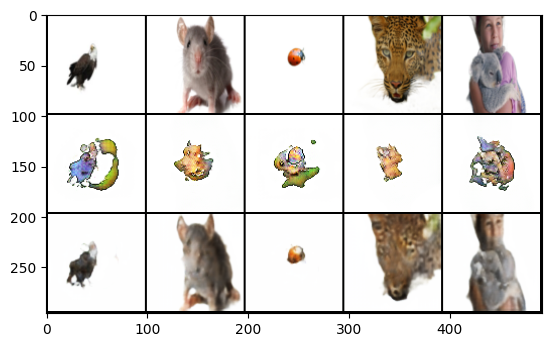

Cycle B: Real B -> Fake A -> Reconstructed B


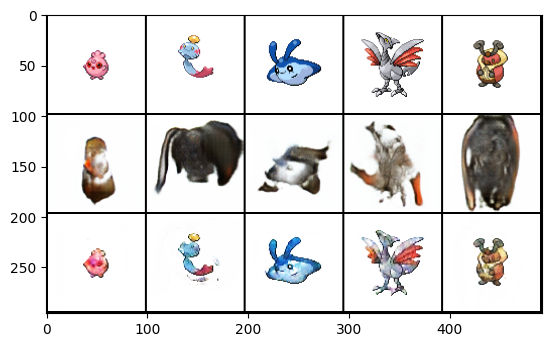

Epoch 361:
  Generator Total Loss: 10.1919
    G_AB (A->B) Loss:  5.6634
    G_BA (B->A) Loss:  4.5285
    Identity Loss:     0.0334
    GAN Loss:          1.4694
    Cycle Loss:        0.0526
    Feature Match:     0.2336
    Perceptual Loss:   0.6713
  Discriminator A Loss: 0.4458
  Discriminator B Loss: 0.3466


Epoch 362:
  Generator Total Loss: 10.3051
    G_AB (A->B) Loss:  5.7327
    G_BA (B->A) Loss:  4.5724
    Identity Loss:     0.0359
    GAN Loss:          1.4667
    Cycle Loss:        0.0557
    Feature Match:     0.2368
    Perceptual Loss:   0.6747
  Discriminator A Loss: 0.4503
  Discriminator B Loss: 0.3455


Epoch 363:
  Generator Total Loss: 10.3777
    G_AB (A->B) Loss:  5.7819
    G_BA (B->A) Loss:  4.5959
    Identity Loss:     0.0336
    GAN Loss:          1.5094
    Cycle Loss:        0.0534
    Feature Match:     0.2390
    Perceptual Loss:   0.6732
  Discriminator A Loss: 0.4337
  Discriminator B Loss: 0.3381


Epoch 364:
  Generator Total Loss: 10.3828
    G_AB (A->B) Loss:  5.7946
    G_BA (B->A) Loss:  4.5882
    Identity Loss:     0.0311
    GAN Loss:          1.5067
    Cycle Loss:        0.0513
    Feature Match:     0.2413
    Perceptual Loss:   0.6768
  Discriminator A Loss: 0.4412
  Discriminator B Loss: 0.3357


Epoch 365:
  Generator Total Loss: 10.3685
    G_AB (A->B) Loss:  5.7991
    G_BA (B->A) Loss:  4.5694
    Identity Loss:     0.0329
    GAN Loss:          1.5146
    Cycle Loss:        0.0525
    Feature Match:     0.2387
    Perceptual Loss:   0.6735
  Discriminator A Loss: 0.4470
  Discriminator B Loss: 0.3366


Epoch 366:
  Generator Total Loss: 10.3065
    G_AB (A->B) Loss:  5.7402
    G_BA (B->A) Loss:  4.5663
    Identity Loss:     0.0328
    GAN Loss:          1.5036
    Cycle Loss:        0.0523
    Feature Match:     0.2365
    Perceptual Loss:   0.6729
  Discriminator A Loss: 0.4441
  Discriminator B Loss: 0.3368


Epoch 367:
  Generator Total Loss: 10.4210
    G_AB (A->B) Loss:  5.8127
    G_BA (B->A) Loss:  4.6084
    Identity Loss:     0.0368
    GAN Loss:          1.5109
    Cycle Loss:        0.0556
    Feature Match:     0.2387
    Perceptual Loss:   0.6731
  Discriminator A Loss: 0.4433
  Discriminator B Loss: 0.3344


Epoch 368:
  Generator Total Loss: 10.3737
    G_AB (A->B) Loss:  5.7812
    G_BA (B->A) Loss:  4.5924
    Identity Loss:     0.0345
    GAN Loss:          1.5213
    Cycle Loss:        0.0534
    Feature Match:     0.2373
    Perceptual Loss:   0.6715
  Discriminator A Loss: 0.4410
  Discriminator B Loss: 0.3360


Epoch 369:
  Generator Total Loss: 10.3857
    G_AB (A->B) Loss:  5.7849
    G_BA (B->A) Loss:  4.6007
    Identity Loss:     0.0350
    GAN Loss:          1.5079
    Cycle Loss:        0.0540
    Feature Match:     0.2372
    Perceptual Loss:   0.6793
  Discriminator A Loss: 0.4477
  Discriminator B Loss: 0.3399


Epoch 370:
  Generator Total Loss: 10.4642
    G_AB (A->B) Loss:  5.8141
    G_BA (B->A) Loss:  4.6501
    Identity Loss:     0.0344
    GAN Loss:          1.5630
    Cycle Loss:        0.0546
    Feature Match:     0.2371
    Perceptual Loss:   0.6710
  Discriminator A Loss: 0.4367
  Discriminator B Loss: 0.3295


Cycle A: Real A -> Fake B -> Reconstructed A


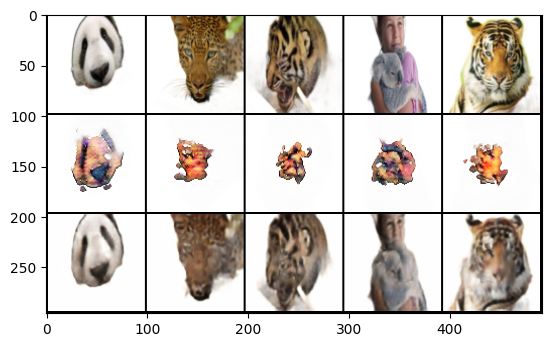

Cycle B: Real B -> Fake A -> Reconstructed B


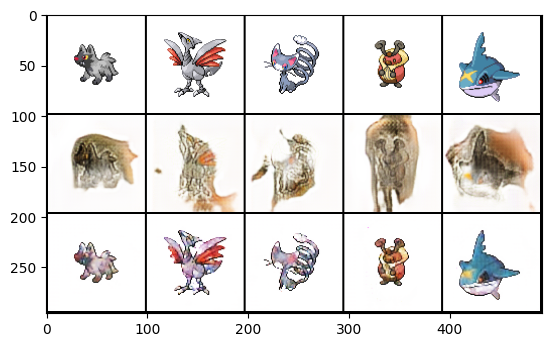

Epoch 371:
  Generator Total Loss: 10.5213
    G_AB (A->B) Loss:  5.8433
    G_BA (B->A) Loss:  4.6780
    Identity Loss:     0.0376
    GAN Loss:          1.5489
    Cycle Loss:        0.0564
    Feature Match:     0.2398
    Perceptual Loss:   0.6711
  Discriminator A Loss: 0.4406
  Discriminator B Loss: 0.3339


Epoch 372:
  Generator Total Loss: 10.3974
    G_AB (A->B) Loss:  5.7862
    G_BA (B->A) Loss:  4.6113
    Identity Loss:     0.0332
    GAN Loss:          1.5332
    Cycle Loss:        0.0521
    Feature Match:     0.2378
    Perceptual Loss:   0.6755
  Discriminator A Loss: 0.4411
  Discriminator B Loss: 0.3331


Epoch 373:
  Generator Total Loss: 10.3742
    G_AB (A->B) Loss:  5.7659
    G_BA (B->A) Loss:  4.6083
    Identity Loss:     0.0345
    GAN Loss:          1.5248
    Cycle Loss:        0.0536
    Feature Match:     0.2361
    Perceptual Loss:   0.6740
  Discriminator A Loss: 0.4436
  Discriminator B Loss: 0.3350


Epoch 374:
  Generator Total Loss: 10.3738
    G_AB (A->B) Loss:  5.7843
    G_BA (B->A) Loss:  4.5895
    Identity Loss:     0.0331
    GAN Loss:          1.5390
    Cycle Loss:        0.0521
    Feature Match:     0.2360
    Perceptual Loss:   0.6740
  Discriminator A Loss: 0.4888
  Discriminator B Loss: 0.3318


Epoch 375:
  Generator Total Loss: 10.1375
    G_AB (A->B) Loss:  5.5745
    G_BA (B->A) Loss:  4.5629
    Identity Loss:     0.0330
    GAN Loss:          1.4931
    Cycle Loss:        0.0514
    Feature Match:     0.2277
    Perceptual Loss:   0.6733
  Discriminator A Loss: 0.4789
  Discriminator B Loss: 0.3371
Model saved to models/PokeMalCycleGAN-96x96-G_AB-375-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-375-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-375-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-375-best.pth


Epoch 376:
  Generator Total Loss: 10.3967
    G_AB (A->B) Loss:  5.7748
    G_BA (B->A) Loss:  4.6218
    Identity Loss:     0.0339
    GAN Loss:          1.5656
    Cycle Loss:        0.0525
    Feature Match:     0.2343
    Perceptual Loss:   0.6710
  Discriminator A Loss: 0.4478
  Discriminator B Loss: 0.3274


Epoch 377:
  Generator Total Loss: 10.3518
    G_AB (A->B) Loss:  5.7307
    G_BA (B->A) Loss:  4.6212
    Identity Loss:     0.0342
    GAN Loss:          1.5680
    Cycle Loss:        0.0517
    Feature Match:     0.2324
    Perceptual Loss:   0.6679
  Discriminator A Loss: 0.4464
  Discriminator B Loss: 0.3246


Epoch 378:
  Generator Total Loss: 10.3461
    G_AB (A->B) Loss:  5.7307
    G_BA (B->A) Loss:  4.6154
    Identity Loss:     0.0341
    GAN Loss:          1.5301
    Cycle Loss:        0.0532
    Feature Match:     0.2346
    Perceptual Loss:   0.6721
  Discriminator A Loss: 0.4490
  Discriminator B Loss: 0.3363


Epoch 379:
  Generator Total Loss: 10.3459
    G_AB (A->B) Loss:  5.7787
    G_BA (B->A) Loss:  4.5671
    Identity Loss:     0.0345
    GAN Loss:          1.5491
    Cycle Loss:        0.0530
    Feature Match:     0.2332
    Perceptual Loss:   0.6681
  Discriminator A Loss: 0.4559
  Discriminator B Loss: 0.3287


Epoch 380:
  Generator Total Loss: 10.3524
    G_AB (A->B) Loss:  5.7332
    G_BA (B->A) Loss:  4.6191
    Identity Loss:     0.0335
    GAN Loss:          1.5356
    Cycle Loss:        0.0523
    Feature Match:     0.2356
    Perceptual Loss:   0.6707
  Discriminator A Loss: 0.4362
  Discriminator B Loss: 0.3324


Cycle A: Real A -> Fake B -> Reconstructed A


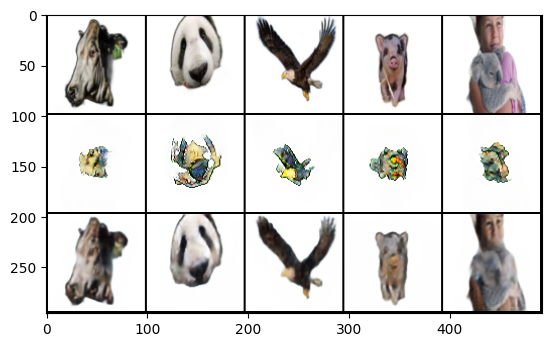

Cycle B: Real B -> Fake A -> Reconstructed B


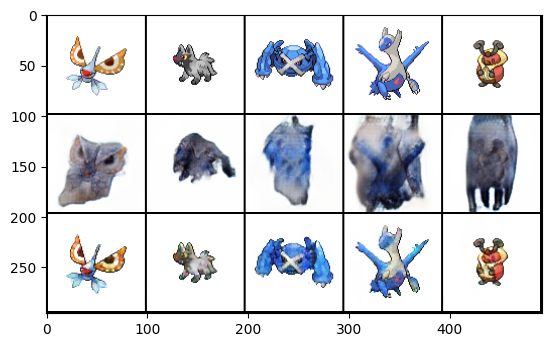

Epoch 381:
  Generator Total Loss: 10.4248
    G_AB (A->B) Loss:  5.8245
    G_BA (B->A) Loss:  4.6003
    Identity Loss:     0.0322
    GAN Loss:          1.5662
    Cycle Loss:        0.0510
    Feature Match:     0.2376
    Perceptual Loss:   0.6716
  Discriminator A Loss: 0.4463
  Discriminator B Loss: 0.3282


Epoch 382:
  Generator Total Loss: 10.4401
    G_AB (A->B) Loss:  5.8136
    G_BA (B->A) Loss:  4.6265
    Identity Loss:     0.0346
    GAN Loss:          1.5607
    Cycle Loss:        0.0527
    Feature Match:     0.2371
    Perceptual Loss:   0.6713
  Discriminator A Loss: 0.4395
  Discriminator B Loss: 0.3286


Epoch 383:
  Generator Total Loss: 10.3493
    G_AB (A->B) Loss:  5.7822
    G_BA (B->A) Loss:  4.5671
    Identity Loss:     0.0341
    GAN Loss:          1.5256
    Cycle Loss:        0.0521
    Feature Match:     0.2361
    Perceptual Loss:   0.6725
  Discriminator A Loss: 0.4474
  Discriminator B Loss: 0.3322


Epoch 384:
  Generator Total Loss: 10.4299
    G_AB (A->B) Loss:  5.8290
    G_BA (B->A) Loss:  4.6009
    Identity Loss:     0.0332
    GAN Loss:          1.5554
    Cycle Loss:        0.0514
    Feature Match:     0.2379
    Perceptual Loss:   0.6739
  Discriminator A Loss: 0.4445
  Discriminator B Loss: 0.3321


Epoch 385:
  Generator Total Loss: 10.4286
    G_AB (A->B) Loss:  5.8248
    G_BA (B->A) Loss:  4.6038
    Identity Loss:     0.0357
    GAN Loss:          1.5490
    Cycle Loss:        0.0539
    Feature Match:     0.2360
    Perceptual Loss:   0.6734
  Discriminator A Loss: 0.4429
  Discriminator B Loss: 0.3329


Epoch 386:
  Generator Total Loss: 10.4049
    G_AB (A->B) Loss:  5.8366
    G_BA (B->A) Loss:  4.5683
    Identity Loss:     0.0339
    GAN Loss:          1.5648
    Cycle Loss:        0.0520
    Feature Match:     0.2358
    Perceptual Loss:   0.6686
  Discriminator A Loss: 0.4443
  Discriminator B Loss: 0.3296


Epoch 387:
  Generator Total Loss: 10.4533
    G_AB (A->B) Loss:  5.8375
    G_BA (B->A) Loss:  4.6158
    Identity Loss:     0.0328
    GAN Loss:          1.5807
    Cycle Loss:        0.0514
    Feature Match:     0.2373
    Perceptual Loss:   0.6705
  Discriminator A Loss: 0.4375
  Discriminator B Loss: 0.3279


Epoch 388:
  Generator Total Loss: 10.4413
    G_AB (A->B) Loss:  5.8356
    G_BA (B->A) Loss:  4.6057
    Identity Loss:     0.0337
    GAN Loss:          1.5686
    Cycle Loss:        0.0523
    Feature Match:     0.2374
    Perceptual Loss:   0.6690
  Discriminator A Loss: 0.4446
  Discriminator B Loss: 0.3253


Epoch 389:
  Generator Total Loss: 10.5021
    G_AB (A->B) Loss:  5.8608
    G_BA (B->A) Loss:  4.6413
    Identity Loss:     0.0347
    GAN Loss:          1.5695
    Cycle Loss:        0.0532
    Feature Match:     0.2386
    Perceptual Loss:   0.6749
  Discriminator A Loss: 0.4389
  Discriminator B Loss: 0.3315


Epoch 390:
  Generator Total Loss: 10.3799
    G_AB (A->B) Loss:  5.8203
    G_BA (B->A) Loss:  4.5597
    Identity Loss:     0.0328
    GAN Loss:          1.5540
    Cycle Loss:        0.0508
    Feature Match:     0.2359
    Perceptual Loss:   0.6729
  Discriminator A Loss: 0.4540
  Discriminator B Loss: 0.3286


Cycle A: Real A -> Fake B -> Reconstructed A


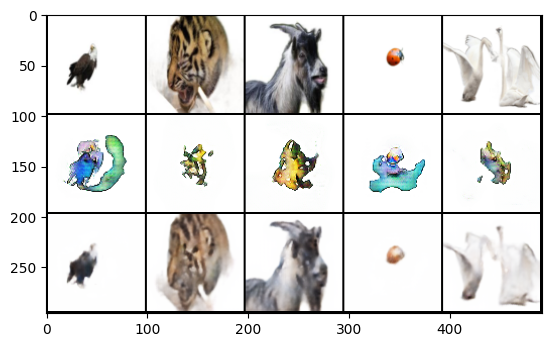

Cycle B: Real B -> Fake A -> Reconstructed B


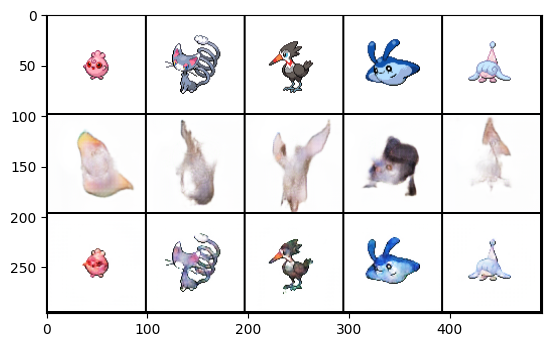

Epoch 391:
  Generator Total Loss: 10.4057
    G_AB (A->B) Loss:  5.7984
    G_BA (B->A) Loss:  4.6073
    Identity Loss:     0.0316
    GAN Loss:          1.5622
    Cycle Loss:        0.0503
    Feature Match:     0.2373
    Perceptual Loss:   0.6728
  Discriminator A Loss: 0.4423
  Discriminator B Loss: 0.3291


Epoch 392:
  Generator Total Loss: 10.4267
    G_AB (A->B) Loss:  5.8428
    G_BA (B->A) Loss:  4.5839
    Identity Loss:     0.0324
    GAN Loss:          1.5874
    Cycle Loss:        0.0511
    Feature Match:     0.2358
    Perceptual Loss:   0.6676
  Discriminator A Loss: 0.4461
  Discriminator B Loss: 0.3240


Epoch 393:
  Generator Total Loss: 10.3962
    G_AB (A->B) Loss:  5.8214
    G_BA (B->A) Loss:  4.5748
    Identity Loss:     0.0325
    GAN Loss:          1.5559
    Cycle Loss:        0.0509
    Feature Match:     0.2370
    Perceptual Loss:   0.6717
  Discriminator A Loss: 0.4512
  Discriminator B Loss: 0.3271


Epoch 394:
  Generator Total Loss: 10.3760
    G_AB (A->B) Loss:  5.7913
    G_BA (B->A) Loss:  4.5846
    Identity Loss:     0.0318
    GAN Loss:          1.5581
    Cycle Loss:        0.0504
    Feature Match:     0.2362
    Perceptual Loss:   0.6716
  Discriminator A Loss: 0.4440
  Discriminator B Loss: 0.3289


Epoch 395:
  Generator Total Loss: 10.5248
    G_AB (A->B) Loss:  5.8998
    G_BA (B->A) Loss:  4.6250
    Identity Loss:     0.0335
    GAN Loss:          1.5911
    Cycle Loss:        0.0521
    Feature Match:     0.2399
    Perceptual Loss:   0.6695
  Discriminator A Loss: 0.4391
  Discriminator B Loss: 0.3209


Epoch 396:
  Generator Total Loss: 10.4750
    G_AB (A->B) Loss:  5.9073
    G_BA (B->A) Loss:  4.5677
    Identity Loss:     0.0319
    GAN Loss:          1.5989
    Cycle Loss:        0.0505
    Feature Match:     0.2375
    Perceptual Loss:   0.6700
  Discriminator A Loss: 0.4508
  Discriminator B Loss: 0.3220


Epoch 397:
  Generator Total Loss: 10.5555
    G_AB (A->B) Loss:  5.9016
    G_BA (B->A) Loss:  4.6539
    Identity Loss:     0.0340
    GAN Loss:          1.5987
    Cycle Loss:        0.0530
    Feature Match:     0.2395
    Perceptual Loss:   0.6716
  Discriminator A Loss: 0.4396
  Discriminator B Loss: 0.3228


Epoch 398:
  Generator Total Loss: 10.4949
    G_AB (A->B) Loss:  5.8887
    G_BA (B->A) Loss:  4.6062
    Identity Loss:     0.0332
    GAN Loss:          1.6124
    Cycle Loss:        0.0517
    Feature Match:     0.2368
    Perceptual Loss:   0.6656
  Discriminator A Loss: 0.4414
  Discriminator B Loss: 0.3189


Epoch 399:
  Generator Total Loss: 10.4528
    G_AB (A->B) Loss:  5.8770
    G_BA (B->A) Loss:  4.5758
    Identity Loss:     0.0314
    GAN Loss:          1.5724
    Cycle Loss:        0.0498
    Feature Match:     0.2399
    Perceptual Loss:   0.6708
  Discriminator A Loss: 0.4463
  Discriminator B Loss: 0.3306


Epoch 400:
  Generator Total Loss: 10.4496
    G_AB (A->B) Loss:  5.9017
    G_BA (B->A) Loss:  4.5479
    Identity Loss:     0.0319
    GAN Loss:          1.5997
    Cycle Loss:        0.0503
    Feature Match:     0.2366
    Perceptual Loss:   0.6674
  Discriminator A Loss: 0.4438
  Discriminator B Loss: 0.3198


Cycle A: Real A -> Fake B -> Reconstructed A


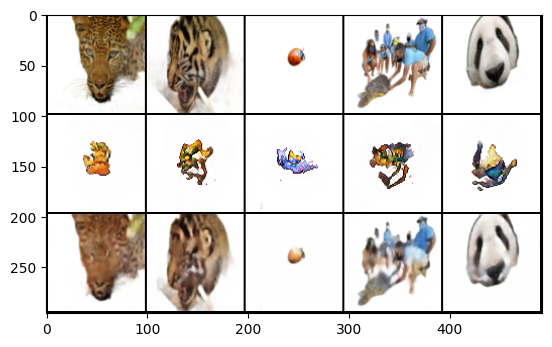

Cycle B: Real B -> Fake A -> Reconstructed B


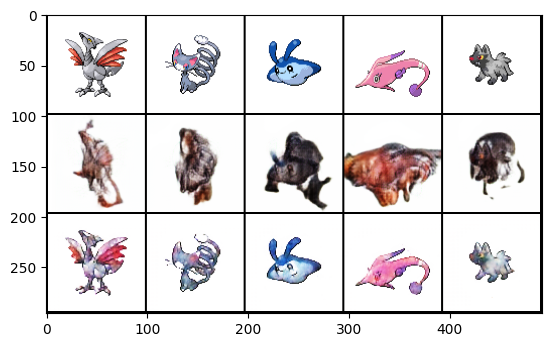

Model saved to models/PokeMalCycleGAN-96x96-G_AB-400-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-400-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-400-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-400-best.pth


Epoch 401:
  Generator Total Loss: 10.4743
    G_AB (A->B) Loss:  5.8847
    G_BA (B->A) Loss:  4.5895
    Identity Loss:     0.0323
    GAN Loss:          1.5915
    Cycle Loss:        0.0509
    Feature Match:     0.2381
    Perceptual Loss:   0.6695
  Discriminator A Loss: 0.4421
  Discriminator B Loss: 0.3221


Epoch 402:
  Generator Total Loss: 10.4510
    G_AB (A->B) Loss:  5.8775
    G_BA (B->A) Loss:  4.5734
    Identity Loss:     0.0320
    GAN Loss:          1.5862
    Cycle Loss:        0.0508
    Feature Match:     0.2374
    Perceptual Loss:   0.6697
  Discriminator A Loss: 0.4478
  Discriminator B Loss: 0.3227


Epoch 403:
  Generator Total Loss: 10.5033
    G_AB (A->B) Loss:  5.9338
    G_BA (B->A) Loss:  4.5694
    Identity Loss:     0.0334
    GAN Loss:          1.6168
    Cycle Loss:        0.0507
    Feature Match:     0.2365
    Perceptual Loss:   0.6689
  Discriminator A Loss: 0.4479
  Discriminator B Loss: 0.3195


Epoch 404:
  Generator Total Loss: 10.2364
    G_AB (A->B) Loss:  5.7450
    G_BA (B->A) Loss:  4.4914
    Identity Loss:     0.0318
    GAN Loss:          1.5786
    Cycle Loss:        0.0494
    Feature Match:     0.2271
    Perceptual Loss:   0.6652
  Discriminator A Loss: 0.5173
  Discriminator B Loss: 0.3203


Epoch 405:
  Generator Total Loss: 10.2790
    G_AB (A->B) Loss:  5.7673
    G_BA (B->A) Loss:  4.5117
    Identity Loss:     0.0316
    GAN Loss:          1.5712
    Cycle Loss:        0.0489
    Feature Match:     0.2301
    Perceptual Loss:   0.6697
  Discriminator A Loss: 0.4572
  Discriminator B Loss: 0.3236


Epoch 406:
  Generator Total Loss: 10.3228
    G_AB (A->B) Loss:  5.8008
    G_BA (B->A) Loss:  4.5220
    Identity Loss:     0.0293
    GAN Loss:          1.5856
    Cycle Loss:        0.0478
    Feature Match:     0.2329
    Perceptual Loss:   0.6689
  Discriminator A Loss: 0.4517
  Discriminator B Loss: 0.3236


Epoch 407:
  Generator Total Loss: 10.4377
    G_AB (A->B) Loss:  5.9010
    G_BA (B->A) Loss:  4.5367
    Identity Loss:     0.0326
    GAN Loss:          1.6052
    Cycle Loss:        0.0506
    Feature Match:     0.2351
    Perceptual Loss:   0.6659
  Discriminator A Loss: 0.4478
  Discriminator B Loss: 0.3189


Epoch 408:
  Generator Total Loss: 10.3670
    G_AB (A->B) Loss:  5.8299
    G_BA (B->A) Loss:  4.5371
    Identity Loss:     0.0306
    GAN Loss:          1.5945
    Cycle Loss:        0.0488
    Feature Match:     0.2330
    Perceptual Loss:   0.6703
  Discriminator A Loss: 0.4468
  Discriminator B Loss: 0.3241


Epoch 409:
  Generator Total Loss: 10.4273
    G_AB (A->B) Loss:  5.8666
    G_BA (B->A) Loss:  4.5607
    Identity Loss:     0.0291
    GAN Loss:          1.6045
    Cycle Loss:        0.0475
    Feature Match:     0.2378
    Perceptual Loss:   0.6672
  Discriminator A Loss: 0.4440
  Discriminator B Loss: 0.3220


Epoch 410:
  Generator Total Loss: 10.4481
    G_AB (A->B) Loss:  5.8900
    G_BA (B->A) Loss:  4.5582
    Identity Loss:     0.0338
    GAN Loss:          1.5994
    Cycle Loss:        0.0518
    Feature Match:     0.2349
    Perceptual Loss:   0.6666
  Discriminator A Loss: 0.4441
  Discriminator B Loss: 0.3915


Cycle A: Real A -> Fake B -> Reconstructed A


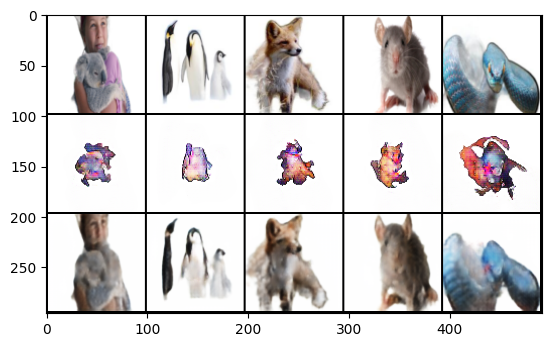

Cycle B: Real B -> Fake A -> Reconstructed B


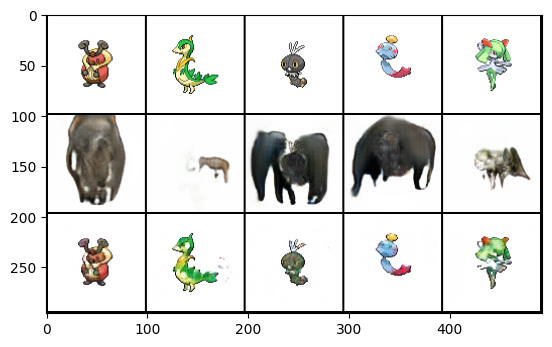

Epoch 411:
  Generator Total Loss: 9.5979
    G_AB (A->B) Loss:  5.3264
    G_BA (B->A) Loss:  4.2715
    Identity Loss:     0.0326
    GAN Loss:          1.3396
    Cycle Loss:        0.0500
    Feature Match:     0.2169
    Perceptual Loss:   0.6631
  Discriminator A Loss: 0.4444
  Discriminator B Loss: 0.4296


Epoch 412:
  Generator Total Loss: 9.8114
    G_AB (A->B) Loss:  5.4687
    G_BA (B->A) Loss:  4.3427
    Identity Loss:     0.0287
    GAN Loss:          1.4174
    Cycle Loss:        0.0472
    Feature Match:     0.2242
    Perceptual Loss:   0.6629
  Discriminator A Loss: 0.4413
  Discriminator B Loss: 0.3645


Epoch 413:
  Generator Total Loss: 10.0881
    G_AB (A->B) Loss:  5.6469
    G_BA (B->A) Loss:  4.4412
    Identity Loss:     0.0305
    GAN Loss:          1.5076
    Cycle Loss:        0.0489
    Feature Match:     0.2281
    Perceptual Loss:   0.6632
  Discriminator A Loss: 0.4414
  Discriminator B Loss: 0.3409


Epoch 414:
  Generator Total Loss: 10.0642
    G_AB (A->B) Loss:  5.6361
    G_BA (B->A) Loss:  4.4282
    Identity Loss:     0.0296
    GAN Loss:          1.4915
    Cycle Loss:        0.0481
    Feature Match:     0.2284
    Perceptual Loss:   0.6682
  Discriminator A Loss: 0.4463
  Discriminator B Loss: 0.3406


Epoch 415:
  Generator Total Loss: 10.2706
    G_AB (A->B) Loss:  5.7625
    G_BA (B->A) Loss:  4.5081
    Identity Loss:     0.0329
    GAN Loss:          1.5506
    Cycle Loss:        0.0514
    Feature Match:     0.2313
    Perceptual Loss:   0.6635
  Discriminator A Loss: 0.4443
  Discriminator B Loss: 0.3257


Epoch 416:
  Generator Total Loss: 10.2647
    G_AB (A->B) Loss:  5.7863
    G_BA (B->A) Loss:  4.4784
    Identity Loss:     0.0295
    GAN Loss:          1.5646
    Cycle Loss:        0.0484
    Feature Match:     0.2324
    Perceptual Loss:   0.6651
  Discriminator A Loss: 0.4416
  Discriminator B Loss: 0.3282


Epoch 417:
  Generator Total Loss: 10.3981
    G_AB (A->B) Loss:  5.8812
    G_BA (B->A) Loss:  4.5169
    Identity Loss:     0.0325
    GAN Loss:          1.6089
    Cycle Loss:        0.0502
    Feature Match:     0.2331
    Perceptual Loss:   0.6635
  Discriminator A Loss: 0.4369
  Discriminator B Loss: 0.3198


Epoch 418:
  Generator Total Loss: 10.3753
    G_AB (A->B) Loss:  5.8349
    G_BA (B->A) Loss:  4.5404
    Identity Loss:     0.0330
    GAN Loss:          1.5812
    Cycle Loss:        0.0511
    Feature Match:     0.2330
    Perceptual Loss:   0.6686
  Discriminator A Loss: 0.4398
  Discriminator B Loss: 0.3294


Epoch 419:
  Generator Total Loss: 10.3528
    G_AB (A->B) Loss:  5.8499
    G_BA (B->A) Loss:  4.5029
    Identity Loss:     0.0313
    GAN Loss:          1.6137
    Cycle Loss:        0.0491
    Feature Match:     0.2316
    Perceptual Loss:   0.6606
  Discriminator A Loss: 0.4434
  Discriminator B Loss: 0.3193


Epoch 420:
  Generator Total Loss: 10.4384
    G_AB (A->B) Loss:  5.8655
    G_BA (B->A) Loss:  4.5729
    Identity Loss:     0.0330
    GAN Loss:          1.5942
    Cycle Loss:        0.0513
    Feature Match:     0.2358
    Perceptual Loss:   0.6661
  Discriminator A Loss: 0.4433
  Discriminator B Loss: 0.3197


Cycle A: Real A -> Fake B -> Reconstructed A


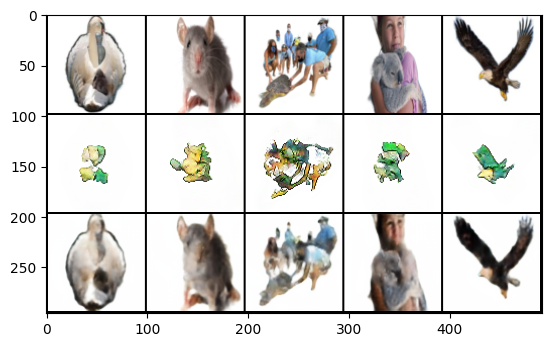

Cycle B: Real B -> Fake A -> Reconstructed B


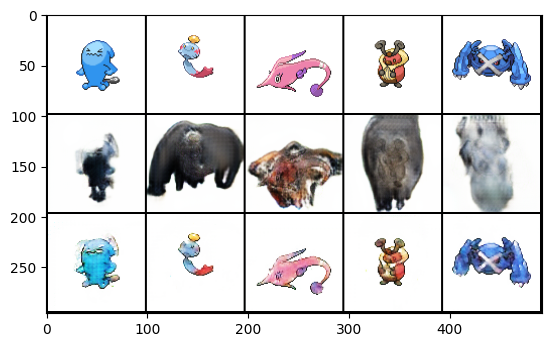

Epoch 421:
  Generator Total Loss: 10.2762
    G_AB (A->B) Loss:  5.7811
    G_BA (B->A) Loss:  4.4951
    Identity Loss:     0.0296
    GAN Loss:          1.5674
    Cycle Loss:        0.0475
    Feature Match:     0.2329
    Perceptual Loss:   0.6672
  Discriminator A Loss: 0.4433
  Discriminator B Loss: 0.3247


Epoch 422:
  Generator Total Loss: 10.4579
    G_AB (A->B) Loss:  5.8822
    G_BA (B->A) Loss:  4.5757
    Identity Loss:     0.0336
    GAN Loss:          1.6063
    Cycle Loss:        0.0520
    Feature Match:     0.2346
    Perceptual Loss:   0.6666
  Discriminator A Loss: 0.4393
  Discriminator B Loss: 0.3228


Epoch 423:
  Generator Total Loss: 10.4141
    G_AB (A->B) Loss:  5.8818
    G_BA (B->A) Loss:  4.5323
    Identity Loss:     0.0339
    GAN Loss:          1.6074
    Cycle Loss:        0.0518
    Feature Match:     0.2326
    Perceptual Loss:   0.6630
  Discriminator A Loss: 0.4408
  Discriminator B Loss: 0.3215


Epoch 424:
  Generator Total Loss: 10.4082
    G_AB (A->B) Loss:  5.8678
    G_BA (B->A) Loss:  4.5404
    Identity Loss:     0.0324
    GAN Loss:          1.6169
    Cycle Loss:        0.0502
    Feature Match:     0.2331
    Perceptual Loss:   0.6621
  Discriminator A Loss: 0.4410
  Discriminator B Loss: 0.3182


Epoch 425:
  Generator Total Loss: 10.4429
    G_AB (A->B) Loss:  5.9059
    G_BA (B->A) Loss:  4.5369
    Identity Loss:     0.0324
    GAN Loss:          1.6022
    Cycle Loss:        0.0504
    Feature Match:     0.2351
    Perceptual Loss:   0.6694
  Discriminator A Loss: 0.4387
  Discriminator B Loss: 0.3233
Model saved to models/PokeMalCycleGAN-96x96-G_AB-425-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-425-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-425-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-425-best.pth


Epoch 426:
  Generator Total Loss: 10.4260
    G_AB (A->B) Loss:  5.8576
    G_BA (B->A) Loss:  4.5683
    Identity Loss:     0.0320
    GAN Loss:          1.6018
    Cycle Loss:        0.0500
    Feature Match:     0.2350
    Perceptual Loss:   0.6674
  Discriminator A Loss: 0.4421
  Discriminator B Loss: 0.3217


Epoch 427:
  Generator Total Loss: 10.4680
    G_AB (A->B) Loss:  5.9076
    G_BA (B->A) Loss:  4.5604
    Identity Loss:     0.0340
    GAN Loss:          1.6222
    Cycle Loss:        0.0519
    Feature Match:     0.2340
    Perceptual Loss:   0.6630
  Discriminator A Loss: 0.4430
  Discriminator B Loss: 0.3164


Epoch 428:
  Generator Total Loss: 10.4098
    G_AB (A->B) Loss:  5.8457
    G_BA (B->A) Loss:  4.5641
    Identity Loss:     0.0319
    GAN Loss:          1.5939
    Cycle Loss:        0.0503
    Feature Match:     0.2351
    Perceptual Loss:   0.6662
  Discriminator A Loss: 0.4405
  Discriminator B Loss: 0.3230


Epoch 429:
  Generator Total Loss: 10.4724
    G_AB (A->B) Loss:  5.9175
    G_BA (B->A) Loss:  4.5549
    Identity Loss:     0.0302
    GAN Loss:          1.6395
    Cycle Loss:        0.0492
    Feature Match:     0.2353
    Perceptual Loss:   0.6642
  Discriminator A Loss: 0.4428
  Discriminator B Loss: 0.3177


Epoch 430:
  Generator Total Loss: 10.4508
    G_AB (A->B) Loss:  5.9301
    G_BA (B->A) Loss:  4.5207
    Identity Loss:     0.0298
    GAN Loss:          1.6398
    Cycle Loss:        0.0481
    Feature Match:     0.2354
    Perceptual Loss:   0.6622
  Discriminator A Loss: 0.4436
  Discriminator B Loss: 0.3166


Cycle A: Real A -> Fake B -> Reconstructed A


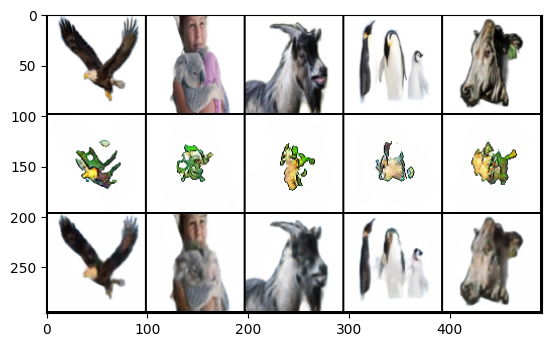

Cycle B: Real B -> Fake A -> Reconstructed B


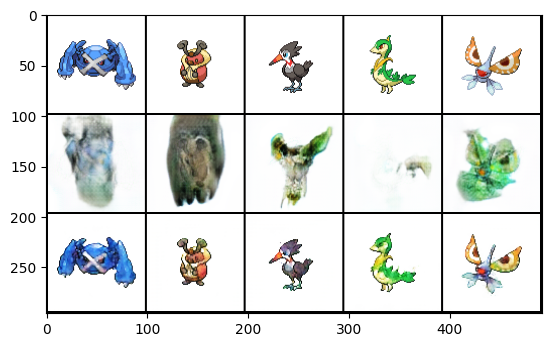

Epoch 431:
  Generator Total Loss: 10.4845
    G_AB (A->B) Loss:  5.9278
    G_BA (B->A) Loss:  4.5567
    Identity Loss:     0.0314
    GAN Loss:          1.6305
    Cycle Loss:        0.0500
    Feature Match:     0.2359
    Perceptual Loss:   0.6649
  Discriminator A Loss: 0.4441
  Discriminator B Loss: 0.3163


Epoch 432:
  Generator Total Loss: 10.4332
    G_AB (A->B) Loss:  5.9103
    G_BA (B->A) Loss:  4.5229
    Identity Loss:     0.0288
    GAN Loss:          1.6227
    Cycle Loss:        0.0474
    Feature Match:     0.2366
    Perceptual Loss:   0.6655
  Discriminator A Loss: 0.4403
  Discriminator B Loss: 0.3202


Epoch 433:
  Generator Total Loss: 10.4134
    G_AB (A->B) Loss:  5.8626
    G_BA (B->A) Loss:  4.5508
    Identity Loss:     0.0307
    GAN Loss:          1.6088
    Cycle Loss:        0.0492
    Feature Match:     0.2346
    Perceptual Loss:   0.6666
  Discriminator A Loss: 0.4387
  Discriminator B Loss: 0.3203


Epoch 434:
  Generator Total Loss: 10.4453
    G_AB (A->B) Loss:  5.8965
    G_BA (B->A) Loss:  4.5489
    Identity Loss:     0.0329
    GAN Loss:          1.6098
    Cycle Loss:        0.0508
    Feature Match:     0.2348
    Perceptual Loss:   0.6655
  Discriminator A Loss: 0.4466
  Discriminator B Loss: 0.3229


Epoch 435:
  Generator Total Loss: 10.4224
    G_AB (A->B) Loss:  5.8705
    G_BA (B->A) Loss:  4.5519
    Identity Loss:     0.0299
    GAN Loss:          1.6163
    Cycle Loss:        0.0483
    Feature Match:     0.2357
    Perceptual Loss:   0.6649
  Discriminator A Loss: 0.4465
  Discriminator B Loss: 0.3194


Epoch 436:
  Generator Total Loss: 10.3936
    G_AB (A->B) Loss:  5.8530
    G_BA (B->A) Loss:  4.5406
    Identity Loss:     0.0301
    GAN Loss:          1.6259
    Cycle Loss:        0.0487
    Feature Match:     0.2336
    Perceptual Loss:   0.6600
  Discriminator A Loss: 0.4451
  Discriminator B Loss: 0.3167


Epoch 437:
  Generator Total Loss: 10.4201
    G_AB (A->B) Loss:  5.8815
    G_BA (B->A) Loss:  4.5386
    Identity Loss:     0.0299
    GAN Loss:          1.6215
    Cycle Loss:        0.0482
    Feature Match:     0.2353
    Perceptual Loss:   0.6639
  Discriminator A Loss: 0.4460
  Discriminator B Loss: 0.3209


Epoch 438:
  Generator Total Loss: 10.4731
    G_AB (A->B) Loss:  5.8891
    G_BA (B->A) Loss:  4.5840
    Identity Loss:     0.0331
    GAN Loss:          1.6289
    Cycle Loss:        0.0513
    Feature Match:     0.2343
    Perceptual Loss:   0.6629
  Discriminator A Loss: 0.4426
  Discriminator B Loss: 0.3207


Epoch 439:
  Generator Total Loss: 10.3749
    G_AB (A->B) Loss:  5.8723
    G_BA (B->A) Loss:  4.5026
    Identity Loss:     0.0287
    GAN Loss:          1.6283
    Cycle Loss:        0.0472
    Feature Match:     0.2335
    Perceptual Loss:   0.6611
  Discriminator A Loss: 0.4456
  Discriminator B Loss: 0.3160


Epoch 440:
  Generator Total Loss: 10.3842
    G_AB (A->B) Loss:  5.8431
    G_BA (B->A) Loss:  4.5411
    Identity Loss:     0.0321
    GAN Loss:          1.6246
    Cycle Loss:        0.0498
    Feature Match:     0.2308
    Perceptual Loss:   0.6633
  Discriminator A Loss: 0.4821
  Discriminator B Loss: 0.3187


Cycle A: Real A -> Fake B -> Reconstructed A


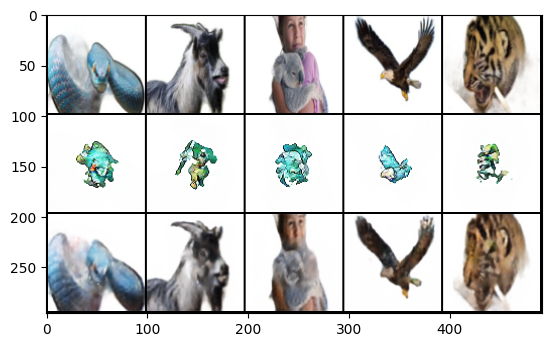

Cycle B: Real B -> Fake A -> Reconstructed B


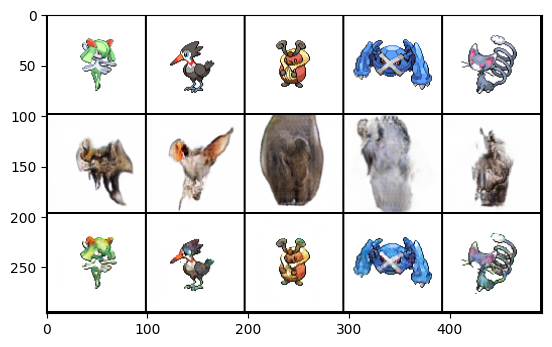

Epoch 441:
  Generator Total Loss: 10.4013
    G_AB (A->B) Loss:  5.8375
    G_BA (B->A) Loss:  4.5638
    Identity Loss:     0.0312
    GAN Loss:          1.6250
    Cycle Loss:        0.0492
    Feature Match:     0.2327
    Perceptual Loss:   0.6625
  Discriminator A Loss: 0.4455
  Discriminator B Loss: 0.3161


Epoch 442:
  Generator Total Loss: 10.3781
    G_AB (A->B) Loss:  5.8450
    G_BA (B->A) Loss:  4.5331
    Identity Loss:     0.0294
    GAN Loss:          1.6362
    Cycle Loss:        0.0476
    Feature Match:     0.2324
    Perceptual Loss:   0.6600
  Discriminator A Loss: 0.4436
  Discriminator B Loss: 0.3145


Epoch 443:
  Generator Total Loss: 10.4466
    G_AB (A->B) Loss:  5.9142
    G_BA (B->A) Loss:  4.5324
    Identity Loss:     0.0308
    GAN Loss:          1.6562
    Cycle Loss:        0.0484
    Feature Match:     0.2337
    Perceptual Loss:   0.6574
  Discriminator A Loss: 0.4426
  Discriminator B Loss: 0.3137


Epoch 444:
  Generator Total Loss: 10.4098
    G_AB (A->B) Loss:  5.8795
    G_BA (B->A) Loss:  4.5303
    Identity Loss:     0.0292
    GAN Loss:          1.6321
    Cycle Loss:        0.0474
    Feature Match:     0.2347
    Perceptual Loss:   0.6619
  Discriminator A Loss: 0.4465
  Discriminator B Loss: 0.3156


Epoch 445:
  Generator Total Loss: 10.3814
    G_AB (A->B) Loss:  5.8759
    G_BA (B->A) Loss:  4.5054
    Identity Loss:     0.0291
    GAN Loss:          1.6410
    Cycle Loss:        0.0466
    Feature Match:     0.2329
    Perceptual Loss:   0.6599
  Discriminator A Loss: 0.4489
  Discriminator B Loss: 0.3136


Epoch 446:
  Generator Total Loss: 10.2637
    G_AB (A->B) Loss:  5.7791
    G_BA (B->A) Loss:  4.4846
    Identity Loss:     0.0324
    GAN Loss:          1.5778
    Cycle Loss:        0.0498
    Feature Match:     0.2298
    Perceptual Loss:   0.6599
  Discriminator A Loss: 0.4457
  Discriminator B Loss: 0.3897


Epoch 447:
  Generator Total Loss: 9.9704
    G_AB (A->B) Loss:  5.6334
    G_BA (B->A) Loss:  4.3369
    Identity Loss:     0.0298
    GAN Loss:          1.5185
    Cycle Loss:        0.0477
    Feature Match:     0.2220
    Perceptual Loss:   0.6573
  Discriminator A Loss: 0.4452
  Discriminator B Loss: 0.3385


Epoch 448:
  Generator Total Loss: 10.1830
    G_AB (A->B) Loss:  5.7598
    G_BA (B->A) Loss:  4.4232
    Identity Loss:     0.0306
    GAN Loss:          1.5661
    Cycle Loss:        0.0485
    Feature Match:     0.2269
    Perceptual Loss:   0.6637
  Discriminator A Loss: 0.4464
  Discriminator B Loss: 0.3262


Epoch 449:
  Generator Total Loss: 10.2685
    G_AB (A->B) Loss:  5.8613
    G_BA (B->A) Loss:  4.4071
    Identity Loss:     0.0308
    GAN Loss:          1.6061
    Cycle Loss:        0.0487
    Feature Match:     0.2278
    Perceptual Loss:   0.6606
  Discriminator A Loss: 0.4422
  Discriminator B Loss: 0.3238


Epoch 450:
  Generator Total Loss: 10.2309
    G_AB (A->B) Loss:  5.7941
    G_BA (B->A) Loss:  4.4368
    Identity Loss:     0.0301
    GAN Loss:          1.6087
    Cycle Loss:        0.0481
    Feature Match:     0.2265
    Perceptual Loss:   0.6579
  Discriminator A Loss: 0.4449
  Discriminator B Loss: 0.3194


Cycle A: Real A -> Fake B -> Reconstructed A


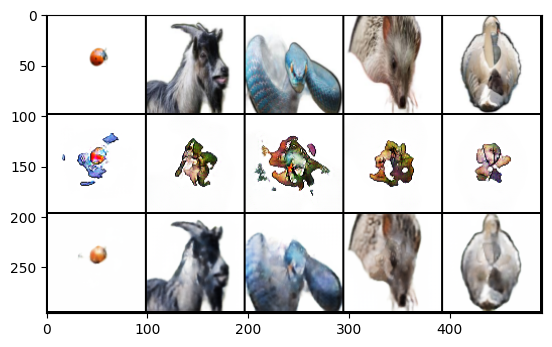

Cycle B: Real B -> Fake A -> Reconstructed B


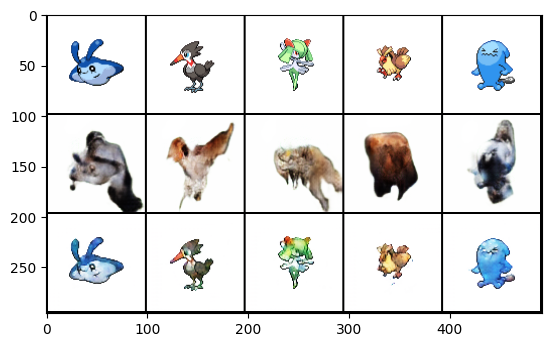

Model saved to models/PokeMalCycleGAN-96x96-G_AB-450-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-450-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-450-best.pth


Model saved to models/PokeMalCycleGAN-96x96-D_B-450-best.pth


Epoch 451:
  Generator Total Loss: 10.2629
    G_AB (A->B) Loss:  5.8212
    G_BA (B->A) Loss:  4.4417
    Identity Loss:     0.0307
    GAN Loss:          1.6076
    Cycle Loss:        0.0485
    Feature Match:     0.2281
    Perceptual Loss:   0.6581
  Discriminator A Loss: 0.4505
  Discriminator B Loss: 0.3193


Epoch 452:
  Generator Total Loss: 10.2418
    G_AB (A->B) Loss:  5.8207
    G_BA (B->A) Loss:  4.4211
    Identity Loss:     0.0281
    GAN Loss:          1.6232
    Cycle Loss:        0.0463
    Feature Match:     0.2283
    Perceptual Loss:   0.6545
  Discriminator A Loss: 0.4497
  Discriminator B Loss: 0.3175


Epoch 453:
  Generator Total Loss: 10.3913
    G_AB (A->B) Loss:  5.9043
    G_BA (B->A) Loss:  4.4870
    Identity Loss:     0.0300
    GAN Loss:          1.6545
    Cycle Loss:        0.0480
    Feature Match:     0.2315
    Perceptual Loss:   0.6556
  Discriminator A Loss: 0.4484
  Discriminator B Loss: 0.3103


Epoch 454:
  Generator Total Loss: 10.3789
    G_AB (A->B) Loss:  5.8735
    G_BA (B->A) Loss:  4.5055
    Identity Loss:     0.0319
    GAN Loss:          1.6152
    Cycle Loss:        0.0497
    Feature Match:     0.2321
    Perceptual Loss:   0.6617
  Discriminator A Loss: 0.4470
  Discriminator B Loss: 0.3186


Epoch 455:
  Generator Total Loss: 10.3772
    G_AB (A->B) Loss:  5.8710
    G_BA (B->A) Loss:  4.5062
    Identity Loss:     0.0298
    GAN Loss:          1.6394
    Cycle Loss:        0.0482
    Feature Match:     0.2315
    Perceptual Loss:   0.6594
  Discriminator A Loss: 0.4460
  Discriminator B Loss: 0.3147


Epoch 456:
  Generator Total Loss: 10.2893
    G_AB (A->B) Loss:  5.8034
    G_BA (B->A) Loss:  4.4859
    Identity Loss:     0.0306
    GAN Loss:          1.6145
    Cycle Loss:        0.0483
    Feature Match:     0.2291
    Perceptual Loss:   0.6578
  Discriminator A Loss: 0.4485
  Discriminator B Loss: 0.3184


Epoch 457:
  Generator Total Loss: 10.3001
    G_AB (A->B) Loss:  5.8414
    G_BA (B->A) Loss:  4.4587
    Identity Loss:     0.0287
    GAN Loss:          1.6320
    Cycle Loss:        0.0464
    Feature Match:     0.2301
    Perceptual Loss:   0.6564
  Discriminator A Loss: 0.4518
  Discriminator B Loss: 0.3142


Epoch 458:
  Generator Total Loss: 10.4070
    G_AB (A->B) Loss:  5.8940
    G_BA (B->A) Loss:  4.5129
    Identity Loss:     0.0323
    GAN Loss:          1.6534
    Cycle Loss:        0.0499
    Feature Match:     0.2309
    Perceptual Loss:   0.6531
  Discriminator A Loss: 0.4428
  Discriminator B Loss: 0.3108


Epoch 459:
  Generator Total Loss: 10.3457
    G_AB (A->B) Loss:  5.8469
    G_BA (B->A) Loss:  4.4988
    Identity Loss:     0.0323
    GAN Loss:          1.6164
    Cycle Loss:        0.0500
    Feature Match:     0.2301
    Perceptual Loss:   0.6596
  Discriminator A Loss: 0.4469
  Discriminator B Loss: 0.3203


Epoch 460:
  Generator Total Loss: 10.3259
    G_AB (A->B) Loss:  5.8336
    G_BA (B->A) Loss:  4.4923
    Identity Loss:     0.0309
    GAN Loss:          1.6232
    Cycle Loss:        0.0489
    Feature Match:     0.2298
    Perceptual Loss:   0.6577
  Discriminator A Loss: 0.4489
  Discriminator B Loss: 0.3170


Cycle A: Real A -> Fake B -> Reconstructed A


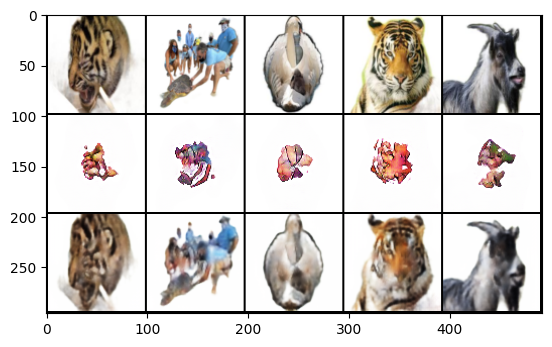

Cycle B: Real B -> Fake A -> Reconstructed B


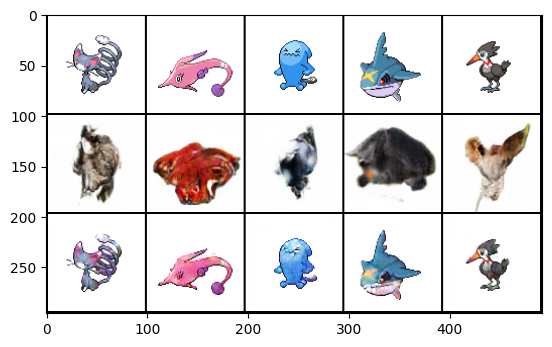

Epoch 461:
  Generator Total Loss: 10.4765
    G_AB (A->B) Loss:  5.8986
    G_BA (B->A) Loss:  4.5779
    Identity Loss:     0.0339
    GAN Loss:          1.6396
    Cycle Loss:        0.0516
    Feature Match:     0.2333
    Perceptual Loss:   0.6604
  Discriminator A Loss: 0.4450
  Discriminator B Loss: 0.3130


Epoch 462:
  Generator Total Loss: 10.2761
    G_AB (A->B) Loss:  5.8173
    G_BA (B->A) Loss:  4.4588
    Identity Loss:     0.0282
    GAN Loss:          1.6160
    Cycle Loss:        0.0451
    Feature Match:     0.2315
    Perceptual Loss:   0.6574
  Discriminator A Loss: 0.4513
  Discriminator B Loss: 0.3156


Epoch 463:
  Generator Total Loss: 10.3251
    G_AB (A->B) Loss:  5.8481
    G_BA (B->A) Loss:  4.4771
    Identity Loss:     0.0292
    GAN Loss:          1.6199
    Cycle Loss:        0.0471
    Feature Match:     0.2321
    Perceptual Loss:   0.6581
  Discriminator A Loss: 0.4481
  Discriminator B Loss: 0.3183


Epoch 464:
  Generator Total Loss: 10.3861
    G_AB (A->B) Loss:  5.8746
    G_BA (B->A) Loss:  4.5115
    Identity Loss:     0.0311
    GAN Loss:          1.6420
    Cycle Loss:        0.0489
    Feature Match:     0.2310
    Perceptual Loss:   0.6582
  Discriminator A Loss: 0.4463
  Discriminator B Loss: 0.3159


Epoch 465:
  Generator Total Loss: 10.4548
    G_AB (A->B) Loss:  5.9362
    G_BA (B->A) Loss:  4.5187
    Identity Loss:     0.0307
    GAN Loss:          1.6724
    Cycle Loss:        0.0486
    Feature Match:     0.2327
    Perceptual Loss:   0.6548
  Discriminator A Loss: 0.4436
  Discriminator B Loss: 0.3139


Epoch 466:
  Generator Total Loss: 10.2971
    G_AB (A->B) Loss:  5.8041
    G_BA (B->A) Loss:  4.4930
    Identity Loss:     0.0295
    GAN Loss:          1.6123
    Cycle Loss:        0.0472
    Feature Match:     0.2308
    Perceptual Loss:   0.6590
  Discriminator A Loss: 0.4469
  Discriminator B Loss: 0.3217


Epoch 467:
  Generator Total Loss: 10.3331
    G_AB (A->B) Loss:  5.8237
    G_BA (B->A) Loss:  4.5093
    Identity Loss:     0.0299
    GAN Loss:          1.6219
    Cycle Loss:        0.0479
    Feature Match:     0.2313
    Perceptual Loss:   0.6586
  Discriminator A Loss: 0.4495
  Discriminator B Loss: 0.3171


Epoch 468:
  Generator Total Loss: 10.1887
    G_AB (A->B) Loss:  5.7735
    G_BA (B->A) Loss:  4.4152
    Identity Loss:     0.0267
    GAN Loss:          1.5984
    Cycle Loss:        0.0447
    Feature Match:     0.2293
    Perceptual Loss:   0.6569
  Discriminator A Loss: 0.4559
  Discriminator B Loss: 0.3185


Epoch 469:
  Generator Total Loss: 10.2223
    G_AB (A->B) Loss:  5.7798
    G_BA (B->A) Loss:  4.4425
    Identity Loss:     0.0286
    GAN Loss:          1.5959
    Cycle Loss:        0.0463
    Feature Match:     0.2296
    Perceptual Loss:   0.6573
  Discriminator A Loss: 0.4555
  Discriminator B Loss: 0.3210


Epoch 470:
  Generator Total Loss: 10.3567
    G_AB (A->B) Loss:  5.8560
    G_BA (B->A) Loss:  4.5007
    Identity Loss:     0.0303
    GAN Loss:          1.6363
    Cycle Loss:        0.0480
    Feature Match:     0.2316
    Perceptual Loss:   0.6552
  Discriminator A Loss: 0.4504
  Discriminator B Loss: 0.3130


Cycle A: Real A -> Fake B -> Reconstructed A


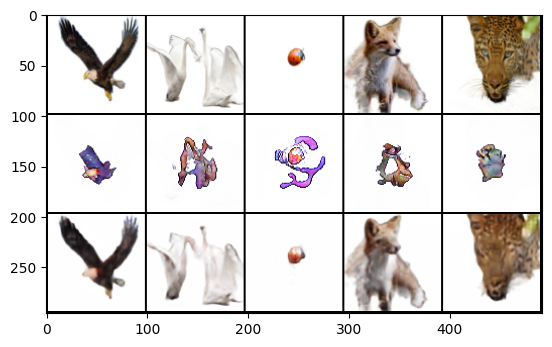

Cycle B: Real B -> Fake A -> Reconstructed B


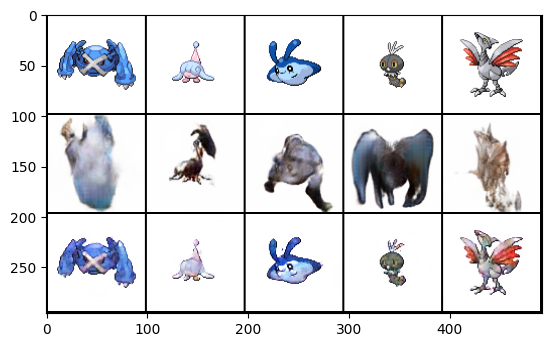

Epoch 471:
  Generator Total Loss: 10.3196
    G_AB (A->B) Loss:  5.8457
    G_BA (B->A) Loss:  4.4740
    Identity Loss:     0.0272
    GAN Loss:          1.6326
    Cycle Loss:        0.0451
    Feature Match:     0.2331
    Perceptual Loss:   0.6551
  Discriminator A Loss: 0.4545
  Discriminator B Loss: 0.3143


Epoch 472:
  Generator Total Loss: 10.3277
    G_AB (A->B) Loss:  5.8232
    G_BA (B->A) Loss:  4.5045
    Identity Loss:     0.0320
    GAN Loss:          1.6189
    Cycle Loss:        0.0496
    Feature Match:     0.2301
    Perceptual Loss:   0.6553
  Discriminator A Loss: 0.4488
  Discriminator B Loss: 0.3192


Epoch 473:
  Generator Total Loss: 10.3002
    G_AB (A->B) Loss:  5.8239
    G_BA (B->A) Loss:  4.4763
    Identity Loss:     0.0300
    GAN Loss:          1.6193
    Cycle Loss:        0.0479
    Feature Match:     0.2300
    Perceptual Loss:   0.6567
  Discriminator A Loss: 0.4522
  Discriminator B Loss: 0.3185


Epoch 474:
  Generator Total Loss: 10.2735
    G_AB (A->B) Loss:  5.8086
    G_BA (B->A) Loss:  4.4649
    Identity Loss:     0.0281
    GAN Loss:          1.6225
    Cycle Loss:        0.0461
    Feature Match:     0.2300
    Perceptual Loss:   0.6569
  Discriminator A Loss: 0.4514
  Discriminator B Loss: 0.3175


Epoch 475:
  Generator Total Loss: 10.2867
    G_AB (A->B) Loss:  5.8190
    G_BA (B->A) Loss:  4.4677
    Identity Loss:     0.0281
    GAN Loss:          1.6165
    Cycle Loss:        0.0463
    Feature Match:     0.2308
    Perceptual Loss:   0.6592
  Discriminator A Loss: 0.4547
  Discriminator B Loss: 0.3179
Model saved to models/PokeMalCycleGAN-96x96-G_AB-475-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-475-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-475-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-475-best.pth


Epoch 476:
  Generator Total Loss: 10.2717
    G_AB (A->B) Loss:  5.8051
    G_BA (B->A) Loss:  4.4666
    Identity Loss:     0.0287
    GAN Loss:          1.6388
    Cycle Loss:        0.0466
    Feature Match:     0.2286
    Perceptual Loss:   0.6514
  Discriminator A Loss: 0.4496
  Discriminator B Loss: 0.3130


Epoch 477:
  Generator Total Loss: 10.2531
    G_AB (A->B) Loss:  5.7965
    G_BA (B->A) Loss:  4.4565
    Identity Loss:     0.0286
    GAN Loss:          1.6223
    Cycle Loss:        0.0465
    Feature Match:     0.2291
    Perceptual Loss:   0.6532
  Discriminator A Loss: 0.4558
  Discriminator B Loss: 0.3175


Epoch 478:
  Generator Total Loss: 10.2183
    G_AB (A->B) Loss:  5.7514
    G_BA (B->A) Loss:  4.4669
    Identity Loss:     0.0283
    GAN Loss:          1.6018
    Cycle Loss:        0.0465
    Feature Match:     0.2286
    Perceptual Loss:   0.6573
  Discriminator A Loss: 0.4536
  Discriminator B Loss: 0.3195


Epoch 479:
  Generator Total Loss: 10.2323
    G_AB (A->B) Loss:  5.7896
    G_BA (B->A) Loss:  4.4427
    Identity Loss:     0.0273
    GAN Loss:          1.6166
    Cycle Loss:        0.0453
    Feature Match:     0.2297
    Perceptual Loss:   0.6541
  Discriminator A Loss: 0.4595
  Discriminator B Loss: 0.3129


Epoch 480:
  Generator Total Loss: 10.2587
    G_AB (A->B) Loss:  5.7979
    G_BA (B->A) Loss:  4.4607
    Identity Loss:     0.0271
    GAN Loss:          1.6154
    Cycle Loss:        0.0453
    Feature Match:     0.2308
    Perceptual Loss:   0.6573
  Discriminator A Loss: 0.4517
  Discriminator B Loss: 0.3196


Cycle A: Real A -> Fake B -> Reconstructed A


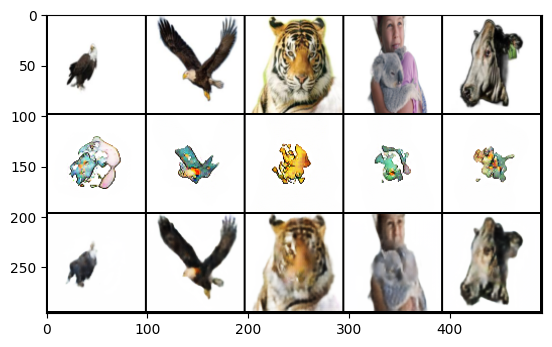

Cycle B: Real B -> Fake A -> Reconstructed B


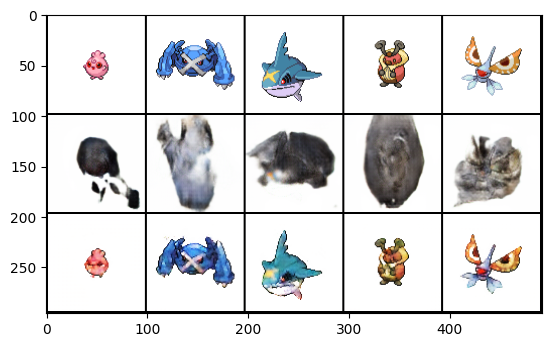

Epoch 481:
  Generator Total Loss: 10.2580
    G_AB (A->B) Loss:  5.7895
    G_BA (B->A) Loss:  4.4685
    Identity Loss:     0.0288
    GAN Loss:          1.6267
    Cycle Loss:        0.0466
    Feature Match:     0.2281
    Perceptual Loss:   0.6556
  Discriminator A Loss: 0.4713
  Discriminator B Loss: 0.3150


Epoch 482:
  Generator Total Loss: 10.2002
    G_AB (A->B) Loss:  5.7191
    G_BA (B->A) Loss:  4.4811
    Identity Loss:     0.0297
    GAN Loss:          1.6140
    Cycle Loss:        0.0478
    Feature Match:     0.2254
    Perceptual Loss:   0.6532
  Discriminator A Loss: 0.4562
  Discriminator B Loss: 0.3180


Epoch 483:
  Generator Total Loss: 10.1726
    G_AB (A->B) Loss:  5.7585
    G_BA (B->A) Loss:  4.4141
    Identity Loss:     0.0252
    GAN Loss:          1.6092
    Cycle Loss:        0.0430
    Feature Match:     0.2288
    Perceptual Loss:   0.6564
  Discriminator A Loss: 0.4572
  Discriminator B Loss: 0.3186


Epoch 484:
  Generator Total Loss: 10.2186
    G_AB (A->B) Loss:  5.7556
    G_BA (B->A) Loss:  4.4630
    Identity Loss:     0.0286
    GAN Loss:          1.6224
    Cycle Loss:        0.0466
    Feature Match:     0.2270
    Perceptual Loss:   0.6529
  Discriminator A Loss: 0.4533
  Discriminator B Loss: 0.3176


Epoch 485:
  Generator Total Loss: 10.2270
    G_AB (A->B) Loss:  5.7722
    G_BA (B->A) Loss:  4.4548
    Identity Loss:     0.0285
    GAN Loss:          1.6021
    Cycle Loss:        0.0464
    Feature Match:     0.2291
    Perceptual Loss:   0.6572
  Discriminator A Loss: 0.4530
  Discriminator B Loss: 0.3222


Epoch 486:
  Generator Total Loss: 10.1495
    G_AB (A->B) Loss:  5.7508
    G_BA (B->A) Loss:  4.3986
    Identity Loss:     0.0268
    GAN Loss:          1.6166
    Cycle Loss:        0.0444
    Feature Match:     0.2263
    Perceptual Loss:   0.6503
  Discriminator A Loss: 0.4598
  Discriminator B Loss: 0.3133


Epoch 487:
  Generator Total Loss: 10.1744
    G_AB (A->B) Loss:  5.7533
    G_BA (B->A) Loss:  4.4211
    Identity Loss:     0.0271
    GAN Loss:          1.6122
    Cycle Loss:        0.0450
    Feature Match:     0.2276
    Perceptual Loss:   0.6517
  Discriminator A Loss: 0.4594
  Discriminator B Loss: 0.3159


Epoch 488:
  Generator Total Loss: 10.1932
    G_AB (A->B) Loss:  5.7708
    G_BA (B->A) Loss:  4.4224
    Identity Loss:     0.0283
    GAN Loss:          1.6173
    Cycle Loss:        0.0461
    Feature Match:     0.2267
    Perceptual Loss:   0.6520
  Discriminator A Loss: 0.4567
  Discriminator B Loss: 0.3163


Epoch 489:
  Generator Total Loss: 10.1402
    G_AB (A->B) Loss:  5.7261
    G_BA (B->A) Loss:  4.4141
    Identity Loss:     0.0267
    GAN Loss:          1.6088
    Cycle Loss:        0.0448
    Feature Match:     0.2261
    Perceptual Loss:   0.6519
  Discriminator A Loss: 0.4603
  Discriminator B Loss: 0.3161


Epoch 490:
  Generator Total Loss: 10.2066
    G_AB (A->B) Loss:  5.7689
    G_BA (B->A) Loss:  4.4377
    Identity Loss:     0.0272
    GAN Loss:          1.6135
    Cycle Loss:        0.0451
    Feature Match:     0.2288
    Perceptual Loss:   0.6538
  Discriminator A Loss: 0.4597
  Discriminator B Loss: 0.3165


Cycle A: Real A -> Fake B -> Reconstructed A


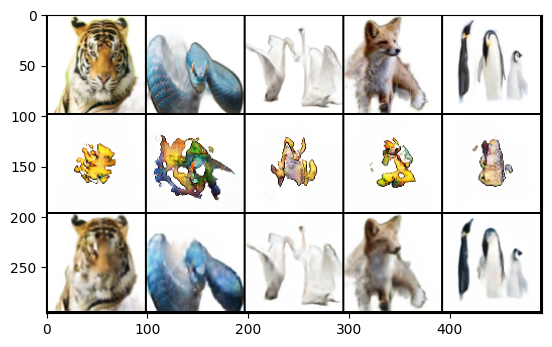

Cycle B: Real B -> Fake A -> Reconstructed B


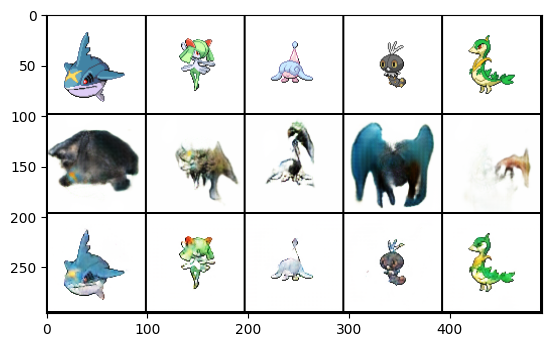

Epoch 491:
  Generator Total Loss: 10.1642
    G_AB (A->B) Loss:  5.7385
    G_BA (B->A) Loss:  4.4257
    Identity Loss:     0.0278
    GAN Loss:          1.6166
    Cycle Loss:        0.0456
    Feature Match:     0.2261
    Perceptual Loss:   0.6502
  Discriminator A Loss: 0.4592
  Discriminator B Loss: 0.3153


Epoch 492:
  Generator Total Loss: 10.1443
    G_AB (A->B) Loss:  5.7425
    G_BA (B->A) Loss:  4.4018
    Identity Loss:     0.0270
    GAN Loss:          1.5942
    Cycle Loss:        0.0449
    Feature Match:     0.2267
    Perceptual Loss:   0.6572
  Discriminator A Loss: 0.4618
  Discriminator B Loss: 0.3207


Epoch 493:
  Generator Total Loss: 10.1655
    G_AB (A->B) Loss:  5.7501
    G_BA (B->A) Loss:  4.4153
    Identity Loss:     0.0266
    GAN Loss:          1.6134
    Cycle Loss:        0.0446
    Feature Match:     0.2273
    Perceptual Loss:   0.6517
  Discriminator A Loss: 0.4564
  Discriminator B Loss: 0.3189


Epoch 494:
  Generator Total Loss: 10.1334
    G_AB (A->B) Loss:  5.7106
    G_BA (B->A) Loss:  4.4228
    Identity Loss:     0.0280
    GAN Loss:          1.5951
    Cycle Loss:        0.0457
    Feature Match:     0.2259
    Perceptual Loss:   0.6533
  Discriminator A Loss: 0.4619
  Discriminator B Loss: 0.3186


Epoch 495:
  Generator Total Loss: 10.1749
    G_AB (A->B) Loss:  5.7551
    G_BA (B->A) Loss:  4.4198
    Identity Loss:     0.0275
    GAN Loss:          1.6093
    Cycle Loss:        0.0450
    Feature Match:     0.2278
    Perceptual Loss:   0.6515
  Discriminator A Loss: 0.4647
  Discriminator B Loss: 0.3136


Epoch 496:
  Generator Total Loss: 10.2801
    G_AB (A->B) Loss:  5.7892
    G_BA (B->A) Loss:  4.4909
    Identity Loss:     0.0286
    GAN Loss:          1.6344
    Cycle Loss:        0.0467
    Feature Match:     0.2285
    Perceptual Loss:   0.6557
  Discriminator A Loss: 0.4399
  Discriminator B Loss: 0.3171


Epoch 497:
  Generator Total Loss: 10.1508
    G_AB (A->B) Loss:  5.7352
    G_BA (B->A) Loss:  4.4156
    Identity Loss:     0.0266
    GAN Loss:          1.6279
    Cycle Loss:        0.0445
    Feature Match:     0.2254
    Perceptual Loss:   0.6487
  Discriminator A Loss: 0.4517
  Discriminator B Loss: 0.3149


Epoch 498:
  Generator Total Loss: 10.1471
    G_AB (A->B) Loss:  5.7538
    G_BA (B->A) Loss:  4.3933
    Identity Loss:     0.0270
    GAN Loss:          1.6181
    Cycle Loss:        0.0447
    Feature Match:     0.2259
    Perceptual Loss:   0.6493
  Discriminator A Loss: 0.4593
  Discriminator B Loss: 0.3147


Epoch 499:
  Generator Total Loss: 10.1275
    G_AB (A->B) Loss:  5.7277
    G_BA (B->A) Loss:  4.3997
    Identity Loss:     0.0275
    GAN Loss:          1.6070
    Cycle Loss:        0.0453
    Feature Match:     0.2248
    Perceptual Loss:   0.6519
  Discriminator A Loss: 0.4561
  Discriminator B Loss: 0.3197


Epoch 500:
  Generator Total Loss: 10.1349
    G_AB (A->B) Loss:  5.7262
    G_BA (B->A) Loss:  4.4087
    Identity Loss:     0.0270
    GAN Loss:          1.6014
    Cycle Loss:        0.0451
    Feature Match:     0.2258
    Perceptual Loss:   0.6540
  Discriminator A Loss: 0.4570
  Discriminator B Loss: 0.3202


Cycle A: Real A -> Fake B -> Reconstructed A


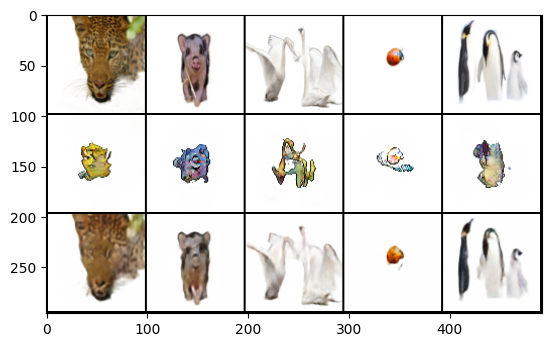

Cycle B: Real B -> Fake A -> Reconstructed B


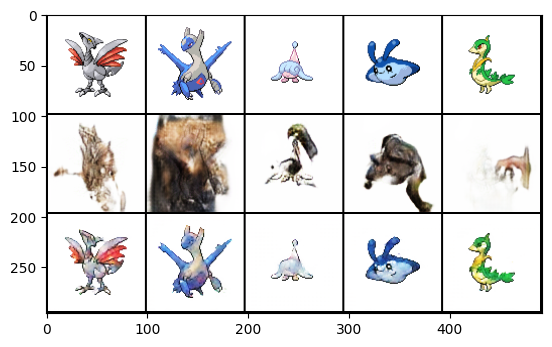

Model saved to models/PokeMalCycleGAN-96x96-G_AB-500-best.pth


Model saved to models/PokeMalCycleGAN-96x96-G_BA-500-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-500-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-500-best.pth


Epoch 501:
  Generator Total Loss: 10.2191
    G_AB (A->B) Loss:  5.8036
    G_BA (B->A) Loss:  4.4156
    Identity Loss:     0.0281
    GAN Loss:          1.6382
    Cycle Loss:        0.0458
    Feature Match:     0.2264
    Perceptual Loss:   0.6506
  Discriminator A Loss: 0.4587
  Discriminator B Loss: 0.3154


In [28]:
# Training loop
for epoch in range(n_epochs):
    # Initialize epoch loss tracking
    epoch_gen_losses = []
    epoch_gen_AB_losses = []
    epoch_gen_BA_losses = []
    epoch_id_losses = []
    epoch_gan_losses = []
    epoch_cycle_losses = []
    epoch_fm_losses = []
    epoch_perceptual_losses = []
    epoch_discA_losses = []
    epoch_discB_losses = []
    
    # Iterate through batches
    for i, (real_A, real_B) in enumerate(trainloader):
        real_A, real_B = real_A.type(Tensor), real_B.type(Tensor)
        
        # Apply data augmentation
        if random.random() > 0.5:
            real_A = augment(real_A)
        if random.random() > 0.5:
            real_B = augment(real_B)
            
        batch_size = real_A.size(0)
        
        # Set models to training mode
        G_AB.train()
        G_BA.train()
        D_A.train()
        D_B.train()
        
        # Ground truth labels
        valid = torch.ones((batch_size, 1, real_A.size(2) // D_A.scale_factor, 
                          real_A.size(3) // D_A.scale_factor)).type(Tensor)
        fake = torch.zeros((batch_size, 1, real_A.size(2) // D_A.scale_factor, 
                          real_A.size(3) // D_A.scale_factor)).type(Tensor)
        
        # Binary labels for global discriminator
        valid_global = torch.ones(batch_size, 1).type(Tensor)
        fake_global = torch.zeros(batch_size, 1).type(Tensor)
        
        #------------------
        # Train Generators
        #------------------
        optimizer_G.zero_grad()
        
        # Generate fake images
        fake_B = G_AB(real_A)
        fake_A = G_BA(real_B)
        
        # Identity loss
        loss_id_A = criterion_identity(G_BA(real_A), real_A)
        loss_id_B = criterion_identity(G_AB(real_B), real_B)
        loss_identity = (loss_id_A + loss_id_B) / 2
        
        # GAN loss with feature extraction for feature matching
        patch_real_A, global_real_A, features_real_A = D_A(real_A, get_features=True)
        patch_fake_A, global_fake_A, features_fake_A = D_A(fake_A, get_features=True)
        patch_real_B, global_real_B, features_real_B = D_B(real_B, get_features=True)
        patch_fake_B, global_fake_B, features_fake_B = D_B(fake_B, get_features=True)
        
        # Relativistic average GAN loss for generators
        loss_GAN_AB = 0.7 * F.mse_loss(patch_fake_B - patch_real_B.mean(0, keepdim=True), 
                                      torch.ones_like(patch_fake_B)) + \
                      0.3 * F.binary_cross_entropy_with_logits(
                          global_fake_B - global_real_B.mean(0, keepdim=True), valid_global)
        
        loss_GAN_BA = 0.7 * F.mse_loss(patch_fake_A - patch_real_A.mean(0, keepdim=True), 
                                      torch.ones_like(patch_fake_A)) + \
                      0.3 * F.binary_cross_entropy_with_logits(
                          global_fake_A - global_real_A.mean(0, keepdim=True), valid_global)
        
        loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
        
        # Feature matching loss
        loss_FM_A = feature_matching_loss(features_real_A, features_fake_A)
        loss_FM_B = feature_matching_loss(features_real_B, features_fake_B)
        loss_FM = (loss_FM_A + loss_FM_B) / 2
        
        # VGG perceptual loss
        loss_perceptual_AB = vgg_loss(fake_B, real_B)
        loss_perceptual_BA = vgg_loss(fake_A, real_A)
        loss_perceptual = (loss_perceptual_AB + loss_perceptual_BA) / 2
        
        # Cycle consistency loss
        recov_A = G_BA(fake_B)
        recov_B = G_AB(fake_A)
        loss_cycle_A = criterion_cycle(recov_A, real_A)
        loss_cycle_B = criterion_cycle(recov_B, real_B)
        loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
        
        # Total generator loss with adaptive weights
        loss_G_AB = lambda_identity * loss_id_A + lambda_gan * loss_GAN_AB + \
                    lambda_cyc * loss_cycle_A + lambda_fm * loss_FM_A + \
                    lambda_perceptual * loss_perceptual_AB
        
        loss_G_BA = lambda_identity * loss_id_B + lambda_gan * loss_GAN_BA + \
                    lambda_cyc * loss_cycle_B + lambda_fm * loss_FM_B + \
                    lambda_perceptual * loss_perceptual_BA
        
        loss_G = loss_G_AB + loss_G_BA
        
        # Backward pass and optimize
        loss_G.backward()
        optimizer_G.step()
        
        # Update EMA weights
        ema_G_AB.update(G_AB)
        ema_G_BA.update(G_BA)
        
        #------------------
        # Train Discriminator A
        #------------------
        optimizer_D_A.zero_grad()
        
        # Get real and fake samples (using pool for fake samples)
        fake_A_ = fake_A_pool.query(fake_A.detach())
        
        # Get discriminator outputs
        real_patch_A, real_global_A = D_A(real_A)
        fake_patch_A, fake_global_A = D_A(fake_A_.detach())
        
        # Relativistic loss for discriminator A
        loss_D_A_rel = relativistic_loss(
            (real_patch_A, real_global_A),
            (fake_patch_A, fake_global_A),
            F.mse_loss
        )
        
        # Gradient penalty
        loss_D_A_gp = compute_gradient_penalty(D_A, real_A, fake_A_.detach())
        
        # Total discriminator loss
        loss_D_A = loss_D_A_rel + lambda_gp * loss_D_A_gp
        
        # Backward pass and optimize
        loss_D_A.backward()
        optimizer_D_A.step()
        
        #------------------
        # Train Discriminator B
        #------------------
        optimizer_D_B.zero_grad()
        
        # Get real and fake samples (using pool for fake samples)
        fake_B_ = fake_B_pool.query(fake_B.detach())
        
        # Get discriminator outputs
        real_patch_B, real_global_B = D_B(real_B)
        fake_patch_B, fake_global_B = D_B(fake_B_.detach())
        
        # Relativistic loss for discriminator B
        loss_D_B_rel = relativistic_loss(
            (real_patch_B, real_global_B),
            (fake_patch_B, fake_global_B),
            F.mse_loss
        )
        
        # Gradient penalty
        loss_D_B_gp = compute_gradient_penalty(D_B, real_B, fake_B_.detach())
        
        # Total discriminator loss
        loss_D_B = loss_D_B_rel + lambda_gp * loss_D_B_gp
        
        # Backward pass and optimize
        loss_D_B.backward()
        optimizer_D_B.step()
        
        # Record losses for this batch
        epoch_gen_losses.append(loss_G.item())
        epoch_gen_AB_losses.append(loss_G_AB.item())
        epoch_gen_BA_losses.append(loss_G_BA.item())
        epoch_id_losses.append(loss_identity.item())
        epoch_gan_losses.append(loss_GAN.item())
        epoch_cycle_losses.append(loss_cycle.item())
        epoch_fm_losses.append(loss_FM.item())
        epoch_perceptual_losses.append(loss_perceptual.item())
        epoch_discA_losses.append(loss_D_A.item())
        epoch_discB_losses.append(loss_D_B.item())
    
    # Update learning rates
    lr_scheduler_G.step()
    lr_scheduler_D_A.step()
    lr_scheduler_D_B.step()
    
    # Print epoch statistics
    print_epoch_losses(epoch+1, epoch_gen_losses, epoch_gen_AB_losses, epoch_gen_BA_losses,
                      epoch_id_losses, epoch_gan_losses, epoch_cycle_losses, 
                      epoch_fm_losses, epoch_perceptual_losses,
                      epoch_discA_losses, epoch_discB_losses)
    
    # Record the epoch averages in history
    gen_loss_history.append(sum(epoch_gen_losses) / len(epoch_gen_losses))
    gen_AB_loss_history.append(sum(epoch_gen_AB_losses) / len(epoch_gen_AB_losses))
    gen_BA_loss_history.append(sum(epoch_gen_BA_losses) / len(epoch_gen_BA_losses))
    id_loss_history.append(sum(epoch_id_losses) / len(epoch_id_losses))
    gan_loss_history.append(sum(epoch_gan_losses) / len(epoch_gan_losses))
    cycle_loss_history.append(sum(epoch_cycle_losses) / len(epoch_cycle_losses))
    fm_loss_history.append(sum(epoch_fm_losses) / len(epoch_fm_losses))
    perceptual_loss_history.append(sum(epoch_perceptual_losses) / len(epoch_perceptual_losses))
    discA_loss_history.append(sum(epoch_discA_losses) / len(epoch_discA_losses))
    discB_loss_history.append(sum(epoch_discB_losses) / len(epoch_discB_losses))
    
    # Validation and visualization every 10 epochs
    if (epoch + 1) % 10 == 0:
        G_AB.eval()
        G_BA.eval()
        
        # Get validation samples
        valid_iter = iter(validloader)
        valid_real_A, valid_real_B = next(valid_iter)
        valid_real_A, valid_real_B = valid_real_A.type(Tensor), valid_real_B.type(Tensor)
        
        # Generate validation results
        with torch.no_grad():
            # Generate fake samples
            valid_fake_B = G_AB(valid_real_A)
            valid_fake_A = G_BA(valid_real_B)
            
            # Generate reconstructed samples
            valid_recov_A = G_BA(valid_fake_B)
            valid_recov_B = G_AB(valid_fake_A)
        
        # Visualize validation results
        show_images(valid_real_A, valid_fake_B, valid_recov_A,
                   valid_real_B, valid_fake_A, valid_recov_B,
                   size=image_size)

    # Save checkpoints
    if (epoch + 1) % 25 == 0:
        save_checkpoint(G_AB, f"G_AB-{epoch+1}", torch_seed)
        save_checkpoint(G_BA, f"G_BA-{epoch+1}", torch_seed)
        save_checkpoint(D_A, f"D_A-{epoch+1}", torch_seed)
        save_checkpoint(D_B, f"D_B-{epoch+1}", torch_seed)

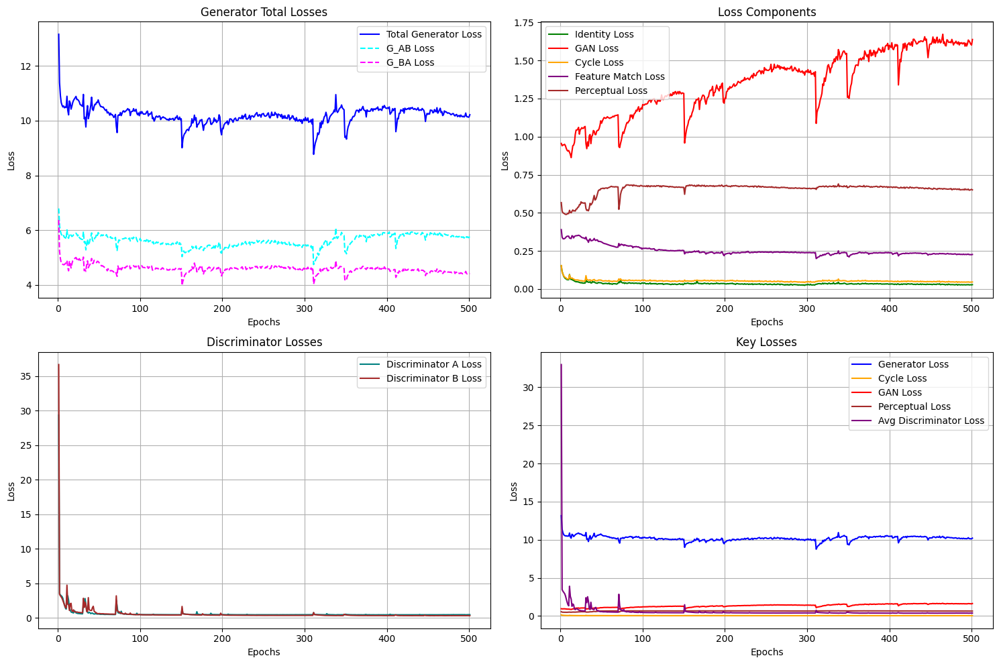

In [29]:
plot_losses(gen_loss_history, gen_AB_loss_history, gen_BA_loss_history,
           id_loss_history, gan_loss_history, cycle_loss_history, 
           fm_loss_history, perceptual_loss_history,
           discA_loss_history, discB_loss_history)

In [30]:
save_checkpoint(G_AB, "G_AB", torch_seed)
save_checkpoint(G_BA, "G_BA", torch_seed)
save_checkpoint(D_A, "D_A", torch_seed)
save_checkpoint(D_B, "D_B", torch_seed)

Model saved to models/PokeMalCycleGAN-96x96-G_AB-best.pth
Model saved to models/PokeMalCycleGAN-96x96-G_BA-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_A-best.pth
Model saved to models/PokeMalCycleGAN-96x96-D_B-best.pth


In [31]:
def load_model(model, model_name):

    # Load the Checkpoing
    checkpoint = torch.load(f"models/{file_name}-{model_name}-best.pth")

    # Load the state dict into the model
    model.load_state_dict(checkpoint['model'])
    torch_seed = checkpoint['torch_seed']

    model.cuda()

    return model, torch_seed

In [32]:
G_AB, torch_seed = load_model(G_AB, "G_AB")
G_BA, torch_seed = load_model(G_BA, "G_BA")
D_A, torch_seed = load_model(D_A, "D_A")
D_B, torch_seed = load_model(D_B, "D_B")

## 5. Evaluation

In [33]:
"""
Step 8. Generate Images
"""
## Translation 1: Animal Image --> Pokemon Image
test_dir = os.path.join(data_dir, 'animal/test') # modification forbidden
files = [os.path.join(test_dir, name) for name in os.listdir(test_dir)]

save_dir = f'./generated_pokemon/{file_name}'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

to_image = transforms.ToPILImage()

G_AB.eval()
for i in range(0, len(files), batch_size):
    # read images
    imgs = []
    for j in range(i, min(len(files), i+batch_size)):
        img = Image.open(files[j])
        img = data_transforms(img)
        imgs.append(img)
    imgs = torch.stack(imgs, 0).type(Tensor)

    # generate
    fake_imgs = G_AB(imgs).detach().cpu()

    # save
    for j in range(fake_imgs.size(0)):
        img = fake_imgs[j].squeeze().permute(1, 2, 0)
        img_arr = img.numpy()
        img_arr = (img_arr - np.min(img_arr)) * 255 / (np.max(img_arr) - np.min(img_arr))
        img_arr = img_arr.astype(np.uint8)

        img = to_image(img_arr)
        _, name = os.path.split(files[i+j])
        img.save(os.path.join(save_dir, name))

gt_dir = os.path.join(data_dir, 'pokemon/test')
metrics = torch_fidelity.calculate_metrics(
    input1=save_dir,
    input2=gt_dir,
    cuda=True,
    fid=True,
    isc=True
)

fid_score = metrics["frechet_inception_distance"]
is_score = metrics["inception_score_mean"]

if is_score > 0:
    s_value_1 = np.sqrt(fid_score / is_score)
    print("Geometric Mean Score:", s_value_1)
else:
    print("IS is 0, GMS cannot be computed!")

Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon/PokeMalCycleGAN-96x96" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics
/common/home/users/z/zhirong.tan.2022/jupyterlab-venv-pytorch-240/lib/python3.11/site-packages/torch_fidelity/datasets.py:16: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  img = torch.ByteTensor(torch.ByteStorage.from_buffer(img.tobytes())).view(height, width, 3)


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:02, 228.25samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 552.63samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 753.07samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 882.09samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg


Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 291.14samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 648.16samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 835.91samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 944.02samples/s]

Processing samples
Inception Score: 2.702528497064191 ± 0.19951400395004004


Geometric Mean Score: 6.2392435800474075


Frechet Inception Distance: 105.20446295755465


In [34]:
## Translation 2: Pokemon Image --> Animal Image
test_dir = os.path.join(data_dir, 'pokemon/test') # modification forbidden
files = [os.path.join(test_dir, name) for name in os.listdir(test_dir)]

save_dir = f'./generated_animals/{file_name}'
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

G_BA.eval()
for i in range(0, len(files), batch_size):
    # read images
    imgs = []
    for j in range(i, min(len(files), i+batch_size)):
        img = Image.open(files[j])
        img = data_transforms(img)
        imgs.append(img)
    imgs = torch.stack(imgs, 0).type(Tensor)

    # generate
    fake_imgs = G_BA(imgs).detach().cpu()

    # save
    for j in range(fake_imgs.size(0)):
        img = fake_imgs[j].squeeze().permute(1, 2, 0)
        img_arr = img.numpy()
        img_arr = (img_arr - np.min(img_arr)) * 255 / (np.max(img_arr) - np.min(img_arr))
        img_arr = img_arr.astype(np.uint8)

        img = to_image(img_arr)
        _, name = os.path.split(files[i+j])
        img.save(os.path.join(save_dir, name))

gt_dir = os.path.join(data_dir, 'animal/test')

metrics = torch_fidelity.calculate_metrics(
    input1 = save_dir,
    input2 = gt_dir,
    cuda = True,
    fid = True,
    isc = True,
    batch_size=1,
)

fid_score = metrics["frechet_inception_distance"]
is_score = metrics["inception_score_mean"]

if is_score > 0:
    s_value_2 = np.sqrt(fid_score / is_score)
    print("Geometric Mean Score:", s_value_2)
else:
    print("IS is 0, GMS cannot be computed!")

Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animals/PokeMalCycleGAN-96x96" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:43,  5.21samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:13, 40.56samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 58.26samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 68.23samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 74.21samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 78.85samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:06, 80.77samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.42samples/s]

Processing samples:  14%|█▎        | 73/540 [00:01<00:05, 83.93samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.26samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 84.95samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.20samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.72samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 85.85samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 85.98samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 85.90samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.03samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.06samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 85.91samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.08samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.18samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.83samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 87.03samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 87.24samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.94samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 87.06samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.88samples/s]

Processing samples:  45%|████▌     | 244/540 [00:03<00:03, 86.31samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.26samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.09samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 85.86samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 85.98samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 85.79samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.07samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 85.46samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 85.01samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 84.91samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 85.39samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 85.89samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 85.93samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 85.96samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 85.93samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 85.69samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 85.58samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 85.73samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.85samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 85.99samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 86.14samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 86.17samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 86.36samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 86.33samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 86.49samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 86.15samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 86.00samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 86.01samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 86.12samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 86.21samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 86.37samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 86.30samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 86.15samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:20,  6.73samples/s]

Processing samples:   1%|▏         | 8/540 [00:00<00:14, 37.60samples/s]

Processing samples:   2%|▏         | 13/540 [00:00<00:12, 42.64samples/s]

Processing samples:   3%|▎         | 18/540 [00:00<00:14, 37.19samples/s]

Processing samples:   5%|▍         | 26/540 [00:00<00:10, 49.84samples/s]

Processing samples:   6%|▋         | 34/540 [00:00<00:08, 57.38samples/s]

Processing samples:   8%|▊         | 43/540 [00:00<00:07, 65.19samples/s]

Processing samples:   9%|▉         | 50/540 [00:00<00:07, 66.06samples/s]

Processing samples:  11%|█         | 57/540 [00:01<00:09, 49.17samples/s]

Processing samples:  12%|█▏        | 66/540 [00:01<00:08, 57.86samples/s]

Processing samples:  14%|█▎        | 74/540 [00:01<00:07, 61.60samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:07, 65.08samples/s]

Processing samples:  17%|█▋        | 90/540 [00:01<00:06, 68.69samples/s]

Processing samples:  18%|█▊        | 98/540 [00:01<00:06, 70.78samples/s]

Processing samples:  20%|█▉        | 106/540 [00:01<00:05, 73.28samples/s]

Processing samples:  21%|██        | 114/540 [00:01<00:05, 72.48samples/s]

Processing samples:  23%|██▎       | 122/540 [00:02<00:05, 73.71samples/s]

Processing samples:  24%|██▍       | 130/540 [00:02<00:05, 74.81samples/s]

Processing samples:  26%|██▌       | 139/540 [00:02<00:05, 76.65samples/s]

Processing samples:  27%|██▋       | 148/540 [00:02<00:05, 78.16samples/s]

Processing samples:  29%|██▉       | 156/540 [00:02<00:04, 78.60samples/s]

Processing samples:  30%|███       | 164/540 [00:02<00:04, 78.84samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 78.65samples/s]

Processing samples:  33%|███▎      | 180/540 [00:02<00:04, 78.49samples/s]

Processing samples:  35%|███▍      | 188/540 [00:02<00:04, 76.76samples/s]

Processing samples:  36%|███▋      | 197/540 [00:02<00:04, 78.98samples/s]

Processing samples:  38%|███▊      | 205/540 [00:03<00:04, 77.44samples/s]

Processing samples:  39%|███▉      | 213/540 [00:03<00:04, 74.27samples/s]

Processing samples:  41%|████      | 221/540 [00:03<00:04, 73.81samples/s]

Processing samples:  42%|████▏     | 229/540 [00:03<00:04, 75.03samples/s]

Processing samples:  44%|████▍     | 238/540 [00:03<00:03, 76.95samples/s]

Processing samples:  46%|████▌     | 246/540 [00:03<00:03, 77.61samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 74.23samples/s]

Processing samples:  49%|████▊     | 263/540 [00:03<00:03, 76.61samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 77.54samples/s]

Processing samples:  52%|█████▏    | 279/540 [00:04<00:03, 78.04samples/s]

Processing samples:  53%|█████▎    | 288/540 [00:04<00:03, 79.13samples/s]

Processing samples:  55%|█████▍    | 296/540 [00:04<00:03, 77.44samples/s]

Processing samples:  56%|█████▋    | 305/540 [00:04<00:02, 78.51samples/s]

Processing samples:  58%|█████▊    | 313/540 [00:04<00:02, 77.43samples/s]

Processing samples:  59%|█████▉    | 321/540 [00:04<00:02, 77.77samples/s]

Processing samples:  61%|██████    | 329/540 [00:04<00:02, 77.74samples/s]

Processing samples:  62%|██████▏   | 337/540 [00:04<00:02, 76.30samples/s]

Processing samples:  64%|██████▍   | 345/540 [00:04<00:02, 72.17samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:05<00:02, 72.64samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:05<00:02, 72.92samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:05<00:02, 75.71samples/s]

Processing samples:  70%|███████   | 378/540 [00:05<00:02, 75.93samples/s]

Processing samples:  71%|███████▏  | 386/540 [00:05<00:02, 76.79samples/s]

Processing samples:  73%|███████▎  | 394/540 [00:05<00:01, 76.28samples/s]

Processing samples:  74%|███████▍  | 402/540 [00:05<00:02, 63.42samples/s]

Processing samples:  76%|███████▌  | 411/540 [00:05<00:01, 68.14samples/s]

Processing samples:  78%|███████▊  | 419/540 [00:05<00:01, 70.01samples/s]

Processing samples:  79%|███████▉  | 427/540 [00:06<00:01, 72.41samples/s]

Processing samples:  81%|████████  | 436/540 [00:06<00:01, 75.53samples/s]

Processing samples:  82%|████████▏ | 444/540 [00:06<00:01, 74.92samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:06<00:01, 75.14samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:06<00:01, 76.44samples/s]

Processing samples:  87%|████████▋ | 468/540 [00:06<00:00, 77.36samples/s]

Processing samples:  88%|████████▊ | 476/540 [00:06<00:00, 77.22samples/s]

Processing samples:  90%|████████▉ | 484/540 [00:06<00:00, 76.72samples/s]

Processing samples:  91%|█████████ | 492/540 [00:06<00:00, 73.85samples/s]

Processing samples:  93%|█████████▎| 500/540 [00:06<00:00, 75.34samples/s]

Processing samples:  94%|█████████▍| 508/540 [00:07<00:00, 74.85samples/s]

Processing samples:  96%|█████████▌| 516/540 [00:07<00:00, 70.37samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:07<00:00, 72.55samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:07<00:00, 72.40samples/s]

Processing samples: 100%|██████████| 540/540 [00:07<00:00, 64.76samples/s]

Processing samples
Inception Score: 5.063177796588455 ± 0.5683288212062539


Geometric Mean Score: 5.745744095402809


Frechet Inception Distance: 167.1536009885472


In [35]:
s_value = np.round((s_value_1+s_value_2)/2, 5)
print(s_value)
df = pd.DataFrame({'id': [1], 'label': [s_value]})
csv_path = f"zhirong-{file_name}.csv"
df.to_csv(csv_path, index=False)

print(f"CSV saved to {csv_path}")

5.99249
CSV saved to zhirong-PokeMalCycleGAN-96x96.csv


In [36]:
def evaluate_model_checkpoint(epoch_num):
    """
    Evaluate a specific checkpoint and return metrics
    
    Args:
        epoch_num: Epoch number of the checkpoint to evaluate
    
    Returns:
        Dictionary with evaluation metrics
    """
    print(f"\n===== Evaluating Checkpoint from Epoch {epoch_num} =====")
    
    # Load models for this epoch
    G_AB_checkpoint = Generator(in_channels=3, num_residual_blocks=num_residual_blocks, use_attention=True)
    G_BA_checkpoint = Generator(in_channels=3, num_residual_blocks=num_residual_blocks, use_attention=True)
    
    # Load checkpoints
    checkpoint_name_AB = f"G_AB-{epoch_num}"
    checkpoint_name_BA = f"G_BA-{epoch_num}"
    G_AB_checkpoint, _ = load_model(G_AB_checkpoint, checkpoint_name_AB)
    G_BA_checkpoint, _ = load_model(G_BA_checkpoint, checkpoint_name_BA)
    
    # Set to evaluation mode
    G_AB_checkpoint.eval()
    G_BA_checkpoint.eval()
    
    results = {}
    
    # ------- A to B Translation -------
    test_dir = os.path.join(data_dir, 'animal/test')
    files = [os.path.join(test_dir, name) for name in os.listdir(test_dir)]
    
    save_dir = f'./generated_pokemon_images/{file_name}_epoch{epoch_num}'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    
    to_image = transforms.ToPILImage()
    
    # Generate images
    for i in range(0, len(files), batch_size):
        imgs = []
        for j in range(i, min(len(files), i+batch_size)):
            img = Image.open(files[j])
            img = data_transforms(img)
            imgs.append(img)
        imgs = torch.stack(imgs, 0).type(Tensor)
        
        with torch.no_grad():
            fake_imgs = G_AB_checkpoint(imgs).detach().cpu()
        
        for j in range(fake_imgs.size(0)):
            img = fake_imgs[j].squeeze().permute(1, 2, 0)
            img_arr = img.numpy()
            img_arr = (img_arr - np.min(img_arr)) * 255 / (np.max(img_arr) - np.min(img_arr))
            img_arr = img_arr.astype(np.uint8)
            
            img = to_image(img_arr)
            _, name = os.path.split(files[i+j])
            img.save(os.path.join(save_dir, name))
    
    # Calculate metrics for A->B
    gt_dir = os.path.join(data_dir, 'pokemon/test')
    metrics_AB = torch_fidelity.calculate_metrics(
        input1=save_dir,
        input2=gt_dir,
        cuda=True,
        fid=True,
        isc=True
    )
    
    fid_AB = metrics_AB["frechet_inception_distance"]
    is_AB = metrics_AB["inception_score_mean"]
    
    # Calculate GMS for A->B
    if is_AB > 0:
        gms_AB = np.sqrt(fid_AB / is_AB)
        print(f"A->B: FID={fid_AB:.2f}, IS={is_AB:.2f}, GMS={gms_AB:.4f}")
    else:
        gms_AB = float('inf')
        print(f"A->B: FID={fid_AB:.2f}, IS={is_AB:.2f}, GMS=N/A (IS is 0)")
    
    # ------- B to A Translation -------
    test_dir = os.path.join(data_dir, 'pokemon/test')
    files = [os.path.join(test_dir, name) for name in os.listdir(test_dir)]
    
    save_dir = f'./generated_animal_images/{file_name}_epoch{epoch_num}'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    
    # Generate images
    for i in range(0, len(files), batch_size):
        imgs = []
        for j in range(i, min(len(files), i+batch_size)):
            img = Image.open(files[j])
            img = data_transforms(img)
            imgs.append(img)
        imgs = torch.stack(imgs, 0).type(Tensor)
        
        with torch.no_grad():
            fake_imgs = G_BA_checkpoint(imgs).detach().cpu()
        
        for j in range(fake_imgs.size(0)):
            img = fake_imgs[j].squeeze().permute(1, 2, 0)
            img_arr = img.numpy()
            img_arr = (img_arr - np.min(img_arr)) * 255 / (np.max(img_arr) - np.min(img_arr))
            img_arr = img_arr.astype(np.uint8)
            
            img = to_image(img_arr)
            _, name = os.path.split(files[i+j])
            img.save(os.path.join(save_dir, name))
    
    # Calculate metrics for B->A
    gt_dir = os.path.join(data_dir, 'animal/test')
    metrics_BA = torch_fidelity.calculate_metrics(
        input1=save_dir,
        input2=gt_dir,
        cuda=True,
        fid=True,
        isc=True,
        batch_size=1,
    )
    
    fid_BA = metrics_BA["frechet_inception_distance"]
    is_BA = metrics_BA["inception_score_mean"]
    
    # Calculate GMS for B->A
    if is_BA > 0:
        gms_BA = np.sqrt(fid_BA / is_BA)
        print(f"B->A: FID={fid_BA:.2f}, IS={is_BA:.2f}, GMS={gms_BA:.4f}")
    else:
        gms_BA = float('inf')
        print(f"B->A: FID={fid_BA:.2f}, IS={is_BA:.2f}, GMS=N/A (IS is 0)")
    
    # Calculate average GMS if both are valid
    if gms_AB != float('inf') and gms_BA != float('inf'):
        avg_gms = (gms_AB + gms_BA) / 2
        print(f"Average GMS: {avg_gms:.4f}")
    else:
        avg_gms = float('inf')
        print("Average GMS: N/A (one or both directions have invalid GMS)")
    
    # Store all metrics
    results = {
        'epoch': epoch_num,
        'fid_a2b': fid_AB,
        'is_a2b': is_AB,
        'gms_a2b': gms_AB,
        'fid_b2a': fid_BA,
        'is_b2a': is_BA,
        'gms_b2a': gms_BA,
        'avg_gms': avg_gms
    }
    
    return results

In [37]:
def evaluate_all_checkpoints():
    """
    Find and evaluate all saved checkpoints
    """
    import glob
    import re
    
    # Find all checkpoint files for G_AB
    checkpoint_pattern = f"models/{file_name}-G_AB-*-best.pth"
    checkpoint_files = glob.glob(checkpoint_pattern)
    
    # Extract epoch numbers
    epochs = []
    for file_path in checkpoint_files:
        match = re.search(r'G_AB-(\d+)-best\.pth', file_path)
        if match:
            epochs.append(int(match.group(1)))
    
    epochs.sort()
    print(f"Found {len(epochs)} checkpoints from epochs: {epochs}")
    
    # Evaluate each checkpoint
    all_results = []
    for epoch in epochs:
        results = evaluate_model_checkpoint(epoch)
        all_results.append(results)
    
    # Convert to DataFrame for analysis
    results_df = pd.DataFrame(all_results)
    
    # Find best model
    if not results_df.empty:
        valid_results = results_df[results_df['avg_gms'] != float('inf')]
        if not valid_results.empty:
            best_idx = valid_results['avg_gms'].idxmin()
            best_epoch = valid_results.loc[best_idx, 'epoch']
            best_score = valid_results.loc[best_idx, 'avg_gms']
            print(f"\n🏆 BEST MODEL: Epoch {best_epoch} with Average GMS {best_score:.4f}")
        else:
            print("\nNo valid GMS scores found across checkpoints")
    
    # Save results to CSV
    results_file = f"{file_name}_checkpoint_evaluation.csv"
    results_df.to_csv(results_file, index=False)
    print(f"Evaluation results saved to {results_file}")
    
    return results_df

In [38]:
def plot_checkpoint_metrics(results_df):
    """
    Plot metrics across checkpoints to visualize model improvement
    """
    if results_df.empty:
        print("No results to plot")
        return
    
    plt.figure(figsize=(12, 10))
    
    # Plot FID scores
    plt.subplot(2, 2, 1)
    plt.plot(results_df['epoch'], results_df['fid_a2b'], 'b-o', label='FID A→B')
    plt.plot(results_df['epoch'], results_df['fid_b2a'], 'r-o', label='FID B→A')
    plt.xlabel('Epoch')
    plt.ylabel('FID Score (lower is better)')
    plt.title('FID Scores Across Checkpoints')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # Plot IS scores
    plt.subplot(2, 2, 2)
    plt.plot(results_df['epoch'], results_df['is_a2b'], 'b-o', label='IS A→B')
    plt.plot(results_df['epoch'], results_df['is_b2a'], 'r-o', label='IS B→A')
    plt.xlabel('Epoch')
    plt.ylabel('IS Score (higher is better)')
    plt.title('Inception Scores Across Checkpoints')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # Plot GMS scores
    plt.subplot(2, 2, 3)
    valid_gms_a2b = results_df[results_df['gms_a2b'] != float('inf')]
    valid_gms_b2a = results_df[results_df['gms_b2a'] != float('inf')]
    
    if not valid_gms_a2b.empty:
        plt.plot(valid_gms_a2b['epoch'], valid_gms_a2b['gms_a2b'], 'b-o', label='GMS A→B')
    if not valid_gms_b2a.empty:
        plt.plot(valid_gms_b2a['epoch'], valid_gms_b2a['gms_b2a'], 'r-o', label='GMS B→A')
    plt.xlabel('Epoch')
    plt.ylabel('GMS Score (lower is better)')
    plt.title('Geometric Mean Scores Across Checkpoints')
    plt.legend()
    plt.grid(True, alpha=0.3)
    
    # Plot average GMS
    plt.subplot(2, 2, 4)
    valid_avg_gms = results_df[results_df['avg_gms'] != float('inf')]
    if not valid_avg_gms.empty:
        plt.plot(valid_avg_gms['epoch'], valid_avg_gms['avg_gms'], 'g-o', label='Avg GMS')
        
        # Mark the best checkpoint
        best_idx = valid_avg_gms['avg_gms'].idxmin()
        best_epoch = valid_avg_gms.loc[best_idx, 'epoch']
        best_score = valid_avg_gms.loc[best_idx, 'avg_gms']
        
        plt.scatter([best_epoch], [best_score], color='red', s=100, zorder=5)
        plt.annotate(f'Best: Epoch {best_epoch}\nGMS={best_score:.4f}',
                    xy=(best_epoch, best_score),
                    xytext=(best_epoch+5, best_score*1.1),
                    arrowprops=dict(arrowstyle='->'))
    
    plt.xlabel('Epoch')
    plt.ylabel('Average GMS (lower is better)')
    plt.title('Average Geometric Mean Score')
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(f"{file_name}_metrics_comparison.png")
    plt.show()

Starting evaluation of all checkpoints...
Found 20 checkpoints from epochs: [25, 50, 75, 100, 125, 150, 175, 200, 225, 250, 275, 300, 325, 350, 375, 400, 425, 450, 475, 500]

===== Evaluating Checkpoint from Epoch 25 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch25" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 284.45samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 629.55samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 813.97samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 930.17samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 305.32samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 669.84samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 855.49samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 963.59samples/s]

Processing samples
Inception Score: 1.6249502964689164 ± 0.07853524086000954


Frechet Inception Distance: 235.428509670214


A->B: FID=235.43, IS=1.62, GMS=12.0368


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch25" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:10,  7.59samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:10, 48.52samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 64.44samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.51samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 77.10samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 80.54samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.47samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.87samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.84samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 85.69samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 86.08samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 86.37samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:04, 86.43samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.40samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.74samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 87.07samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.99samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.88samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.79samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.83samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.56samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.69samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 86.75samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 86.72samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.77samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.80samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.69samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 86.74samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.67samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 87.52samples/s]

Processing samples:  50%|█████     | 272/540 [00:03<00:03, 88.84samples/s]

Processing samples:  52%|█████▏    | 281/540 [00:03<00:02, 87.64samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:03<00:02, 87.06samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:03<00:02, 86.40samples/s]

Processing samples:  57%|█████▋    | 308/540 [00:03<00:02, 86.23samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:03<00:02, 85.88samples/s]

Processing samples:  60%|██████    | 326/540 [00:03<00:02, 85.78samples/s]

Processing samples:  62%|██████▏   | 335/540 [00:03<00:02, 85.69samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 85.83samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 85.81samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:04<00:02, 85.61samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:04<00:01, 85.12samples/s]

Processing samples:  70%|███████   | 380/540 [00:04<00:01, 85.64samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:04<00:01, 86.08samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:04<00:01, 85.86samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:04<00:01, 85.94samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:04<00:01, 86.03samples/s]

Processing samples:  79%|███████▊  | 425/540 [00:05<00:01, 86.07samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 86.43samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:05<00:01, 86.41samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:05<00:01, 86.17samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:05<00:00, 85.91samples/s]

Processing samples:  87%|████████▋ | 470/540 [00:05<00:00, 85.74samples/s]

Processing samples:  89%|████████▊ | 479/540 [00:05<00:00, 86.05samples/s]

Processing samples:  90%|█████████ | 488/540 [00:05<00:00, 86.23samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:05<00:00, 86.09samples/s]

Processing samples:  94%|█████████▎| 506/540 [00:05<00:00, 85.98samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:06<00:00, 86.29samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:06<00:00, 86.85samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:06<00:00, 86.73samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:17,  6.97samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 40.69samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.65samples/s]

Processing samples:   4%|▍         | 23/540 [00:00<00:08, 57.67samples/s]

Processing samples:   6%|▌         | 30/540 [00:00<00:08, 61.30samples/s]

Processing samples:   7%|▋         | 39/540 [00:00<00:07, 68.62samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:06, 71.59samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:07, 65.63samples/s]

Processing samples:  12%|█▏        | 64/540 [00:01<00:06, 70.87samples/s]

Processing samples:  14%|█▎        | 73/540 [00:01<00:06, 74.00samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:06, 75.99samples/s]

Processing samples:  17%|█▋        | 90/540 [00:01<00:05, 76.95samples/s]

Processing samples:  18%|█▊        | 98/540 [00:01<00:05, 76.12samples/s]

Processing samples:  20%|█▉        | 106/540 [00:01<00:05, 76.96samples/s]

Processing samples:  21%|██        | 114/540 [00:01<00:05, 75.62samples/s]

Processing samples:  23%|██▎       | 123/540 [00:01<00:05, 77.11samples/s]

Processing samples:  24%|██▍       | 131/540 [00:01<00:05, 75.63samples/s]

Processing samples:  26%|██▌       | 139/540 [00:02<00:05, 75.52samples/s]

Processing samples:  27%|██▋       | 148/540 [00:02<00:05, 77.43samples/s]

Processing samples:  29%|██▉       | 157/540 [00:02<00:04, 78.56samples/s]

Processing samples:  31%|███       | 166/540 [00:02<00:04, 80.22samples/s]

Processing samples:  32%|███▏      | 175/540 [00:02<00:04, 79.60samples/s]

Processing samples:  34%|███▍      | 183/540 [00:02<00:04, 78.40samples/s]

Processing samples:  35%|███▌      | 191/540 [00:02<00:04, 77.09samples/s]

Processing samples:  37%|███▋      | 200/540 [00:02<00:04, 79.19samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:04, 74.09samples/s]

Processing samples:  40%|████      | 216/540 [00:02<00:04, 75.02samples/s]

Processing samples:  41%|████▏     | 224/540 [00:03<00:04, 74.16samples/s]

Processing samples:  43%|████▎     | 233/540 [00:03<00:03, 77.30samples/s]

Processing samples:  45%|████▍     | 241/540 [00:03<00:03, 78.04samples/s]

Processing samples:  46%|████▌     | 249/540 [00:03<00:03, 78.33samples/s]

Processing samples:  48%|████▊     | 257/540 [00:03<00:03, 77.86samples/s]

Processing samples:  49%|████▉     | 265/540 [00:03<00:03, 77.76samples/s]

Processing samples:  51%|█████     | 273/540 [00:03<00:03, 77.21samples/s]

Processing samples:  52%|█████▏    | 281/540 [00:03<00:03, 77.11samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:03, 77.87samples/s]

Processing samples:  55%|█████▌    | 297/540 [00:04<00:03, 76.62samples/s]

Processing samples:  56%|█████▋    | 305/540 [00:04<00:03, 77.29samples/s]

Processing samples:  58%|█████▊    | 313/540 [00:04<00:02, 77.67samples/s]

Processing samples:  59%|█████▉    | 321/540 [00:04<00:02, 76.73samples/s]

Processing samples:  61%|██████    | 329/540 [00:04<00:02, 74.44samples/s]

Processing samples:  62%|██████▏   | 337/540 [00:04<00:02, 74.33samples/s]

Processing samples:  64%|██████▍   | 345/540 [00:04<00:02, 74.28samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 75.06samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 75.20samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:05<00:02, 76.67samples/s]

Processing samples:  70%|███████   | 378/540 [00:05<00:02, 75.36samples/s]

Processing samples:  71%|███████▏  | 386/540 [00:05<00:02, 76.15samples/s]

Processing samples:  73%|███████▎  | 394/540 [00:05<00:01, 75.33samples/s]

Processing samples:  74%|███████▍  | 402/540 [00:05<00:02, 67.17samples/s]

Processing samples:  76%|███████▌  | 410/540 [00:05<00:01, 70.15samples/s]

Processing samples:  77%|███████▋  | 418/540 [00:05<00:01, 70.08samples/s]

Processing samples:  79%|███████▉  | 426/540 [00:05<00:01, 72.16samples/s]

Processing samples:  81%|████████  | 435/540 [00:05<00:01, 75.04samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:06<00:01, 74.74samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:06<00:01, 75.18samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:06<00:01, 77.68samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:06<00:00, 78.29samples/s]

Processing samples:  88%|████████▊ | 477/540 [00:06<00:00, 76.22samples/s]

Processing samples:  90%|████████▉ | 485/540 [00:06<00:00, 75.16samples/s]

Processing samples:  91%|█████████▏| 493/540 [00:06<00:00, 74.23samples/s]

Processing samples:  93%|█████████▎| 501/540 [00:06<00:00, 74.89samples/s]

Processing samples:  94%|█████████▍| 509/540 [00:06<00:00, 73.68samples/s]

Processing samples:  96%|█████████▌| 517/540 [00:07<00:00, 72.15samples/s]

Processing samples:  97%|█████████▋| 525/540 [00:07<00:00, 73.70samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:07<00:00, 72.75samples/s]

Processing samples
Inception Score: 1.7945392231679889 ± 0.073777026258844


Frechet Inception Distance: 235.62088840549174


B->A: FID=235.62, IS=1.79, GMS=11.4586
Average GMS: 11.7477

===== Evaluating Checkpoint from Epoch 50 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch50" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 286.17samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 631.15samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 815.66samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 933.31samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 294.42samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 657.20samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 846.85samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 956.18samples/s]

Processing samples
Inception Score: 1.9060322384824615 ± 0.10703001858601681


Frechet Inception Distance: 196.7363319136135


A->B: FID=196.74, IS=1.91, GMS=10.1596


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch50" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:17,  6.94samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.13samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.60samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.29samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 77.24samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 80.45samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.25samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.36samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.07samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.60samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.30samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.46samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.73samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.05samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.26samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 86.30samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.76samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 87.63samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 88.14samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 87.60samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 87.53samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 87.50samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 87.25samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 87.12samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 87.03samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.47samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 87.46samples/s]

Processing samples:  45%|████▌     | 245/540 [00:02<00:03, 88.14samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 88.33samples/s]

Processing samples:  49%|████▉     | 264/540 [00:03<00:03, 89.16samples/s]

Processing samples:  51%|█████     | 273/540 [00:03<00:03, 88.76samples/s]

Processing samples:  52%|█████▏    | 282/540 [00:03<00:02, 88.29samples/s]

Processing samples:  54%|█████▍    | 291/540 [00:03<00:03, 63.70samples/s]

Processing samples:  56%|█████▌    | 300/540 [00:03<00:03, 68.97samples/s]

Processing samples:  57%|█████▋    | 309/540 [00:03<00:03, 73.76samples/s]

Processing samples:  59%|█████▉    | 318/540 [00:03<00:02, 77.67samples/s]

Processing samples:  61%|██████    | 327/540 [00:04<00:02, 80.83samples/s]

Processing samples:  62%|██████▏   | 336/540 [00:04<00:02, 82.71samples/s]

Processing samples:  64%|██████▍   | 345/540 [00:04<00:02, 84.19samples/s]

Processing samples:  66%|██████▌   | 354/540 [00:04<00:02, 85.43samples/s]

Processing samples:  67%|██████▋   | 363/540 [00:04<00:02, 86.19samples/s]

Processing samples:  69%|██████▉   | 372/540 [00:04<00:01, 86.04samples/s]

Processing samples:  71%|███████   | 381/540 [00:04<00:01, 86.21samples/s]

Processing samples:  72%|███████▏  | 390/540 [00:04<00:01, 86.28samples/s]

Processing samples:  74%|███████▍  | 399/540 [00:04<00:01, 86.24samples/s]

Processing samples:  76%|███████▌  | 408/540 [00:04<00:01, 86.55samples/s]

Processing samples:  77%|███████▋  | 417/540 [00:05<00:01, 86.89samples/s]

Processing samples:  79%|███████▉  | 426/540 [00:05<00:01, 86.91samples/s]

Processing samples:  81%|████████  | 435/540 [00:05<00:01, 86.88samples/s]

Processing samples:  82%|████████▏ | 444/540 [00:05<00:01, 86.90samples/s]

Processing samples:  84%|████████▍ | 453/540 [00:05<00:01, 86.81samples/s]

Processing samples:  86%|████████▌ | 462/540 [00:05<00:00, 86.73samples/s]

Processing samples:  87%|████████▋ | 471/540 [00:05<00:00, 86.93samples/s]

Processing samples:  89%|████████▉ | 480/540 [00:05<00:00, 86.94samples/s]

Processing samples:  91%|█████████ | 489/540 [00:05<00:00, 87.19samples/s]

Processing samples:  92%|█████████▏| 498/540 [00:05<00:00, 86.79samples/s]

Processing samples:  94%|█████████▍| 507/540 [00:06<00:00, 86.81samples/s]

Processing samples:  96%|█████████▌| 516/540 [00:06<00:00, 86.55samples/s]

Processing samples:  97%|█████████▋| 525/540 [00:06<00:00, 86.47samples/s]

Processing samples:  99%|█████████▉| 534/540 [00:06<00:00, 86.89samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:19,  6.82samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.53samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.83samples/s]

Processing samples:   4%|▍         | 21/540 [00:00<00:10, 47.40samples/s]

Processing samples:   5%|▌         | 29/540 [00:00<00:09, 56.26samples/s]

Processing samples:   7%|▋         | 38/540 [00:00<00:07, 64.34samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:07, 69.40samples/s]

Processing samples:  10%|█         | 55/540 [00:01<00:08, 58.49samples/s]

Processing samples:  12%|█▏        | 63/540 [00:01<00:07, 63.59samples/s]

Processing samples:  13%|█▎        | 71/540 [00:01<00:07, 66.91samples/s]

Processing samples:  15%|█▍        | 79/540 [00:01<00:06, 69.88samples/s]

Processing samples:  16%|█▋        | 88/540 [00:01<00:06, 73.67samples/s]

Processing samples:  18%|█▊        | 97/540 [00:01<00:05, 75.90samples/s]

Processing samples:  20%|█▉        | 106/540 [00:01<00:05, 76.71samples/s]

Processing samples:  21%|██        | 114/540 [00:01<00:05, 76.40samples/s]

Processing samples:  23%|██▎       | 123/540 [00:01<00:05, 77.23samples/s]

Processing samples:  24%|██▍       | 131/540 [00:01<00:05, 76.88samples/s]

Processing samples:  26%|██▌       | 139/540 [00:02<00:05, 76.33samples/s]

Processing samples:  27%|██▋       | 148/540 [00:02<00:05, 77.72samples/s]

Processing samples:  29%|██▉       | 157/540 [00:02<00:04, 78.45samples/s]

Processing samples:  31%|███       | 166/540 [00:02<00:04, 79.83samples/s]

Processing samples:  32%|███▏      | 175/540 [00:02<00:04, 80.33samples/s]

Processing samples:  34%|███▍      | 184/540 [00:02<00:04, 79.93samples/s]

Processing samples:  36%|███▌      | 192/540 [00:02<00:04, 78.62samples/s]

Processing samples:  37%|███▋      | 201/540 [00:02<00:04, 79.89samples/s]

Processing samples:  39%|███▊      | 209/540 [00:02<00:04, 77.81samples/s]

Processing samples:  40%|████      | 217/540 [00:03<00:04, 77.40samples/s]

Processing samples:  42%|████▏     | 225/540 [00:03<00:04, 77.49samples/s]

Processing samples:  43%|████▎     | 234/540 [00:03<00:03, 79.70samples/s]

Processing samples:  45%|████▌     | 243/540 [00:03<00:03, 80.61samples/s]

Processing samples:  47%|████▋     | 252/540 [00:03<00:03, 80.19samples/s]

Processing samples:  48%|████▊     | 261/540 [00:03<00:03, 80.75samples/s]

Processing samples:  50%|█████     | 270/540 [00:03<00:03, 81.18samples/s]

Processing samples:  52%|█████▏    | 279/540 [00:03<00:03, 82.07samples/s]

Processing samples:  53%|█████▎    | 288/540 [00:03<00:03, 81.68samples/s]

Processing samples:  55%|█████▌    | 297/540 [00:04<00:03, 79.41samples/s]

Processing samples:  56%|█████▋    | 305/540 [00:04<00:03, 77.96samples/s]

Processing samples:  58%|█████▊    | 313/540 [00:04<00:02, 77.86samples/s]

Processing samples:  59%|█████▉    | 321/540 [00:04<00:02, 76.56samples/s]

Processing samples:  61%|██████    | 329/540 [00:04<00:02, 74.36samples/s]

Processing samples:  62%|██████▏   | 337/540 [00:04<00:02, 75.32samples/s]

Processing samples:  64%|██████▍   | 345/540 [00:04<00:02, 75.94samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 75.97samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 76.46samples/s]

Processing samples:  68%|██████▊   | 369/540 [00:05<00:02, 76.35samples/s]

Processing samples:  70%|██████▉   | 377/540 [00:05<00:02, 76.25samples/s]

Processing samples:  71%|███████▏  | 385/540 [00:05<00:02, 76.14samples/s]

Processing samples:  73%|███████▎  | 393/540 [00:05<00:01, 76.31samples/s]

Processing samples:  74%|███████▍  | 401/540 [00:05<00:02, 65.67samples/s]

Processing samples:  76%|███████▌  | 409/540 [00:05<00:01, 68.53samples/s]

Processing samples:  77%|███████▋  | 417/540 [00:05<00:01, 70.01samples/s]

Processing samples:  79%|███████▊  | 425/540 [00:05<00:01, 71.38samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 74.71samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:06<00:01, 76.17samples/s]

Processing samples:  83%|████████▎ | 450/540 [00:06<00:01, 75.21samples/s]

Processing samples:  85%|████████▌ | 459/540 [00:06<00:01, 77.40samples/s]

Processing samples:  87%|████████▋ | 468/540 [00:06<00:00, 78.21samples/s]

Processing samples:  88%|████████▊ | 476/540 [00:06<00:00, 77.66samples/s]

Processing samples:  90%|████████▉ | 484/540 [00:06<00:00, 77.49samples/s]

Processing samples:  91%|█████████ | 492/540 [00:06<00:00, 75.13samples/s]

Processing samples:  93%|█████████▎| 500/540 [00:06<00:00, 75.92samples/s]

Processing samples:  94%|█████████▍| 508/540 [00:06<00:00, 73.97samples/s]

Processing samples:  96%|█████████▌| 516/540 [00:07<00:00, 71.73samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:07<00:00, 73.66samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:07<00:00, 72.14samples/s]

Processing samples: 100%|██████████| 540/540 [00:07<00:00, 71.81samples/s]

Processing samples
Inception Score: 3.0874619597925217 ± 0.24465692320835386


Frechet Inception Distance: 238.9365977554149


B->A: FID=238.94, IS=3.09, GMS=8.7971
Average GMS: 9.4784

===== Evaluating Checkpoint from Epoch 75 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch75" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 290.10samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 637.96samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 816.16samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 931.69samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 297.42samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 659.23samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 849.06samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 956.65samples/s]

Processing samples
Inception Score: 2.4309661293617086 ± 0.12582806211990472


Frechet Inception Distance: 197.53250107321765


A->B: FID=197.53, IS=2.43, GMS=9.0143


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch75" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:13,  7.36samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.74samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 64.18samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.98samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 78.02samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 81.09samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 83.06samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.94samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.67samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 85.52samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 86.00samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 86.14samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:04, 86.33samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.51samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 87.26samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 87.10samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 87.04samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 87.07samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.79samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.81samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.79samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.86samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 86.62samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 86.36samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.21samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 85.80samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.06samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 86.28samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.55samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.59samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 85.70samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 85.91samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 86.07samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.20samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 86.31samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 86.33samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 86.51samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:03<00:02, 86.52samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 86.52samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 86.61samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 86.68samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 86.70samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 86.65samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 86.72samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 86.68samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 86.67samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 86.97samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 86.55samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 86.20samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 85.96samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 85.84samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 85.59samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 85.92samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 85.97samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 86.07samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 86.00samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:05<00:00, 86.04samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 86.01samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.79samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.94samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:16,  7.07samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.69samples/s]

Processing samples:   3%|▎         | 14/540 [00:00<00:12, 43.40samples/s]

Processing samples:   4%|▍         | 22/540 [00:00<00:09, 55.85samples/s]

Processing samples:   6%|▌         | 30/540 [00:00<00:08, 62.88samples/s]

Processing samples:   7%|▋         | 39/540 [00:00<00:07, 69.42samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:06, 70.99samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:07, 64.32samples/s]

Processing samples:  12%|█▏        | 63/540 [00:01<00:06, 68.36samples/s]

Processing samples:  13%|█▎        | 72/540 [00:01<00:06, 72.64samples/s]

Processing samples:  15%|█▌        | 81/540 [00:01<00:06, 75.37samples/s]

Processing samples:  17%|█▋        | 90/540 [00:01<00:05, 77.78samples/s]

Processing samples:  18%|█▊        | 99/540 [00:01<00:05, 78.52samples/s]

Processing samples:  20%|█▉        | 107/540 [00:01<00:05, 78.93samples/s]

Processing samples:  21%|██▏       | 115/540 [00:01<00:05, 76.42samples/s]

Processing samples:  23%|██▎       | 123/540 [00:01<00:05, 75.22samples/s]

Processing samples:  24%|██▍       | 131/540 [00:01<00:05, 75.28samples/s]

Processing samples:  26%|██▌       | 139/540 [00:02<00:05, 75.24samples/s]

Processing samples:  27%|██▋       | 147/540 [00:02<00:05, 76.19samples/s]

Processing samples:  29%|██▉       | 156/540 [00:02<00:04, 77.33samples/s]

Processing samples:  31%|███       | 165/540 [00:02<00:04, 78.39samples/s]

Processing samples:  32%|███▏      | 174/540 [00:02<00:04, 79.49samples/s]

Processing samples:  34%|███▍      | 183/540 [00:02<00:04, 80.31samples/s]

Processing samples:  36%|███▌      | 192/540 [00:02<00:04, 78.77samples/s]

Processing samples:  37%|███▋      | 201/540 [00:02<00:04, 80.01samples/s]

Processing samples:  39%|███▉      | 210/540 [00:02<00:04, 77.49samples/s]

Processing samples:  40%|████      | 218/540 [00:03<00:04, 78.00samples/s]

Processing samples:  42%|████▏     | 226/540 [00:03<00:04, 77.99samples/s]

Processing samples:  44%|████▎     | 235/540 [00:03<00:03, 79.18samples/s]

Processing samples:  45%|████▌     | 244/540 [00:03<00:03, 79.93samples/s]

Processing samples:  47%|████▋     | 252/540 [00:03<00:03, 78.59samples/s]

Processing samples:  48%|████▊     | 260/540 [00:03<00:03, 78.39samples/s]

Processing samples:  50%|████▉     | 268/540 [00:03<00:03, 77.37samples/s]

Processing samples:  51%|█████     | 276/540 [00:03<00:03, 77.37samples/s]

Processing samples:  53%|█████▎    | 284/540 [00:03<00:03, 76.53samples/s]

Processing samples:  54%|█████▍    | 292/540 [00:03<00:03, 74.71samples/s]

Processing samples:  56%|█████▌    | 300/540 [00:04<00:03, 75.18samples/s]

Processing samples:  57%|█████▋    | 308/540 [00:04<00:03, 73.37samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:04<00:03, 72.78samples/s]

Processing samples:  60%|██████    | 325/540 [00:04<00:02, 75.14samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 77.00samples/s]

Processing samples:  63%|██████▎   | 342/540 [00:04<00:02, 75.18samples/s]

Processing samples:  65%|██████▌   | 351/540 [00:04<00:02, 76.82samples/s]

Processing samples:  66%|██████▋   | 359/540 [00:04<00:02, 70.50samples/s]

Processing samples:  68%|██████▊   | 367/540 [00:04<00:02, 71.18samples/s]

Processing samples:  69%|██████▉   | 375/540 [00:05<00:02, 71.19samples/s]

Processing samples:  71%|███████   | 384/540 [00:05<00:02, 73.65samples/s]

Processing samples:  73%|███████▎  | 392/540 [00:05<00:01, 74.73samples/s]

Processing samples:  74%|███████▍  | 400/540 [00:05<00:02, 64.34samples/s]

Processing samples:  76%|███████▌  | 408/540 [00:05<00:01, 67.88samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:05<00:01, 69.69samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 71.00samples/s]

Processing samples:  80%|████████  | 432/540 [00:05<00:01, 73.19samples/s]

Processing samples:  82%|████████▏ | 441/540 [00:06<00:01, 75.52samples/s]

Processing samples:  83%|████████▎ | 449/540 [00:06<00:01, 74.52samples/s]

Processing samples:  85%|████████▍ | 457/540 [00:06<00:01, 75.88samples/s]

Processing samples:  86%|████████▌ | 465/540 [00:06<00:00, 76.84samples/s]

Processing samples:  88%|████████▊ | 473/540 [00:06<00:00, 74.43samples/s]

Processing samples:  89%|████████▉ | 482/540 [00:06<00:00, 77.08samples/s]

Processing samples:  91%|█████████ | 490/540 [00:06<00:00, 75.00samples/s]

Processing samples:  92%|█████████▏| 498/540 [00:06<00:00, 75.70samples/s]

Processing samples:  94%|█████████▎| 506/540 [00:06<00:00, 74.85samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:07<00:00, 72.46samples/s]

Processing samples:  97%|█████████▋| 522/540 [00:07<00:00, 73.37samples/s]

Processing samples:  98%|█████████▊| 530/540 [00:07<00:00, 72.81samples/s]

Processing samples: 100%|█████████▉| 538/540 [00:07<00:00, 67.96samples/s]

Processing samples
Inception Score: 2.67503422870323 ± 0.19156127485914434


Frechet Inception Distance: 234.95276997321972


B->A: FID=234.95, IS=2.68, GMS=9.3719
Average GMS: 9.1931

===== Evaluating Checkpoint from Epoch 100 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch100" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 308.21samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 664.40samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 852.90samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 960.10samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 279.02samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 635.55samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 829.90samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 942.26samples/s]

Processing samples
Inception Score: 1.7989105538286396 ± 0.14335632351456387


Frechet Inception Distance: 128.58741297709395


A->B: FID=128.59, IS=1.80, GMS=8.4546


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch100" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:15,  7.13samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.44samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.17samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.28samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.02samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.14samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.67samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.36samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.12samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.92samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.20samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.67samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.66samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 85.96samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.28samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 86.51samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 85.92samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.37samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.45samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.51samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.78samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.95samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 87.13samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 87.36samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.65samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.87samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.85samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 87.03samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.44samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.04samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 85.69samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 85.56samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 85.74samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 85.66samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 85.35samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 85.20samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 85.39samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 85.21samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 85.17samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 84.80samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 84.57samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:02, 84.57samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 84.37samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 84.58samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 84.80samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.14samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 85.22samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 85.34samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 85.46samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 85.50samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 85.42samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 85.82samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 85.56samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 85.54samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 85.71samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 85.55samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 85.61samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 85.59samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.64samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.79samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:18,  6.83samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 40.18samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.94samples/s]

Processing samples:   4%|▎         | 20/540 [00:00<00:11, 44.83samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:09, 54.29samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:07, 63.26samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:07, 69.68samples/s]

Processing samples:  10%|█         | 54/540 [00:00<00:06, 70.27samples/s]

Processing samples:  11%|█▏        | 62/540 [00:01<00:08, 59.49samples/s]

Processing samples:  13%|█▎        | 71/540 [00:01<00:07, 65.28samples/s]

Processing samples:  15%|█▍        | 79/540 [00:01<00:06, 68.33samples/s]

Processing samples:  16%|█▌        | 87/540 [00:01<00:06, 71.19samples/s]

Processing samples:  18%|█▊        | 95/540 [00:01<00:06, 73.19samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:05, 75.41samples/s]

Processing samples:  21%|██        | 112/540 [00:01<00:05, 74.30samples/s]

Processing samples:  22%|██▏       | 120/540 [00:01<00:05, 75.47samples/s]

Processing samples:  24%|██▎       | 128/540 [00:01<00:05, 74.46samples/s]

Processing samples:  25%|██▌       | 137/540 [00:02<00:05, 76.13samples/s]

Processing samples:  27%|██▋       | 145/540 [00:02<00:05, 76.00samples/s]

Processing samples:  29%|██▊       | 154/540 [00:02<00:04, 77.53samples/s]

Processing samples:  30%|███       | 162/540 [00:02<00:04, 77.30samples/s]

Processing samples:  31%|███▏      | 170/540 [00:02<00:04, 77.46samples/s]

Processing samples:  33%|███▎      | 178/540 [00:02<00:04, 77.94samples/s]

Processing samples:  34%|███▍      | 186/540 [00:02<00:04, 77.29samples/s]

Processing samples:  36%|███▌      | 195/540 [00:02<00:04, 79.15samples/s]

Processing samples:  38%|███▊      | 203/540 [00:02<00:04, 76.55samples/s]

Processing samples:  39%|███▉      | 211/540 [00:03<00:04, 74.31samples/s]

Processing samples:  41%|████      | 219/540 [00:03<00:04, 74.32samples/s]

Processing samples:  42%|████▏     | 228/540 [00:03<00:04, 76.14samples/s]

Processing samples:  44%|████▍     | 237/540 [00:03<00:03, 78.39samples/s]

Processing samples:  45%|████▌     | 245/540 [00:03<00:03, 78.38samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 76.95samples/s]

Processing samples:  48%|████▊     | 261/540 [00:03<00:03, 76.98samples/s]

Processing samples:  50%|████▉     | 269/540 [00:03<00:03, 76.42samples/s]

Processing samples:  51%|█████▏    | 278/540 [00:03<00:03, 77.90samples/s]

Processing samples:  53%|█████▎    | 286/540 [00:04<00:03, 77.99samples/s]

Processing samples:  54%|█████▍    | 294/540 [00:04<00:03, 76.69samples/s]

Processing samples:  56%|█████▌    | 302/540 [00:04<00:03, 76.47samples/s]

Processing samples:  57%|█████▋    | 310/540 [00:04<00:02, 76.75samples/s]

Processing samples:  59%|█████▉    | 318/540 [00:04<00:02, 75.23samples/s]

Processing samples:  60%|██████    | 326/540 [00:04<00:02, 75.26samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 75.62samples/s]

Processing samples:  63%|██████▎   | 342/540 [00:04<00:02, 74.90samples/s]

Processing samples:  65%|██████▍   | 350/540 [00:04<00:02, 75.42samples/s]

Processing samples:  66%|██████▋   | 358/540 [00:04<00:02, 75.75samples/s]

Processing samples:  68%|██████▊   | 366/540 [00:05<00:02, 75.78samples/s]

Processing samples:  69%|██████▉   | 374/540 [00:05<00:02, 73.39samples/s]

Processing samples:  71%|███████   | 382/540 [00:05<00:02, 74.46samples/s]

Processing samples:  72%|███████▏  | 390/540 [00:05<00:01, 75.33samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:05<00:02, 64.89samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:05<00:01, 68.76samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:05<00:01, 70.78samples/s]

Processing samples:  78%|███████▊  | 423/540 [00:05<00:01, 71.54samples/s]

Processing samples:  80%|███████▉  | 431/540 [00:05<00:01, 73.38samples/s]

Processing samples:  81%|████████▏ | 439/540 [00:06<00:01, 75.21samples/s]

Processing samples:  83%|████████▎ | 447/540 [00:06<00:01, 75.81samples/s]

Processing samples:  84%|████████▍ | 455/540 [00:06<00:01, 75.29samples/s]

Processing samples:  86%|████████▌ | 464/540 [00:06<00:00, 77.21samples/s]

Processing samples:  87%|████████▋ | 472/540 [00:06<00:00, 74.57samples/s]

Processing samples:  89%|████████▉ | 481/540 [00:06<00:00, 76.99samples/s]

Processing samples:  91%|█████████ | 489/540 [00:06<00:00, 75.66samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:06<00:00, 75.69samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 75.75samples/s]

Processing samples:  95%|█████████▌| 513/540 [00:07<00:00, 72.75samples/s]

Processing samples:  96%|█████████▋| 521/540 [00:07<00:00, 73.57samples/s]

Processing samples:  98%|█████████▊| 529/540 [00:07<00:00, 73.54samples/s]

Processing samples:  99%|█████████▉| 537/540 [00:07<00:00, 73.51samples/s]

Processing samples
Inception Score: 3.8428680031569984 ± 0.2332136407025133


Frechet Inception Distance: 225.67341173119087


B->A: FID=225.67, IS=3.84, GMS=7.6632
Average GMS: 8.0589

===== Evaluating Checkpoint from Epoch 125 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch125" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 287.03samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 632.69samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 819.44samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 937.15samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 291.50samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 652.97samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 842.22samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 953.87samples/s]

Processing samples
Inception Score: 2.514843423648408 ± 0.1405692766402958


Frechet Inception Distance: 120.51596735623787


A->B: FID=120.52, IS=2.51, GMS=6.9226


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch125" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:14,  7.25samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.36samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.46samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.83samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.56samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 80.08samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.11samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.75samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.68samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.82samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.58samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.99samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:04, 86.34samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.74samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 87.31samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 87.47samples/s]

Processing samples:  27%|██▋       | 146/540 [00:01<00:04, 88.71samples/s]

Processing samples:  29%|██▉       | 156/540 [00:01<00:04, 89.21samples/s]

Processing samples:  31%|███       | 166/540 [00:02<00:04, 89.85samples/s]

Processing samples:  33%|███▎      | 176/540 [00:02<00:04, 90.30samples/s]

Processing samples:  34%|███▍      | 186/540 [00:02<00:03, 90.47samples/s]

Processing samples:  36%|███▋      | 196/540 [00:02<00:03, 90.19samples/s]

Processing samples:  38%|███▊      | 206/540 [00:02<00:03, 90.49samples/s]

Processing samples:  40%|████      | 216/540 [00:02<00:03, 90.68samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 90.62samples/s]

Processing samples:  44%|████▎     | 236/540 [00:02<00:03, 90.29samples/s]

Processing samples:  46%|████▌     | 246/540 [00:02<00:03, 89.19samples/s]

Processing samples:  47%|████▋     | 255/540 [00:03<00:03, 88.19samples/s]

Processing samples:  49%|████▉     | 264/540 [00:03<00:03, 87.63samples/s]

Processing samples:  51%|█████     | 273/540 [00:03<00:03, 87.54samples/s]

Processing samples:  52%|█████▏    | 282/540 [00:03<00:02, 87.82samples/s]

Processing samples:  54%|█████▍    | 291/540 [00:03<00:02, 88.11samples/s]

Processing samples:  56%|█████▌    | 300/540 [00:03<00:02, 87.80samples/s]

Processing samples:  57%|█████▋    | 309/540 [00:03<00:02, 87.35samples/s]

Processing samples:  59%|█████▉    | 318/540 [00:03<00:02, 87.17samples/s]

Processing samples:  61%|██████    | 327/540 [00:03<00:02, 87.06samples/s]

Processing samples:  62%|██████▏   | 336/540 [00:03<00:02, 86.86samples/s]

Processing samples:  64%|██████▍   | 345/540 [00:04<00:02, 86.66samples/s]

Processing samples:  66%|██████▌   | 354/540 [00:04<00:02, 86.70samples/s]

Processing samples:  67%|██████▋   | 363/540 [00:04<00:02, 87.22samples/s]

Processing samples:  69%|██████▉   | 372/540 [00:04<00:01, 87.05samples/s]

Processing samples:  71%|███████   | 381/540 [00:04<00:01, 87.10samples/s]

Processing samples:  72%|███████▏  | 390/540 [00:04<00:01, 86.60samples/s]

Processing samples:  74%|███████▍  | 399/540 [00:04<00:01, 86.00samples/s]

Processing samples:  76%|███████▌  | 408/540 [00:04<00:01, 86.90samples/s]

Processing samples:  77%|███████▋  | 417/540 [00:04<00:01, 87.12samples/s]

Processing samples:  79%|███████▉  | 426/540 [00:04<00:01, 86.47samples/s]

Processing samples:  81%|████████  | 435/540 [00:05<00:01, 85.75samples/s]

Processing samples:  82%|████████▏ | 444/540 [00:05<00:01, 85.35samples/s]

Processing samples:  84%|████████▍ | 453/540 [00:05<00:01, 85.03samples/s]

Processing samples:  86%|████████▌ | 462/540 [00:05<00:00, 84.86samples/s]

Processing samples:  87%|████████▋ | 471/540 [00:05<00:00, 85.51samples/s]

Processing samples:  89%|████████▉ | 480/540 [00:05<00:00, 86.01samples/s]

Processing samples:  91%|█████████ | 489/540 [00:05<00:00, 86.41samples/s]

Processing samples:  92%|█████████▏| 498/540 [00:05<00:00, 86.34samples/s]

Processing samples:  94%|█████████▍| 507/540 [00:05<00:00, 86.17samples/s]

Processing samples:  96%|█████████▌| 516/540 [00:06<00:00, 86.11samples/s]

Processing samples:  97%|█████████▋| 525/540 [00:06<00:00, 86.28samples/s]

Processing samples:  99%|█████████▉| 534/540 [00:06<00:00, 86.24samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:15,  7.12samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.47samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 47.16samples/s]

Processing samples:   4%|▍         | 23/540 [00:00<00:09, 56.76samples/s]

Processing samples:   6%|▌         | 31/540 [00:00<00:08, 62.72samples/s]

Processing samples:   7%|▋         | 40/540 [00:00<00:07, 68.55samples/s]

Processing samples:   9%|▉         | 48/540 [00:00<00:06, 70.74samples/s]

Processing samples:  10%|█         | 56/540 [00:00<00:07, 64.19samples/s]

Processing samples:  12%|█▏        | 64/540 [00:01<00:06, 68.40samples/s]

Processing samples:  13%|█▎        | 72/540 [00:01<00:06, 70.55samples/s]

Processing samples:  15%|█▍        | 80/540 [00:01<00:06, 72.95samples/s]

Processing samples:  16%|█▋        | 89/540 [00:01<00:05, 76.02samples/s]

Processing samples:  18%|█▊        | 97/540 [00:01<00:05, 75.59samples/s]

Processing samples:  20%|█▉        | 106/540 [00:01<00:05, 76.46samples/s]

Processing samples:  21%|██        | 114/540 [00:01<00:05, 74.50samples/s]

Processing samples:  23%|██▎       | 122/540 [00:01<00:05, 75.38samples/s]

Processing samples:  24%|██▍       | 130/540 [00:01<00:05, 75.82samples/s]

Processing samples:  26%|██▌       | 139/540 [00:02<00:05, 77.10samples/s]

Processing samples:  27%|██▋       | 148/540 [00:02<00:04, 78.59samples/s]

Processing samples:  29%|██▉       | 157/540 [00:02<00:04, 79.64samples/s]

Processing samples:  31%|███       | 166/540 [00:02<00:04, 80.67samples/s]

Processing samples:  32%|███▏      | 175/540 [00:02<00:04, 80.93samples/s]

Processing samples:  34%|███▍      | 184/540 [00:02<00:04, 79.64samples/s]

Processing samples:  36%|███▌      | 192/540 [00:02<00:04, 78.69samples/s]

Processing samples:  37%|███▋      | 201/540 [00:02<00:04, 79.43samples/s]

Processing samples:  39%|███▊      | 209/540 [00:02<00:04, 74.79samples/s]

Processing samples:  40%|████      | 217/540 [00:03<00:04, 75.36samples/s]

Processing samples:  42%|████▏     | 225/540 [00:03<00:04, 74.04samples/s]

Processing samples:  43%|████▎     | 234/540 [00:03<00:04, 76.45samples/s]

Processing samples:  45%|████▍     | 242/540 [00:03<00:03, 74.58samples/s]

Processing samples:  46%|████▋     | 250/540 [00:03<00:03, 72.93samples/s]

Processing samples:  48%|████▊     | 258/540 [00:03<00:03, 73.93samples/s]

Processing samples:  49%|████▉     | 267/540 [00:03<00:03, 75.75samples/s]

Processing samples:  51%|█████     | 275/540 [00:03<00:03, 76.60samples/s]

Processing samples:  52%|█████▏    | 283/540 [00:03<00:03, 77.31samples/s]

Processing samples:  54%|█████▍    | 291/540 [00:03<00:03, 76.59samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:04<00:03, 75.43samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:04<00:03, 75.22samples/s]

Processing samples:  58%|█████▊    | 315/540 [00:04<00:02, 76.53samples/s]

Processing samples:  60%|█████▉    | 323/540 [00:04<00:02, 74.80samples/s]

Processing samples:  61%|██████▏   | 331/540 [00:04<00:02, 74.68samples/s]

Processing samples:  63%|██████▎   | 339/540 [00:04<00:02, 72.36samples/s]

Processing samples:  64%|██████▍   | 347/540 [00:04<00:02, 72.98samples/s]

Processing samples:  66%|██████▌   | 355/540 [00:04<00:02, 71.58samples/s]

Processing samples:  67%|██████▋   | 363/540 [00:04<00:02, 72.30samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:05<00:02, 73.19samples/s]

Processing samples:  70%|███████   | 379/540 [00:05<00:02, 72.77samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:05<00:02, 74.66samples/s]

Processing samples:  73%|███████▎  | 396/540 [00:05<00:02, 63.71samples/s]

Processing samples:  75%|███████▌  | 405/540 [00:05<00:01, 68.47samples/s]

Processing samples:  76%|███████▋  | 413/540 [00:05<00:01, 70.30samples/s]

Processing samples:  78%|███████▊  | 421/540 [00:05<00:01, 70.49samples/s]

Processing samples:  79%|███████▉  | 429/540 [00:05<00:01, 72.32samples/s]

Processing samples:  81%|████████  | 437/540 [00:06<00:01, 74.33samples/s]

Processing samples:  82%|████████▏ | 445/540 [00:06<00:01, 75.23samples/s]

Processing samples:  84%|████████▍ | 453/540 [00:06<00:01, 75.30samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:06<00:01, 75.41samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:06<00:00, 76.24samples/s]

Processing samples:  88%|████████▊ | 477/540 [00:06<00:00, 75.56samples/s]

Processing samples:  90%|████████▉ | 485/540 [00:06<00:00, 76.27samples/s]

Processing samples:  91%|█████████▏| 493/540 [00:06<00:00, 74.84samples/s]

Processing samples:  93%|█████████▎| 501/540 [00:06<00:00, 75.34samples/s]

Processing samples:  94%|█████████▍| 509/540 [00:06<00:00, 74.15samples/s]

Processing samples:  96%|█████████▌| 517/540 [00:07<00:00, 72.14samples/s]

Processing samples:  97%|█████████▋| 525/540 [00:07<00:00, 73.17samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:07<00:00, 70.82samples/s]

Processing samples
Inception Score: 3.7528853120137944 ± 0.22775813425962765


Frechet Inception Distance: 194.71306388057886


B->A: FID=194.71, IS=3.75, GMS=7.2030
Average GMS: 7.0628

===== Evaluating Checkpoint from Epoch 150 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch150" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 285.38samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 632.87samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 826.19samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 942.13samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 290.15samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 650.39samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 841.75samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 952.90samples/s]

Processing samples
Inception Score: 2.752471158930647 ± 0.19123094330322726


Frechet Inception Distance: 125.9304140203999


A->B: FID=125.93, IS=2.75, GMS=6.7640


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch150" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:14,  7.22samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.20samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.36samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.34samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.24samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.26samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.52samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.03samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 83.86samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.39samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 84.86samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 84.90samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.07samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 85.32samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 85.43samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 85.60samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 85.49samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 85.58samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 85.69samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 85.65samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 84.85samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 83.46samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:04, 82.35samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 83.20samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 83.90samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 84.37samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 84.57samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 85.17samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:04, 60.50samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:04, 66.08samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 70.63samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 74.99samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:03, 77.43samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:03, 79.13samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 80.46samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 81.21samples/s]

Processing samples:  60%|██████    | 325/540 [00:04<00:02, 82.30samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 83.09samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 83.73samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 84.01samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 84.20samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:02, 84.51samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 84.85samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 85.14samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 85.07samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:05<00:01, 85.12samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:05<00:01, 71.37samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 74.97samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 77.52samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 79.10samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 80.71samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 81.90samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 82.32samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 82.98samples/s]

Processing samples:  90%|█████████ | 487/540 [00:06<00:00, 83.78samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:06<00:00, 84.23samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 84.17samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 84.51samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.18samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.85samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:20,  6.71samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 39.79samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:12, 43.21samples/s]

Processing samples:   4%|▍         | 21/540 [00:00<00:10, 47.67samples/s]

Processing samples:   5%|▌         | 29/540 [00:00<00:09, 56.24samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:07, 63.05samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:07, 68.62samples/s]

Processing samples:  10%|█         | 54/540 [00:00<00:06, 70.56samples/s]

Processing samples:  11%|█▏        | 62/540 [00:01<00:07, 59.98samples/s]

Processing samples:  13%|█▎        | 70/540 [00:01<00:07, 64.00samples/s]

Processing samples:  15%|█▍        | 79/540 [00:01<00:06, 69.07samples/s]

Processing samples:  16%|█▌        | 87/540 [00:01<00:06, 71.99samples/s]

Processing samples:  18%|█▊        | 95/540 [00:01<00:06, 73.57samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:05, 76.35samples/s]

Processing samples:  21%|██        | 112/540 [00:01<00:05, 74.34samples/s]

Processing samples:  22%|██▏       | 120/540 [00:01<00:05, 74.91samples/s]

Processing samples:  24%|██▎       | 128/540 [00:01<00:05, 73.42samples/s]

Processing samples:  25%|██▌       | 137/540 [00:02<00:05, 75.41samples/s]

Processing samples:  27%|██▋       | 145/540 [00:02<00:05, 76.48samples/s]

Processing samples:  29%|██▊       | 154/540 [00:02<00:04, 78.17samples/s]

Processing samples:  30%|███       | 162/540 [00:02<00:04, 77.70samples/s]

Processing samples:  32%|███▏      | 171/540 [00:02<00:04, 79.16samples/s]

Processing samples:  33%|███▎      | 180/540 [00:02<00:04, 79.92samples/s]

Processing samples:  35%|███▍      | 188/540 [00:02<00:04, 78.47samples/s]

Processing samples:  36%|███▋      | 196/540 [00:02<00:04, 78.75samples/s]

Processing samples:  38%|███▊      | 204/540 [00:02<00:04, 78.21samples/s]

Processing samples:  39%|███▉      | 212/540 [00:03<00:04, 75.52samples/s]

Processing samples:  41%|████      | 220/540 [00:03<00:04, 73.93samples/s]

Processing samples:  42%|████▏     | 228/540 [00:03<00:04, 74.05samples/s]

Processing samples:  44%|████▎     | 236/540 [00:03<00:04, 75.72samples/s]

Processing samples:  45%|████▌     | 244/540 [00:03<00:03, 75.86samples/s]

Processing samples:  47%|████▋     | 252/540 [00:03<00:03, 73.18samples/s]

Processing samples:  48%|████▊     | 261/540 [00:03<00:03, 75.85samples/s]

Processing samples:  50%|████▉     | 269/540 [00:03<00:03, 76.10samples/s]

Processing samples:  51%|█████▏    | 277/540 [00:03<00:03, 76.96samples/s]

Processing samples:  53%|█████▎    | 285/540 [00:04<00:03, 77.13samples/s]

Processing samples:  54%|█████▍    | 293/540 [00:04<00:03, 74.94samples/s]

Processing samples:  56%|█████▌    | 301/540 [00:04<00:03, 76.27samples/s]

Processing samples:  57%|█████▋    | 309/540 [00:04<00:03, 76.24samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:04<00:02, 76.86samples/s]

Processing samples:  60%|██████    | 325/540 [00:04<00:02, 73.88samples/s]

Processing samples:  62%|██████▏   | 333/540 [00:04<00:02, 74.88samples/s]

Processing samples:  63%|██████▎   | 341/540 [00:04<00:02, 73.65samples/s]

Processing samples:  65%|██████▍   | 349/540 [00:04<00:02, 72.84samples/s]

Processing samples:  66%|██████▌   | 357/540 [00:04<00:02, 73.72samples/s]

Processing samples:  68%|██████▊   | 365/540 [00:05<00:02, 73.50samples/s]

Processing samples:  69%|██████▉   | 373/540 [00:05<00:02, 73.09samples/s]

Processing samples:  71%|███████   | 381/540 [00:05<00:02, 74.09samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:05<00:02, 73.95samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:05<00:02, 64.03samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:05<00:01, 69.30samples/s]

Processing samples:  77%|███████▋  | 414/540 [00:05<00:01, 70.88samples/s]

Processing samples:  78%|███████▊  | 422/540 [00:05<00:01, 71.48samples/s]

Processing samples:  80%|███████▉  | 430/540 [00:06<00:01, 73.33samples/s]

Processing samples:  81%|████████▏ | 439/540 [00:06<00:01, 75.35samples/s]

Processing samples:  83%|████████▎ | 447/540 [00:06<00:01, 75.59samples/s]

Processing samples:  84%|████████▍ | 455/540 [00:06<00:01, 76.42samples/s]

Processing samples:  86%|████████▌ | 463/540 [00:06<00:01, 76.48samples/s]

Processing samples:  87%|████████▋ | 471/540 [00:06<00:00, 74.61samples/s]

Processing samples:  89%|████████▉ | 480/540 [00:06<00:00, 76.52samples/s]

Processing samples:  90%|█████████ | 488/540 [00:06<00:00, 75.65samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:06<00:00, 74.88samples/s]

Processing samples:  93%|█████████▎| 504/540 [00:06<00:00, 75.69samples/s]

Processing samples:  95%|█████████▍| 512/540 [00:07<00:00, 70.97samples/s]

Processing samples:  96%|█████████▋| 520/540 [00:07<00:00, 71.58samples/s]

Processing samples:  98%|█████████▊| 528/540 [00:07<00:00, 71.84samples/s]

Processing samples:  99%|█████████▉| 536/540 [00:07<00:00, 73.36samples/s]

Processing samples
Inception Score: 4.620053134736198 ± 0.4354597250128344


Frechet Inception Distance: 188.90443571779252


B->A: FID=188.90, IS=4.62, GMS=6.3944
Average GMS: 6.5792

===== Evaluating Checkpoint from Epoch 175 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch175" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 287.95samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 635.94samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 828.60samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 943.05samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 327.88samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 696.69samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 878.29samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 979.42samples/s]

Processing samples
Inception Score: 2.314330528745164 ± 0.15014292527382986


Frechet Inception Distance: 148.47023535121576


A->B: FID=148.47, IS=2.31, GMS=8.0095


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch175" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:17,  6.93samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.10samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 64.03samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.31samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 77.38samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.95samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.82samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.26samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.29samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 85.16samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 86.05samples/s]

Processing samples:  19%|█▊        | 101/540 [00:01<00:05, 87.54samples/s]

Processing samples:  21%|██        | 111/540 [00:01<00:04, 88.46samples/s]

Processing samples:  22%|██▏       | 121/540 [00:01<00:04, 89.21samples/s]

Processing samples:  24%|██▍       | 131/540 [00:01<00:04, 89.73samples/s]

Processing samples:  26%|██▌       | 141/540 [00:01<00:04, 90.09samples/s]

Processing samples:  28%|██▊       | 151/540 [00:01<00:04, 90.11samples/s]

Processing samples:  30%|██▉       | 161/540 [00:01<00:04, 89.12samples/s]

Processing samples:  32%|███▏      | 171/540 [00:02<00:04, 89.39samples/s]

Processing samples:  33%|███▎      | 180/540 [00:02<00:04, 89.45samples/s]

Processing samples:  35%|███▌      | 189/540 [00:02<00:03, 88.63samples/s]

Processing samples:  37%|███▋      | 198/540 [00:02<00:03, 88.20samples/s]

Processing samples:  38%|███▊      | 207/540 [00:02<00:03, 88.19samples/s]

Processing samples:  40%|████      | 216/540 [00:02<00:03, 87.74samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 88.62samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 88.75samples/s]

Processing samples:  45%|████▌     | 245/540 [00:02<00:03, 89.17samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 88.85samples/s]

Processing samples:  49%|████▊     | 263/540 [00:03<00:03, 88.26samples/s]

Processing samples:  50%|█████     | 272/540 [00:03<00:03, 87.38samples/s]

Processing samples:  52%|█████▏    | 281/540 [00:03<00:02, 86.85samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:03<00:02, 86.16samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:03<00:02, 86.17samples/s]

Processing samples:  57%|█████▋    | 308/540 [00:03<00:02, 85.87samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:03<00:02, 85.80samples/s]

Processing samples:  60%|██████    | 326/540 [00:03<00:02, 85.54samples/s]

Processing samples:  62%|██████▏   | 335/540 [00:03<00:02, 85.08samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 85.62samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 85.88samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:04<00:02, 85.66samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:04<00:01, 85.44samples/s]

Processing samples:  70%|███████   | 380/540 [00:04<00:01, 84.95samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:04<00:01, 85.36samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:04<00:01, 85.43samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:04<00:01, 85.46samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:04<00:01, 85.60samples/s]

Processing samples:  79%|███████▊  | 425/540 [00:05<00:01, 85.61samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 85.70samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:05<00:01, 85.77samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:05<00:01, 86.01samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:05<00:00, 85.23samples/s]

Processing samples:  87%|████████▋ | 470/540 [00:05<00:00, 85.47samples/s]

Processing samples:  89%|████████▊ | 479/540 [00:05<00:00, 85.34samples/s]

Processing samples:  90%|█████████ | 488/540 [00:05<00:00, 84.74samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:05<00:00, 84.70samples/s]

Processing samples:  94%|█████████▎| 506/540 [00:05<00:00, 84.76samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:06<00:00, 84.95samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:06<00:00, 84.71samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:06<00:00, 84.80samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:19,  6.79samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.54samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.11samples/s]

Processing samples:   4%|▎         | 20/540 [00:00<00:11, 46.97samples/s]

Processing samples:   5%|▌         | 29/540 [00:00<00:08, 59.14samples/s]

Processing samples:   7%|▋         | 38/540 [00:00<00:07, 67.32samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:06, 71.65samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:08, 57.90samples/s]

Processing samples:  12%|█▏        | 64/540 [00:01<00:07, 64.51samples/s]

Processing samples:  13%|█▎        | 72/540 [00:01<00:06, 68.46samples/s]

Processing samples:  15%|█▌        | 81/540 [00:01<00:06, 71.98samples/s]

Processing samples:  17%|█▋        | 90/540 [00:01<00:06, 74.33samples/s]

Processing samples:  18%|█▊        | 98/540 [00:01<00:05, 74.05samples/s]

Processing samples:  20%|█▉        | 106/540 [00:01<00:05, 75.03samples/s]

Processing samples:  21%|██        | 114/540 [00:01<00:05, 74.52samples/s]

Processing samples:  23%|██▎       | 123/540 [00:01<00:05, 76.72samples/s]

Processing samples:  24%|██▍       | 131/540 [00:01<00:05, 76.21samples/s]

Processing samples:  26%|██▌       | 139/540 [00:02<00:05, 74.31samples/s]

Processing samples:  27%|██▋       | 147/540 [00:02<00:05, 75.83samples/s]

Processing samples:  29%|██▉       | 156/540 [00:02<00:04, 77.56samples/s]

Processing samples:  31%|███       | 165/540 [00:02<00:04, 79.19samples/s]

Processing samples:  32%|███▏      | 174/540 [00:02<00:04, 79.58samples/s]

Processing samples:  34%|███▍      | 183/540 [00:02<00:04, 79.77samples/s]

Processing samples:  35%|███▌      | 191/540 [00:02<00:04, 79.05samples/s]

Processing samples:  37%|███▋      | 200/540 [00:02<00:04, 80.06samples/s]

Processing samples:  39%|███▊      | 209/540 [00:02<00:04, 78.48samples/s]

Processing samples:  40%|████      | 217/540 [00:03<00:04, 78.36samples/s]

Processing samples:  42%|████▏     | 225/540 [00:03<00:04, 76.45samples/s]

Processing samples:  43%|████▎     | 234/540 [00:03<00:03, 79.08samples/s]

Processing samples:  45%|████▍     | 242/540 [00:03<00:03, 78.51samples/s]

Processing samples:  46%|████▋     | 250/540 [00:03<00:03, 77.75samples/s]

Processing samples:  48%|████▊     | 258/540 [00:03<00:03, 77.00samples/s]

Processing samples:  49%|████▉     | 266/540 [00:03<00:03, 76.81samples/s]

Processing samples:  51%|█████     | 274/540 [00:03<00:03, 76.79samples/s]

Processing samples:  52%|█████▏    | 282/540 [00:03<00:03, 76.32samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:04<00:03, 75.63samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:04<00:03, 74.24samples/s]

Processing samples:  57%|█████▋    | 306/540 [00:04<00:03, 75.78samples/s]

Processing samples:  58%|█████▊    | 314/540 [00:04<00:02, 75.46samples/s]

Processing samples:  60%|█████▉    | 322/540 [00:04<00:02, 74.98samples/s]

Processing samples:  61%|██████    | 330/540 [00:04<00:02, 74.95samples/s]

Processing samples:  63%|██████▎   | 338/540 [00:04<00:02, 72.54samples/s]

Processing samples:  64%|██████▍   | 346/540 [00:04<00:02, 72.88samples/s]

Processing samples:  66%|██████▌   | 354/540 [00:04<00:02, 73.53samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:04<00:02, 73.01samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:05<00:02, 73.29samples/s]

Processing samples:  70%|███████   | 378/540 [00:05<00:02, 74.00samples/s]

Processing samples:  71%|███████▏  | 386/540 [00:05<00:02, 75.37samples/s]

Processing samples:  73%|███████▎  | 394/540 [00:05<00:01, 73.50samples/s]

Processing samples:  74%|███████▍  | 402/540 [00:05<00:02, 67.93samples/s]

Processing samples:  76%|███████▌  | 410/540 [00:05<00:01, 70.88samples/s]

Processing samples:  77%|███████▋  | 418/540 [00:05<00:01, 64.90samples/s]

Processing samples:  79%|███████▉  | 426/540 [00:05<00:01, 65.54samples/s]

Processing samples:  80%|████████  | 434/540 [00:06<00:01, 68.10samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:06<00:01, 70.69samples/s]

Processing samples:  83%|████████▎ | 450/540 [00:06<00:01, 71.79samples/s]

Processing samples:  85%|████████▍ | 458/540 [00:06<00:01, 74.04samples/s]

Processing samples:  86%|████████▋ | 466/540 [00:06<00:00, 75.56samples/s]

Processing samples:  88%|████████▊ | 474/540 [00:06<00:00, 75.23samples/s]

Processing samples:  89%|████████▉ | 483/540 [00:06<00:00, 76.88samples/s]

Processing samples:  91%|█████████ | 491/540 [00:06<00:00, 74.05samples/s]

Processing samples:  92%|█████████▏| 499/540 [00:06<00:00, 74.85samples/s]

Processing samples:  94%|█████████▍| 507/540 [00:07<00:00, 73.90samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:07<00:00, 72.56samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:07<00:00, 73.34samples/s]

Processing samples:  98%|█████████▊| 531/540 [00:07<00:00, 74.12samples/s]

Processing samples: 100%|█████████▉| 539/540 [00:07<00:00, 69.54samples/s]

Processing samples
Inception Score: 3.514411080926448 ± 0.2711958979316613


Frechet Inception Distance: 221.52916441345053


B->A: FID=221.53, IS=3.51, GMS=7.9394
Average GMS: 7.9745

===== Evaluating Checkpoint from Epoch 200 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch200" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 286.37samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 639.05samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 831.79samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 946.20samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 290.07samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 649.83samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 840.95samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 950.92samples/s]

Processing samples
Inception Score: 2.2406237496104486 ± 0.1867189464343219


Frechet Inception Distance: 121.41731661517684


A->B: FID=121.42, IS=2.24, GMS=7.3613


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch200" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:14,  7.22samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.40samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.75samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.18samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.98samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 80.13samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.33samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.71samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.40samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.84samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.24samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.38samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.47samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 85.37samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 85.09samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 84.96samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 85.03samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 85.09samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 85.45samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 85.90samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.25samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.37samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 86.39samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 86.25samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.38samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.49samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 85.84samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 86.14samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.12samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.37samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 86.33samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 86.37samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 86.37samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.28samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 86.30samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 86.00samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 86.03samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 86.13samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 85.92samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 86.08samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 86.24samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 86.23samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 86.15samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 86.03samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 86.04samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.94samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 85.92samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 85.94samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 85.97samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 85.57samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 85.59samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 85.57samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 85.52samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 85.70samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 85.84samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 85.72samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 85.74samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 85.89samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.91samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.76samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:18,  6.87samples/s]

Processing samples:   1%|▏         | 8/540 [00:00<00:13, 38.00samples/s]

Processing samples:   3%|▎         | 14/540 [00:00<00:11, 46.52samples/s]

Processing samples:   4%|▎         | 20/540 [00:00<00:11, 44.19samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:09, 54.88samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:07, 63.61samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:07, 70.20samples/s]

Processing samples:  10%|█         | 54/540 [00:00<00:06, 71.82samples/s]

Processing samples:  11%|█▏        | 62/540 [00:01<00:07, 59.94samples/s]

Processing samples:  13%|█▎        | 70/540 [00:01<00:07, 64.26samples/s]

Processing samples:  15%|█▍        | 79/540 [00:01<00:06, 68.53samples/s]

Processing samples:  16%|█▌        | 87/540 [00:01<00:06, 70.62samples/s]

Processing samples:  18%|█▊        | 95/540 [00:01<00:06, 72.66samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:05, 75.55samples/s]

Processing samples:  21%|██        | 112/540 [00:01<00:05, 73.05samples/s]

Processing samples:  22%|██▏       | 120/540 [00:01<00:05, 74.68samples/s]

Processing samples:  24%|██▎       | 128/540 [00:01<00:05, 73.66samples/s]

Processing samples:  25%|██▌       | 137/540 [00:02<00:05, 75.57samples/s]

Processing samples:  27%|██▋       | 145/540 [00:02<00:05, 75.59samples/s]

Processing samples:  28%|██▊       | 153/540 [00:02<00:05, 76.30samples/s]

Processing samples:  30%|██▉       | 161/540 [00:02<00:04, 76.16samples/s]

Processing samples:  31%|███▏      | 169/540 [00:02<00:04, 76.83samples/s]

Processing samples:  33%|███▎      | 177/540 [00:02<00:04, 77.03samples/s]

Processing samples:  34%|███▍      | 185/540 [00:02<00:04, 77.45samples/s]

Processing samples:  36%|███▌      | 193/540 [00:02<00:04, 77.32samples/s]

Processing samples:  37%|███▋      | 201/540 [00:02<00:04, 77.63samples/s]

Processing samples:  39%|███▊      | 209/540 [00:03<00:04, 74.45samples/s]

Processing samples:  40%|████      | 217/540 [00:03<00:04, 74.32samples/s]

Processing samples:  42%|████▏     | 225/540 [00:03<00:04, 73.23samples/s]

Processing samples:  43%|████▎     | 234/540 [00:03<00:04, 75.98samples/s]

Processing samples:  45%|████▍     | 242/540 [00:03<00:03, 76.57samples/s]

Processing samples:  46%|████▋     | 250/540 [00:03<00:03, 76.84samples/s]

Processing samples:  48%|████▊     | 258/540 [00:03<00:03, 76.21samples/s]

Processing samples:  49%|████▉     | 266/540 [00:03<00:03, 77.08samples/s]

Processing samples:  51%|█████     | 274/540 [00:03<00:03, 77.41samples/s]

Processing samples:  52%|█████▏    | 282/540 [00:03<00:03, 77.34samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:04<00:03, 77.57samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:04<00:03, 77.38samples/s]

Processing samples:  57%|█████▋    | 306/540 [00:04<00:03, 76.77samples/s]

Processing samples:  58%|█████▊    | 314/540 [00:04<00:02, 77.65samples/s]

Processing samples:  60%|█████▉    | 322/540 [00:04<00:02, 77.41samples/s]

Processing samples:  61%|██████    | 330/540 [00:04<00:02, 75.80samples/s]

Processing samples:  63%|██████▎   | 338/540 [00:04<00:02, 74.42samples/s]

Processing samples:  64%|██████▍   | 346/540 [00:04<00:02, 74.28samples/s]

Processing samples:  66%|██████▌   | 354/540 [00:04<00:02, 73.32samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:05<00:02, 71.64samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:05<00:02, 73.74samples/s]

Processing samples:  70%|███████   | 378/540 [00:05<00:02, 73.30samples/s]

Processing samples:  72%|███████▏  | 387/540 [00:05<00:02, 75.77samples/s]

Processing samples:  73%|███████▎  | 395/540 [00:05<00:01, 75.31samples/s]

Processing samples:  75%|███████▍  | 403/540 [00:05<00:02, 66.22samples/s]

Processing samples:  76%|███████▌  | 411/540 [00:05<00:01, 67.15samples/s]

Processing samples:  78%|███████▊  | 419/540 [00:05<00:01, 68.49samples/s]

Processing samples:  79%|███████▉  | 427/540 [00:05<00:01, 71.23samples/s]

Processing samples:  81%|████████  | 435/540 [00:06<00:01, 72.66samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:06<00:01, 74.45samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:06<00:01, 73.38samples/s]

Processing samples:  85%|████████▌ | 459/540 [00:06<00:01, 75.22samples/s]

Processing samples:  87%|████████▋ | 468/540 [00:06<00:00, 76.46samples/s]

Processing samples:  88%|████████▊ | 476/540 [00:06<00:00, 74.03samples/s]

Processing samples:  90%|████████▉ | 484/540 [00:06<00:00, 75.04samples/s]

Processing samples:  91%|█████████ | 492/540 [00:06<00:00, 73.29samples/s]

Processing samples:  93%|█████████▎| 500/540 [00:06<00:00, 74.09samples/s]

Processing samples:  94%|█████████▍| 508/540 [00:07<00:00, 73.34samples/s]

Processing samples:  96%|█████████▌| 516/540 [00:07<00:00, 70.09samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:07<00:00, 72.13samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:07<00:00, 70.13samples/s]

Processing samples: 100%|██████████| 540/540 [00:07<00:00, 69.47samples/s]

Processing samples
Inception Score: 3.7933420395104513 ± 0.3090892305153337


Frechet Inception Distance: 212.17918708371838


B->A: FID=212.18, IS=3.79, GMS=7.4789
Average GMS: 7.4201

===== Evaluating Checkpoint from Epoch 225 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch225" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 278.42samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 627.42samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 823.41samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 939.95samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 287.53samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 648.34samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 838.85samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 949.25samples/s]

Processing samples
Inception Score: 2.4756077621426913 ± 0.12312462179378426


Frechet Inception Distance: 130.62730262779178


A->B: FID=130.63, IS=2.48, GMS=7.2640


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch225" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:17,  6.97samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 46.43samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.07samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.99samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.61samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.59samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.86samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.20samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.01samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.58samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.12samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.70samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:04, 86.22samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.05samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 85.81samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 85.78samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 85.76samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 85.97samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 85.87samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.12samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.23samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.32samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 86.45samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 86.29samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 85.62samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.04samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 85.85samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 86.17samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.23samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.58samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 86.77samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:02, 86.95samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 86.93samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.58samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 86.42samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 85.97samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 86.09samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 86.21samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 86.26samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 86.40samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 86.40samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 86.05samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 86.07samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 85.87samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 85.98samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.95samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 86.00samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 86.51samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 86.58samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 86.29samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 85.98samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 85.73samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 85.91samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 85.73samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 85.79samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 86.26samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:05<00:00, 85.84samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 85.94samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 86.13samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.84samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:19,  6.81samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.84samples/s]

Processing samples:   3%|▎         | 16/540 [00:00<00:12, 43.55samples/s]

Processing samples:   4%|▍         | 23/540 [00:00<00:10, 51.52samples/s]

Processing samples:   6%|▌         | 31/540 [00:00<00:08, 59.57samples/s]

Processing samples:   7%|▋         | 39/540 [00:00<00:07, 65.63samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:07, 67.74samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:08, 58.83samples/s]

Processing samples:  12%|█▏        | 64/540 [00:01<00:07, 65.32samples/s]

Processing samples:  13%|█▎        | 72/540 [00:01<00:06, 68.95samples/s]

Processing samples:  15%|█▍        | 80/540 [00:01<00:06, 70.24samples/s]

Processing samples:  16%|█▋        | 88/540 [00:01<00:06, 72.47samples/s]

Processing samples:  18%|█▊        | 96/540 [00:01<00:06, 73.74samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:05, 74.62samples/s]

Processing samples:  21%|██        | 112/540 [00:01<00:05, 73.76samples/s]

Processing samples:  22%|██▏       | 121/540 [00:01<00:05, 76.55samples/s]

Processing samples:  24%|██▍       | 129/540 [00:01<00:05, 75.14samples/s]

Processing samples:  25%|██▌       | 137/540 [00:02<00:05, 76.14samples/s]

Processing samples:  27%|██▋       | 145/540 [00:02<00:05, 76.70samples/s]

Processing samples:  29%|██▊       | 154/540 [00:02<00:04, 78.06samples/s]

Processing samples:  30%|███       | 162/540 [00:02<00:04, 77.42samples/s]

Processing samples:  31%|███▏      | 170/540 [00:02<00:04, 77.19samples/s]

Processing samples:  33%|███▎      | 179/540 [00:02<00:04, 78.66samples/s]

Processing samples:  35%|███▍      | 187/540 [00:02<00:04, 76.60samples/s]

Processing samples:  36%|███▋      | 196/540 [00:02<00:04, 78.14samples/s]

Processing samples:  38%|███▊      | 204/540 [00:02<00:04, 75.79samples/s]

Processing samples:  39%|███▉      | 212/540 [00:03<00:04, 74.82samples/s]

Processing samples:  41%|████      | 220/540 [00:03<00:04, 74.09samples/s]

Processing samples:  42%|████▏     | 228/540 [00:03<00:04, 74.69samples/s]

Processing samples:  44%|████▍     | 237/540 [00:03<00:03, 77.98samples/s]

Processing samples:  45%|████▌     | 245/540 [00:03<00:03, 76.49samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 73.91samples/s]

Processing samples:  48%|████▊     | 261/540 [00:03<00:03, 75.36samples/s]

Processing samples:  50%|████▉     | 269/540 [00:03<00:03, 75.77samples/s]

Processing samples:  51%|█████▏    | 277/540 [00:03<00:03, 76.83samples/s]

Processing samples:  53%|█████▎    | 285/540 [00:03<00:03, 77.12samples/s]

Processing samples:  54%|█████▍    | 293/540 [00:04<00:03, 77.84samples/s]

Processing samples:  56%|█████▌    | 301/540 [00:04<00:03, 76.24samples/s]

Processing samples:  57%|█████▋    | 309/540 [00:04<00:03, 76.58samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:04<00:02, 77.16samples/s]

Processing samples:  60%|██████    | 325/540 [00:04<00:02, 77.43samples/s]

Processing samples:  62%|██████▏   | 333/540 [00:04<00:02, 77.59samples/s]

Processing samples:  63%|██████▎   | 341/540 [00:04<00:02, 73.64samples/s]

Processing samples:  65%|██████▍   | 349/540 [00:04<00:02, 72.76samples/s]

Processing samples:  66%|██████▌   | 357/540 [00:04<00:02, 71.30samples/s]

Processing samples:  68%|██████▊   | 365/540 [00:05<00:02, 73.29samples/s]

Processing samples:  69%|██████▉   | 373/540 [00:05<00:02, 72.59samples/s]

Processing samples:  71%|███████   | 381/540 [00:05<00:02, 74.08samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:05<00:02, 74.32samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:05<00:02, 60.83samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:05<00:02, 66.43samples/s]

Processing samples:  77%|███████▋  | 414/540 [00:05<00:01, 68.22samples/s]

Processing samples:  78%|███████▊  | 422/540 [00:05<00:01, 68.66samples/s]

Processing samples:  80%|███████▉  | 431/540 [00:06<00:01, 71.96samples/s]

Processing samples:  81%|████████▏ | 439/540 [00:06<00:01, 73.65samples/s]

Processing samples:  83%|████████▎ | 447/540 [00:06<00:01, 74.50samples/s]

Processing samples:  84%|████████▍ | 455/540 [00:06<00:01, 74.53samples/s]

Processing samples:  86%|████████▌ | 463/540 [00:06<00:01, 74.31samples/s]

Processing samples:  87%|████████▋ | 471/540 [00:06<00:00, 73.71samples/s]

Processing samples:  89%|████████▉ | 480/540 [00:06<00:00, 75.74samples/s]

Processing samples:  90%|█████████ | 488/540 [00:06<00:00, 73.75samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:06<00:00, 73.05samples/s]

Processing samples:  93%|█████████▎| 504/540 [00:07<00:00, 72.16samples/s]

Processing samples:  95%|█████████▍| 512/540 [00:07<00:00, 69.32samples/s]

Processing samples:  96%|█████████▋| 520/540 [00:07<00:00, 71.32samples/s]

Processing samples:  98%|█████████▊| 528/540 [00:07<00:00, 72.39samples/s]

Processing samples:  99%|█████████▉| 536/540 [00:07<00:00, 73.43samples/s]

Processing samples
Inception Score: 4.365468502808347 ± 0.37097455220507497


Frechet Inception Distance: 206.22394918691197


B->A: FID=206.22, IS=4.37, GMS=6.8731
Average GMS: 7.0686

===== Evaluating Checkpoint from Epoch 250 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch250" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 277.76samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 621.07samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 808.09samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 928.25samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 278.66samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 636.16samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 829.30samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 942.62samples/s]

Processing samples
Inception Score: 2.516503711836473 ± 0.28440428262316025


Frechet Inception Distance: 108.43424959554031


A->B: FID=108.43, IS=2.52, GMS=6.5642


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch250" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:12,  7.46samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:10, 48.44samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 64.73samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.15samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 77.40samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 81.19samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 83.87samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 84.57samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 85.44samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 86.74samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 86.34samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 86.32samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 86.19samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.08samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.71samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 86.57samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.61samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.59samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.55samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.54samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.97samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 87.29samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 87.25samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 87.35samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 87.16samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.84samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.65samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 86.36samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.22samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.37samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 86.15samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:02, 86.75samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 86.18samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 81.97samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 81.65samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 80.02samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 80.95samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 82.24samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 83.08samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 83.85samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 84.53samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:02, 84.73samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 84.68samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 84.53samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 84.37samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.10samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 85.10samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 85.18samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 84.67samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 84.41samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 85.42samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 86.11samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 86.30samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 85.91samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 86.00samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 86.23samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 86.08samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 85.99samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.71samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.85samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:17,  6.96samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.89samples/s]

Processing samples:   3%|▎         | 14/540 [00:00<00:11, 43.94samples/s]

Processing samples:   4%|▍         | 22/540 [00:00<00:09, 55.13samples/s]

Processing samples:   6%|▌         | 30/540 [00:00<00:08, 61.68samples/s]

Processing samples:   7%|▋         | 39/540 [00:00<00:07, 68.72samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:06, 72.01samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:07, 64.84samples/s]

Processing samples:  12%|█▏        | 64/540 [00:01<00:06, 69.75samples/s]

Processing samples:  13%|█▎        | 72/540 [00:01<00:06, 72.31samples/s]

Processing samples:  15%|█▍        | 80/540 [00:01<00:06, 74.18samples/s]

Processing samples:  16%|█▋        | 88/540 [00:01<00:05, 75.50samples/s]

Processing samples:  18%|█▊        | 96/540 [00:01<00:09, 49.03samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:07, 54.96samples/s]

Processing samples:  21%|██        | 111/540 [00:01<00:07, 56.98samples/s]

Processing samples:  22%|██▏       | 119/540 [00:01<00:06, 61.28samples/s]

Processing samples:  23%|██▎       | 126/540 [00:02<00:06, 63.14samples/s]

Processing samples:  25%|██▍       | 134/540 [00:02<00:06, 66.27samples/s]

Processing samples:  26%|██▋       | 142/540 [00:02<00:05, 68.51samples/s]

Processing samples:  28%|██▊       | 151/540 [00:02<00:05, 72.03samples/s]

Processing samples:  30%|██▉       | 160/540 [00:02<00:05, 74.76samples/s]

Processing samples:  31%|███▏      | 169/540 [00:02<00:04, 76.68samples/s]

Processing samples:  33%|███▎      | 177/540 [00:02<00:04, 76.99samples/s]

Processing samples:  34%|███▍      | 185/540 [00:02<00:04, 76.53samples/s]

Processing samples:  36%|███▌      | 193/540 [00:02<00:04, 76.76samples/s]

Processing samples:  37%|███▋      | 202/540 [00:03<00:04, 77.74samples/s]

Processing samples:  39%|███▉      | 210/540 [00:03<00:04, 75.91samples/s]

Processing samples:  40%|████      | 218/540 [00:03<00:04, 76.63samples/s]

Processing samples:  42%|████▏     | 226/540 [00:03<00:04, 75.53samples/s]

Processing samples:  44%|████▎     | 235/540 [00:03<00:03, 78.20samples/s]

Processing samples:  45%|████▌     | 243/540 [00:03<00:03, 76.85samples/s]

Processing samples:  46%|████▋     | 251/540 [00:03<00:03, 73.74samples/s]

Processing samples:  48%|████▊     | 259/540 [00:03<00:03, 74.75samples/s]

Processing samples:  50%|████▉     | 268/540 [00:03<00:03, 76.36samples/s]

Processing samples:  51%|█████▏    | 277/540 [00:04<00:03, 77.77samples/s]

Processing samples:  53%|█████▎    | 285/540 [00:04<00:03, 77.98samples/s]

Processing samples:  54%|█████▍    | 293/540 [00:04<00:03, 78.01samples/s]

Processing samples:  56%|█████▌    | 301/540 [00:04<00:03, 77.67samples/s]

Processing samples:  57%|█████▋    | 309/540 [00:04<00:02, 77.44samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:04<00:02, 74.48samples/s]

Processing samples:  60%|██████    | 325/540 [00:04<00:02, 73.55samples/s]

Processing samples:  62%|██████▏   | 333/540 [00:04<00:02, 73.90samples/s]

Processing samples:  63%|██████▎   | 341/540 [00:04<00:02, 72.86samples/s]

Processing samples:  65%|██████▍   | 349/540 [00:04<00:02, 74.32samples/s]

Processing samples:  66%|██████▌   | 357/540 [00:05<00:02, 73.87samples/s]

Processing samples:  68%|██████▊   | 365/540 [00:05<00:02, 74.96samples/s]

Processing samples:  69%|██████▉   | 373/540 [00:05<00:02, 74.97samples/s]

Processing samples:  71%|███████   | 381/540 [00:05<00:02, 75.50samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:05<00:02, 75.28samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:05<00:02, 66.50samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:05<00:01, 70.82samples/s]

Processing samples:  77%|███████▋  | 414/540 [00:05<00:01, 71.54samples/s]

Processing samples:  78%|███████▊  | 422/540 [00:06<00:01, 71.38samples/s]

Processing samples:  80%|███████▉  | 430/540 [00:06<00:01, 72.83samples/s]

Processing samples:  81%|████████  | 438/540 [00:06<00:01, 73.94samples/s]

Processing samples:  83%|████████▎ | 446/540 [00:06<00:01, 74.51samples/s]

Processing samples:  84%|████████▍ | 454/540 [00:06<00:01, 74.50samples/s]

Processing samples:  86%|████████▌ | 462/540 [00:06<00:01, 74.65samples/s]

Processing samples:  87%|████████▋ | 470/540 [00:06<00:00, 74.12samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:06<00:00, 75.45samples/s]

Processing samples:  90%|█████████ | 486/540 [00:06<00:00, 74.10samples/s]

Processing samples:  91%|█████████▏| 494/540 [00:06<00:00, 73.11samples/s]

Processing samples:  93%|█████████▎| 502/540 [00:07<00:00, 73.67samples/s]

Processing samples:  94%|█████████▍| 510/540 [00:07<00:00, 72.16samples/s]

Processing samples:  96%|█████████▌| 518/540 [00:07<00:00, 72.25samples/s]

Processing samples:  97%|█████████▋| 526/540 [00:07<00:00, 73.16samples/s]

Processing samples:  99%|█████████▉| 534/540 [00:07<00:00, 72.31samples/s]

Processing samples
Inception Score: 4.850778329512721 ± 0.3239409469017161


Frechet Inception Distance: 179.7401658874578


B->A: FID=179.74, IS=4.85, GMS=6.0872
Average GMS: 6.3257

===== Evaluating Checkpoint from Epoch 275 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch275" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 279.11samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 622.57samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 811.11samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 930.69samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 279.39samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 636.03samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 829.96samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 943.84samples/s]

Processing samples
Inception Score: 2.22953883061977 ± 0.17112631914698795


Frechet Inception Distance: 110.13287644689899


A->B: FID=110.13, IS=2.23, GMS=7.0283


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch275" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:14,  7.20samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.55samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.37samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.51samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.04samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:06, 81.16samples/s]

Processing samples:  10%|█         | 56/540 [00:00<00:05, 83.73samples/s]

Processing samples:  12%|█▏        | 65/540 [00:00<00:05, 85.28samples/s]

Processing samples:  14%|█▎        | 74/540 [00:00<00:05, 85.47samples/s]

Processing samples:  15%|█▌        | 83/540 [00:01<00:05, 85.59samples/s]

Processing samples:  17%|█▋        | 92/540 [00:01<00:05, 85.58samples/s]

Processing samples:  19%|█▊        | 101/540 [00:01<00:05, 85.43samples/s]

Processing samples:  20%|██        | 110/540 [00:01<00:05, 85.64samples/s]

Processing samples:  22%|██▏       | 119/540 [00:01<00:04, 86.09samples/s]

Processing samples:  24%|██▎       | 128/540 [00:01<00:04, 86.20samples/s]

Processing samples:  25%|██▌       | 137/540 [00:01<00:04, 86.14samples/s]

Processing samples:  27%|██▋       | 146/540 [00:01<00:04, 86.21samples/s]

Processing samples:  29%|██▊       | 155/540 [00:01<00:04, 85.74samples/s]

Processing samples:  30%|███       | 164/540 [00:02<00:04, 86.36samples/s]

Processing samples:  32%|███▏      | 173/540 [00:02<00:04, 86.11samples/s]

Processing samples:  34%|███▎      | 182/540 [00:02<00:04, 86.17samples/s]

Processing samples:  35%|███▌      | 191/540 [00:02<00:04, 85.91samples/s]

Processing samples:  37%|███▋      | 200/540 [00:02<00:03, 86.07samples/s]

Processing samples:  39%|███▊      | 209/540 [00:02<00:03, 85.92samples/s]

Processing samples:  40%|████      | 218/540 [00:02<00:03, 86.21samples/s]

Processing samples:  42%|████▏     | 227/540 [00:02<00:03, 86.45samples/s]

Processing samples:  44%|████▎     | 236/540 [00:02<00:03, 86.49samples/s]

Processing samples:  45%|████▌     | 245/540 [00:02<00:03, 86.02samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 85.96samples/s]

Processing samples:  49%|████▊     | 263/540 [00:03<00:03, 86.01samples/s]

Processing samples:  50%|█████     | 272/540 [00:03<00:03, 86.09samples/s]

Processing samples:  52%|█████▏    | 281/540 [00:03<00:03, 86.14samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:03<00:02, 86.21samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:03<00:02, 86.13samples/s]

Processing samples:  57%|█████▋    | 308/540 [00:03<00:02, 86.31samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:03<00:02, 85.80samples/s]

Processing samples:  60%|██████    | 326/540 [00:03<00:02, 86.00samples/s]

Processing samples:  62%|██████▏   | 335/540 [00:04<00:02, 85.83samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 86.07samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 85.44samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:04<00:02, 85.84samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:04<00:01, 85.79samples/s]

Processing samples:  70%|███████   | 380/540 [00:04<00:01, 85.69samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:04<00:01, 85.84samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:04<00:01, 86.13samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:04<00:01, 86.19samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:04<00:01, 86.12samples/s]

Processing samples:  79%|███████▊  | 425/540 [00:05<00:01, 86.67samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 87.05samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:05<00:01, 86.97samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:05<00:01, 86.62samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:05<00:00, 86.11samples/s]

Processing samples:  87%|████████▋ | 470/540 [00:05<00:00, 85.75samples/s]

Processing samples:  89%|████████▊ | 479/540 [00:05<00:00, 85.08samples/s]

Processing samples:  90%|█████████ | 488/540 [00:05<00:00, 84.74samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:05<00:00, 84.53samples/s]

Processing samples:  94%|█████████▎| 506/540 [00:06<00:00, 84.40samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:06<00:00, 84.36samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:06<00:00, 84.17samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:06<00:00, 84.49samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:19,  6.74samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 39.62samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 47.42samples/s]

Processing samples:   4%|▍         | 21/540 [00:00<00:11, 45.01samples/s]

Processing samples:   5%|▌         | 29/540 [00:00<00:09, 54.47samples/s]

Processing samples:   7%|▋         | 38/540 [00:00<00:07, 63.27samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:07, 68.20samples/s]

Processing samples:  10%|█         | 55/540 [00:01<00:08, 58.75samples/s]

Processing samples:  12%|█▏        | 64/540 [00:01<00:07, 65.24samples/s]

Processing samples:  14%|█▎        | 73/540 [00:01<00:06, 69.78samples/s]

Processing samples:  15%|█▌        | 81/540 [00:01<00:06, 71.15samples/s]

Processing samples:  17%|█▋        | 90/540 [00:01<00:06, 74.12samples/s]

Processing samples:  18%|█▊        | 98/540 [00:01<00:05, 74.67samples/s]

Processing samples:  20%|█▉        | 107/540 [00:01<00:05, 76.77samples/s]

Processing samples:  21%|██▏       | 115/540 [00:01<00:05, 75.40samples/s]

Processing samples:  23%|██▎       | 123/540 [00:01<00:05, 76.45samples/s]

Processing samples:  24%|██▍       | 131/540 [00:01<00:05, 75.85samples/s]

Processing samples:  26%|██▌       | 139/540 [00:02<00:05, 74.99samples/s]

Processing samples:  27%|██▋       | 147/540 [00:02<00:05, 75.87samples/s]

Processing samples:  29%|██▉       | 156/540 [00:02<00:04, 77.88samples/s]

Processing samples:  31%|███       | 165/540 [00:02<00:04, 79.29samples/s]

Processing samples:  32%|███▏      | 173/540 [00:02<00:04, 78.95samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 78.77samples/s]

Processing samples:  35%|███▌      | 189/540 [00:02<00:04, 77.35samples/s]

Processing samples:  37%|███▋      | 198/540 [00:02<00:04, 78.99samples/s]

Processing samples:  38%|███▊      | 206/540 [00:02<00:04, 77.88samples/s]

Processing samples:  40%|███▉      | 214/540 [00:03<00:04, 76.71samples/s]

Processing samples:  41%|████      | 222/540 [00:03<00:04, 75.34samples/s]

Processing samples:  43%|████▎     | 231/540 [00:03<00:04, 77.15samples/s]

Processing samples:  44%|████▍     | 239/540 [00:03<00:03, 77.71samples/s]

Processing samples:  46%|████▌     | 247/540 [00:03<00:03, 76.85samples/s]

Processing samples:  47%|████▋     | 255/540 [00:03<00:03, 75.19samples/s]

Processing samples:  49%|████▉     | 264/540 [00:03<00:03, 76.96samples/s]

Processing samples:  50%|█████     | 272/540 [00:03<00:03, 76.80samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 76.32samples/s]

Processing samples:  53%|█████▎    | 288/540 [00:04<00:03, 75.40samples/s]

Processing samples:  55%|█████▍    | 296/540 [00:04<00:03, 75.64samples/s]

Processing samples:  56%|█████▋    | 304/540 [00:04<00:03, 76.80samples/s]

Processing samples:  58%|█████▊    | 312/540 [00:04<00:02, 77.34samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:04<00:02, 76.52samples/s]

Processing samples:  61%|██████    | 328/540 [00:04<00:02, 75.45samples/s]

Processing samples:  62%|██████▏   | 336/540 [00:04<00:02, 72.76samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 73.78samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 73.92samples/s]

Processing samples:  67%|██████▋   | 360/540 [00:04<00:02, 73.10samples/s]

Processing samples:  68%|██████▊   | 368/540 [00:05<00:02, 74.57samples/s]

Processing samples:  70%|██████▉   | 376/540 [00:05<00:02, 73.92samples/s]

Processing samples:  71%|███████   | 384/540 [00:05<00:02, 74.66samples/s]

Processing samples:  73%|███████▎  | 392/540 [00:05<00:01, 74.60samples/s]

Processing samples:  74%|███████▍  | 400/540 [00:05<00:02, 62.08samples/s]

Processing samples:  76%|███████▌  | 408/540 [00:05<00:02, 65.79samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:05<00:01, 66.01samples/s]

Processing samples:  78%|███████▊  | 423/540 [00:05<00:01, 68.09samples/s]

Processing samples:  80%|███████▉  | 431/540 [00:06<00:01, 70.48samples/s]

Processing samples:  81%|████████▏ | 439/540 [00:06<00:01, 72.77samples/s]

Processing samples:  83%|████████▎ | 447/540 [00:06<00:01, 71.01samples/s]

Processing samples:  84%|████████▍ | 455/540 [00:06<00:01, 73.35samples/s]

Processing samples:  86%|████████▌ | 464/540 [00:06<00:01, 75.73samples/s]

Processing samples:  87%|████████▋ | 472/540 [00:06<00:00, 73.35samples/s]

Processing samples:  89%|████████▉ | 481/540 [00:06<00:00, 75.39samples/s]

Processing samples:  91%|█████████ | 489/540 [00:06<00:00, 74.91samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:06<00:00, 74.38samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:07<00:00, 73.56samples/s]

Processing samples:  95%|█████████▌| 513/540 [00:07<00:00, 70.78samples/s]

Processing samples:  96%|█████████▋| 521/540 [00:07<00:00, 72.95samples/s]

Processing samples:  98%|█████████▊| 529/540 [00:07<00:00, 73.50samples/s]

Processing samples:  99%|█████████▉| 537/540 [00:07<00:00, 74.78samples/s]

Processing samples
Inception Score: 5.049370654317068 ± 0.42526925736818777


Frechet Inception Distance: 177.0405407866253


B->A: FID=177.04, IS=5.05, GMS=5.9213
Average GMS: 6.4748

===== Evaluating Checkpoint from Epoch 300 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch300" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 283.32samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 627.99samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 808.95samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 927.00samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 281.27samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 639.38samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 831.02samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 944.81samples/s]

Processing samples
Inception Score: 2.480089980171306 ± 0.15643222607740398


Frechet Inception Distance: 97.68030303917044


A->B: FID=97.68, IS=2.48, GMS=6.2758


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch300" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:15,  7.13samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.48samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.98samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.40samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.90samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.73samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.36samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.44samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.29samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.99samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.20samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.27samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.17samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 85.14samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 85.68samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 85.40samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 85.54samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 85.90samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.21samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.77samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.48samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.10samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 85.98samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 85.79samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 85.47samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 85.82samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.24samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 86.60samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.44samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.16samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 85.20samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 85.26samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 85.24samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 85.40samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 85.57samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 85.36samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 85.49samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 85.76samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 85.69samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 85.56samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 85.64samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 85.39samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 85.52samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 85.70samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 85.89samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.69samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 85.96samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 86.18samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 85.97samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 85.84samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 85.80samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 85.53samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 85.65samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 85.76samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 85.24samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 85.03samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 85.05samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 85.16samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.15samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.43samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:20,  6.72samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.85samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 44.74samples/s]

Processing samples:   4%|▍         | 21/540 [00:00<00:10, 48.72samples/s]

Processing samples:   5%|▌         | 29/540 [00:00<00:08, 57.77samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:07, 64.29samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:07, 68.92samples/s]

Processing samples:  10%|█         | 54/540 [00:00<00:06, 70.78samples/s]

Processing samples:  11%|█▏        | 62/540 [00:01<00:07, 61.71samples/s]

Processing samples:  13%|█▎        | 70/540 [00:01<00:07, 66.32samples/s]

Processing samples:  14%|█▍        | 78/540 [00:01<00:06, 69.58samples/s]

Processing samples:  16%|█▌        | 86/540 [00:01<00:06, 72.28samples/s]

Processing samples:  17%|█▋        | 94/540 [00:01<00:06, 73.16samples/s]

Processing samples:  19%|█▉        | 103/540 [00:01<00:05, 76.20samples/s]

Processing samples:  21%|██        | 111/540 [00:01<00:05, 73.93samples/s]

Processing samples:  22%|██▏       | 120/540 [00:01<00:05, 76.97samples/s]

Processing samples:  24%|██▎       | 128/540 [00:01<00:05, 76.79samples/s]

Processing samples:  25%|██▌       | 136/540 [00:02<00:05, 76.12samples/s]

Processing samples:  27%|██▋       | 144/540 [00:02<00:05, 76.73samples/s]

Processing samples:  28%|██▊       | 152/540 [00:02<00:05, 77.31samples/s]

Processing samples:  30%|██▉       | 161/540 [00:02<00:04, 78.67samples/s]

Processing samples:  31%|███▏      | 170/540 [00:02<00:04, 79.43samples/s]

Processing samples:  33%|███▎      | 178/540 [00:02<00:04, 79.40samples/s]

Processing samples:  34%|███▍      | 186/540 [00:02<00:04, 77.54samples/s]

Processing samples:  36%|███▌      | 195/540 [00:02<00:04, 78.85samples/s]

Processing samples:  38%|███▊      | 203/540 [00:02<00:04, 76.90samples/s]

Processing samples:  39%|███▉      | 211/540 [00:03<00:04, 74.37samples/s]

Processing samples:  41%|████      | 219/540 [00:03<00:04, 72.66samples/s]

Processing samples:  42%|████▏     | 227/540 [00:03<00:04, 74.15samples/s]

Processing samples:  44%|████▎     | 236/540 [00:03<00:03, 76.99samples/s]

Processing samples:  45%|████▌     | 244/540 [00:03<00:03, 77.58samples/s]

Processing samples:  47%|████▋     | 252/540 [00:03<00:03, 76.43samples/s]

Processing samples:  48%|████▊     | 260/540 [00:03<00:03, 76.96samples/s]

Processing samples:  50%|████▉     | 268/540 [00:03<00:03, 75.91samples/s]

Processing samples:  51%|█████▏    | 277/540 [00:03<00:03, 77.58samples/s]

Processing samples:  53%|█████▎    | 285/540 [00:03<00:03, 78.12samples/s]

Processing samples:  54%|█████▍    | 293/540 [00:04<00:03, 78.45samples/s]

Processing samples:  56%|█████▌    | 301/540 [00:04<00:03, 78.70samples/s]

Processing samples:  57%|█████▋    | 309/540 [00:04<00:02, 78.40samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:04<00:02, 78.03samples/s]

Processing samples:  60%|██████    | 325/540 [00:04<00:02, 78.09samples/s]

Processing samples:  62%|██████▏   | 333/540 [00:04<00:02, 78.12samples/s]

Processing samples:  63%|██████▎   | 341/540 [00:04<00:02, 76.39samples/s]

Processing samples:  65%|██████▍   | 349/540 [00:04<00:02, 77.09samples/s]

Processing samples:  66%|██████▌   | 357/540 [00:04<00:02, 77.32samples/s]

Processing samples:  68%|██████▊   | 365/540 [00:04<00:02, 77.92samples/s]

Processing samples:  69%|██████▉   | 373/540 [00:05<00:02, 77.52samples/s]

Processing samples:  71%|███████   | 381/540 [00:05<00:02, 77.13samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:05<00:01, 76.27samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:05<00:02, 66.79samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:05<00:01, 71.96samples/s]

Processing samples:  77%|███████▋  | 414/540 [00:05<00:01, 72.99samples/s]

Processing samples:  78%|███████▊  | 422/540 [00:05<00:01, 72.30samples/s]

Processing samples:  80%|███████▉  | 431/540 [00:05<00:01, 75.36samples/s]

Processing samples:  81%|████████▏ | 439/540 [00:06<00:01, 75.42samples/s]

Processing samples:  83%|████████▎ | 447/540 [00:06<00:01, 76.19samples/s]

Processing samples:  84%|████████▍ | 455/540 [00:06<00:01, 76.50samples/s]

Processing samples:  86%|████████▌ | 463/540 [00:06<00:01, 76.97samples/s]

Processing samples:  87%|████████▋ | 471/540 [00:06<00:00, 75.33samples/s]

Processing samples:  89%|████████▉ | 480/540 [00:06<00:00, 77.25samples/s]

Processing samples:  90%|█████████ | 488/540 [00:06<00:00, 76.11samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:06<00:00, 75.14samples/s]

Processing samples:  93%|█████████▎| 504/540 [00:06<00:00, 74.98samples/s]

Processing samples:  95%|█████████▍| 512/540 [00:06<00:00, 73.37samples/s]

Processing samples:  96%|█████████▋| 520/540 [00:07<00:00, 73.45samples/s]

Processing samples:  98%|█████████▊| 528/540 [00:07<00:00, 72.22samples/s]

Processing samples:  99%|█████████▉| 536/540 [00:07<00:00, 73.27samples/s]

Processing samples
Inception Score: 4.961766216611167 ± 0.3242051998018169


Frechet Inception Distance: 175.65005682762325


B->A: FID=175.65, IS=4.96, GMS=5.9498
Average GMS: 6.1128

===== Evaluating Checkpoint from Epoch 325 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch325" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 274.73samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 616.88samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 811.60samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 930.21samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 278.67samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 636.11samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 828.88samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 942.47samples/s]

Processing samples
Inception Score: 2.472586633844898 ± 0.16877732906847978


Frechet Inception Distance: 128.18479668478417


A->B: FID=128.18, IS=2.47, GMS=7.2002


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch325" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:14,  7.27samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.89samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.99samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.29samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 77.07samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 80.48samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.77samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.99samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 85.19samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 85.74samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.68samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 86.10samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 86.00samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.05samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.02samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 85.90samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.14samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.39samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.64samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 87.17samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 87.40samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 87.11samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 87.34samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 87.83samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 87.22samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 87.69samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 87.99samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 87.95samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 87.25samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.81samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 86.61samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 86.50samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 86.28samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.16samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 85.94samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 86.09samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 86.11samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:03<00:02, 86.00samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 85.78samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 85.68samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 85.64samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 85.56samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 85.27samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 85.27samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 84.70samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 84.57samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 84.32samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 84.09samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 84.44samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 84.58samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 85.13samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 85.63samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 85.84samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 85.74samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 85.65samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 85.41samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:05<00:00, 85.41samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 85.23samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.15samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.10samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:19,  6.75samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 40.49samples/s]

Processing samples:   3%|▎         | 16/540 [00:00<00:11, 45.98samples/s]

Processing samples:   4%|▍         | 21/540 [00:00<00:11, 46.74samples/s]

Processing samples:   5%|▌         | 29/540 [00:00<00:09, 55.88samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:07, 63.15samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:07, 68.28samples/s]

Processing samples:  10%|█         | 54/540 [00:00<00:06, 70.27samples/s]

Processing samples:  11%|█▏        | 62/540 [00:01<00:07, 61.11samples/s]

Processing samples:  13%|█▎        | 70/540 [00:01<00:07, 65.20samples/s]

Processing samples:  15%|█▍        | 79/540 [00:01<00:06, 69.43samples/s]

Processing samples:  16%|█▌        | 87/540 [00:01<00:06, 72.11samples/s]

Processing samples:  18%|█▊        | 95/540 [00:01<00:06, 72.91samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:05, 76.14samples/s]

Processing samples:  21%|██        | 112/540 [00:01<00:05, 72.59samples/s]

Processing samples:  22%|██▏       | 121/540 [00:01<00:05, 75.71samples/s]

Processing samples:  24%|██▍       | 129/540 [00:01<00:05, 75.52samples/s]

Processing samples:  26%|██▌       | 138/540 [00:02<00:05, 77.05samples/s]

Processing samples:  27%|██▋       | 146/540 [00:02<00:05, 77.31samples/s]

Processing samples:  29%|██▊       | 155/540 [00:02<00:04, 78.79samples/s]

Processing samples:  30%|███       | 164/540 [00:02<00:04, 79.59samples/s]

Processing samples:  32%|███▏      | 173/540 [00:02<00:04, 80.12samples/s]

Processing samples:  34%|███▎      | 182/540 [00:02<00:04, 79.49samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 77.63samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:04, 78.93samples/s]

Processing samples:  38%|███▊      | 207/540 [00:02<00:04, 75.01samples/s]

Processing samples:  40%|███▉      | 215/540 [00:03<00:04, 74.07samples/s]

Processing samples:  41%|████▏     | 223/540 [00:03<00:04, 73.49samples/s]

Processing samples:  43%|████▎     | 232/540 [00:03<00:04, 76.86samples/s]

Processing samples:  44%|████▍     | 240/540 [00:03<00:03, 77.41samples/s]

Processing samples:  46%|████▌     | 248/540 [00:03<00:03, 77.87samples/s]

Processing samples:  47%|████▋     | 256/540 [00:03<00:03, 77.30samples/s]

Processing samples:  49%|████▉     | 265/540 [00:03<00:03, 79.21samples/s]

Processing samples:  51%|█████     | 273/540 [00:03<00:03, 78.08samples/s]

Processing samples:  52%|█████▏    | 282/540 [00:03<00:03, 78.74samples/s]

Processing samples:  54%|█████▍    | 291/540 [00:04<00:03, 79.29samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:04<00:03, 77.28samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:04<00:03, 75.45samples/s]

Processing samples:  58%|█████▊    | 315/540 [00:04<00:02, 76.27samples/s]

Processing samples:  60%|█████▉    | 323/540 [00:04<00:02, 75.37samples/s]

Processing samples:  61%|██████▏   | 331/540 [00:04<00:02, 75.49samples/s]

Processing samples:  63%|██████▎   | 339/540 [00:04<00:02, 75.69samples/s]

Processing samples:  64%|██████▍   | 347/540 [00:04<00:02, 72.90samples/s]

Processing samples:  66%|██████▌   | 355/540 [00:04<00:02, 73.71samples/s]

Processing samples:  67%|██████▋   | 363/540 [00:05<00:02, 73.26samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:05<00:02, 73.43samples/s]

Processing samples:  70%|███████   | 379/540 [00:05<00:02, 72.70samples/s]

Processing samples:  72%|███████▏  | 387/540 [00:05<00:02, 74.05samples/s]

Processing samples:  73%|███████▎  | 395/540 [00:05<00:01, 74.11samples/s]

Processing samples:  75%|███████▍  | 403/540 [00:05<00:02, 66.23samples/s]

Processing samples:  76%|███████▌  | 411/540 [00:05<00:01, 69.24samples/s]

Processing samples:  78%|███████▊  | 419/540 [00:05<00:01, 70.95samples/s]

Processing samples:  79%|███████▉  | 427/540 [00:05<00:01, 72.16samples/s]

Processing samples:  81%|████████  | 436/540 [00:06<00:01, 74.01samples/s]

Processing samples:  82%|████████▏ | 444/540 [00:06<00:01, 72.75samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:06<00:01, 73.60samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:06<00:01, 74.16samples/s]

Processing samples:  87%|████████▋ | 468/540 [00:06<00:00, 74.55samples/s]

Processing samples:  88%|████████▊ | 476/540 [00:06<00:00, 73.55samples/s]

Processing samples:  90%|████████▉ | 484/540 [00:06<00:00, 75.25samples/s]

Processing samples:  91%|█████████ | 492/540 [00:06<00:00, 74.02samples/s]

Processing samples:  93%|█████████▎| 500/540 [00:06<00:00, 73.30samples/s]

Processing samples:  94%|█████████▍| 508/540 [00:07<00:00, 70.40samples/s]

Processing samples:  96%|█████████▌| 516/540 [00:07<00:00, 68.69samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:07<00:00, 70.76samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:07<00:00, 72.38samples/s]

Processing samples: 100%|██████████| 540/540 [00:07<00:00, 69.52samples/s]

Processing samples
Inception Score: 4.238457813238618 ± 0.24761163280540355


Frechet Inception Distance: 219.75969309352183


B->A: FID=219.76, IS=4.24, GMS=7.2006
Average GMS: 7.2004

===== Evaluating Checkpoint from Epoch 350 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch350" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 291.10samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 637.85samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 821.87samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 938.82samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 282.84samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 641.62samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 833.33samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 946.98samples/s]

Processing samples
Inception Score: 2.4613719268605 ± 0.22201624969432182


Frechet Inception Distance: 128.59004520550764


A->B: FID=128.59, IS=2.46, GMS=7.2279


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch350" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:15,  7.12samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.28samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.54samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.98samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.70samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.69samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.29samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.02samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 83.96samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.52samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 84.79samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.21samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.56samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 85.94samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.50samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 86.47samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.61samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.82samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.72samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.60samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.61samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.41samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 86.43samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 86.12samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.11samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 85.06samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 85.18samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 85.31samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 85.46samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 85.52samples/s]

Processing samples:  50%|█████     | 272/540 [00:03<00:03, 87.00samples/s]

Processing samples:  52%|█████▏    | 281/540 [00:03<00:02, 86.67samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:03<00:02, 86.79samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:03<00:02, 87.00samples/s]

Processing samples:  57%|█████▋    | 308/540 [00:03<00:02, 86.92samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:03<00:02, 86.75samples/s]

Processing samples:  60%|██████    | 326/540 [00:03<00:02, 86.83samples/s]

Processing samples:  62%|██████▏   | 335/540 [00:04<00:02, 86.98samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 86.57samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 85.82samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:04<00:02, 85.61samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:04<00:01, 85.64samples/s]

Processing samples:  70%|███████   | 380/540 [00:04<00:01, 85.82samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:04<00:01, 85.92samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:04<00:01, 86.00samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:04<00:01, 85.50samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:04<00:01, 85.01samples/s]

Processing samples:  79%|███████▊  | 425/540 [00:05<00:01, 84.59samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 84.53samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:05<00:01, 84.90samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:05<00:01, 85.23samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:05<00:00, 86.10samples/s]

Processing samples:  87%|████████▋ | 470/540 [00:05<00:00, 86.62samples/s]

Processing samples:  89%|████████▊ | 479/540 [00:05<00:00, 86.89samples/s]

Processing samples:  90%|█████████ | 488/540 [00:05<00:00, 86.76samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:05<00:00, 86.60samples/s]

Processing samples:  94%|█████████▎| 506/540 [00:06<00:00, 87.02samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:06<00:00, 87.50samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:06<00:00, 86.76samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:06<00:00, 86.79samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:19,  6.77samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 39.69samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.50samples/s]

Processing samples:   4%|▎         | 20/540 [00:00<00:11, 44.07samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:09, 54.39samples/s]

Processing samples:   7%|▋         | 36/540 [00:00<00:08, 62.20samples/s]

Processing samples:   8%|▊         | 45/540 [00:00<00:07, 69.08samples/s]

Processing samples:  10%|▉         | 53/540 [00:00<00:06, 69.59samples/s]

Processing samples:  11%|█▏        | 61/540 [00:01<00:08, 59.25samples/s]

Processing samples:  13%|█▎        | 70/540 [00:01<00:07, 65.12samples/s]

Processing samples:  15%|█▍        | 79/540 [00:01<00:06, 69.56samples/s]

Processing samples:  16%|█▌        | 87/540 [00:01<00:06, 71.62samples/s]

Processing samples:  18%|█▊        | 95/540 [00:01<00:06, 73.22samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:05, 76.01samples/s]

Processing samples:  21%|██        | 112/540 [00:01<00:05, 74.45samples/s]

Processing samples:  22%|██▏       | 121/540 [00:01<00:05, 76.67samples/s]

Processing samples:  24%|██▍       | 129/540 [00:01<00:05, 75.82samples/s]

Processing samples:  26%|██▌       | 138/540 [00:02<00:05, 77.40samples/s]

Processing samples:  27%|██▋       | 146/540 [00:02<00:05, 77.91samples/s]

Processing samples:  29%|██▊       | 155/540 [00:02<00:04, 79.21samples/s]

Processing samples:  30%|███       | 164/540 [00:02<00:04, 80.51samples/s]

Processing samples:  32%|███▏      | 173/540 [00:02<00:04, 80.82samples/s]

Processing samples:  34%|███▎      | 182/540 [00:02<00:04, 81.00samples/s]

Processing samples:  35%|███▌      | 191/540 [00:02<00:04, 78.51samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:04, 78.78samples/s]

Processing samples:  38%|███▊      | 207/540 [00:02<00:04, 75.32samples/s]

Processing samples:  40%|███▉      | 215/540 [00:03<00:04, 74.83samples/s]

Processing samples:  41%|████▏     | 223/540 [00:03<00:04, 73.68samples/s]

Processing samples:  43%|████▎     | 232/540 [00:03<00:04, 76.76samples/s]

Processing samples:  44%|████▍     | 240/540 [00:03<00:03, 77.11samples/s]

Processing samples:  46%|████▌     | 249/540 [00:03<00:03, 77.75samples/s]

Processing samples:  48%|████▊     | 257/540 [00:03<00:03, 77.78samples/s]

Processing samples:  49%|████▉     | 265/540 [00:03<00:03, 77.48samples/s]

Processing samples:  51%|█████     | 273/540 [00:03<00:03, 76.02samples/s]

Processing samples:  52%|█████▏    | 282/540 [00:03<00:03, 77.47samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:04<00:03, 78.00samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:04<00:03, 75.93samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:04<00:03, 77.01samples/s]

Processing samples:  58%|█████▊    | 315/540 [00:04<00:03, 73.96samples/s]

Processing samples:  60%|█████▉    | 323/540 [00:04<00:02, 72.73samples/s]

Processing samples:  61%|██████▏   | 331/540 [00:04<00:02, 70.44samples/s]

Processing samples:  63%|██████▎   | 339/540 [00:04<00:02, 70.27samples/s]

Processing samples:  64%|██████▍   | 347/540 [00:04<00:02, 71.02samples/s]

Processing samples:  66%|██████▌   | 355/540 [00:04<00:02, 71.25samples/s]

Processing samples:  67%|██████▋   | 363/540 [00:05<00:02, 70.07samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:05<00:02, 71.27samples/s]

Processing samples:  70%|███████   | 379/540 [00:05<00:02, 71.41samples/s]

Processing samples:  72%|███████▏  | 387/540 [00:05<00:02, 72.55samples/s]

Processing samples:  73%|███████▎  | 395/540 [00:05<00:02, 71.48samples/s]

Processing samples:  75%|███████▍  | 403/540 [00:05<00:02, 66.52samples/s]

Processing samples:  76%|███████▌  | 411/540 [00:05<00:01, 69.35samples/s]

Processing samples:  78%|███████▊  | 419/540 [00:05<00:01, 70.25samples/s]

Processing samples:  79%|███████▉  | 427/540 [00:05<00:01, 71.28samples/s]

Processing samples:  81%|████████  | 436/540 [00:06<00:01, 73.43samples/s]

Processing samples:  82%|████████▏ | 444/540 [00:06<00:01, 73.22samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:06<00:01, 73.95samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:06<00:01, 75.79samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:06<00:00, 76.64samples/s]

Processing samples:  88%|████████▊ | 477/540 [00:06<00:00, 77.06samples/s]

Processing samples:  90%|████████▉ | 485/540 [00:06<00:00, 75.65samples/s]

Processing samples:  91%|█████████▏| 493/540 [00:06<00:00, 73.30samples/s]

Processing samples:  93%|█████████▎| 501/540 [00:06<00:00, 74.79samples/s]

Processing samples:  94%|█████████▍| 509/540 [00:07<00:00, 72.19samples/s]

Processing samples:  96%|█████████▌| 517/540 [00:07<00:00, 70.99samples/s]

Processing samples:  97%|█████████▋| 525/540 [00:07<00:00, 72.76samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:07<00:00, 70.66samples/s]

Processing samples
Inception Score: 4.155703640820624 ± 0.4371245955469687


Frechet Inception Distance: 207.06090036341774


B->A: FID=207.06, IS=4.16, GMS=7.0587
Average GMS: 7.1433

===== Evaluating Checkpoint from Epoch 375 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch375" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 275.76samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 617.76samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 806.22samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 926.29samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 275.18samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 631.64samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 825.26samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 940.56samples/s]

Processing samples
Inception Score: 2.3450026308247063 ± 0.20153999593097352


Frechet Inception Distance: 139.19648042419078


A->B: FID=139.20, IS=2.35, GMS=7.7045


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch375" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:14,  7.22samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.49samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 64.19samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.59samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 77.48samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 80.95samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 83.15samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.80samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.53samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 85.00samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.31samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.67samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:04, 86.44samples/s]

Processing samples:  22%|██▏       | 119/540 [00:02<00:14, 28.90samples/s]

Processing samples:  24%|██▎       | 128/540 [00:02<00:11, 36.00samples/s]

Processing samples:  25%|██▌       | 137/540 [00:02<00:09, 43.53samples/s]

Processing samples:  27%|██▋       | 146/540 [00:02<00:07, 50.93samples/s]

Processing samples:  29%|██▊       | 155/540 [00:02<00:06, 58.07samples/s]

Processing samples:  30%|███       | 164/540 [00:02<00:05, 64.37samples/s]

Processing samples:  32%|███▏      | 173/540 [00:02<00:05, 69.70samples/s]

Processing samples:  34%|███▎      | 182/540 [00:02<00:04, 74.15samples/s]

Processing samples:  35%|███▌      | 191/540 [00:03<00:04, 77.89samples/s]

Processing samples:  37%|███▋      | 200/540 [00:03<00:04, 79.82samples/s]

Processing samples:  39%|███▊      | 209/540 [00:03<00:04, 81.40samples/s]

Processing samples:  40%|████      | 218/540 [00:03<00:03, 82.72samples/s]

Processing samples:  42%|████▏     | 227/540 [00:03<00:03, 83.77samples/s]

Processing samples:  44%|████▎     | 236/540 [00:03<00:03, 84.54samples/s]

Processing samples:  45%|████▌     | 245/540 [00:03<00:03, 84.98samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 85.31samples/s]

Processing samples:  49%|████▊     | 263/540 [00:03<00:03, 86.24samples/s]

Processing samples:  50%|█████     | 272/540 [00:03<00:03, 86.47samples/s]

Processing samples:  52%|█████▏    | 281/540 [00:04<00:02, 86.48samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:04<00:02, 86.59samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:04<00:02, 86.24samples/s]

Processing samples:  57%|█████▋    | 308/540 [00:04<00:02, 86.49samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:04<00:02, 85.76samples/s]

Processing samples:  60%|██████    | 326/540 [00:04<00:02, 85.85samples/s]

Processing samples:  62%|██████▏   | 335/540 [00:04<00:02, 86.12samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 85.93samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 85.84samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:05<00:02, 85.56samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:05<00:01, 85.43samples/s]

Processing samples:  70%|███████   | 380/540 [00:05<00:01, 85.53samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:05<00:01, 85.70samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:05<00:01, 85.73samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:05<00:01, 85.21samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:05<00:01, 84.83samples/s]

Processing samples:  79%|███████▊  | 425/540 [00:05<00:01, 84.67samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 84.62samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:05<00:01, 84.62samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:06<00:01, 84.69samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:06<00:00, 84.87samples/s]

Processing samples:  87%|████████▋ | 470/540 [00:06<00:00, 85.01samples/s]

Processing samples:  89%|████████▊ | 479/540 [00:06<00:00, 85.03samples/s]

Processing samples:  90%|█████████ | 488/540 [00:06<00:00, 85.05samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:06<00:00, 85.07samples/s]

Processing samples:  94%|█████████▎| 506/540 [00:06<00:00, 84.98samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:06<00:00, 85.03samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:06<00:00, 85.01samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:07<00:00, 85.25samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:18,  6.83samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 40.54samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 45.23samples/s]

Processing samples:   4%|▎         | 20/540 [00:00<00:11, 45.11samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:09, 54.80samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:07, 63.59samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:07, 69.44samples/s]

Processing samples:  10%|█         | 54/540 [00:00<00:07, 69.06samples/s]

Processing samples:  11%|█▏        | 61/540 [00:01<00:08, 58.09samples/s]

Processing samples:  13%|█▎        | 70/540 [00:01<00:07, 64.26samples/s]

Processing samples:  14%|█▍        | 78/540 [00:01<00:06, 68.19samples/s]

Processing samples:  16%|█▌        | 86/540 [00:01<00:06, 71.35samples/s]

Processing samples:  17%|█▋        | 94/540 [00:01<00:06, 71.23samples/s]

Processing samples:  19%|█▉        | 103/540 [00:01<00:05, 74.65samples/s]

Processing samples:  21%|██        | 111/540 [00:01<00:05, 74.27samples/s]

Processing samples:  22%|██▏       | 120/540 [00:01<00:05, 76.26samples/s]

Processing samples:  24%|██▎       | 128/540 [00:01<00:05, 76.41samples/s]

Processing samples:  25%|██▌       | 136/540 [00:02<00:05, 76.14samples/s]

Processing samples:  27%|██▋       | 144/540 [00:02<00:05, 76.28samples/s]

Processing samples:  28%|██▊       | 152/540 [00:02<00:05, 76.86samples/s]

Processing samples:  30%|██▉       | 160/540 [00:02<00:04, 77.49samples/s]

Processing samples:  31%|███▏      | 169/540 [00:02<00:04, 78.05samples/s]

Processing samples:  33%|███▎      | 178/540 [00:02<00:04, 78.42samples/s]

Processing samples:  34%|███▍      | 186/540 [00:02<00:04, 77.87samples/s]

Processing samples:  36%|███▌      | 194/540 [00:02<00:04, 77.34samples/s]

Processing samples:  37%|███▋      | 202/540 [00:02<00:04, 76.49samples/s]

Processing samples:  39%|███▉      | 210/540 [00:03<00:04, 73.66samples/s]

Processing samples:  40%|████      | 218/540 [00:03<00:04, 74.10samples/s]

Processing samples:  42%|████▏     | 226/540 [00:03<00:04, 74.67samples/s]

Processing samples:  44%|████▎     | 235/540 [00:03<00:03, 77.19samples/s]

Processing samples:  45%|████▌     | 243/540 [00:03<00:03, 76.83samples/s]

Processing samples:  46%|████▋     | 251/540 [00:03<00:03, 73.95samples/s]

Processing samples:  48%|████▊     | 260/540 [00:03<00:03, 76.17samples/s]

Processing samples:  50%|████▉     | 268/540 [00:03<00:03, 76.19samples/s]

Processing samples:  51%|█████▏    | 277/540 [00:03<00:03, 77.61samples/s]

Processing samples:  53%|█████▎    | 285/540 [00:04<00:03, 77.25samples/s]

Processing samples:  54%|█████▍    | 293/540 [00:04<00:03, 76.27samples/s]

Processing samples:  56%|█████▌    | 302/540 [00:04<00:03, 77.76samples/s]

Processing samples:  57%|█████▋    | 310/540 [00:04<00:03, 76.30samples/s]

Processing samples:  59%|█████▉    | 318/540 [00:04<00:02, 75.31samples/s]

Processing samples:  60%|██████    | 326/540 [00:04<00:02, 75.75samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 75.60samples/s]

Processing samples:  63%|██████▎   | 342/540 [00:04<00:02, 75.02samples/s]

Processing samples:  65%|██████▍   | 350/540 [00:04<00:02, 74.50samples/s]

Processing samples:  66%|██████▋   | 358/540 [00:04<00:02, 73.97samples/s]

Processing samples:  68%|██████▊   | 366/540 [00:05<00:02, 75.64samples/s]

Processing samples:  69%|██████▉   | 374/540 [00:05<00:02, 75.04samples/s]

Processing samples:  71%|███████   | 382/540 [00:05<00:02, 74.98samples/s]

Processing samples:  72%|███████▏  | 390/540 [00:05<00:02, 74.74samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:05<00:02, 65.02samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:05<00:01, 68.69samples/s]

Processing samples:  77%|███████▋  | 414/540 [00:05<00:01, 69.84samples/s]

Processing samples:  78%|███████▊  | 422/540 [00:05<00:01, 70.87samples/s]

Processing samples:  80%|███████▉  | 431/540 [00:06<00:01, 73.13samples/s]

Processing samples:  81%|████████▏ | 439/540 [00:06<00:01, 74.59samples/s]

Processing samples:  83%|████████▎ | 447/540 [00:06<00:01, 72.91samples/s]

Processing samples:  84%|████████▍ | 455/540 [00:06<00:01, 73.98samples/s]

Processing samples:  86%|████████▌ | 463/540 [00:06<00:01, 75.66samples/s]

Processing samples:  87%|████████▋ | 471/540 [00:06<00:00, 74.08samples/s]

Processing samples:  89%|████████▊ | 479/540 [00:06<00:00, 75.53samples/s]

Processing samples:  90%|█████████ | 487/540 [00:06<00:00, 75.11samples/s]

Processing samples:  92%|█████████▏| 495/540 [00:06<00:00, 75.31samples/s]

Processing samples:  93%|█████████▎| 503/540 [00:06<00:00, 76.43samples/s]

Processing samples:  95%|█████████▍| 511/540 [00:07<00:00, 73.22samples/s]

Processing samples:  96%|█████████▌| 519/540 [00:07<00:00, 73.07samples/s]

Processing samples:  98%|█████████▊| 527/540 [00:07<00:00, 71.54samples/s]

Processing samples:  99%|█████████▉| 535/540 [00:07<00:00, 71.76samples/s]

Processing samples
Inception Score: 4.27412814400095 ± 0.3960768269215258


Frechet Inception Distance: 210.24614238193436


B->A: FID=210.25, IS=4.27, GMS=7.0136
Average GMS: 7.3590

===== Evaluating Checkpoint from Epoch 400 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch400" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 273.02samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 614.70samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 809.00samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 929.71samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 277.00samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 633.02samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 825.63samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 940.32samples/s]

Processing samples
Inception Score: 2.7065134163840865 ± 0.245341626316099


Frechet Inception Distance: 125.89943863515063


A->B: FID=125.90, IS=2.71, GMS=6.8204


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch400" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:12,  7.46samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.49samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.63samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 72.14samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.55samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.84samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.83samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 82.72samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 83.24samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.13samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 84.82samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.44samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.85samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.31samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.48samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 86.96samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.09samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 85.63samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.01samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 85.56samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 85.46samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 85.46samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:04, 85.23samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 85.36samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 85.27samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 85.41samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 85.21samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 85.29samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 85.27samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 85.18samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 85.11samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 85.40samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 85.79samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.10samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 86.43samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 86.55samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 86.80samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 86.82samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 86.51samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 86.32samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 86.79samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 86.97samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 87.00samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 86.91samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 87.29samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 87.59samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 87.18samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 87.05samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 87.25samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 87.11samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 86.93samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 86.78samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 86.16samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 86.25samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 86.38samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 86.64samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:05<00:00, 87.00samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 85.97samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 85.05samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 84.21samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:16,  7.01samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 40.68samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 45.17samples/s]

Processing samples:   4%|▍         | 22/540 [00:00<00:09, 52.01samples/s]

Processing samples:   6%|▌         | 30/540 [00:00<00:08, 59.40samples/s]

Processing samples:   7%|▋         | 39/540 [00:00<00:07, 67.11samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:06, 70.52samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:07, 62.13samples/s]

Processing samples:  12%|█▏        | 64/540 [00:01<00:07, 67.77samples/s]

Processing samples:  13%|█▎        | 72/540 [00:01<00:06, 70.57samples/s]

Processing samples:  15%|█▍        | 80/540 [00:01<00:06, 71.33samples/s]

Processing samples:  16%|█▋        | 89/540 [00:01<00:06, 74.55samples/s]

Processing samples:  18%|█▊        | 97/540 [00:01<00:05, 75.08samples/s]

Processing samples:  20%|█▉        | 106/540 [00:01<00:05, 77.32samples/s]

Processing samples:  21%|██        | 114/540 [00:01<00:05, 75.35samples/s]

Processing samples:  23%|██▎       | 122/540 [00:01<00:05, 75.80samples/s]

Processing samples:  24%|██▍       | 130/540 [00:01<00:05, 75.79samples/s]

Processing samples:  26%|██▌       | 138/540 [00:02<00:05, 74.53samples/s]

Processing samples:  27%|██▋       | 146/540 [00:02<00:05, 74.71samples/s]

Processing samples:  29%|██▊       | 154/540 [00:02<00:05, 75.99samples/s]

Processing samples:  30%|███       | 162/540 [00:02<00:04, 76.18samples/s]

Processing samples:  31%|███▏      | 170/540 [00:02<00:04, 75.95samples/s]

Processing samples:  33%|███▎      | 179/540 [00:02<00:04, 77.78samples/s]

Processing samples:  35%|███▍      | 187/540 [00:02<00:04, 75.79samples/s]

Processing samples:  36%|███▋      | 196/540 [00:02<00:04, 77.27samples/s]

Processing samples:  38%|███▊      | 204/540 [00:02<00:04, 74.37samples/s]

Processing samples:  39%|███▉      | 212/540 [00:03<00:04, 74.93samples/s]

Processing samples:  41%|████      | 220/540 [00:03<00:04, 71.43samples/s]

Processing samples:  42%|████▏     | 228/540 [00:03<00:04, 72.48samples/s]

Processing samples:  44%|████▍     | 237/540 [00:03<00:04, 74.58samples/s]

Processing samples:  45%|████▌     | 245/540 [00:03<00:04, 73.47samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 72.21samples/s]

Processing samples:  48%|████▊     | 261/540 [00:03<00:03, 73.85samples/s]

Processing samples:  50%|████▉     | 269/540 [00:03<00:03, 75.15samples/s]

Processing samples:  51%|█████▏    | 277/540 [00:03<00:03, 76.22samples/s]

Processing samples:  53%|█████▎    | 285/540 [00:04<00:03, 76.28samples/s]

Processing samples:  54%|█████▍    | 293/540 [00:04<00:03, 75.32samples/s]

Processing samples:  56%|█████▌    | 301/540 [00:04<00:03, 75.28samples/s]

Processing samples:  57%|█████▋    | 309/540 [00:04<00:03, 74.67samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:04<00:02, 75.57samples/s]

Processing samples:  60%|██████    | 325/540 [00:04<00:02, 76.33samples/s]

Processing samples:  62%|██████▏   | 333/540 [00:04<00:02, 75.38samples/s]

Processing samples:  63%|██████▎   | 341/540 [00:04<00:02, 72.74samples/s]

Processing samples:  65%|██████▍   | 349/540 [00:04<00:02, 72.97samples/s]

Processing samples:  66%|██████▌   | 357/540 [00:04<00:02, 74.21samples/s]

Processing samples:  68%|██████▊   | 365/540 [00:05<00:02, 75.08samples/s]

Processing samples:  69%|██████▉   | 373/540 [00:05<00:02, 75.56samples/s]

Processing samples:  71%|███████   | 381/540 [00:05<00:02, 76.69samples/s]

Processing samples:  72%|███████▏  | 390/540 [00:05<00:01, 77.71samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:05<00:02, 67.14samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:05<00:01, 70.70samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:05<00:01, 72.08samples/s]

Processing samples:  78%|███████▊  | 423/540 [00:05<00:01, 71.90samples/s]

Processing samples:  80%|████████  | 432/540 [00:05<00:01, 74.08samples/s]

Processing samples:  81%|████████▏ | 440/540 [00:06<00:01, 74.92samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:06<00:01, 75.72samples/s]

Processing samples:  84%|████████▍ | 456/540 [00:06<00:01, 76.32samples/s]

Processing samples:  86%|████████▌ | 464/540 [00:06<00:00, 76.67samples/s]

Processing samples:  87%|████████▋ | 472/540 [00:06<00:00, 76.63samples/s]

Processing samples:  89%|████████▉ | 480/540 [00:06<00:00, 77.09samples/s]

Processing samples:  90%|█████████ | 488/540 [00:06<00:00, 75.60samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:06<00:00, 75.08samples/s]

Processing samples:  93%|█████████▎| 504/540 [00:06<00:00, 73.63samples/s]

Processing samples:  95%|█████████▍| 512/540 [00:07<00:00, 70.72samples/s]

Processing samples:  96%|█████████▋| 520/540 [00:07<00:00, 72.11samples/s]

Processing samples:  98%|█████████▊| 528/540 [00:07<00:00, 71.59samples/s]

Processing samples:  99%|█████████▉| 536/540 [00:07<00:00, 72.08samples/s]

Processing samples
Inception Score: 4.802016779708542 ± 0.5403297601141851


Frechet Inception Distance: 183.52536276956414


B->A: FID=183.53, IS=4.80, GMS=6.1821
Average GMS: 6.5012

===== Evaluating Checkpoint from Epoch 425 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch425" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 285.22samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 634.49samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 828.47samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 942.02samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 280.40samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 638.06samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 830.52samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 944.09samples/s]

Processing samples
Inception Score: 2.486812183722715 ± 0.24239772191692296


Frechet Inception Distance: 95.7503197380401


A->B: FID=95.75, IS=2.49, GMS=6.2051


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch425" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:12,  7.46samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.89samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.54samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.95samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.97samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.86samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.19samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 82.99samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 83.54samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.13samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 84.58samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.02samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.45samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 85.65samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.14samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 86.18samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 85.90samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 85.57samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 85.23samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 85.87samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 85.59samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 85.20samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:04, 84.52samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:04, 82.36samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 81.24samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 82.42samples/s]

Processing samples:  44%|████▎     | 236/540 [00:02<00:03, 84.70samples/s]

Processing samples:  45%|████▌     | 245/540 [00:03<00:03, 84.68samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 84.99samples/s]

Processing samples:  49%|████▊     | 263/540 [00:03<00:03, 85.22samples/s]

Processing samples:  50%|█████     | 272/540 [00:03<00:03, 85.20samples/s]

Processing samples:  52%|█████▏    | 281/540 [00:03<00:03, 84.97samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:03<00:02, 84.99samples/s]

Processing samples:  55%|█████▌    | 299/540 [00:03<00:02, 84.85samples/s]

Processing samples:  57%|█████▋    | 308/540 [00:03<00:02, 84.91samples/s]

Processing samples:  59%|█████▊    | 317/540 [00:03<00:02, 85.19samples/s]

Processing samples:  60%|██████    | 326/540 [00:03<00:02, 85.74samples/s]

Processing samples:  62%|██████▏   | 335/540 [00:04<00:02, 85.55samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 85.70samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 85.29samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:04<00:02, 85.21samples/s]

Processing samples:  69%|██████▊   | 371/540 [00:04<00:01, 85.15samples/s]

Processing samples:  70%|███████   | 380/540 [00:04<00:01, 85.34samples/s]

Processing samples:  72%|███████▏  | 389/540 [00:04<00:01, 85.44samples/s]

Processing samples:  74%|███████▎  | 398/540 [00:04<00:01, 85.65samples/s]

Processing samples:  75%|███████▌  | 407/540 [00:04<00:01, 85.79samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:05<00:01, 85.97samples/s]

Processing samples:  79%|███████▊  | 425/540 [00:05<00:01, 85.49samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 85.51samples/s]

Processing samples:  82%|████████▏ | 443/540 [00:05<00:01, 85.42samples/s]

Processing samples:  84%|████████▎ | 452/540 [00:05<00:01, 85.37samples/s]

Processing samples:  85%|████████▌ | 461/540 [00:05<00:00, 85.39samples/s]

Processing samples:  87%|████████▋ | 470/540 [00:05<00:00, 86.19samples/s]

Processing samples:  89%|████████▊ | 479/540 [00:05<00:00, 85.86samples/s]

Processing samples:  90%|█████████ | 488/540 [00:05<00:00, 85.40samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:05<00:00, 85.90samples/s]

Processing samples:  94%|█████████▎| 506/540 [00:06<00:00, 86.48samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:06<00:00, 86.59samples/s]

Processing samples:  97%|█████████▋| 524/540 [00:06<00:00, 86.75samples/s]

Processing samples:  99%|█████████▊| 533/540 [00:06<00:00, 86.80samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:15,  7.13samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.86samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.45samples/s]

Processing samples:   4%|▍         | 23/540 [00:00<00:09, 56.03samples/s]

Processing samples:   6%|▌         | 31/540 [00:00<00:08, 62.85samples/s]

Processing samples:   7%|▋         | 40/540 [00:00<00:07, 69.83samples/s]

Processing samples:   9%|▉         | 48/540 [00:00<00:06, 71.74samples/s]

Processing samples:  10%|█         | 56/540 [00:00<00:07, 65.53samples/s]

Processing samples:  12%|█▏        | 65/540 [00:01<00:06, 70.14samples/s]

Processing samples:  14%|█▎        | 73/540 [00:01<00:06, 71.48samples/s]

Processing samples:  15%|█▌        | 81/540 [00:01<00:06, 73.14samples/s]

Processing samples:  17%|█▋        | 90/540 [00:01<00:05, 75.95samples/s]

Processing samples:  18%|█▊        | 98/540 [00:01<00:05, 76.75samples/s]

Processing samples:  20%|█▉        | 106/540 [00:01<00:05, 77.02samples/s]

Processing samples:  21%|██        | 114/540 [00:01<00:05, 75.45samples/s]

Processing samples:  23%|██▎       | 122/540 [00:01<00:05, 76.43samples/s]

Processing samples:  24%|██▍       | 130/540 [00:01<00:05, 77.12samples/s]

Processing samples:  26%|██▌       | 138/540 [00:01<00:05, 77.92samples/s]

Processing samples:  27%|██▋       | 146/540 [00:02<00:05, 77.16samples/s]

Processing samples:  29%|██▊       | 155/540 [00:02<00:04, 78.43samples/s]

Processing samples:  30%|███       | 164/540 [00:02<00:04, 79.31samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 78.77samples/s]

Processing samples:  33%|███▎      | 180/540 [00:02<00:04, 78.92samples/s]

Processing samples:  35%|███▍      | 188/540 [00:02<00:04, 76.52samples/s]

Processing samples:  36%|███▋      | 197/540 [00:02<00:04, 78.40samples/s]

Processing samples:  38%|███▊      | 205/540 [00:02<00:04, 75.10samples/s]

Processing samples:  39%|███▉      | 213/540 [00:02<00:04, 74.94samples/s]

Processing samples:  41%|████      | 221/540 [00:03<00:04, 73.76samples/s]

Processing samples:  42%|████▏     | 229/540 [00:03<00:04, 75.41samples/s]

Processing samples:  44%|████▍     | 238/540 [00:03<00:03, 77.27samples/s]

Processing samples:  46%|████▌     | 246/540 [00:03<00:03, 75.49samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 73.86samples/s]

Processing samples:  49%|████▊     | 263/540 [00:03<00:03, 75.95samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 76.49samples/s]

Processing samples:  52%|█████▏    | 279/540 [00:03<00:03, 77.18samples/s]

Processing samples:  53%|█████▎    | 288/540 [00:03<00:03, 78.16samples/s]

Processing samples:  55%|█████▍    | 296/540 [00:04<00:03, 77.14samples/s]

Processing samples:  56%|█████▋    | 304/540 [00:04<00:03, 77.58samples/s]

Processing samples:  58%|█████▊    | 312/540 [00:04<00:02, 76.88samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:04<00:02, 75.98samples/s]

Processing samples:  61%|██████    | 328/540 [00:04<00:02, 73.08samples/s]

Processing samples:  62%|██████▏   | 336/540 [00:04<00:02, 73.88samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 73.99samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 73.34samples/s]

Processing samples:  67%|██████▋   | 360/540 [00:04<00:02, 70.21samples/s]

Processing samples:  68%|██████▊   | 368/540 [00:05<00:02, 72.63samples/s]

Processing samples:  70%|██████▉   | 376/540 [00:05<00:02, 72.92samples/s]

Processing samples:  71%|███████   | 384/540 [00:05<00:02, 74.69samples/s]

Processing samples:  73%|███████▎  | 392/540 [00:05<00:01, 75.00samples/s]

Processing samples:  74%|███████▍  | 400/540 [00:05<00:02, 65.42samples/s]

Processing samples:  76%|███████▌  | 408/540 [00:05<00:01, 68.44samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:05<00:01, 70.04samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 71.40samples/s]

Processing samples:  80%|████████  | 432/540 [00:05<00:01, 72.94samples/s]

Processing samples:  81%|████████▏ | 440/540 [00:06<00:01, 74.28samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:06<00:01, 74.61samples/s]

Processing samples:  84%|████████▍ | 456/540 [00:06<00:01, 74.47samples/s]

Processing samples:  86%|████████▌ | 464/540 [00:06<00:01, 75.74samples/s]

Processing samples:  87%|████████▋ | 472/540 [00:06<00:00, 74.37samples/s]

Processing samples:  89%|████████▉ | 481/540 [00:06<00:00, 76.57samples/s]

Processing samples:  91%|█████████ | 489/540 [00:06<00:00, 76.72samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:06<00:00, 76.23samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 75.45samples/s]

Processing samples:  95%|█████████▌| 513/540 [00:07<00:00, 72.08samples/s]

Processing samples:  96%|█████████▋| 521/540 [00:07<00:00, 73.89samples/s]

Processing samples:  98%|█████████▊| 529/540 [00:07<00:00, 72.54samples/s]

Processing samples:  99%|█████████▉| 537/540 [00:07<00:00, 73.07samples/s]

Processing samples
Inception Score: 4.608519773934353 ± 0.3903720901404522


Frechet Inception Distance: 162.76170050287618


B->A: FID=162.76, IS=4.61, GMS=5.9429
Average GMS: 6.0740

===== Evaluating Checkpoint from Epoch 450 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch450" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 275.25samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 623.02samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 820.16samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 935.78samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 292.49samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 654.00samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 841.16samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 951.42samples/s]

Processing samples
Inception Score: 2.502578235396208 ± 0.2230861058775999


Frechet Inception Distance: 101.81956045314166


A->B: FID=101.82, IS=2.50, GMS=6.3785


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch450" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:15,  7.10samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 47.72samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 64.46samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 73.12samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 77.87samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 80.54samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.58samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.08samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 83.61samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 84.89samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.62samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.31samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 85.18samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 84.99samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 85.15samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 85.34samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 85.51samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 85.44samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 85.40samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 85.82samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 85.81samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 85.87samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 85.88samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 85.80samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.20samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.59samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.36samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 86.89samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 87.66samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 87.62samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 88.13samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:02, 86.90samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 86.80samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.18samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 85.77samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 85.70samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 85.24samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 84.87samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 84.78samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 84.54samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 84.32samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:02, 84.79samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 84.77samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 85.02samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 85.03samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.13samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 85.04samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 84.89samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 84.72samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 84.68samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 84.51samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 84.42samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 84.58samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 84.85samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 84.90samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 85.30samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 85.77samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 86.28samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 86.57samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.99samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:21,  6.65samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 41.00samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:10, 47.99samples/s]

Processing samples:   4%|▍         | 21/540 [00:00<00:11, 46.58samples/s]

Processing samples:   5%|▌         | 29/540 [00:00<00:09, 56.35samples/s]

Processing samples:   7%|▋         | 38/540 [00:00<00:07, 65.11samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:07, 69.17samples/s]

Processing samples:  10%|█         | 54/540 [00:00<00:06, 71.51samples/s]

Processing samples:  11%|█▏        | 62/540 [00:01<00:08, 57.30samples/s]

Processing samples:  13%|█▎        | 70/540 [00:01<00:07, 62.78samples/s]

Processing samples:  14%|█▍        | 78/540 [00:01<00:06, 66.31samples/s]

Processing samples:  16%|█▌        | 87/540 [00:01<00:06, 71.31samples/s]

Processing samples:  18%|█▊        | 95/540 [00:01<00:06, 73.50samples/s]

Processing samples:  19%|█▉        | 104/540 [00:01<00:05, 76.26samples/s]

Processing samples:  21%|██        | 112/540 [00:01<00:05, 74.12samples/s]

Processing samples:  22%|██▏       | 121/540 [00:01<00:05, 75.98samples/s]

Processing samples:  24%|██▍       | 129/540 [00:01<00:05, 76.22samples/s]

Processing samples:  25%|██▌       | 137/540 [00:02<00:05, 75.17samples/s]

Processing samples:  27%|██▋       | 145/540 [00:02<00:05, 76.14samples/s]

Processing samples:  29%|██▊       | 154/540 [00:02<00:04, 78.04samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 79.60samples/s]

Processing samples:  32%|███▏      | 171/540 [00:02<00:04, 79.42samples/s]

Processing samples:  33%|███▎      | 179/540 [00:02<00:04, 79.46samples/s]

Processing samples:  35%|███▍      | 187/540 [00:02<00:04, 74.94samples/s]

Processing samples:  36%|███▋      | 196/540 [00:02<00:04, 77.53samples/s]

Processing samples:  38%|███▊      | 204/540 [00:02<00:04, 76.09samples/s]

Processing samples:  39%|███▉      | 212/540 [00:03<00:04, 75.21samples/s]

Processing samples:  41%|████      | 220/540 [00:03<00:04, 74.41samples/s]

Processing samples:  42%|████▏     | 228/540 [00:03<00:04, 74.48samples/s]

Processing samples:  44%|████▍     | 237/540 [00:03<00:03, 76.41samples/s]

Processing samples:  45%|████▌     | 245/540 [00:03<00:03, 76.37samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 75.57samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 77.33samples/s]

Processing samples:  50%|█████     | 270/540 [00:03<00:03, 76.52samples/s]

Processing samples:  52%|█████▏    | 279/540 [00:03<00:03, 78.54samples/s]

Processing samples:  53%|█████▎    | 288/540 [00:04<00:03, 79.49samples/s]

Processing samples:  55%|█████▍    | 296/540 [00:04<00:03, 76.62samples/s]

Processing samples:  56%|█████▋    | 305/540 [00:04<00:03, 77.59samples/s]

Processing samples:  58%|█████▊    | 313/540 [00:04<00:02, 77.29samples/s]

Processing samples:  59%|█████▉    | 321/540 [00:04<00:02, 77.62samples/s]

Processing samples:  61%|██████    | 329/540 [00:04<00:02, 76.58samples/s]

Processing samples:  62%|██████▏   | 337/540 [00:04<00:02, 75.69samples/s]

Processing samples:  64%|██████▍   | 345/540 [00:04<00:02, 75.95samples/s]

Processing samples:  65%|██████▌   | 353/540 [00:04<00:02, 75.75samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 75.51samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:05<00:02, 76.96samples/s]

Processing samples:  70%|███████   | 378/540 [00:05<00:02, 75.80samples/s]

Processing samples:  71%|███████▏  | 386/540 [00:05<00:02, 75.91samples/s]

Processing samples:  73%|███████▎  | 394/540 [00:05<00:01, 74.78samples/s]

Processing samples:  74%|███████▍  | 402/540 [00:05<00:02, 66.59samples/s]

Processing samples:  76%|███████▌  | 410/540 [00:05<00:01, 69.53samples/s]

Processing samples:  77%|███████▋  | 418/540 [00:05<00:01, 70.40samples/s]

Processing samples:  79%|███████▉  | 426/540 [00:05<00:01, 71.83samples/s]

Processing samples:  80%|████████  | 434/540 [00:06<00:01, 73.09samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:06<00:01, 74.97samples/s]

Processing samples:  83%|████████▎ | 450/540 [00:06<00:01, 75.09samples/s]

Processing samples:  85%|████████▍ | 458/540 [00:06<00:01, 75.06samples/s]

Processing samples:  86%|████████▋ | 466/540 [00:06<00:00, 75.05samples/s]

Processing samples:  88%|████████▊ | 474/540 [00:06<00:00, 75.39samples/s]

Processing samples:  89%|████████▉ | 483/540 [00:06<00:00, 76.81samples/s]

Processing samples:  91%|█████████ | 491/540 [00:06<00:00, 73.59samples/s]

Processing samples:  92%|█████████▏| 499/540 [00:06<00:00, 74.50samples/s]

Processing samples:  94%|█████████▍| 507/540 [00:06<00:00, 74.71samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:07<00:00, 71.64samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:07<00:00, 72.96samples/s]

Processing samples:  98%|█████████▊| 531/540 [00:07<00:00, 74.18samples/s]

Processing samples: 100%|█████████▉| 539/540 [00:07<00:00, 69.45samples/s]

Processing samples
Inception Score: 5.201910514227526 ± 0.7493808951385306


Frechet Inception Distance: 173.40528035693427


B->A: FID=173.41, IS=5.20, GMS=5.7736
Average GMS: 6.0761

===== Evaluating Checkpoint from Epoch 475 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch475" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 283.10samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 627.28samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 816.00samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 933.11samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 302.58samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 666.41samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 853.61samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 960.53samples/s]

Processing samples
Inception Score: 2.508395862175075 ± 0.22964655005830736


Frechet Inception Distance: 96.38753331044538


A->B: FID=96.39, IS=2.51, GMS=6.1989


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch475" with extensions png,jpg,jpeg


Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:11,  7.56samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 48.13samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 63.60samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.44samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 75.88samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 78.53samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 81.22samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 82.06samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 82.77samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 83.47samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 83.96samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.49samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 84.98samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.20samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.03samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 85.99samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.56samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.48samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.52samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.58samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.72samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.54samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 86.51samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 86.48samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.49samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.04samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 85.81samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 87.00samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 86.50samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.40samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 86.77samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:02, 87.15samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 87.46samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 87.10samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 86.45samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 86.26samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 87.15samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 86.15samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 85.47samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 85.09samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 84.84samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:02, 84.61samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 84.35samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 84.24samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 84.23samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 84.80samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:04<00:01, 86.47samples/s]

Processing samples:  79%|███████▉  | 426/540 [00:05<00:01, 87.69samples/s]

Processing samples:  81%|████████  | 435/540 [00:05<00:01, 88.34samples/s]

Processing samples:  82%|████████▏ | 444/540 [00:05<00:01, 87.32samples/s]

Processing samples:  84%|████████▍ | 453/540 [00:05<00:01, 86.65samples/s]

Processing samples:  86%|████████▌ | 462/540 [00:05<00:00, 85.99samples/s]

Processing samples:  87%|████████▋ | 471/540 [00:05<00:00, 86.28samples/s]

Processing samples:  89%|████████▉ | 480/540 [00:05<00:00, 85.87samples/s]

Processing samples:  91%|█████████ | 489/540 [00:05<00:00, 85.45samples/s]

Processing samples:  92%|█████████▏| 498/540 [00:05<00:00, 85.10samples/s]

Processing samples:  94%|█████████▍| 507/540 [00:06<00:00, 84.84samples/s]

Processing samples:  96%|█████████▌| 516/540 [00:06<00:00, 84.94samples/s]

Processing samples:  97%|█████████▋| 525/540 [00:06<00:00, 84.93samples/s]

Processing samples:  99%|█████████▉| 534/540 [00:06<00:00, 85.40samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:16,  7.01samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:12, 42.09samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.04samples/s]

Processing samples:   4%|▍         | 23/540 [00:00<00:09, 56.51samples/s]

Processing samples:   6%|▌         | 31/540 [00:00<00:08, 62.13samples/s]

Processing samples:   7%|▋         | 39/540 [00:00<00:07, 67.61samples/s]

Processing samples:   9%|▊         | 47/540 [00:00<00:07, 69.82samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:07, 63.67samples/s]

Processing samples:  12%|█▏        | 63/540 [00:01<00:07, 67.82samples/s]

Processing samples:  13%|█▎        | 72/540 [00:01<00:06, 71.72samples/s]

Processing samples:  15%|█▍        | 80/540 [00:01<00:06, 73.09samples/s]

Processing samples:  16%|█▋        | 89/540 [00:01<00:05, 75.81samples/s]

Processing samples:  18%|█▊        | 97/540 [00:01<00:05, 75.80samples/s]

Processing samples:  19%|█▉        | 105/540 [00:01<00:05, 76.20samples/s]

Processing samples:  21%|██        | 113/540 [00:01<00:05, 73.75samples/s]

Processing samples:  22%|██▏       | 121/540 [00:01<00:05, 75.15samples/s]

Processing samples:  24%|██▍       | 129/540 [00:01<00:05, 74.97samples/s]

Processing samples:  26%|██▌       | 138/540 [00:02<00:05, 76.76samples/s]

Processing samples:  27%|██▋       | 146/540 [00:02<00:05, 77.19samples/s]

Processing samples:  29%|██▊       | 154/540 [00:02<00:04, 77.52samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 78.79samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 80.01samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 79.98samples/s]

Processing samples:  35%|███▌      | 189/540 [00:02<00:04, 77.64samples/s]

Processing samples:  37%|███▋      | 198/540 [00:02<00:04, 78.32samples/s]

Processing samples:  38%|███▊      | 206/540 [00:02<00:04, 75.84samples/s]

Processing samples:  40%|███▉      | 214/540 [00:02<00:04, 74.69samples/s]

Processing samples:  41%|████      | 222/540 [00:03<00:04, 72.16samples/s]

Processing samples:  43%|████▎     | 231/540 [00:03<00:04, 75.39samples/s]

Processing samples:  44%|████▍     | 240/540 [00:03<00:03, 77.69samples/s]

Processing samples:  46%|████▌     | 249/540 [00:03<00:03, 77.92samples/s]

Processing samples:  48%|████▊     | 257/540 [00:03<00:03, 76.93samples/s]

Processing samples:  49%|████▉     | 265/540 [00:03<00:03, 77.58samples/s]

Processing samples:  51%|█████     | 273/540 [00:03<00:03, 77.10samples/s]

Processing samples:  52%|█████▏    | 282/540 [00:03<00:03, 78.38samples/s]

Processing samples:  54%|█████▎    | 290/540 [00:03<00:03, 78.38samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:04<00:03, 76.33samples/s]

Processing samples:  57%|█████▋    | 306/540 [00:04<00:03, 74.88samples/s]

Processing samples:  58%|█████▊    | 314/540 [00:04<00:02, 75.48samples/s]

Processing samples:  60%|█████▉    | 322/540 [00:04<00:02, 74.55samples/s]

Processing samples:  61%|██████    | 330/540 [00:04<00:02, 74.58samples/s]

Processing samples:  63%|██████▎   | 338/540 [00:04<00:02, 74.44samples/s]

Processing samples:  64%|██████▍   | 346/540 [00:04<00:02, 74.15samples/s]

Processing samples:  66%|██████▌   | 354/540 [00:04<00:02, 74.54samples/s]

Processing samples:  67%|██████▋   | 362/540 [00:04<00:02, 72.29samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:05<00:02, 73.06samples/s]

Processing samples:  70%|███████   | 378/540 [00:05<00:02, 73.18samples/s]

Processing samples:  72%|███████▏  | 387/540 [00:05<00:02, 75.38samples/s]

Processing samples:  73%|███████▎  | 395/540 [00:05<00:01, 75.00samples/s]

Processing samples:  75%|███████▍  | 403/540 [00:05<00:02, 65.27samples/s]

Processing samples:  76%|███████▌  | 410/540 [00:05<00:01, 66.47samples/s]

Processing samples:  77%|███████▋  | 418/540 [00:05<00:01, 68.02samples/s]

Processing samples:  79%|███████▉  | 426/540 [00:05<00:01, 69.93samples/s]

Processing samples:  80%|████████  | 434/540 [00:05<00:01, 72.34samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:06<00:01, 72.95samples/s]

Processing samples:  83%|████████▎ | 450/540 [00:06<00:01, 72.73samples/s]

Processing samples:  85%|████████▍ | 458/540 [00:06<00:01, 73.86samples/s]

Processing samples:  86%|████████▋ | 466/540 [00:06<00:00, 75.24samples/s]

Processing samples:  88%|████████▊ | 474/540 [00:06<00:00, 73.34samples/s]

Processing samples:  89%|████████▉ | 483/540 [00:06<00:00, 77.10samples/s]

Processing samples:  91%|█████████ | 491/540 [00:06<00:00, 74.56samples/s]

Processing samples:  92%|█████████▏| 499/540 [00:06<00:00, 75.62samples/s]

Processing samples:  94%|█████████▍| 507/540 [00:06<00:00, 73.93samples/s]

Processing samples:  95%|█████████▌| 515/540 [00:07<00:00, 71.02samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:07<00:00, 72.90samples/s]

Processing samples:  98%|█████████▊| 531/540 [00:07<00:00, 72.69samples/s]

Processing samples: 100%|█████████▉| 539/540 [00:07<00:00, 67.41samples/s]

Processing samples
Inception Score: 5.1842730769095695 ± 0.7577493191848144


Frechet Inception Distance: 170.08794373135856


B->A: FID=170.09, IS=5.18, GMS=5.7279
Average GMS: 5.9634

===== Evaluating Checkpoint from Epoch 500 =====


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_pokemon_images/PokeMalCycleGAN-96x96_epoch500" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 286.21samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 631.58samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 822.48samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 938.68samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/pokemon/test" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:01, 286.36samples/s]

Processing samples:  36%|███▌      | 192/540 [00:00<00:00, 644.60samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:00<00:00, 836.47samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:00<00:00, 948.35samples/s]

Processing samples
Inception Score: 2.513607761164754 ± 0.22976117928643344


Frechet Inception Distance: 95.49551419785945


A->B: FID=95.50, IS=2.51, GMS=6.1637


Creating feature extractor "inception-v3-compat" with features ['2048', 'logits_unbiased']


Extracting features from input1
Looking for samples non-recursivelty in "./generated_animal_images/PokeMalCycleGAN-96x96_epoch500" with extensions png,jpg,jpeg
Found 540 samples


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:18,  6.89samples/s]

Processing samples:   2%|▏         | 10/540 [00:00<00:11, 46.28samples/s]

Processing samples:   4%|▎         | 19/540 [00:00<00:08, 62.87samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:07, 71.48samples/s]

Processing samples:   7%|▋         | 37/540 [00:00<00:06, 76.57samples/s]

Processing samples:   9%|▊         | 46/540 [00:00<00:06, 79.92samples/s]

Processing samples:  10%|█         | 55/540 [00:00<00:05, 82.16samples/s]

Processing samples:  12%|█▏        | 64/540 [00:00<00:05, 83.78samples/s]

Processing samples:  14%|█▎        | 73/540 [00:00<00:05, 84.48samples/s]

Processing samples:  15%|█▌        | 82/540 [00:01<00:05, 85.11samples/s]

Processing samples:  17%|█▋        | 91/540 [00:01<00:05, 85.33samples/s]

Processing samples:  19%|█▊        | 100/540 [00:01<00:05, 85.57samples/s]

Processing samples:  20%|██        | 109/540 [00:01<00:05, 86.07samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:04, 86.30samples/s]

Processing samples:  24%|██▎       | 127/540 [00:01<00:04, 86.30samples/s]

Processing samples:  25%|██▌       | 136/540 [00:01<00:04, 86.38samples/s]

Processing samples:  27%|██▋       | 145/540 [00:01<00:04, 86.50samples/s]

Processing samples:  29%|██▊       | 154/540 [00:01<00:04, 86.67samples/s]

Processing samples:  30%|███       | 163/540 [00:02<00:04, 86.57samples/s]

Processing samples:  32%|███▏      | 172/540 [00:02<00:04, 86.67samples/s]

Processing samples:  34%|███▎      | 181/540 [00:02<00:04, 86.25samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 86.26samples/s]

Processing samples:  37%|███▋      | 199/540 [00:02<00:03, 86.15samples/s]

Processing samples:  39%|███▊      | 208/540 [00:02<00:03, 85.99samples/s]

Processing samples:  40%|████      | 217/540 [00:02<00:03, 86.56samples/s]

Processing samples:  42%|████▏     | 226/540 [00:02<00:03, 86.66samples/s]

Processing samples:  44%|████▎     | 235/540 [00:02<00:03, 86.14samples/s]

Processing samples:  45%|████▌     | 244/540 [00:02<00:03, 85.72samples/s]

Processing samples:  47%|████▋     | 253/540 [00:03<00:03, 85.67samples/s]

Processing samples:  49%|████▊     | 262/540 [00:03<00:03, 86.07samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 85.38samples/s]

Processing samples:  52%|█████▏    | 280/540 [00:03<00:03, 85.16samples/s]

Processing samples:  54%|█████▎    | 289/540 [00:03<00:02, 86.07samples/s]

Processing samples:  55%|█████▌    | 298/540 [00:03<00:02, 86.13samples/s]

Processing samples:  57%|█████▋    | 307/540 [00:03<00:02, 86.33samples/s]

Processing samples:  59%|█████▊    | 316/540 [00:03<00:02, 86.29samples/s]

Processing samples:  60%|██████    | 325/540 [00:03<00:02, 86.50samples/s]

Processing samples:  62%|██████▏   | 334/540 [00:04<00:02, 86.72samples/s]

Processing samples:  64%|██████▎   | 343/540 [00:04<00:02, 86.75samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 86.66samples/s]

Processing samples:  67%|██████▋   | 361/540 [00:04<00:02, 86.38samples/s]

Processing samples:  69%|██████▊   | 370/540 [00:04<00:01, 86.24samples/s]

Processing samples:  70%|███████   | 379/540 [00:04<00:01, 85.45samples/s]

Processing samples:  72%|███████▏  | 388/540 [00:04<00:01, 85.24samples/s]

Processing samples:  74%|███████▎  | 397/540 [00:04<00:01, 85.17samples/s]

Processing samples:  75%|███████▌  | 406/540 [00:04<00:01, 85.25samples/s]

Processing samples:  77%|███████▋  | 415/540 [00:04<00:01, 84.92samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 84.60samples/s]

Processing samples:  80%|████████  | 433/540 [00:05<00:01, 84.34samples/s]

Processing samples:  82%|████████▏ | 442/540 [00:05<00:01, 84.29samples/s]

Processing samples:  84%|████████▎ | 451/540 [00:05<00:01, 83.99samples/s]

Processing samples:  85%|████████▌ | 460/540 [00:05<00:00, 84.46samples/s]

Processing samples:  87%|████████▋ | 469/540 [00:05<00:00, 84.76samples/s]

Processing samples:  89%|████████▊ | 478/540 [00:05<00:00, 84.91samples/s]

Processing samples:  90%|█████████ | 487/540 [00:05<00:00, 85.20samples/s]

Processing samples:  92%|█████████▏| 496/540 [00:05<00:00, 85.62samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:06<00:00, 86.00samples/s]

Processing samples:  95%|█████████▌| 514/540 [00:06<00:00, 86.36samples/s]

Processing samples:  97%|█████████▋| 523/540 [00:06<00:00, 86.48samples/s]

Processing samples:  99%|█████████▊| 532/540 [00:06<00:00, 85.57samples/s]

Processing samples
Extracting features from input2
Looking for samples non-recursivelty in "./clean_animal_pokemon_sprite_dataset/animal/test" with extensions png,jpg,jpeg
Found 540 samples, some are lossy-compressed - this may affect metrics


Processing samples:   0%|          | 0/540 [00:00<?, ?samples/s]

Processing samples:   0%|          | 1/540 [00:00<01:18,  6.84samples/s]

Processing samples:   2%|▏         | 9/540 [00:00<00:13, 40.70samples/s]

Processing samples:   3%|▎         | 15/540 [00:00<00:11, 46.67samples/s]

Processing samples:   4%|▎         | 20/540 [00:00<00:11, 44.11samples/s]

Processing samples:   5%|▌         | 28/540 [00:00<00:09, 53.85samples/s]

Processing samples:   7%|▋         | 36/540 [00:00<00:08, 61.12samples/s]

Processing samples:   8%|▊         | 45/540 [00:00<00:07, 68.39samples/s]

Processing samples:  10%|▉         | 53/540 [00:00<00:06, 69.79samples/s]

Processing samples:  11%|█▏        | 61/540 [00:01<00:08, 59.31samples/s]

Processing samples:  13%|█▎        | 69/540 [00:01<00:07, 63.53samples/s]

Processing samples:  14%|█▍        | 77/540 [00:01<00:06, 67.04samples/s]

Processing samples:  16%|█▌        | 85/540 [00:01<00:06, 70.16samples/s]

Processing samples:  17%|█▋        | 93/540 [00:01<00:06, 71.51samples/s]

Processing samples:  19%|█▉        | 102/540 [00:01<00:05, 74.05samples/s]

Processing samples:  20%|██        | 110/540 [00:01<00:05, 72.16samples/s]

Processing samples:  22%|██▏       | 118/540 [00:01<00:05, 73.72samples/s]

Processing samples:  23%|██▎       | 126/540 [00:01<00:05, 74.13samples/s]

Processing samples:  25%|██▍       | 134/540 [00:02<00:05, 74.74samples/s]

Processing samples:  26%|██▋       | 142/540 [00:02<00:05, 74.96samples/s]

Processing samples:  28%|██▊       | 150/540 [00:02<00:05, 75.81samples/s]

Processing samples:  29%|██▉       | 158/540 [00:02<00:05, 75.82samples/s]

Processing samples:  31%|███       | 166/540 [00:02<00:04, 76.80samples/s]

Processing samples:  32%|███▏      | 174/540 [00:02<00:04, 76.56samples/s]

Processing samples:  34%|███▎      | 182/540 [00:02<00:04, 76.49samples/s]

Processing samples:  35%|███▌      | 190/540 [00:02<00:04, 75.52samples/s]

Processing samples:  37%|███▋      | 198/540 [00:02<00:04, 76.09samples/s]

Processing samples:  38%|███▊      | 206/540 [00:03<00:04, 74.25samples/s]

Processing samples:  40%|███▉      | 214/540 [00:03<00:04, 74.21samples/s]

Processing samples:  41%|████      | 222/540 [00:03<00:04, 72.33samples/s]

Processing samples:  43%|████▎     | 230/540 [00:03<00:04, 74.34samples/s]

Processing samples:  44%|████▍     | 238/540 [00:03<00:03, 75.93samples/s]

Processing samples:  46%|████▌     | 246/540 [00:03<00:03, 75.23samples/s]

Processing samples:  47%|████▋     | 254/540 [00:03<00:03, 73.60samples/s]

Processing samples:  49%|████▊     | 263/540 [00:03<00:03, 76.30samples/s]

Processing samples:  50%|█████     | 271/540 [00:03<00:03, 76.85samples/s]

Processing samples:  52%|█████▏    | 279/540 [00:03<00:03, 77.05samples/s]

Processing samples:  53%|█████▎    | 288/540 [00:04<00:03, 79.33samples/s]

Processing samples:  55%|█████▍    | 296/540 [00:04<00:03, 77.66samples/s]

Processing samples:  56%|█████▋    | 304/540 [00:04<00:03, 76.70samples/s]

Processing samples:  58%|█████▊    | 312/540 [00:04<00:03, 75.92samples/s]

Processing samples:  59%|█████▉    | 320/540 [00:04<00:02, 75.69samples/s]

Processing samples:  61%|██████    | 328/540 [00:04<00:02, 73.06samples/s]

Processing samples:  62%|██████▏   | 336/540 [00:04<00:02, 74.76samples/s]

Processing samples:  64%|██████▎   | 344/540 [00:04<00:02, 75.33samples/s]

Processing samples:  65%|██████▌   | 352/540 [00:04<00:02, 73.58samples/s]

Processing samples:  67%|██████▋   | 360/540 [00:05<00:02, 74.01samples/s]

Processing samples:  68%|██████▊   | 368/540 [00:05<00:02, 75.14samples/s]

Processing samples:  70%|██████▉   | 376/540 [00:05<00:02, 74.49samples/s]

Processing samples:  71%|███████   | 384/540 [00:05<00:02, 74.77samples/s]

Processing samples:  73%|███████▎  | 392/540 [00:05<00:02, 73.21samples/s]

Processing samples:  74%|███████▍  | 400/540 [00:05<00:02, 65.45samples/s]

Processing samples:  76%|███████▌  | 408/540 [00:05<00:01, 69.16samples/s]

Processing samples:  77%|███████▋  | 416/540 [00:05<00:01, 68.95samples/s]

Processing samples:  79%|███████▊  | 424/540 [00:05<00:01, 70.01samples/s]

Processing samples:  80%|████████  | 432/540 [00:06<00:01, 72.17samples/s]

Processing samples:  81%|████████▏ | 440/540 [00:06<00:01, 73.74samples/s]

Processing samples:  83%|████████▎ | 448/540 [00:06<00:01, 74.32samples/s]

Processing samples:  84%|████████▍ | 456/540 [00:06<00:01, 74.48samples/s]

Processing samples:  86%|████████▌ | 464/540 [00:06<00:01, 73.75samples/s]

Processing samples:  87%|████████▋ | 472/540 [00:06<00:00, 73.82samples/s]

Processing samples:  89%|████████▉ | 481/540 [00:06<00:00, 76.07samples/s]

Processing samples:  91%|█████████ | 489/540 [00:06<00:00, 73.57samples/s]

Processing samples:  92%|█████████▏| 497/540 [00:06<00:00, 73.25samples/s]

Processing samples:  94%|█████████▎| 505/540 [00:07<00:00, 73.01samples/s]

Processing samples:  95%|█████████▌| 513/540 [00:07<00:00, 71.41samples/s]

Processing samples:  96%|█████████▋| 521/540 [00:07<00:00, 72.95samples/s]

Processing samples:  98%|█████████▊| 529/540 [00:07<00:00, 74.03samples/s]

Processing samples:  99%|█████████▉| 537/540 [00:07<00:00, 75.08samples/s]

Processing samples
Inception Score: 5.094721971470636 ± 0.47174183020412824


Frechet Inception Distance: 171.37819337766422


B->A: FID=171.38, IS=5.09, GMS=5.7999
Average GMS: 5.9818

🏆 BEST MODEL: Epoch 475 with Average GMS 5.9634
Evaluation results saved to PokeMalCycleGAN-96x96_checkpoint_evaluation.csv


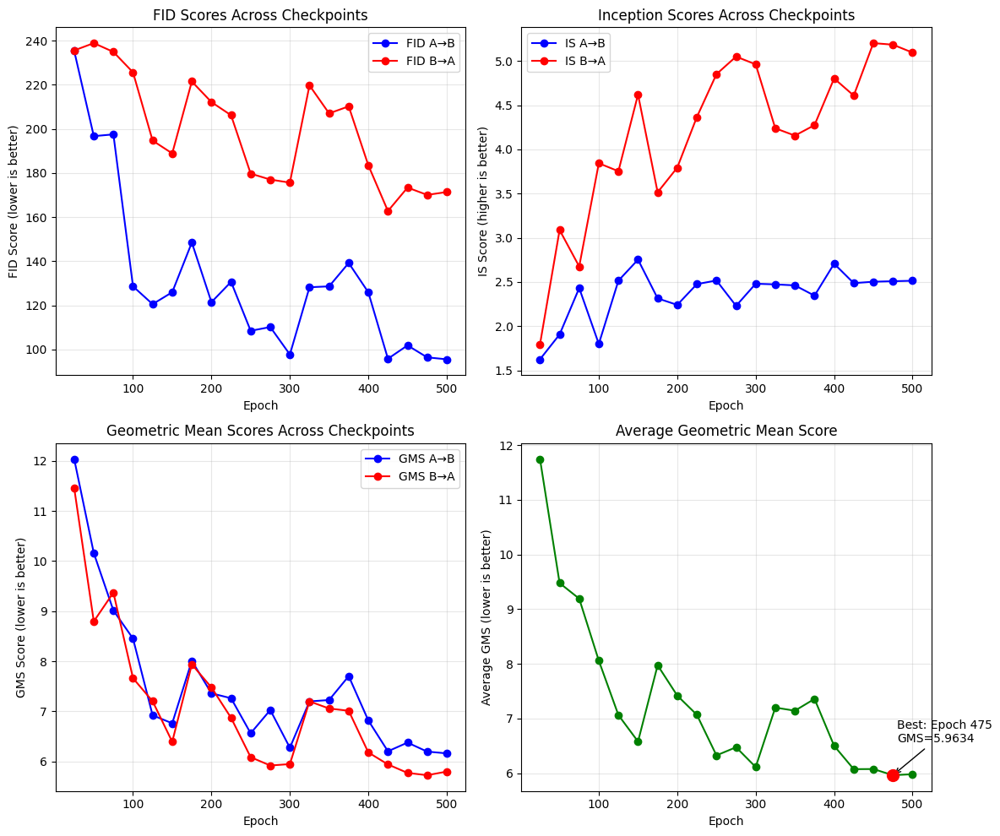


Loading best model from epoch 475
Best model loaded successfully!


In [39]:
# Run evaluation on all checkpoints
print("Starting evaluation of all checkpoints...")
results = evaluate_all_checkpoints()

# Visualize results
plot_checkpoint_metrics(results)

# Load the best model for final use
if not results.empty:
    valid_results = results[results['avg_gms'] != float('inf')]
    if not valid_results.empty:
        best_epoch = valid_results.loc[valid_results['avg_gms'].idxmin(), 'epoch']
        print(f"\nLoading best model from epoch {best_epoch}")
        
        G_AB, _ = load_model(G_AB, f"G_AB-{best_epoch}")
        G_BA, _ = load_model(G_BA, f"G_BA-{best_epoch}")
        
        print("Best model loaded successfully!")